# Complete analysis and treatment of Vertical MD4224 scan

In [1]:
import sys
import gzip
import glob
import pickle
import pandas as pd
import numpy as np
import scipy.io as sio 

sys.path.append('/eos/user/s/sterbini/MD_ANALYSIS/public/')
sys.path.append('/eos/project/l/liu/Toolbox/')

from myToolbox import *
from math import log10, floor
from scipy.signal import savgol_filter
from scipy.interpolate import interp1d
import matplotlib.cm as cm
import matplotlib.gridspec as gridspec

Version 0.03. This is the latest version.
Please help me to improve it reporting bugs to guido.sterbini@cern.ch.
Your platform is Linux-3.10.0-1062.18.1.el7.x86_64-x86_64-with-centos-7.7.1908-Core
Your folder is /eos/home-h/harafiqu/SWAN_projects/PS/From_Scratch/V_Optimised
Your IP is 172.17.0.20
2020-08-17 14:27:29


In [2]:
%run ../MD_Functions.ipynb


	Importing MD Analysis functions for MD4224


### Import MD files

In [3]:
myFiles=glob.glob('/eos/user/h/harafiqu/MD4224/2018.09.05_vertical/2018*.mat')
len(myFiles)

450

In [3]:
x_ticks = [6.1 , 6.12, 6.14, 6.16,  6.18, 6.2 ,  6.22, 6.24]

### Convert matlab files to dataframe

In [5]:
# Convert mat files to dataframe
df_test = fromMatlabToDataFrame(myFiles,['PR_BQS72.SamplerAcquisition.value.estimatedTuneV','PR_BQS72.SamplerAcquisition.value.estimatedTuneH','PR_BQS72.SamplerAcquisition.cycleStamp','PR_BCT_ST.Samples.value.samples','PR_BCT_ST.Samples.cycleStamp'])

In [6]:
# cleanup dataframe
df_test['PR_BCT_ST.Samples.cycleStamp']=df_test['PR_BCT_ST.Samples.cycleStamp']/1e9
df_test['PR_BQS72.SamplerAcquisition.cycleStamp']=df_test['PR_BQS72.SamplerAcquisition.cycleStamp']/1e9

In [7]:
df_test

,cycleStamp,matlabPLS,matlabFilePath,PR_BQS72.SamplerAcquisition.value.estimatedTuneV,PR_BQS72.SamplerAcquisition.cycleStamp,PR_BCT_ST.Samples.cycleStamp,PR_BCT_ST.Samples.value.samples,PR_BQS72.SamplerAcquisition.value.estimatedTuneH
2018-09-05 10:20:30.700,1.536143e+18,CPS.USER.MD1,/eos/user/h/harafiqu/MD4224/2018.09.05_vertica...,"[0.2391116740353679, 0.23971673231960905, 0.23...",1.536136e+09,1.536136e+09,"[-0.16468000000000002, -0.15378, -0.1374300000...","[0.20977273575518698, 0.20940702780573384, 0.2..."
2018-09-05 10:21:06.700,1.536143e+18,CPS.USER.MD1,/eos/user/h/harafiqu/MD4224/2018.09.05_vertica...,"[0.23976878434647172, 0.24005858967109586, 0.2...",1.536136e+09,1.536136e+09,"[-0.16468000000000002, -0.15378, -0.1374300000...","[0.20904288280545877, 0.2091414764329, 0.20907..."
2018-09-05 10:20:30.700,1.536143e+18,CPS.USER.MD1,/eos/user/h/harafiqu/MD4224/2018.09.05_vertica...,"[0.23979297109117814, 0.23927600776361443, 0.2...",1.536136e+09,1.536136e+09,"[-0.21493, -0.20040000000000002, -0.18587, -0....","[0.20910096986069623, 0.20919447601635738, 0.2..."
2018-09-05 10:21:06.700,1.536143e+18,CPS.USER.MD1,/eos/user/h/harafiqu/MD4224/2018.09.05_vertica...,"[0.22984427276260058, 0.23000876451501565, 0.2...",1.536136e+09,1.536136e+09,"[-0.19495, -0.18526, -0.17436000000000001, -0....","[0.20900025780414888, 0.20880781328871953, 0.2..."
2018-09-05 10:21:42.700,1.536143e+18,CPS.USER.MD1,/eos/user/h/harafiqu/MD4224/2018.09.05_vertica...,"[0.21960233799140136, 0.21974349999447174, 0.2...",1.536136e+09,1.536136e+09,"[-0.14228000000000002, -0.13138000000000002, -...","[0.20920446730191952, 0.20915974993014785, 0.2..."
2018-09-05 10:22:18.700,1.536143e+18,CPS.USER.MD1,/eos/user/h/harafiqu/MD4224/2018.09.05_vertica...,"[0.2102815567691356, 0.20942227306900782, 0.20...",1.536136e+09,1.536136e+09,"[-0.13864, -0.12593000000000001, -0.1150300000...","[0.20715974144784158, 0.20999031660603723, 0.2..."
2018-09-05 10:22:54.700,1.536143e+18,CPS.USER.MD1,/eos/user/h/harafiqu/MD4224/2018.09.05_vertica...,"[0.19871366825637893, 0.1989663926550141, 0.20...",1.536136e+09,1.536136e+09,"[-0.19676000000000002, -0.18345, -0.17013, -0....","[0.2100921495539858, 0.20985952297053748, 0.20..."
2018-09-05 10:23:30.700,1.536143e+18,CPS.USER.MD1,/eos/user/h/harafiqu/MD4224/2018.09.05_vertica...,"[0.1899620637501338, 0.1906069731650187, 0.189...",1.536136e+09,1.536136e+09,"[-0.21372000000000002, -0.20040000000000002, -...","[0.20933471986513602, 0.20873250795510992, 0.2..."
2018-09-05 10:24:06.700,1.536143e+18,CPS.USER.MD1,/eos/user/h/harafiqu/MD4224/2018.09.05_vertica...,"[0.18002022523528952, 0.1798854030479251, 0.18...",1.536136e+09,1.536136e+09,"[-0.16226000000000002, -0.15499000000000002, -...","[0.20916809409599718, 0.2091351622165313, 0.20..."
2018-09-05 10:24:42.700,1.536143e+18,CPS.USER.MD1,/eos/user/h/harafiqu/MD4224/2018.09.05_vertica...,"[0.171126744770092, 0.17001407402332383, 0.171...",1.536136e+09,1.536136e+09,"[-0.12714, -0.11564, -0.10716, -0.089000000000...","[0.20855192735048142, 0.20957426025888468, 0.2..."


In [8]:
# Check cyclestamp differences

# Iterate over each row in the dataframe
differences = []
for index, row in df_test.iterrows():
    difference = (row['PR_BCT_ST.Samples.cycleStamp'] - row['PR_BQS72.SamplerAcquisition.cycleStamp'])/row['PR_BCT_ST.Samples.cycleStamp']
    differences.append(difference)
    
print 'Difference between BCT and BQS73 cycle times (percentage) \n Mean:', np.mean(differences),' Min:',np.min(differences),' Max:', np.max(differences)

# Iterate over each row in the dataframe
differences = []
for index, row in df_test.iterrows():
    difference = (row['cycleStamp'] - (row['PR_BCT_ST.Samples.cycleStamp']*1E9))/row['cycleStamp']
    differences.append(difference)
    
print '\nDifference between BCT and cyclestamp cycle times (percentage) \n Mean:', np.mean(differences),' Min:',np.min(differences),' Max:', np.max(differences)

Difference between BCT and BQS73 cycle times (percentage) 
 Mean: 2.23347503095737e-11  Min: 0.0  Max: 1.0050637639308164e-08

Difference between BCT and cyclestamp cycle times (percentage) 
 Mean: 4.68740573399049e-06  Min: 4.687012369152908e-06  Max: 4.735469788809376e-06


In [9]:
df_bct = fromMatlabToDataFrame(myFiles,['PR_BCT_ST.Samples.value.samples','PR_BCT_ST.Samples.cycleStamp', 'PR_SCBFC.Samples.value.samples'])
df_bqs72 = fromMatlabToDataFrame(myFiles,['PR_BQS72.SamplerAcquisition.value.estimatedTuneV','PR_BQS72.SamplerAcquisition.value.estimatedTuneH','PR_BQS72.SamplerAcquisition.cycleStamp'])

In [10]:
df_first = pnd.merge(df_bct, df_bqs72, left_on = 'PR_BCT_ST.Samples.cycleStamp',  right_on = 'PR_BQS72.SamplerAcquisition.cycleStamp')

In [11]:
# Have to convert this for unknown reason (myToolbox.unixtime2datetimeVectorize expects this converted cycleStamp)
df_first['PR_BCT_ST.Samples.cycleStamp']=df_first['PR_BCT_ST.Samples.cycleStamp']/1e9
# copy to new column
df_first['cf_cycleStamp']=df_first['PR_BCT_ST.Samples.cycleStamp']
# rename BCT cyclestamp to cycleStamp
df_first = df_first.rename(index=str, columns={"PR_BCT_ST.Samples.cycleStamp" : "cycleStamp", })
# convert to datetime
#df_first['PR_BCT_ST.Samples.cycleStamp']=df_first['cycleStamp'].apply(myToolbox.unixtime2datetimeVectorize)
df_first['cf_timeStamp'] = df_first['cycleStamp'].apply(myToolbox.unixtime2datetimeVectorize)
#df_first['cf_timeStamp']=df_first['timeStamp']
# Set index
df_first = df_first.set_index(['cycleStamp'])
df_first = df_first.drop(labels='matlabFilePath_x',axis='columns')
df_first = df_first.drop(labels='matlabFilePath_y',axis='columns')
df_first = df_first.drop(labels='cycleStamp_x',axis='columns')
df_first = df_first.drop(labels='cycleStamp_y',axis='columns')
df_first = df_first.drop(labels='matlabPLS_y',axis='columns')
df_first = df_first.drop(labels='matlabPLS_x',axis='columns')
df_first = df_first.drop(labels='PR_BQS72.SamplerAcquisition.cycleStamp',axis='columns')
#df_first = df_first.drop(labels='PR_BCT_ST.Samples.cycleStamp',axis='columns')

In [12]:
df_first['Qx']=df_first.apply(lambda x: np.nanmean(x['PR_BQS72.SamplerAcquisition.value.estimatedTuneH'][20:280]),axis=1)
df_first['Qy']=df_first.apply(lambda x: np.nanmean(x['PR_BQS72.SamplerAcquisition.value.estimatedTuneV'][20:280]),axis=1)

In [13]:
# Remove anomalous cases etc
#df_first = df_first.drop(df_first[df_first['Qx'] < .295].index )
df_first = df_first.dropna(axis=0,how='all',subset =['Qy'])
df_first = df_first.dropna(axis=0,how='all',subset =['Qx'])
df_first = df_first.drop(labels='PR_BQS72.SamplerAcquisition.value.estimatedTuneV',axis='columns')
df_first = df_first.drop(labels='PR_BQS72.SamplerAcquisition.value.estimatedTuneH',axis='columns')
#df_mergetest

In [14]:
df_first

,PR_BCT_ST.Samples.value.samples,PR_SCBFC.Samples.value.samples,cf_cycleStamp,cf_timeStamp,Qx,Qy
cycleStamp,,,,,,
1.536136e+09,"[-0.16468000000000002, -0.15378, -0.1374300000...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,2018-09-05 10:19:54.700,0.208865,0.239484
1.536136e+09,"[-0.16468000000000002, -0.15378, -0.1374300000...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,2018-09-05 10:19:54.700,0.208865,0.239484
1.536136e+09,"[-0.21493, -0.20040000000000002, -0.18587, -0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,2018-09-05 10:20:30.700,0.208899,0.239078
1.536136e+09,"[-0.19495, -0.18526, -0.17436000000000001, -0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,2018-09-05 10:21:06.700,0.208694,0.229331
1.536136e+09,"[-0.14228000000000002, -0.13138000000000002, -...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,2018-09-05 10:21:42.700,0.208412,0.219715
1.536136e+09,"[-0.13864, -0.12593000000000001, -0.1150300000...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,2018-09-05 10:22:18.700,0.208581,0.209510
1.536136e+09,"[-0.19676000000000002, -0.18345, -0.17013, -0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,2018-09-05 10:22:54.700,0.208356,0.199719
1.536136e+09,"[-0.21372000000000002, -0.20040000000000002, -...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,2018-09-05 10:23:30.700,0.208183,0.189839
1.536136e+09,"[-0.16226000000000002, -0.15499000000000002, -...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,2018-09-05 10:24:06.700,0.208225,0.179881


In [15]:
# Check chirp time
test = myToolbox.japcMatlabImport(myFiles[0])
test.PR_BQS72.SamplerAcquisition.value.acqOffset

20

# Plot Cycle etc

In [16]:
path = './Write_Up'
make_directory(path)

Creation of the directory ./Write_Up failed


In [17]:
path = "./Grouped_By_Tune"
make_directory(path)
path = "./Cycle"
make_directory(path)

Creation of the directory ./Grouped_By_Tune failed
Creation of the directory ./Cycle failed


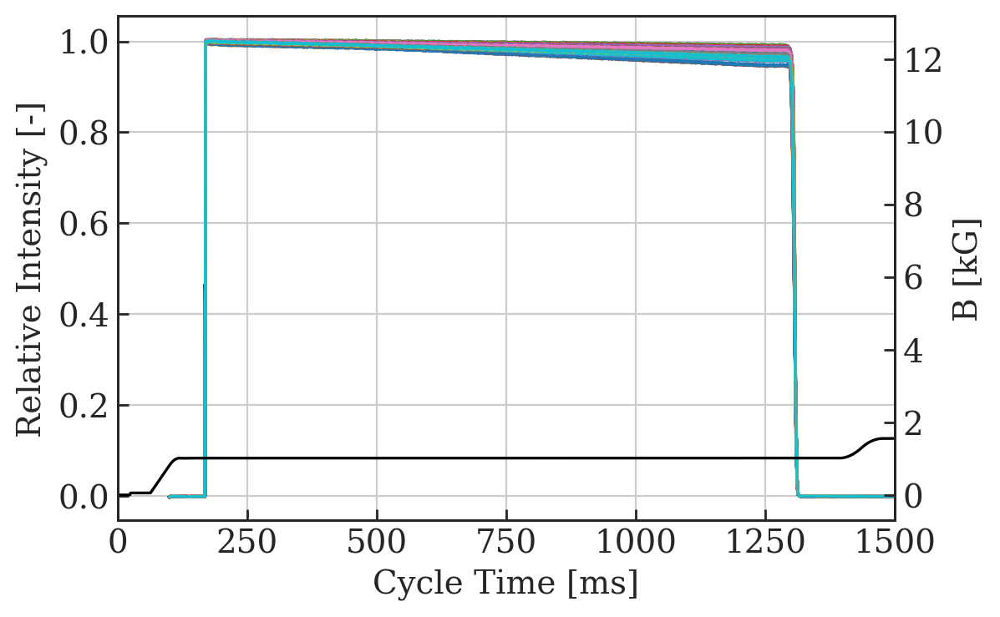

In [18]:
# plot 'PR_BCT_ST.Samples.value.samples'
fig, ax1 = plt.subplots(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k')

points = len(df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0])
x_data = np.linspace(100, points+100, points)

for index, row in df_test.iterrows():
    ax1.plot(x_data, row['PR_BCT_ST.Samples.value.samples']/row['PR_BCT_ST.Samples.value.samples'][70])

ax1.set_xlabel('Cycle Time [ms]')
#ax1.set_xlim(0,1600)
ax1.set_ylabel('Relative Intensity [-]')
#ax1.tick_params(axis='y', labelcolor='r')

ax2 = ax1.twinx()
ax2.set_ylabel('B [kG]')

ax2.plot(df_first['PR_SCBFC.Samples.value.samples'].iloc()[0]/1000., 'k-')
#ax1.tick_params(axis='y', labelcolor='b')

ax1.grid()
#ax2.grid()
#ax1.legend(loc = 1)
# plt.title('Vertical Scan: BCT')
plt.xlim(0, 1500)
fig.savefig('Write_Up/MD4224_Vertical_Intensity_Magnetic_Cycle.png')

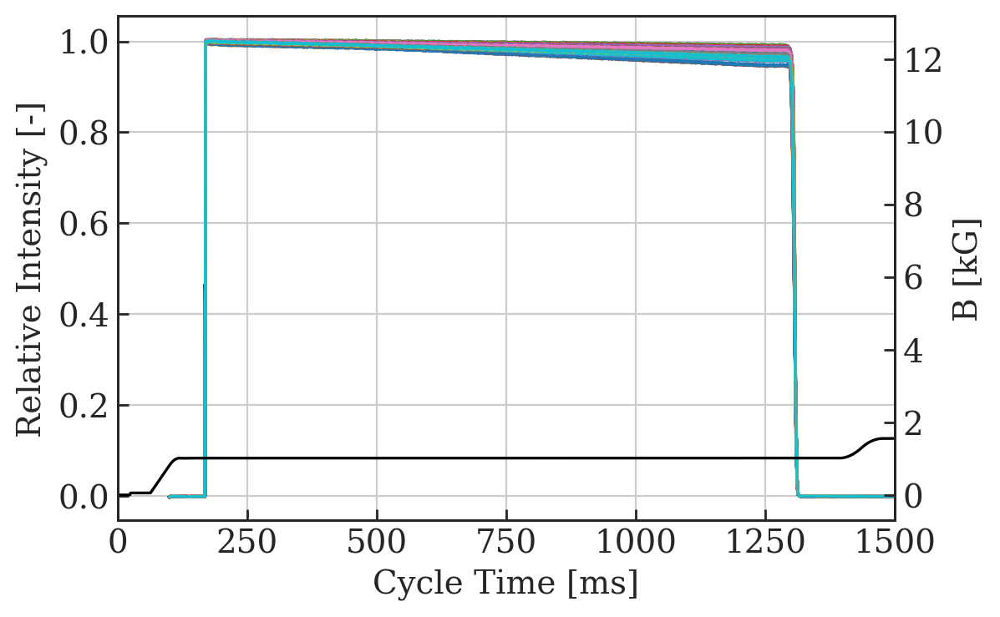

In [19]:
# plot 'PR_BCT_ST.Samples.value.samples'
fig, ax1 = plt.subplots(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k')

points = len(df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0])
x_data = np.linspace(100, points+100, points)

for index, row in df_test.iterrows():
    ax1.plot(x_data, row['PR_BCT_ST.Samples.value.samples']/row['PR_BCT_ST.Samples.value.samples'][70])

ax1.set_xlabel('Cycle Time [ms]')
#ax1.set_xlim(0,1600)
ax1.set_ylabel('Relative Intensity [-]')
#ax1.tick_params(axis='y', labelcolor='r')

ax2 = ax1.twinx()
ax2.set_ylabel('B [kG]')

ax2.plot(df_first['PR_SCBFC.Samples.value.samples'].iloc()[0]/1000., 'k-')
#ax1.tick_params(axis='y', labelcolor='b')

ax1.grid()
#ax2.grid()
#ax1.legend(loc = 1)
# plt.title('Vertical Scan: BCT')
plt.xlim(0, 1500)
fig.savefig('Cycle/MD4224_Vertical_Intensity_Magnetic_Cycle_all.png')

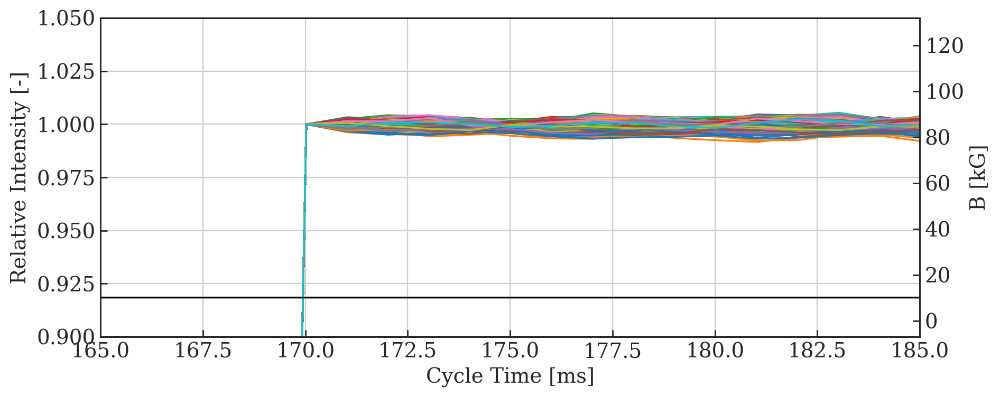

In [20]:
# plot 'PR_BCT_ST.Samples.value.samples'
fig, ax1 = plt.subplots(figsize=(10, 4), dpi= 200, facecolor='w', edgecolor='k')

points = len(df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0])
x_data = np.linspace(100, points+100, points)

for index, row in df_test.iterrows():
    ax1.plot(x_data, row['PR_BCT_ST.Samples.value.samples']/row['PR_BCT_ST.Samples.value.samples'][70])

ax1.set_xlabel('Cycle Time [ms]')
#ax1.set_xlim(0,1600)
ax1.set_ylabel('Relative Intensity [-]')
#ax1.tick_params(axis='y', labelcolor='r')

ax2 = ax1.twinx()
ax2.set_ylabel('B [kG]')

ax2.plot(df_first['PR_SCBFC.Samples.value.samples'].iloc()[0]/100., 'k-')
#ax1.tick_params(axis='y', labelcolor='b')

ax1.grid()
#ax2.grid()
#ax1.legend(loc = 1)
# plt.title('Vertical Scan: BCT')
ax1.set_ylim(0.9, 1.05)
plt.xlim(165, 185)
fig.savefig('Cycle/MD4224_Vertical_Intensity_Magnetic_Cycle_all_zoom.png')

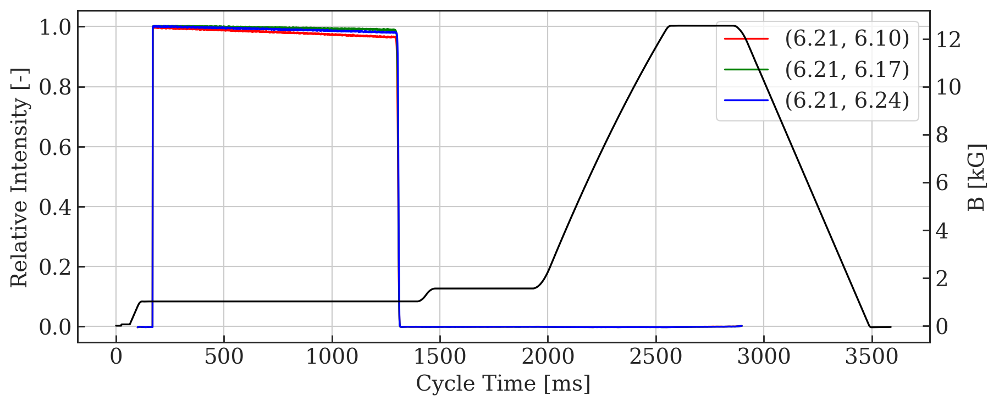

In [21]:
# plot 'PR_BCT_ST.Samples.value.samples'
fig, ax1 = plt.subplots(figsize=(10, 4), dpi= 200, facecolor='w', edgecolor='k')

points = len(df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0])
x_data = np.linspace(100, points+100, points)

ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[16] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[16][70],'r-', label='(6.21, 6.10)')
ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[8] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[8][70],'g-', label='(6.21, 6.17)')
ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0][70],'b-', label='(6.21, 6.24)')

ax1.set_xlabel('Cycle Time [ms]')
#ax1.set_xlim(0,1600)
ax1.set_ylabel('Relative Intensity [-]')
#ax1.tick_params(axis='y', labelcolor='r')

ax2 = ax1.twinx()
ax2.set_ylabel('B [kG]')

ax2.plot(df_first['PR_SCBFC.Samples.value.samples'].iloc()[0]/1000., 'k-')
#ax1.tick_params(axis='y', labelcolor='b')

ax1.grid()
#ax2.grid()
ax1.legend(loc = 1)
# plt.title('Vertical Scan: BCT')
fig.savefig('Write_Up/MD4224_Vertical_Intensity_Magnetic_Cycle_all.png')

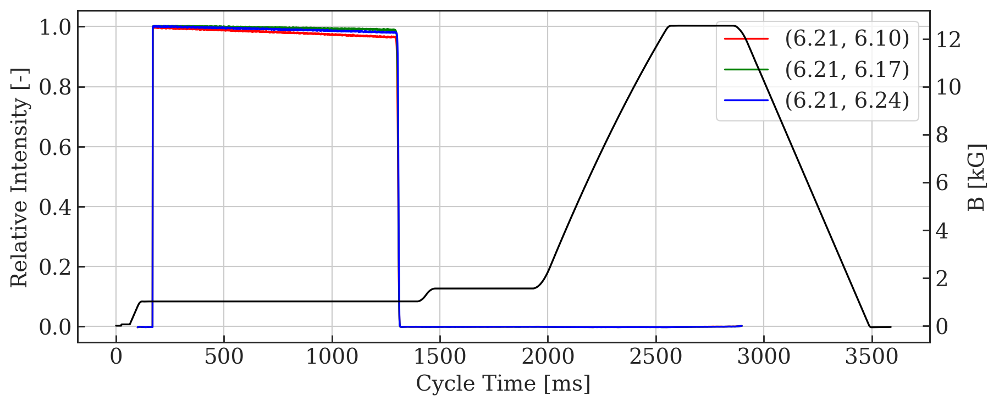

In [22]:
# plot 'PR_BCT_ST.Samples.value.samples'
fig, ax1 = plt.subplots(figsize=(10, 4), dpi= 200, facecolor='w', edgecolor='k')

points = len(df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0])
x_data = np.linspace(100, points+100, points)

ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[16] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[16][70],'r-', label='(6.21, 6.10)')
ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[8] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[8][70],'g-', label='(6.21, 6.17)')
ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0][70],'b-', label='(6.21, 6.24)')

ax1.set_xlabel('Cycle Time [ms]')
#ax1.set_xlim(0,1600)
ax1.set_ylabel('Relative Intensity [-]')
#ax1.tick_params(axis='y', labelcolor='r')

ax2 = ax1.twinx()
ax2.set_ylabel('B [kG]')

ax2.plot(df_first['PR_SCBFC.Samples.value.samples'].iloc()[0]/1000., 'k-')
#ax1.tick_params(axis='y', labelcolor='b')

ax1.grid()
#ax2.grid()
ax1.legend(loc = 1)
# plt.title('Vertical Scan: BCT')
fig.savefig('Cycle/MD4224_Vertical_Intensity_Magnetic_Cycle.png')

wirescanner half time =  0.57175  ms


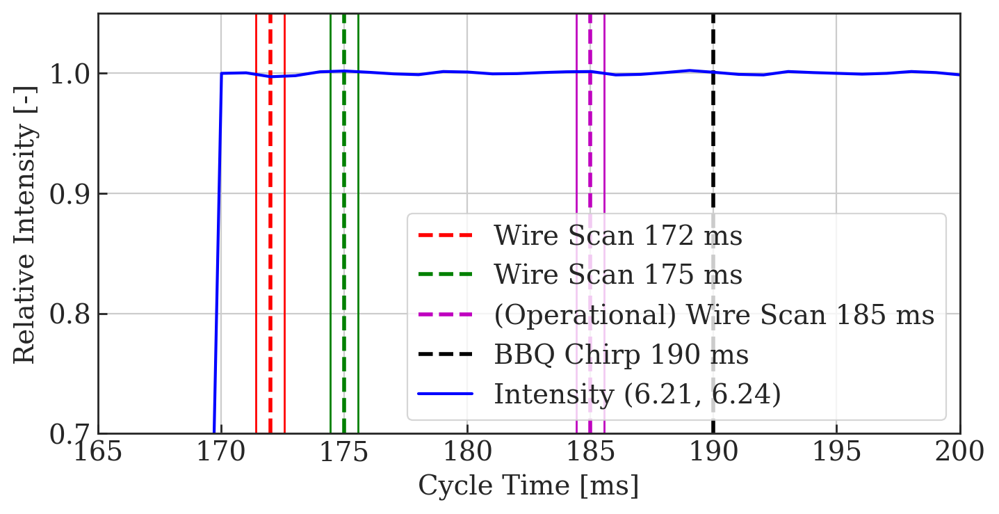

In [23]:
turn_time = 2.287E-3 # in ms
ws_time = 500 * turn_time
t_ws = ws_time/2

print 'wirescanner half time = ', t_ws, ' ms'
# plot 'PR_BCT_ST.Samples.value.samples'
fig, ax1 = plt.subplots(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k')
ax1.grid()

ws_y = [-0.05, 1.05] 
ws_172 = [172, 172]
ws_175 = [175, 175]
ws_185 = [185, 185]
chirp = [190, 190]

ax1.plot(ws_172, ws_y, label='Wire Scan 172 ms', color='r', lw=2, ls='--')
ax1.plot(ws_175, ws_y, label='Wire Scan 175 ms', color='green', lw=2, ls='--')
ax1.plot(ws_185, ws_y, label='(Operational) Wire Scan 185 ms', color='m', lw=2, ls='--')
ax1.plot(chirp, ws_y, label='BBQ Chirp 190 ms', color='k', lw=2, ls='--')

points = len(df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0])
x_data = np.linspace(100, points+100, points)

ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0][70],'b-', label='Intensity (6.21, 6.24)', lw=1.5)
#ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[8] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[8][70],'r-', label='(6.21, 6.17)')
#ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[16] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[16][70],'g-', label='(6.21, 6.10)')

rect1 = patches.Rectangle((172-t_ws, 0.7), 2*t_ws, 0.35, angle=0.0, linewidth=1,edgecolor='r',facecolor='none')
rect2 = patches.Rectangle((175-t_ws, 0.7), 2*t_ws, 0.35, angle=0.0, linewidth=1,edgecolor='green',facecolor='none')
rect3 = patches.Rectangle((185-t_ws, 0.7), 2*t_ws, 0.35, angle=0.0, linewidth=1,edgecolor='m',facecolor='none')

ax1.add_patch(rect1)
ax1.add_patch(rect2)
ax1.add_patch(rect3)

ax1.set_xlabel('Cycle Time [ms]')
ax1.set_ylabel('Relative Intensity [-]')


plt.xlim(165, 200)
plt.ylim(0.70, 1.05)

#ax2.grid()
ax1.legend(loc = 4)

# plt.title('Vertical Scan: BCT')
fig.savefig('Write_Up/MD4224_Vertical_WS_Times.png')

wirescanner half time =  0.57175  ms


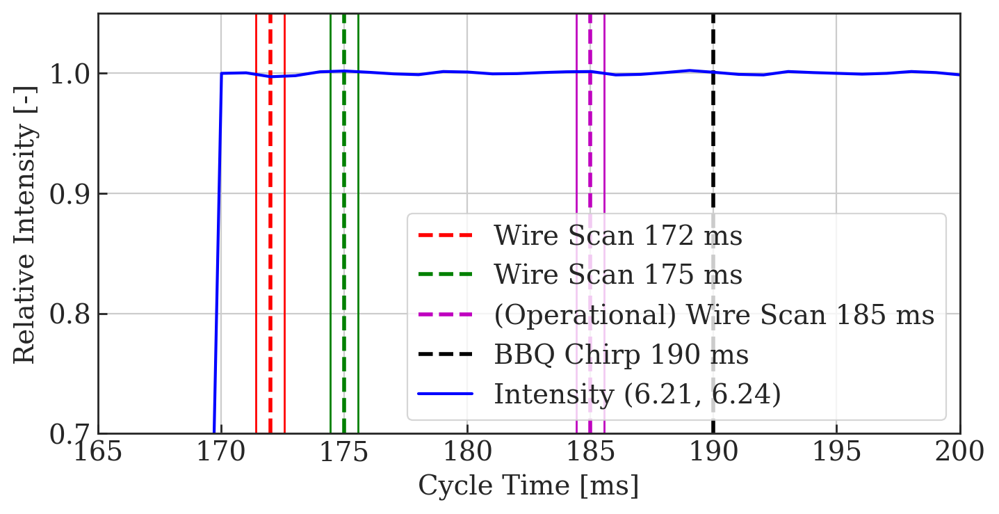

In [24]:
turn_time = 2.287E-3 # in ms
ws_time = 500 * turn_time
t_ws = ws_time/2

print 'wirescanner half time = ', t_ws, ' ms'
# plot 'PR_BCT_ST.Samples.value.samples'
fig, ax1 = plt.subplots(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k')
ax1.grid()

ws_y = [-0.05, 1.05] 
ws_172 = [172, 172]
ws_175 = [175, 175]
ws_185 = [185, 185]
chirp = [190, 190]

ax1.plot(ws_172, ws_y, label='Wire Scan 172 ms', color='r', lw=2, ls='--')
ax1.plot(ws_175, ws_y, label='Wire Scan 175 ms', color='green', lw=2, ls='--')
ax1.plot(ws_185, ws_y, label='(Operational) Wire Scan 185 ms', color='m', lw=2, ls='--')
ax1.plot(chirp, ws_y, label='BBQ Chirp 190 ms', color='k', lw=2, ls='--')

points = len(df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0])
x_data = np.linspace(100, points+100, points)

ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[0][70],'b-', label='Intensity (6.21, 6.24)', lw=1.5)
#ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[8] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[8][70],'r-', label='(6.21, 6.17)')
#ax1.plot(x_data, df_first['PR_BCT_ST.Samples.value.samples'].iloc()[16] / df_first['PR_BCT_ST.Samples.value.samples'].iloc()[16][70],'g-', label='(6.21, 6.10)')

rect1 = patches.Rectangle((172-t_ws, 0.7), 2*t_ws, 0.35, angle=0.0, linewidth=1,edgecolor='r',facecolor='none')
rect2 = patches.Rectangle((175-t_ws, 0.7), 2*t_ws, 0.35, angle=0.0, linewidth=1,edgecolor='green',facecolor='none')
rect3 = patches.Rectangle((185-t_ws, 0.7), 2*t_ws, 0.35, angle=0.0, linewidth=1,edgecolor='m',facecolor='none')

ax1.add_patch(rect1)
ax1.add_patch(rect2)
ax1.add_patch(rect3)

ax1.set_xlabel('Cycle Time [ms]')
ax1.set_ylabel('Relative Intensity [-]')


plt.xlim(165, 200)
plt.ylim(0.70, 1.05)

#ax2.grid()
ax1.legend(loc = 4)

# plt.title('Vertical Scan: BCT')
fig.savefig('Cycle/MD4224_Vertical_WS_Times.png')

# Intensity, Losses, Ratio

In [25]:
df_second=intensity_df(df_first,start=70,end=1100)

In [26]:
df_second = df_second.drop(labels='PR_BCT_ST.Samples.value.samples',axis='columns');
df_second = df_second.set_index(['cf_timeStamp']);
df_second

,PR_SCBFC.Samples.value.samples,cf_cycleStamp,Qx,Qy,intensity,losses,ratio
cf_timeStamp,,,,,,,
2018-09-05 10:19:54.700,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,0.208865,0.239484,7.023244e+11,1.867549,0.981325
2018-09-05 10:19:54.700,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,0.208865,0.239484,7.023244e+11,1.867549,0.981325
2018-09-05 10:20:30.700,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,0.208899,0.239078,7.548161e+11,1.597244,0.984028
2018-09-05 10:21:06.700,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,0.208694,0.229331,7.327544e+11,2.016639,0.979834
2018-09-05 10:21:42.700,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,0.208412,0.219715,6.951734e+11,2.809468,0.971905
2018-09-05 10:22:18.700,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,0.208581,0.209510,7.361018e+11,3.733679,0.962663
2018-09-05 10:22:54.700,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,0.208356,0.199719,7.079539e+11,2.625929,0.973741
2018-09-05 10:23:30.700,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,0.208183,0.189839,7.265163e+11,1.303329,0.986967
2018-09-05 10:24:06.700,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.536136e+09,0.208225,0.179881,7.214954e+11,0.761569,0.992384


### Check for duplicates

In [27]:
df_second = df_second.drop(df_second.index[0])
df_second[df_second.index.duplicated()]

,PR_SCBFC.Samples.value.samples,cf_cycleStamp,Qx,Qy,intensity,losses,ratio
cf_timeStamp,,,,,,,


### Plot Intensity, Losses, Ratio

Average intensity over all shots=  [7.23323135]
Average intensity error =  [0.14754408]
Error = plus/minus  [0.02039809]


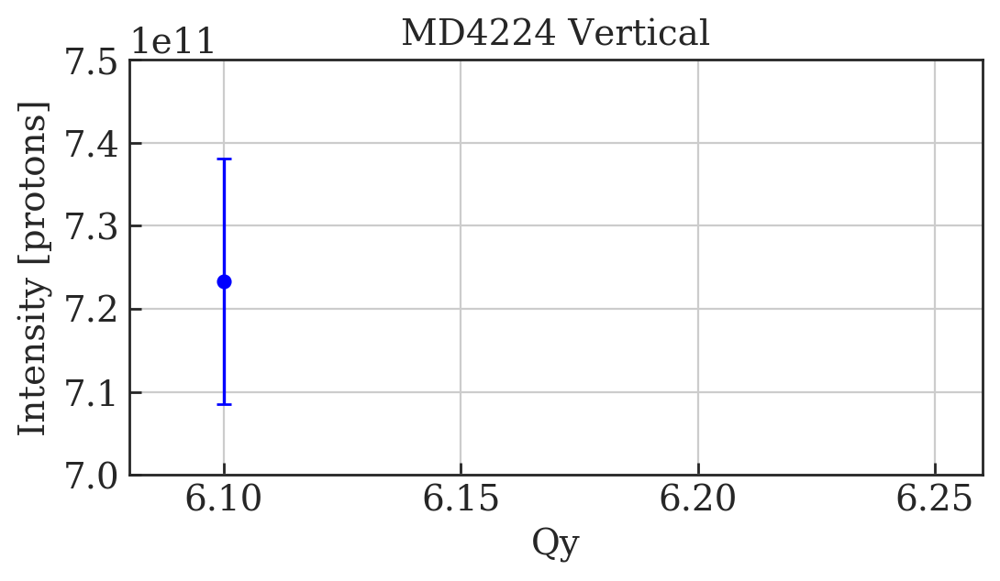

In [28]:
# Plot averaged data points with error bars
x_data = np.linspace(610, 624, 1);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

for i in x_data:
    
    upper_lim = 1.0
    lower_lim = 0.0
    
    y_data_172.append( np.mean( df_second['intensity'][(df_second['Qy']>lower_lim)][(df_second['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df_second['intensity'][(df_second['Qy']>lower_lim)][(df_second['Qy']<upper_lim)] ) )
    
    
fig=plt.figure(figsize=(6, 3), dpi= 200, facecolor='w', edgecolor='k');

plt.errorbar(x_data, y_data_172, y_error_172, linestyle='None', marker='o', capsize=3, color='b')

x_d = np.linspace(6.0, 7.0, 2)
y_d = (7.25E11, 7.25E11)
#plt.plot(x_d, y_d, 'r-', label='7.25E11')

plt.xlabel('Qy');
plt.ylabel('Intensity [protons]');
plt.title('MD4224 Vertical')
plt.ylim(70E10,75E10)
plt.xlim(6.08, 6.26)
#plt.legend()
plt.grid();
#fig.savefig('MD4224_Complete_Vertical_Intensities_Errors_test.png');


print 'Average intensity over all shots= ', np.array(y_data_172)/1.E11
print 'Average intensity error = ', np.array(y_error_172)/1.E11
print 'Error = plus/minus ', (np.array(y_error_172))/(np.array(y_data_172))

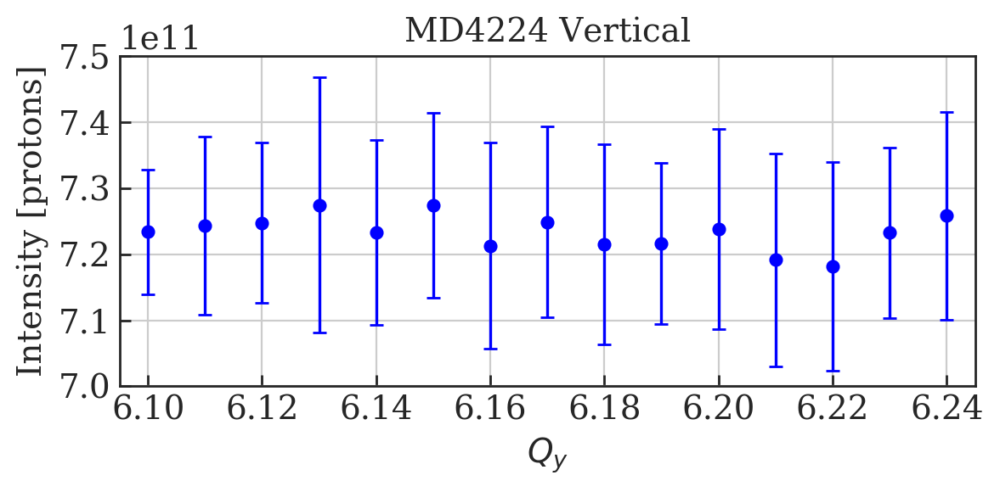

In [29]:
# Plot averaged data points with error bars
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df_second['intensity'][(df_second['Qy']>lower_lim)][(df_second['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df_second['intensity'][(df_second['Qy']>lower_lim)][(df_second['Qy']<upper_lim)] ) )
    
    
fig=plt.figure(figsize=(6, 3), dpi= 200, facecolor='w', edgecolor='k');

plt.errorbar(x_data, y_data_172, y_error_172, linestyle='None', marker='o', capsize=3, color='b')

x_d = np.linspace(6.0, 7.0, 2)
y_d = (7.25E11, 7.25E11)
#plt.plot(x_d, y_d, 'r-', label='7.25E11')

plt.xlabel(r'$Q_y$');
plt.ylabel('Intensity [protons]');
plt.title('MD4224 Vertical')
plt.ylim(70E10,75E10)
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)
#plt.legend()
plt.grid();
plt.tight_layout();
fig.savefig('Grouped_By_Tune/MD4224_Complete_Vertical_Intensities_Errors.png');

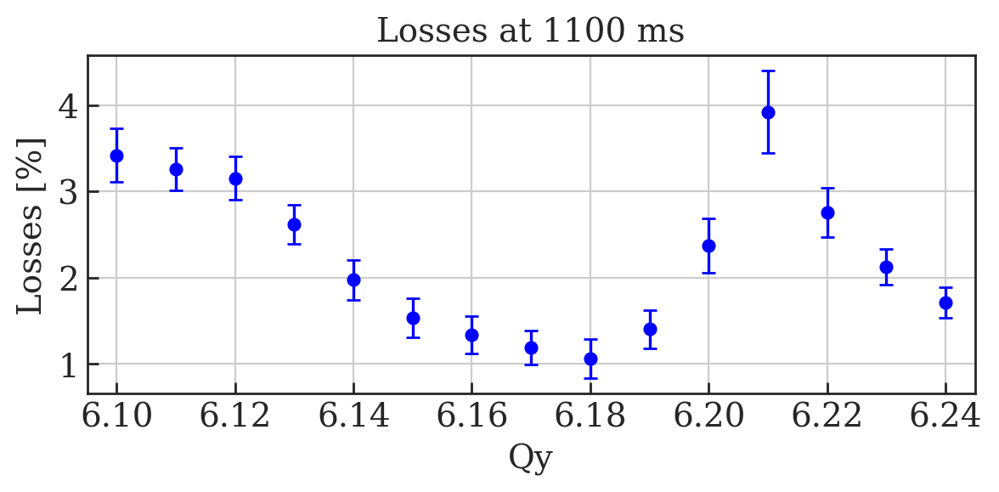

In [30]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 3), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df_second['losses'][(df_second['Qy']>lower_lim)][(df_second['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df_second['losses'][(df_second['Qy']>lower_lim)][(df_second['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='@ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.xlabel('Qy');
plt.ylabel('Losses [%]');
plt.title('Losses at 1100 ms')
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

#plt.legend();
plt.grid();
plt.tight_layout();
fig.savefig('Grouped_By_Tune/MD4224_Vertical_Losses_Errors_Using_Sim_Optics_at_1100ms.png');

# Timber: Vertical

In [31]:
dfV=read_data(year=2018,date=5,month=9,hour=10,minutes=0,span=5,user='CPS%MD1',WS='64.V');

In [32]:
len(dfV)

432

In [33]:
dfV

,PR.BWS.64.V_ROT:ACQ_DELAY,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BCT.LT:SAMPLES,PR.BWS.64.V_ROT:PROF_DATA_IN,cycleStamp
2018-09-05 10:12:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[-0.14046, -0.13017, -0.11988, -0.1005, -0.082...","[0.173502430703752, 0.17229545882224, 0.172095...",1.536142e+18
2018-09-05 10:12:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[-0.20706, -0.18889, -0.17557, -0.15317, -0.12...","[0.173099170197014, 0.17229545882224, 0.173704...",1.536142e+18
2018-09-05 10:13:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[-0.21311, -0.20282, -0.18889, -0.1671, -0.150...","[0.174514696879112, 0.174109083627406, 0.17410...",1.536142e+18
2018-09-05 10:13:54.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[-0.13985, -0.12956, -0.13198, -0.11685, -0.10...","[0.173300683154985, 0.173704413116415, 0.17390...",1.536142e+18
2018-09-05 10:14:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[-0.14591, -0.12472, -0.11624, -0.10111, -0.08...","[0.17512488920122, 0.174514696879112, 0.174311...",1.536142e+18
2018-09-05 10:15:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[-0.20464, -0.18526, -0.16831, -0.14349, -0.12...","[0.17512488920122, 0.174514696879112, 0.174717...",1.536143e+18
2018-09-05 10:15:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[-0.22098, -0.21008, -0.20161, -0.18223, -0.15...","[0.173300683154985, 0.173099170197014, 0.17350...",1.536143e+18
2018-09-05 10:16:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[-0.1562, -0.15136, -0.14409, -0.13441, -0.120...","[0.173300683154985, 0.172496036141661, 0.17309...",1.536143e+18
2018-09-05 10:16:54.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[-0.11806, -0.1114, -0.10413, -0.09142, -0.076...","[0.173704413116415, 0.174109083627406, 0.17330...",1.536143e+18
2018-09-05 10:17:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[-0.18284, -0.16347, -0.15075, -0.1338, -0.113...","[0.172696846962657, 0.17289789155706, 0.173906...",1.536143e+18


# Manual Fit

In [34]:
df_V_filtered = Multi_filter(dfV, with_plot = True, WS = '64.V' )


Multi_filter row  0
5 parameter fit sigma =  2.788639104835815  +/-  0.003926192248341214
3 parameter fit sigma =  2.7886402929181093  +/-  0.02020046673627379
Second moment =  3.132208047565709


/usr/local/bin/start_ipykernel.py:79: RuntimeWarning: invalid value encountered in sqrt
/usr/local/bin/start_ipykernel.py:161: RuntimeWarning: invalid value encountered in sqrt
/usr/local/bin/start_ipykernel.py:163: RuntimeWarning: invalid value encountered in sqrt



Multi_filter row  1
5 parameter fit sigma =  2.858593627149108  +/-  0.0028858421022136247
3 parameter fit sigma =  2.8585942702020866  +/-  0.014355616628631657
Second moment =  3.010831988291384

Multi_filter row  2
5 parameter fit sigma =  2.9297937624023582  +/-  0.002783626020919017
3 parameter fit sigma =  2.9297941431604184  +/-  0.01368008551850069
Second moment =  2.95593746144889

Multi_filter row  3
5 parameter fit sigma =  3.03067158571614  +/-  0.003971499966555441
3 parameter fit sigma =  3.030670821156049  +/-  0.019400945200456904
Second moment =  3.0818150684456613

Multi_filter row  4
5 parameter fit sigma =  2.903034667149036  +/-  0.0032895271751677384
3 parameter fit sigma =  2.903034628859224  +/-  0.01599599322154827
Second moment =  3.04020618330891

Multi_filter row  5
5 parameter fit sigma =  2.9386150270343565  +/-  0.002707965026285824
3 parameter fit sigma =  2.9386151716389737  +/-  0.012731998318958746
Second moment =  3.1521356533431057

Multi_filter ro


Multi_filter row  43
5 parameter fit sigma =  3.2077592037613436  +/-  0.003038611683899817
3 parameter fit sigma =  3.20775939076019  +/-  0.013391813207045147
Second moment =  3.148729308076565

Multi_filter row  44
5 parameter fit sigma =  3.212679209880033  +/-  0.0033991757549855506
3 parameter fit sigma =  3.2126797158444123  +/-  0.015339395637993625
Second moment =  3.2874503169522438

Multi_filter row  45
5 parameter fit sigma =  3.248660711130314  +/-  0.002925559044479319
3 parameter fit sigma =  3.2486607768424545  +/-  0.012595510400107618
Second moment =  3.185877221209128

Multi_filter row  46
5 parameter fit sigma =  3.2729013041343573  +/-  0.003464355989366678
3 parameter fit sigma =  3.2729022183233094  +/-  0.015173678859251387
Second moment =  3.1271615631451355

Multi_filter row  47
5 parameter fit sigma =  3.86700173492837  +/-  0.005363851386047704
3 parameter fit sigma =  3.867000048252819  +/-  0.022424172521737958
Second moment =  3.718372765281439

Multi_fi


Multi_filter row  85
5 parameter fit sigma =  3.115369577535007  +/-  0.003300647124162756
3 parameter fit sigma =  3.11536959685749  +/-  0.015118915470420175
Second moment =  3.1856558399115076

Multi_filter row  86
5 parameter fit sigma =  3.0978008580707397  +/-  0.0035802032591501815
3 parameter fit sigma =  3.09780270921239  +/-  0.016567853231972268
Second moment =  3.3236569031533656

Multi_filter row  87
5 parameter fit sigma =  3.117402951439272  +/-  0.003003655739935901
3 parameter fit sigma =  3.1174029822157996  +/-  0.013476623007244354
Second moment =  3.1710015722452556

Multi_filter row  88
5 parameter fit sigma =  3.2638256000724186  +/-  0.002946561559374025
3 parameter fit sigma =  3.263825658267733  +/-  0.012858573797899777
Second moment =  3.3488036708816837

Multi_filter row  89
5 parameter fit sigma =  3.341852771718139  +/-  0.003241417049221836
3 parameter fit sigma =  3.341851504801611  +/-  0.014119228641374817
Second moment =  3.411721845542196

Multi_fi


Multi_filter row  127
5 parameter fit sigma =  2.9706989956030636  +/-  0.0028238346648804136
3 parameter fit sigma =  2.970699133465817  +/-  0.013071123973220878
Second moment =  3.046979449657365

Multi_filter row  128
5 parameter fit sigma =  3.0053616430151053  +/-  0.002872794905856154
3 parameter fit sigma =  3.0053617563229675  +/-  0.01328509924682709
Second moment =  3.2452464536876677

Multi_filter row  129
5 parameter fit sigma =  3.0065481153540556  +/-  0.0027852194659353483
3 parameter fit sigma =  3.0065492751066367  +/-  0.012527461907247206
Second moment =  3.1962270233754513

Multi_filter row  130
5 parameter fit sigma =  3.08989028999737  +/-  0.003053097633927024
3 parameter fit sigma =  3.089890628002465  +/-  0.01361030850638045
Second moment =  3.1779954321284185

Multi_filter row  131
5 parameter fit sigma =  3.2026232703837083  +/-  0.0034245500880798452
3 parameter fit sigma =  3.202623800452987  +/-  0.015481540733375647
Second moment =  3.1624297751224524



Multi_filter row  169
5 parameter fit sigma =  5.067596217303044  +/-  0.00870087121270184
3 parameter fit sigma =  5.067607782072066  +/-  0.03144212103514252
Second moment =  4.64196422107923

Multi_filter row  170
5 parameter fit sigma =  5.437309600625267  +/-  0.007252910162082992
3 parameter fit sigma =  5.437307890202833  +/-  0.024461944043441528
Second moment =  4.82742084304076

Multi_filter row  171
5 parameter fit sigma =  6.088183682260249  +/-  0.008041782083376291
3 parameter fit sigma =  6.088190834916369  +/-  0.024127843416587687
Second moment =  5.750909474640219

Multi_filter row  172
5 parameter fit sigma =  3.088317702015271  +/-  0.0028561034200814558
3 parameter fit sigma =  3.088317910145856  +/-  0.012672654800295618
Second moment =  3.230935043383413

Multi_filter row  173
5 parameter fit sigma =  2.9973091871207647  +/-  0.003498092750834831
3 parameter fit sigma =  2.9973098136948564  +/-  0.016622247173113665
Second moment =  3.0193677385920323

Multi_fil


Multi_filter row  211
5 parameter fit sigma =  5.0322827195195785  +/-  0.0069856341635477675
3 parameter fit sigma =  5.03228505175098  +/-  0.024908395915871538
Second moment =  4.725671460222092

Multi_filter row  212
5 parameter fit sigma =  5.384044428186338  +/-  0.007348735187256475
3 parameter fit sigma =  5.384037257739179  +/-  0.02514503499989207
Second moment =  4.914137131160048

Multi_filter row  213
5 parameter fit sigma =  6.234048235933724  +/-  0.01027864603670085
3 parameter fit sigma =  6.234055401697568  +/-  0.027458246287221162
Second moment =  6.347280142534706

Multi_filter row  214
5 parameter fit sigma =  3.0906291996050608  +/-  0.003264469166926678
3 parameter fit sigma =  3.09062961330752  +/-  0.014906850701831375
Second moment =  3.285275007616528

Multi_filter row  215
5 parameter fit sigma =  3.0347719911672466  +/-  0.0034823089757052934
3 parameter fit sigma =  3.0347749814069185  +/-  0.016364213939603193
Second moment =  3.0400087736338324

Multi_


Multi_filter row  253
5 parameter fit sigma =  4.833960286044729  +/-  0.0076585228312017785
3 parameter fit sigma =  4.833955729387509  +/-  0.02840954708854571
Second moment =  4.681133512509626

Multi_filter row  254
5 parameter fit sigma =  4.928631281744715  +/-  0.007279241523908445
3 parameter fit sigma =  4.9286339675352435  +/-  0.026513524883887477
Second moment =  4.460466177553136

Multi_filter row  255
5 parameter fit sigma =  5.179826820199434  +/-  0.006183579046586093
3 parameter fit sigma =  5.17982519173261  +/-  0.021023451537859488
Second moment =  5.382563177798832

Multi_filter row  256
5 parameter fit sigma =  5.670694797517766  +/-  0.008046930369489246
3 parameter fit sigma =  5.670689828361608  +/-  0.024482428129337742
Second moment =  6.11631296586035

Multi_filter row  257
5 parameter fit sigma =  3.058178346518233  +/-  0.0028492503407987436
3 parameter fit sigma =  3.0581784575503352  +/-  0.012796874313891935
Second moment =  3.2282673563699174

Multi_f


Multi_filter row  295
5 parameter fit sigma =  4.3002448418620265  +/-  0.004902457234734056
3 parameter fit sigma =  4.300248120342986  +/-  0.018911681739666952
Second moment =  4.072942393615452

Multi_filter row  296
5 parameter fit sigma =  4.873646711901514  +/-  0.006630921203451358
3 parameter fit sigma =  4.8736444433963335  +/-  0.024359428266150947
Second moment =  4.231152165301543

Multi_filter row  297
5 parameter fit sigma =  5.083687705095635  +/-  0.007273581998392487
3 parameter fit sigma =  5.083696557450538  +/-  0.025718670823355758
Second moment =  5.049863518872684

Multi_filter row  298
5 parameter fit sigma =  5.231633983186087  +/-  0.006797930431002723
3 parameter fit sigma =  5.2316298796078105  +/-  0.02327799392650045
Second moment =  4.859402144157615

Multi_filter row  299
5 parameter fit sigma =  5.936662717969319  +/-  0.007221927548286136
3 parameter fit sigma =  5.936664727844024  +/-  0.02166258185632468
Second moment =  5.285005620226225

Multi_fi


Multi_filter row  337
5 parameter fit sigma =  4.118842871846818  +/-  0.004470765555320323
3 parameter fit sigma =  4.118840509438285  +/-  0.017195740703115817
Second moment =  3.798278257640132

Multi_filter row  338
5 parameter fit sigma =  4.379435846310719  +/-  0.00509902167052797
3 parameter fit sigma =  4.379438234770674  +/-  0.019110166355186423
Second moment =  3.937155655491467

Multi_filter row  339
5 parameter fit sigma =  4.757155134489794  +/-  0.0061159428204320375
3 parameter fit sigma =  4.757162999925342  +/-  0.02248883051528574
Second moment =  4.260101117530082

Multi_filter row  340
5 parameter fit sigma =  4.834664458241774  +/-  0.005782962534542856
3 parameter fit sigma =  4.834666747849226  +/-  0.02059045037325988
Second moment =  4.343414767541031

Multi_filter row  341
5 parameter fit sigma =  5.173477508688144  +/-  0.006209631716553169
3 parameter fit sigma =  5.173477812232418  +/-  0.02099356953049655
Second moment =  5.178440225854646

Multi_filter


Multi_filter row  379
5 parameter fit sigma =  3.970963448511826  +/-  0.005114207244165978
3 parameter fit sigma =  3.9709652488799954  +/-  0.02062069157603321
Second moment =  3.903058431586273

Multi_filter row  380
5 parameter fit sigma =  4.475631651214205  +/-  0.0056946200398541365
3 parameter fit sigma =  4.475633726400489  +/-  0.021549510307754666
Second moment =  4.23112034221683

Multi_filter row  381
5 parameter fit sigma =  4.789079016376655  +/-  0.005921448196787091
3 parameter fit sigma =  4.789080416663654  +/-  0.021160266381018807
Second moment =  4.753979128789034

Multi_filter row  382
5 parameter fit sigma =  4.851921958214868  +/-  0.005499624706111877
3 parameter fit sigma =  4.851926403296138  +/-  0.019151173041030332
Second moment =  4.316443605561174

Multi_filter row  383
5 parameter fit sigma =  5.375408272788496  +/-  0.006119625705718025
3 parameter fit sigma =  5.375407095483687  +/-  0.020183106449062696
Second moment =  5.268982885799633

Multi_fil


Multi_filter row  421
5 parameter fit sigma =  5.0027704076878665  +/-  0.006304155663533454
3 parameter fit sigma =  5.002776096682377  +/-  0.022138328018499038
Second moment =  4.681174577610851

Multi_filter row  422
5 parameter fit sigma =  5.280539582283908  +/-  0.006895837882123475
3 parameter fit sigma =  5.2805376503690775  +/-  0.02368507945686194
Second moment =  5.458707349318727

Multi_filter row  423
5 parameter fit sigma =  5.758378694919666  +/-  0.007786504213024495
3 parameter fit sigma =  5.758377063796965  +/-  0.023799634038589496
Second moment =  6.045096201089692

Multi_filter row  424
5 parameter fit sigma =  2.9953858936667754  +/-  0.0028417610780446883
3 parameter fit sigma =  2.995385945355646  +/-  0.012965846363954505
Second moment =  3.137697153089356

Multi_filter row  425
5 parameter fit sigma =  2.8542395557595266  +/-  0.0026705704943541194
3 parameter fit sigma =  2.8542408106521315  +/-  0.012376487817248372
Second moment =  3.1451846544804543

Mu

In [35]:
df_V_filtered = df_V_filtered.dropna(axis=0, how='all', subset=['profile V']);
df_V_filtered = df_V_filtered.dropna(axis=0, how='all', subset=['sig V']);
df_V_filtered = df_V_filtered.drop(labels = 'PR.BCT.LT:SAMPLES',axis='columns');
df_V_filtered['cycleStamp'] = df_V_filtered['cycleStamp']/1e9;
df_V_filtered['timeStamp_h'] = df_V_filtered['cycleStamp'].apply(myToolbox.unixtime2datetimeVectorize);


In [36]:
df_V_filtered

,PR.BWS.64.V_ROT:ACQ_DELAY,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,cycleStamp,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V,timeStamp_h
2018-09-05 10:12:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173502430703752, 0.17229545882224, 0.172095...",1.536142e+09,3.132208,2.7886402929181093,0.020200,6.452195201225923,1.4161365066912859,"[16.608863493308714, 16.534863493308716, 16.41...","[0.000776702050126421, 0.000574348051127882, 0...",2018-09-05 12:12:06.700
2018-09-05 10:12:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173099170197014, 0.17229545882224, 0.173704...",1.536142e+09,3.010832,2.8585942702020866,0.014356,6.740661295927736,1.221591016314844,"[17.144408983685157, 17.09040898368516, 17.037...","[-0.00024597228561037965, -0.00024592133172846...",2018-09-05 12:12:42.700
2018-09-05 10:13:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.174514696879112, 0.174109083627406, 0.17410...",1.536142e+09,2.955937,2.9297941431604184,0.013680,6.83515413997671,1.1734280946355182,"[17.495571905364482, 17.35757190536448, 17.302...","[-0.0003046735899116526, 0.0009069395982613804...",2018-09-05 12:13:18.700
2018-09-05 10:13:54.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173300683154985, 0.173704413116415, 0.17390...",1.536142e+09,3.081815,3.030670821156049,0.019401,6.964632068580115,1.1043962999179182,"[18.08360370008208, 17.94960370008208, 17.8686...","[0.0018511974682094978, 0.0012413400654321116,...",2018-09-05 12:13:54.700
2018-09-05 10:14:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.17512488920122, 0.174514696879112, 0.174311...",1.536142e+09,3.040206,2.903034628859224,0.015996,5.022052891748524,1.1126631931312738,"[17.390336806868728, 17.308336806868727, 17.30...","[0.0010362362048673412, 0.0012393421806040361,...",2018-09-05 12:14:30.700
2018-09-05 10:15:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.17512488920122, 0.174514696879112, 0.174717...",1.536143e+09,3.152136,2.9386151716389737,0.012732,4.991960311561539,1.122423422705334,"[17.574576577294664, 17.463576577294663, 17.35...","[0.002213751375130024, 0.002827721597545463, 0...",2018-09-05 12:15:06.700
2018-09-05 10:15:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173300683154985, 0.173099170197014, 0.17350...",1.536143e+09,3.098637,2.9823574055277153,0.023715,4.957005998822932,0.8996482102654576,"[17.853351789734543, 17.769351789734543, 17.65...","[0.001875227445048061, 0.0018753333458864097, ...",2018-09-05 12:15:42.700
2018-09-05 10:16:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173300683154985, 0.172496036141661, 0.17309...",1.536143e+09,3.090829,2.9284429512550947,0.015198,5.178244007097413,1.158736229389001,"[17.538263770611, 17.455263770611, 17.34426377...","[-0.002231473889183627, -0.0024302971047269195...",2018-09-05 12:16:18.700
2018-09-05 10:16:54.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173704413116415, 0.174109083627406, 0.17330...",1.536143e+09,2.957795,2.837770411936462,0.013618,5.051679382837676,1.233687622311651,"[17.025312377688348, 16.945312377688346, 16.81...","[-0.0015952020825911462, -0.001595052621289172...",2018-09-05 12:16:54.700
2018-09-05 10:17:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.172696846962657, 0.17289789155706, 0.173906...",1.536143e+09,3.144051,2.8482318336624743,0.015426,4.7923762704209825,1.0890698929041707,"[16.96093010709583, 16.86193010709583, 16.8129...","[0.0006579266616856538, -0.0007540108137684964...",2018-09-05 12:17:30.700


# Merge Timber WS dataframe with Intensity/Tunes dataframe

In [37]:
df_third = pnd.merge(df_V_filtered, df_second, left_index=True, right_index=True, how='outer');
df_third

,PR.BWS.64.V_ROT:ACQ_DELAY,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,cycleStamp,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V,timeStamp_h,PR_SCBFC.Samples.value.samples,cf_cycleStamp,Qx,Qy,intensity,losses,ratio
2018-09-05 10:12:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173502430703752, 0.17229545882224, 0.172095...",1.536142e+09,3.132208,2.7886402929181093,0.020200,6.452195201225923,1.4161365066912859,"[16.608863493308714, 16.534863493308716, 16.41...","[0.000776702050126421, 0.000574348051127882, 0...",2018-09-05 12:12:06.700,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-05 10:12:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173099170197014, 0.17229545882224, 0.173704...",1.536142e+09,3.010832,2.8585942702020866,0.014356,6.740661295927736,1.221591016314844,"[17.144408983685157, 17.09040898368516, 17.037...","[-0.00024597228561037965, -0.00024592133172846...",2018-09-05 12:12:42.700,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-05 10:13:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.174514696879112, 0.174109083627406, 0.17410...",1.536142e+09,2.955937,2.9297941431604184,0.013680,6.83515413997671,1.1734280946355182,"[17.495571905364482, 17.35757190536448, 17.302...","[-0.0003046735899116526, 0.0009069395982613804...",2018-09-05 12:13:18.700,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-05 10:13:54.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173300683154985, 0.173704413116415, 0.17390...",1.536142e+09,3.081815,3.030670821156049,0.019401,6.964632068580115,1.1043962999179182,"[18.08360370008208, 17.94960370008208, 17.8686...","[0.0018511974682094978, 0.0012413400654321116,...",2018-09-05 12:13:54.700,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-05 10:14:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.17512488920122, 0.174514696879112, 0.174311...",1.536142e+09,3.040206,2.903034628859224,0.015996,5.022052891748524,1.1126631931312738,"[17.390336806868728, 17.308336806868727, 17.30...","[0.0010362362048673412, 0.0012393421806040361,...",2018-09-05 12:14:30.700,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-05 10:15:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.17512488920122, 0.174514696879112, 0.174717...",1.536143e+09,3.152136,2.9386151716389737,0.012732,4.991960311561539,1.122423422705334,"[17.574576577294664, 17.463576577294663, 17.35...","[0.002213751375130024, 0.002827721597545463, 0...",2018-09-05 12:15:06.700,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-05 10:15:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173300683154985, 0.173099170197014, 0.17350...",1.536143e+09,3.098637,2.9823574055277153,0.023715,4.957005998822932,0.8996482102654576,"[17.853351789734543, 17.769351789734543, 17.65...","[0.001875227445048061, 0.0018753333458864097, ...",2018-09-05 12:15:42.700,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-05 10:16:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173300683154985, 0.172496036141661, 0.17309...",1.536143e+09,3.090829,2.9284429512550947,0.015198,5.178244007097413,1.158736229389001,"[17.538263770611, 17.455263770611, 17.34426377...","[-0.002231473889183627, -0.0024302971047269195...",2018-09-05 12:16:18.700,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-05 10:16:54.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173704413116415, 0.174109083627406, 0.17330...",1.536143e+09,2.957795,2.837770411936462,0.013618,5.051679382837676,1.233687622311651,"[17.025312377688348, 16.945312377688346, 16.81...","[-0.0015952020825911462, -0.001595052621289172...",2018-09-05 12:16:54.700,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2018-09-05 10:17:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.172696846962657, 0.17289789155706, 0.173906...",1.536143e+09,3.144051,2.8482318336624743,0.015426,4.7923762704209825,1.0890698929041707,"[16.96093010709583, 16.86193010709583, 16.8129...","[0.0006579266616856538, -0.0007540108137684964...",2018-09-05 12:17:30.700,NaN,NaN,NaN,NaN,NaN,Na

In [38]:
df_third=df_third.dropna(axis=0,how='all',subset =['Qy']);
df_third=df_third.dropna(axis=0,how='all',subset =['sig V']);
df_third=df_third.dropna(axis=1,how='all');
df_third = df_third.drop(labels = 'timeStamp_h',axis='columns');
df_third = df_third.drop(labels = 'cf_cycleStamp',axis='columns');
df_third

,PR.BWS.64.V_ROT:ACQ_DELAY,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,cycleStamp,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V,PR_SCBFC.Samples.value.samples,Qx,Qy,intensity,losses,ratio
2018-09-05 10:20:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.17229545882224, 0.17229545882224, 0.1735024...",1.536143e+09,3.281589,2.9994494508823175,0.011036,4.674117219845751,1.194792438636508,"[17.99320756136349, 17.913207561363492, 17.750...","[0.0002743988815579468, -0.0003314104699027320...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.208899,0.239078,7.548161e+11,1.597244,0.984028
2018-09-05 10:21:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.173300683154985, 0.17289...",1.536143e+09,3.203431,3.1059290861276785,0.017218,4.735926944681591,1.0613386155296278,"[18.633661384470372, 18.52566138447037, 18.498...","[0.0005375984547532353, -6.800042019439179e-05...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.208694,0.229331,7.327544e+11,2.016639,0.979834
2018-09-05 10:21:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.173704413116415, 0.17471...",1.536143e+09,3.013625,2.877569760386751,0.013372,4.210207115773017,1.1427805475505157,"[17.169219452449486, 17.089219452449484, 16.95...","[-0.00013146856293763665, -0.00033271834636078...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.208412,0.219715,6.951734e+11,2.809468,0.971905
2018-09-05 10:22:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.172095114732879, 0.17129606525681, 0.171096...",1.536143e+09,3.192118,3.240216833707556,0.019804,4.449373960361013,1.0897481518960797,"[19.37725184810392, 19.26125184810392, 19.1432...","[-0.0023664620381889656, -0.001767900782242565...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.208581,0.209510,7.361018e+11,3.733679,0.962663
2018-09-05 10:22:54.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.173099170197014, 0.17330...",1.536143e+09,3.275086,3.180944840805123,0.017962,4.441083033668285,0.9197659734003868,"[19.080234026599612, 18.99523402659961, 18.911...","[-0.00042794258272393915, -0.00103003807445023...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.208356,0.199719,7.079539e+11,2.625929,0.973741
2018-09-05 10:23:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.174311772273524, 0.17350...",1.536143e+09,3.432943,3.300061990218307,0.014947,4.565909315671348,0.9676094983024153,"[19.781390501697583, 19.699390501697586, 19.61...","[0.0009132607432985607, -9.633297676292507e-05...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.208183,0.189839,7.265163e+11,1.303329,0.986967
2018-09-05 10:24:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.174109083627406, 0.173502430703752, 0.17451...",1.536143e+09,3.393933,3.319619663513618,0.015588,4.512798604860301,1.06952690260444,"[19.88347309739556, 19.80947309739556, 19.7584...","[-0.0012127405378839773, -0.001212468910250536...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.208225,0.179881,7.214954e+11,0.761569,0.992384
2018-09-05 10:24:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.172095114732879, 0.171695125159864, 0.17209...",1.536143e+09,3.413773,3.4922039286292734,0.019307,4.490249394766745,1.1695269372034072,"[20.91047306279659, 20.68447306279659, 20.5274...","[-0.0005337476518609274, -0.000130702880489386...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.208439,0.170431,7.035416e+11,1.300672,0.986993
2018-09-05 10:25:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173502430703752, 0.173300683154985, 0.17492...",1.536143e+09,3.655397,3.5763442350211503,0.018213,4.275558516238426,0.8637397442678284,"[21.43426025573217, 21.25826025573217, 21.1752...","[0.0022844916745668187, 0.0016733919598480307,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.2089

# Emittances

In [39]:
span=span_range(df_third)
span

xrange(419)

In [40]:
# Calculate emittances in Vertical
df_fourth = emittance_df(df_third, WS='64.V', verbose=True)

Emittance  0  =  0.9268889938565368
Emittance  1  =  0.9928271518178743
Emittance  2  =  0.8511196991818816
Emittance  3  =  1.077377762159982
Emittance  4  =  1.0363068875006491
Emittance  5  =  1.11272117561788
Emittance  6  =  1.1226759854634412
Emittance  7  =  1.238309444445489
Emittance  8  =  1.2931192674095875
Emittance  9  =  1.4009649178458834
Emittance  10  =  1.6326137769402687
Emittance  11  =  1.9648485875336874
Emittance  12  =  2.745459416479667
Emittance  13  =  3.5515711620467285
Emittance  14  =  0.9834789999270714
Emittance  15  =  0.8828993915374286
Emittance  16  =  0.8992253368224669
Emittance  17  =  0.8973016051812878
Emittance  18  =  0.7767021278656704
Emittance  19  =  1.1529350892022696
Emittance  20  =  1.130010863259383
Emittance  21  =  1.1508517850675166
Emittance  22  =  1.28590454434677
Emittance  23  =  1.5040038323627112
Emittance  24  =  2.016496909374986
Emittance  25  =  2.0351220370270218
Emittance  26  =  2.3551605523812884
Emittance  27  =  2.

Emittance  301  =  0.9721509903046269
Emittance  302  =  0.9283658774011202
Emittance  303  =  0.9566625373604516
Emittance  304  =  0.9138076362736991
Emittance  305  =  0.9719404660388403
Emittance  306  =  1.1077661502196958
Emittance  307  =  1.1947456283786868
Emittance  308  =  1.5305936124922577
Emittance  309  =  1.614210618747935
Emittance  310  =  1.9462311254754068
Emittance  311  =  2.3977473705679637
Emittance  312  =  2.560928997413555
Emittance  313  =  2.8278363441688117
Emittance  314  =  3.4689343452641306
Emittance  315  =  0.9553113254281522
Emittance  316  =  0.9743194344070896
Emittance  317  =  1.017823055839147
Emittance  318  =  1.087131045300006
Emittance  319  =  1.058537220156603
Emittance  320  =  1.1634095360821572
Emittance  321  =  1.2132158383238083
Emittance  322  =  1.3002357727196385
Emittance  323  =  1.4479481418533997
Emittance  324  =  1.7063219276316823
Emittance  325  =  1.9172614070038585
Emittance  326  =  2.245069262308737
Emittance  327  = 

In [41]:
df_fourth

,PR.BWS.64.V_ROT:ACQ_DELAY,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,cycleStamp,2ndMoment V,sig V,sig errV,A V,mu V,position V,...,Qx,Qy,intensity,losses,ratio,emittance V,betx,bety,dx,dy
2018-09-05 10:20:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.17229545882224, 0.17229545882224, 0.1735024...",1.536143e+09,3.281589,2.9994494508823175,0.011036,4.674117219845751,1.194792438636508,"[17.99320756136349, 17.913207561363492, 17.750...",...,0.208899,0.239078,7.548161e+11,1.597244,0.984028,0.926889,12.561293,21.931204,NaN,0.0
2018-09-05 10:21:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.173300683154985, 0.17289...",1.536143e+09,3.203431,3.1059290861276785,0.017218,4.735926944681591,1.0613386155296278,"[18.633661384470372, 18.52566138447037, 18.498...",...,0.208694,0.229331,7.327544e+11,2.016639,0.979834,0.992827,12.549813,21.954145,NaN,0.0
2018-09-05 10:21:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.173704413116415, 0.17471...",1.536143e+09,3.013625,2.877569760386751,0.013372,4.210207115773017,1.1427805475505157,"[17.169219452449486, 17.089219452449484, 16.95...",...,0.208412,0.219715,6.951734e+11,2.809468,0.971905,0.851120,12.538425,21.982050,NaN,0.0
2018-09-05 10:22:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.172095114732879, 0.17129606525681, 0.171096...",1.536143e+09,3.192118,3.240216833707556,0.019804,4.449373960361013,1.0897481518960797,"[19.37725184810392, 19.26125184810392, 19.1432...",...,0.208581,0.209510,7.361018e+11,3.733679,0.962663,1.077378,12.526272,22.018476,NaN,0.0
2018-09-05 10:22:54.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.173099170197014, 0.17330...",1.536143e+09,3.275086,3.180944840805123,0.017962,4.441083033668285,0.9197659734003868,"[19.080234026599612, 18.99523402659961, 18.911...",...,0.208356,0.199719,7.079539e+11,2.625929,0.973741,1.036307,12.514547,22.061295,NaN,0.0
2018-09-05 10:23:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.174311772273524, 0.17350...",1.536143e+09,3.432943,3.300061990218307,0.014947,4.565909315671348,0.9676094983024153,"[19.781390501697583, 19.699390501697586, 19.61...",...,0.208183,0.189839,7.265163e+11,1.303329,0.986967,1.112721,12.502651,22.113880,NaN,0.0
2018-09-05 10:24:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.174109083627406, 0.173502430703752, 0.17451...",1.536143e+09,3.393933,3.319619663513618,0.015588,4.512798604860301,1.06952690260444,"[19.88347309739556, 19.80947309739556, 19.7584...",...,0.208225,0.179881,7.214954e+11,0.761569,0.992384,1.122676,12.490596,22.178355,NaN,0.0
2018-09-05 10:24:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.172095114732879, 0.171695125159864, 0.17209...",1.536143e+09,3.413773,3.4922039286292734,0.019307,4.490249394766745,1.1695269372034072,"[20.91047306279659, 20.68447306279659, 20.5274...",...,0.208439,0.170431,7.035416e+11,1.300672,0.986993,1.238309,12.479095,22.252413,NaN,0.0
2018-09-05 10:25:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173502430703752, 0.173300683154985, 0.17492...",1.536143e+09,3.655397,3.5763442350211503,0.018213,4.275558516238426,0.8637397442678284,"[21.43426025573217, 21.25826025573217, 21.1752...",...,0.208975,0.160332,7.135835e+11,1.156565,0.988434,1.293119,12.466745,22.348437,NaN,0.0
2018-09-05 10:25:54.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.174109083627406, 0.173502430703752, 0.17350...",1.536143e+09,3.603658,3.7317135567106865,0.017619,4.170178518144004,0.6838646886356207,"[22.31613531136438, 22.17913531136438, 21.9911...",...,0.208829,0.150752,7.117577e+11,1.669149,0.983309,1.400965,12.454969,22.459312,NaN,0.0


# Emittances from 2nd Moment

In [42]:
df_fifth = emittance_df_2(df_fourth, WS='64.V', verbose=True)

Emittance from 2nd moment 0  =  1.1094632402768845
Emittance from 2nd moment 1  =  1.056139514675147
Emittance from 2nd moment 2  =  0.9335063603612131
Emittance from 2nd moment 3  =  1.0456292435368277
Emittance from 2nd moment 4  =  1.0985540766444302
Emittance from 2nd moment 5  =  1.2041356130978638
Emittance from 2nd moment 6  =  1.1735029280804987
Emittance from 2nd moment 7  =  1.1833118752634808
Emittance from 2nd moment 8  =  1.3509180075320357
Emittance from 2nd moment 9  =  1.3064651245046972
Emittance from 2nd moment 10  =  1.5065404661861546
Emittance from 2nd moment 11  =  2.0833595211735094
Emittance from 2nd moment 12  =  2.4695724679352624
Emittance from 2nd moment 13  =  2.8736395429142196
Emittance from 2nd moment 14  =  1.035920333333041
Emittance from 2nd moment 15  =  0.9095544422204321
Emittance from 2nd moment 16  =  0.9352277199612571
Emittance from 2nd moment 17  =  1.0850669818079832
Emittance from 2nd moment 18  =  0.856918554830059
Emittance from 2nd moment

Emittance from 2nd moment 245  =  1.0781064417282995
Emittance from 2nd moment 246  =  1.0618119563697892
Emittance from 2nd moment 247  =  0.9312444703693084
Emittance from 2nd moment 248  =  0.9807701548072586
Emittance from 2nd moment 249  =  1.1380180658553092
Emittance from 2nd moment 250  =  1.1667380024529337
Emittance from 2nd moment 251  =  1.3289017645132517
Emittance from 2nd moment 252  =  1.456467597305471
Emittance from 2nd moment 253  =  1.579693043344138
Emittance from 2nd moment 254  =  1.7957028400129862
Emittance from 2nd moment 255  =  1.739424123585936
Emittance from 2nd moment 256  =  2.081965933723886
Emittance from 2nd moment 257  =  2.6139762125649093
Emittance from 2nd moment 258  =  2.7429775727692256
Emittance from 2nd moment 259  =  1.0873201591531894
Emittance from 2nd moment 260  =  1.0082316317593132
Emittance from 2nd moment 261  =  1.0801852366012024
Emittance from 2nd moment 262  =  0.8790042953777383
Emittance from 2nd moment 263  =  1.12854650524649

Emittance from 2nd moment 410  =  3.503793153520598
Emittance from 2nd moment 411  =  1.0143300373004174
Emittance from 2nd moment 412  =  1.0181048737268033
Emittance from 2nd moment 413  =  1.0773163358321967
Emittance from 2nd moment 414  =  0.9884191902129883
Emittance from 2nd moment 415  =  0.9412072328595511
Emittance from 2nd moment 416  =  1.1702286156603068
Emittance from 2nd moment 417  =  1.2353770964625306
Emittance from 2nd moment 418  =  1.3463938230271513


In [43]:
df_fifth

,PR.BWS.64.V_ROT:ACQ_DELAY,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,cycleStamp,2ndMoment V,sig V,sig errV,A V,mu V,position V,...,Qy,intensity,losses,ratio,emittance V,betx,bety,dx,dy,emittance V 2ndMoment
2018-09-05 10:20:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.17229545882224, 0.17229545882224, 0.1735024...",1.536143e+09,3.281589,2.9994494508823175,0.011036,4.674117219845751,1.194792438636508,"[17.99320756136349, 17.913207561363492, 17.750...",...,0.239078,7.548161e+11,1.597244,0.984028,0.926889,12.561293,21.931204,NaN,0.0,1.109463
2018-09-05 10:21:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.173300683154985, 0.17289...",1.536143e+09,3.203431,3.1059290861276785,0.017218,4.735926944681591,1.0613386155296278,"[18.633661384470372, 18.52566138447037, 18.498...",...,0.229331,7.327544e+11,2.016639,0.979834,0.992827,12.549813,21.954145,NaN,0.0,1.056140
2018-09-05 10:21:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.173704413116415, 0.17471...",1.536143e+09,3.013625,2.877569760386751,0.013372,4.210207115773017,1.1427805475505157,"[17.169219452449486, 17.089219452449484, 16.95...",...,0.219715,6.951734e+11,2.809468,0.971905,0.851120,12.538425,21.982050,NaN,0.0,0.933506
2018-09-05 10:22:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.172095114732879, 0.17129606525681, 0.171096...",1.536143e+09,3.192118,3.240216833707556,0.019804,4.449373960361013,1.0897481518960797,"[19.37725184810392, 19.26125184810392, 19.1432...",...,0.209510,7.361018e+11,3.733679,0.962663,1.077378,12.526272,22.018476,NaN,0.0,1.045629
2018-09-05 10:22:54.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.173099170197014, 0.17330...",1.536143e+09,3.275086,3.180944840805123,0.017962,4.441083033668285,0.9197659734003868,"[19.080234026599612, 18.99523402659961, 18.911...",...,0.199719,7.079539e+11,2.625929,0.973741,1.036307,12.514547,22.061295,NaN,0.0,1.098554
2018-09-05 10:23:30.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173906630666387, 0.174311772273524, 0.17350...",1.536143e+09,3.432943,3.300061990218307,0.014947,4.565909315671348,0.9676094983024153,"[19.781390501697583, 19.699390501697586, 19.61...",...,0.189839,7.265163e+11,1.303329,0.986967,1.112721,12.502651,22.113880,NaN,0.0,1.204136
2018-09-05 10:24:06.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.174109083627406, 0.173502430703752, 0.17451...",1.536143e+09,3.393933,3.319619663513618,0.015588,4.512798604860301,1.06952690260444,"[19.88347309739556, 19.80947309739556, 19.7584...",...,0.179881,7.214954e+11,0.761569,0.992384,1.122676,12.490596,22.178355,NaN,0.0,1.173503
2018-09-05 10:24:42.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.172095114732879, 0.171695125159864, 0.17209...",1.536143e+09,3.413773,3.4922039286292734,0.019307,4.490249394766745,1.1695269372034072,"[20.91047306279659, 20.68447306279659, 20.5274...",...,0.170431,7.035416e+11,1.300672,0.986993,1.238309,12.479095,22.252413,NaN,0.0,1.183312
2018-09-05 10:25:18.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.173502430703752, 0.173300683154985, 0.17492...",1.536143e+09,3.655397,3.5763442350211503,0.018213,4.275558516238426,0.8637397442678284,"[21.43426025573217, 21.25826025573217, 21.1752...",...,0.160332,7.135835e+11,1.156565,0.988434,1.293119,12.466745,22.348437,NaN,0.0,1.350918
2018-09-05 10:25:54.700,172.0,"[50000.0, 50000.0, 50000.0, 50000.0, 50000.0, ...","[0.174109083627406, 0.173502430703752, 0.17350...",1.536143e+09,3.603658,3.7317135567106865,0.017619,4.170178518144004,0.6838646886356207,"[22.31613531136438, 22.17913531136438, 21.9911...",...,0.150752,7.117577e+11,1.669149,0.983309,1.400965,12.454969,22.459312,NaN,0.0,1.306465


# Save Dataframe to pickle

In [44]:
df_fifth.to_pickle('MD4224_HighBrightness_Vertical_Using_Sim_Optics_Complete')

In [6]:
df0 = pnd.read_pickle('MD4224_HighBrightness_Vertical_Using_Sim_Optics_Complete')
#df0 = df_fifth

## Find correct tomo file for sims

In [46]:
# First tomo file
time.strftime('%Y-%m-%d %H:%M:%S', time.localtime(1536135630))

'2018-09-05 10:20:30'

In [47]:
# Last tomo file
time.strftime('%Y-%m-%d %H:%M:%S', time.localtime(1536152855))

'2018-09-05 15:07:35'

In [48]:
# data start time
time.strftime('%Y-%m-%d %H:%M:%S', time.localtime(df0['cycleStamp'][0]))

'2018-09-05 12:20:30'

In [49]:
# data start time
time.strftime('%Y-%m-%d %H:%M:%S', time.localtime(df0['cycleStamp'][0]))

'2018-09-05 12:20:30'

# Plots

In [4]:
# These are our tune points:
scan_points = np.linspace(610, 624, 15);
scan_points = scan_points/100;
scan_points

array([6.1 , 6.11, 6.12, 6.13, 6.14, 6.15, 6.16, 6.17, 6.18, 6.19, 6.2 ,
       6.21, 6.22, 6.23, 6.24])

In [5]:
from math import log10, floor

def round_sig(x, sig=4):
    return round(x, sig-int(floor(log10(abs(x))))-1)

In [6]:
Qy_points=[]
for i in scan_points:
    Qy_points.append(round_sig(i,5))
Qy_points

[6.1,
 6.11,
 6.12,
 6.13,
 6.14,
 6.15,
 6.16,
 6.17,
 6.18,
 6.19,
 6.2,
 6.21,
 6.22,
 6.23,
 6.24]

In [7]:
Qy_point_separation = Qy_points[1] - Qy_points[0]
Qy_pt_sep = Qy_point_separation/2
print 'Tune points separated by +/- ', Qy_pt_sep

Tune points separated by +/-  0.005


In [8]:
# Make dictionary of nearest tune point and iterators
tune_points = {}
for i in Qy_points:
    tune_points[i] = np.where(np.logical_and(np.greater_equal(df0['Qy'], (i-Qy_pt_sep-6)), np.less_equal(df0['Qy'], (i+Qy_pt_sep-6)) ) )[0]
tune_points

{6.1: array([ 13,  28,  42,  57,  72,  99, 114, 129, 144, 159, 173, 186, 201,
        214, 228, 243, 258, 272, 286, 300, 314, 329, 343, 356, 371, 384,
        397, 410]),
 6.11: array([ 12,  27,  41,  56,  71,  86,  98, 113, 128, 143, 158, 172, 200,
        227, 242, 257, 271, 285, 299, 313, 328, 342, 370, 383, 396, 409]),
 6.12: array([ 26,  55,  70,  85, 112, 127, 142, 157, 171, 185, 199, 213, 226,
        241, 256, 270, 284, 298, 312, 327, 341, 369, 382, 408]),
 6.13: array([ 11,  25,  40,  54,  69,  84,  97, 111, 126, 141, 156, 170, 184,
        198, 212, 225, 240, 255, 269, 283, 297, 311, 326, 340, 355, 368,
        381, 395, 407]),
 6.14: array([ 10,  24,  39,  53,  68,  83,  96, 110, 125, 140, 155, 169, 183,
        197, 211, 224, 239, 254, 268, 296, 310, 325, 339, 354, 367, 380,
        406]),
 6.15: array([  9,  23,  38,  52,  67,  82,  95, 109, 124, 139, 154, 182, 196,
        210, 223, 238, 253, 267, 282, 295, 309, 324, 338, 353, 366, 379,
        394]),
 6.16: array([  8,  

In [9]:
import matplotlib.cm as cm
# One colour per data point
colors = cm.rainbow(np.linspace(0, 1, len(df0)))

## Plot all WS profiles grouped by tune point

In [11]:
path = "./WS_Grouped"
make_directory(path)

Creation of the directory ./WS_Grouped failed


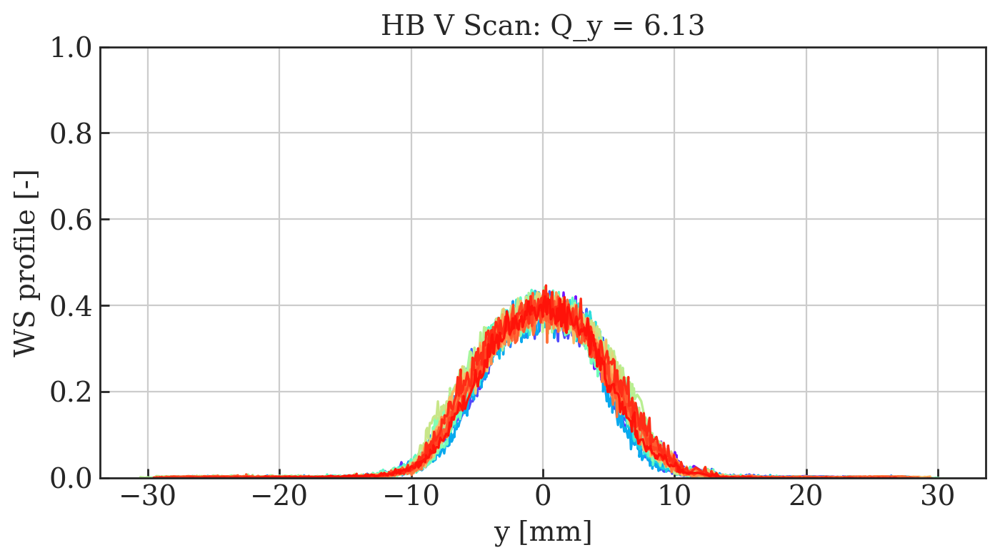

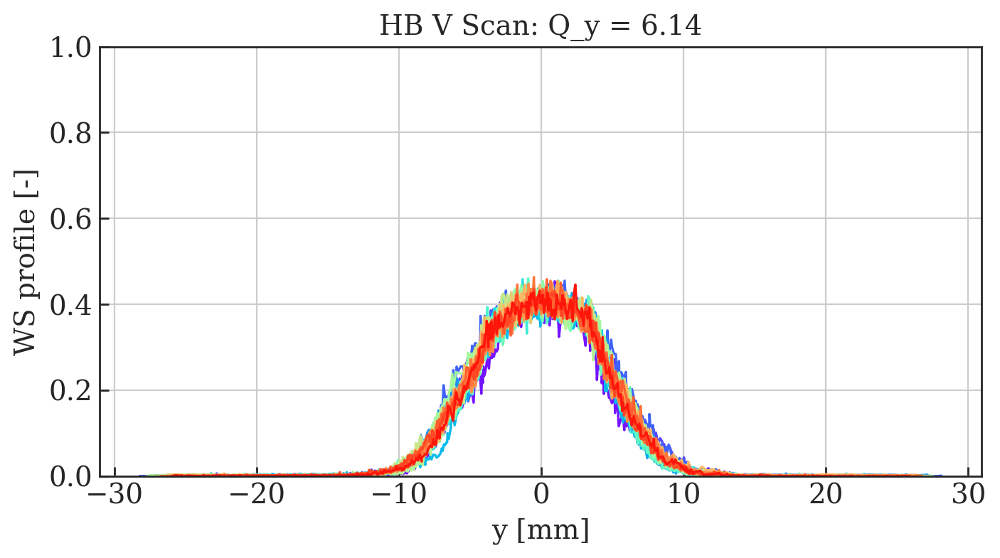

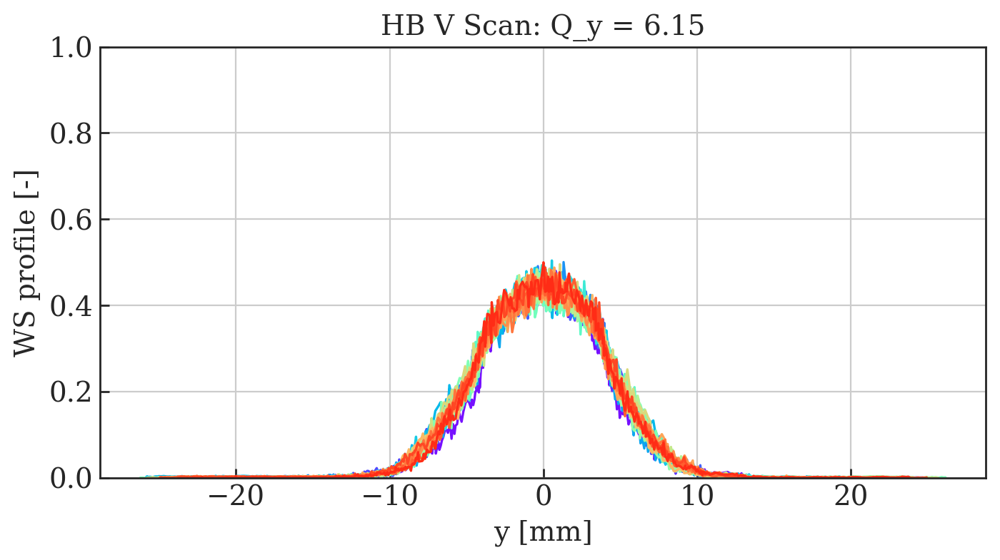

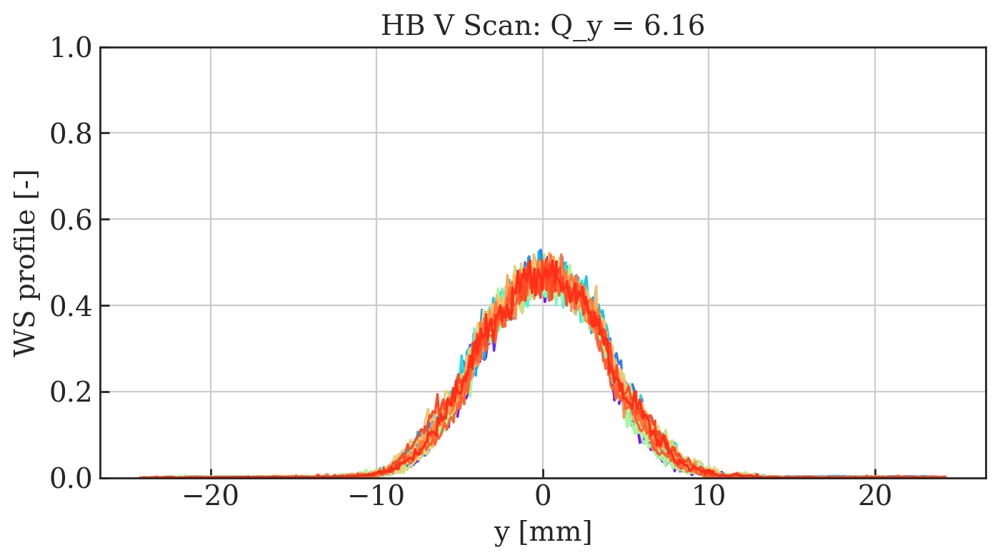

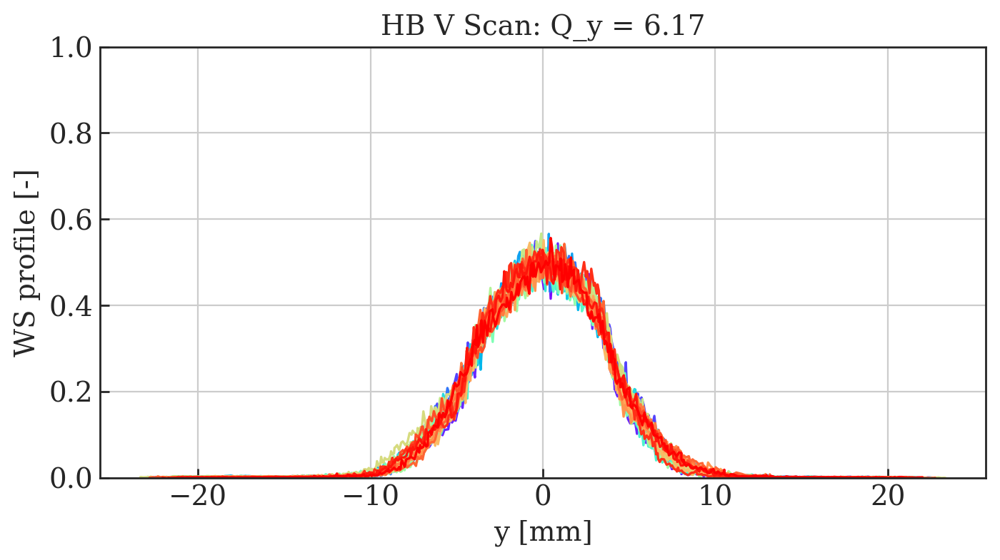

...

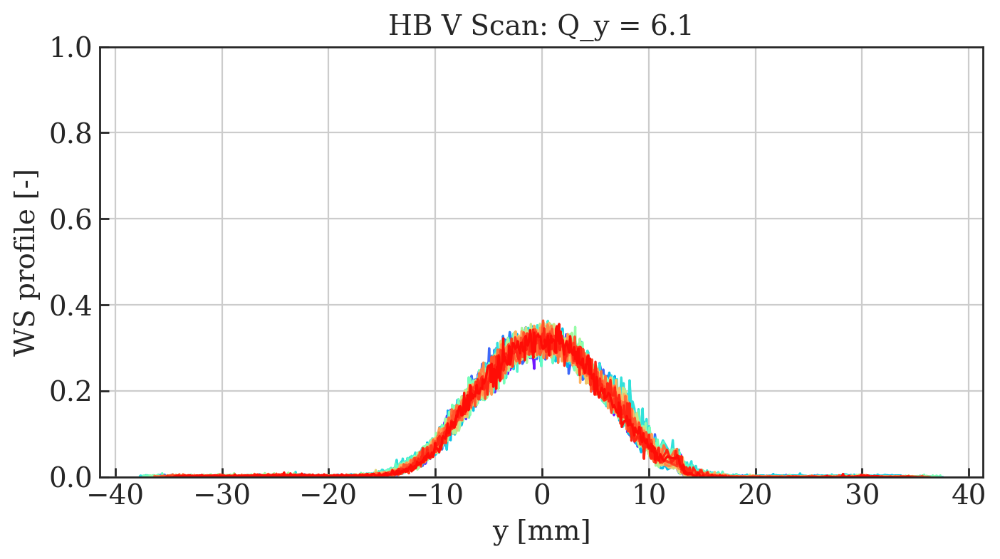

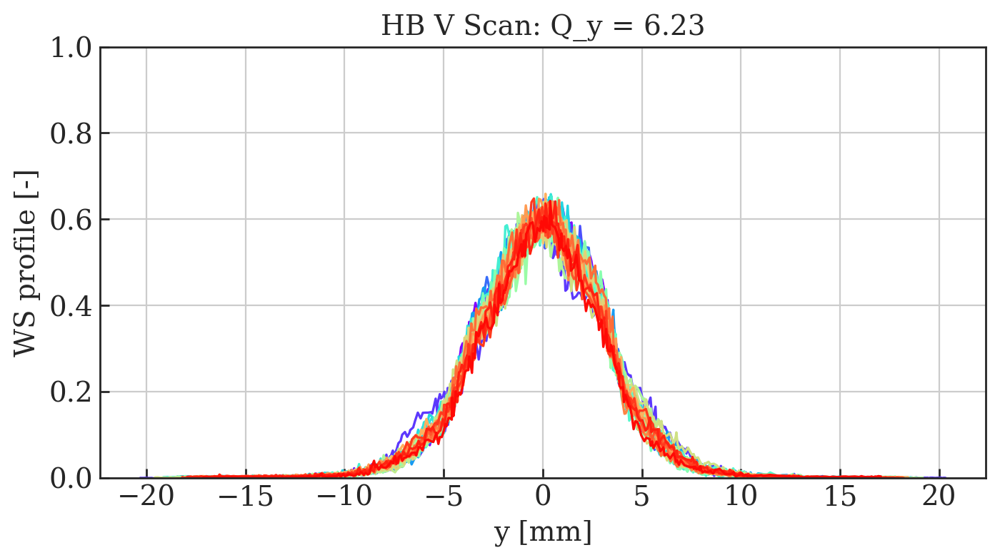

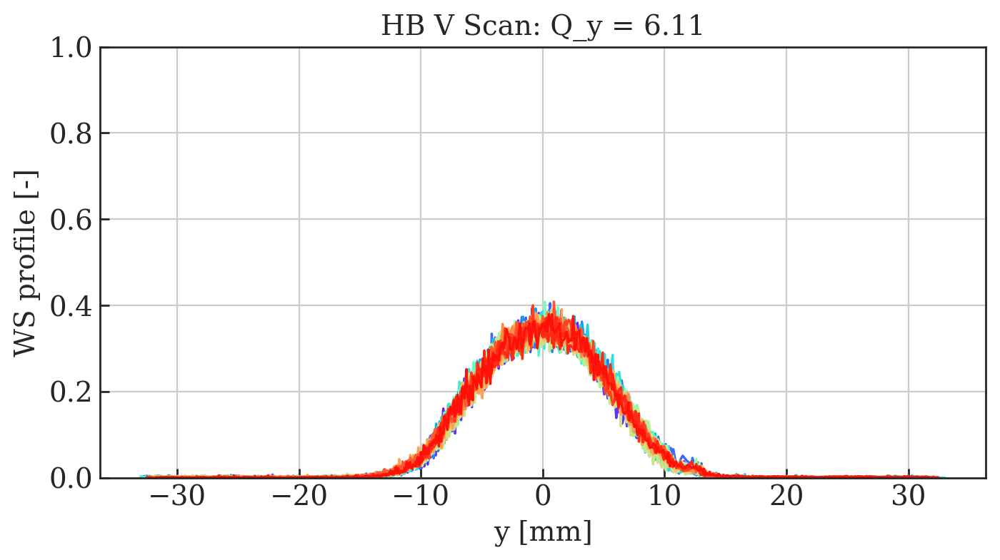

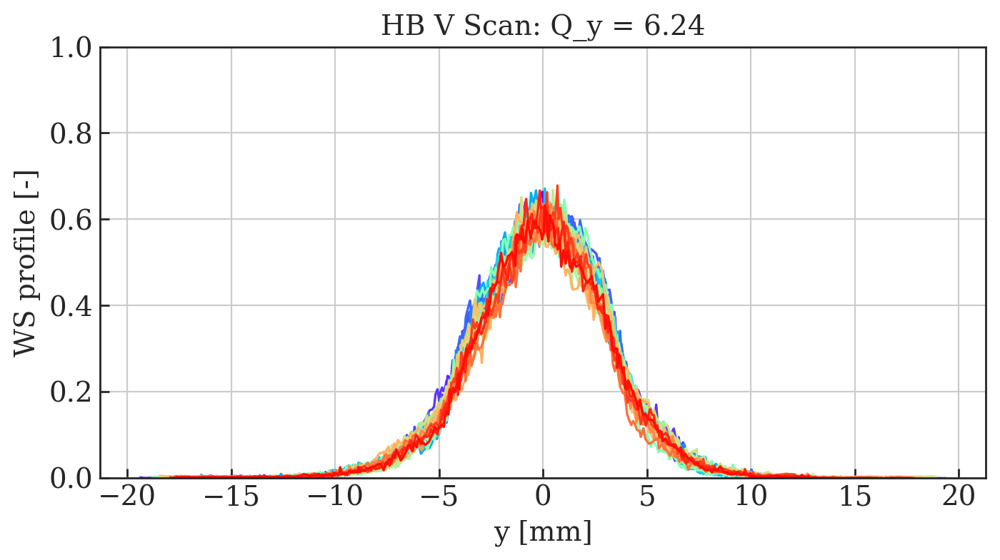

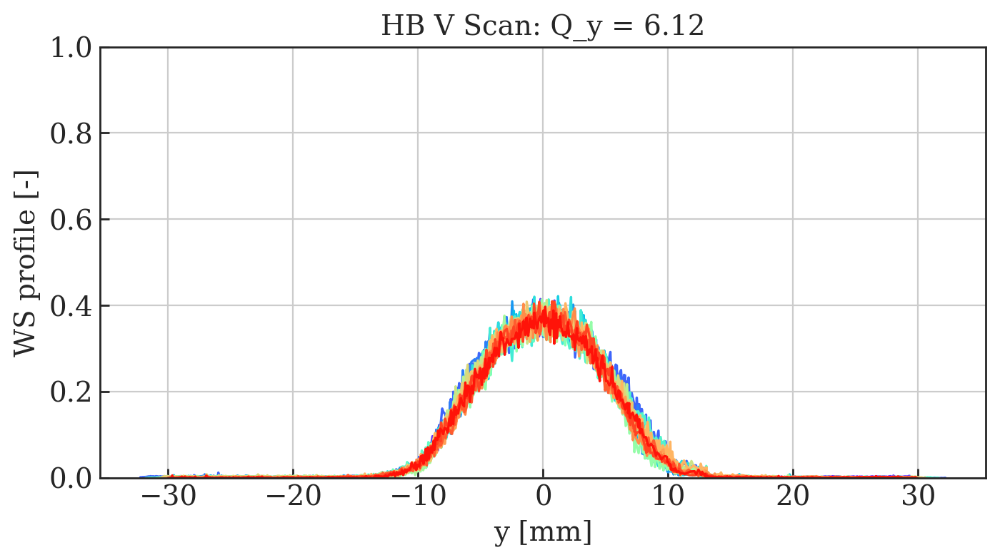

In [12]:
# Plot WS profiles grouped by Qx
for key, value in tune_points.iteritems():
    fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
    for i in xrange(len(value)):
        # dataframe index = value[i]
        plt.plot(df0['position V'].iloc[value[i]], df0['profile V'].iloc[value[i]], color=colors[value[i]])
        #print len(df0['profile V'].iloc[value[i]])
    plt.xlabel('y [mm]')
    plt.ylabel('WS profile [-]')
    title = str('HB V Scan: Q_y = ' + str(key))
    plt.title(title)
    plt.ylim(0, 1)
    plt.grid()
    savename = str('WS_Grouped/MD4224_HB_Vertical_Manual_Fit_WS_Profiles_Qy=' + str(key) + '_Using_Sim_Optics.png')
#     fig.savefig(savename)

In [13]:
path = "./WS_Raw"
make_directory(path)

Creation of the directory ./WS_Raw failed


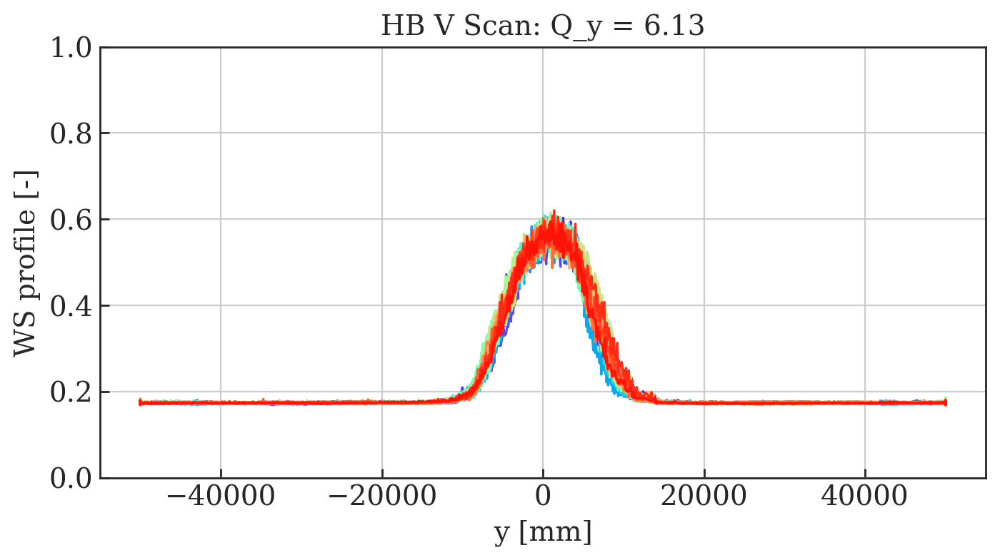

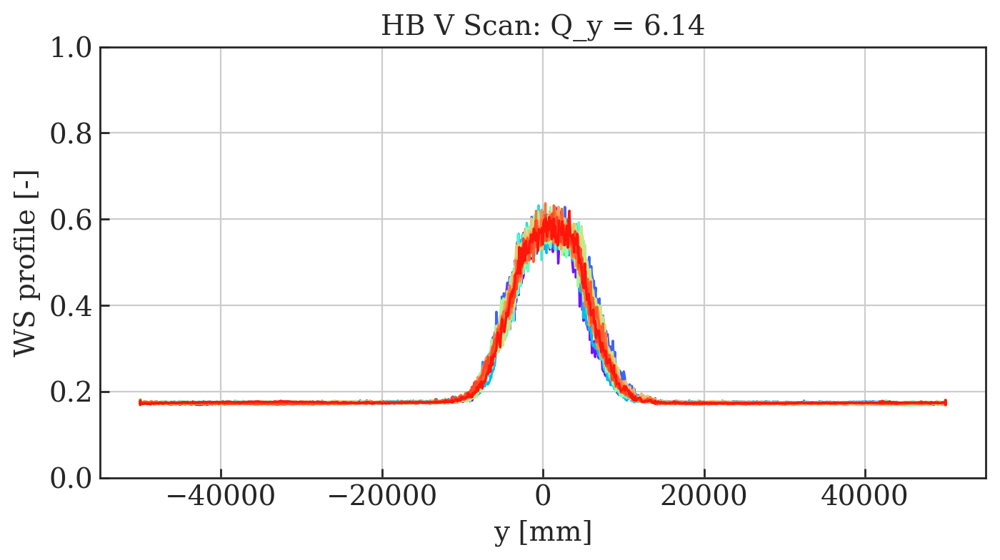

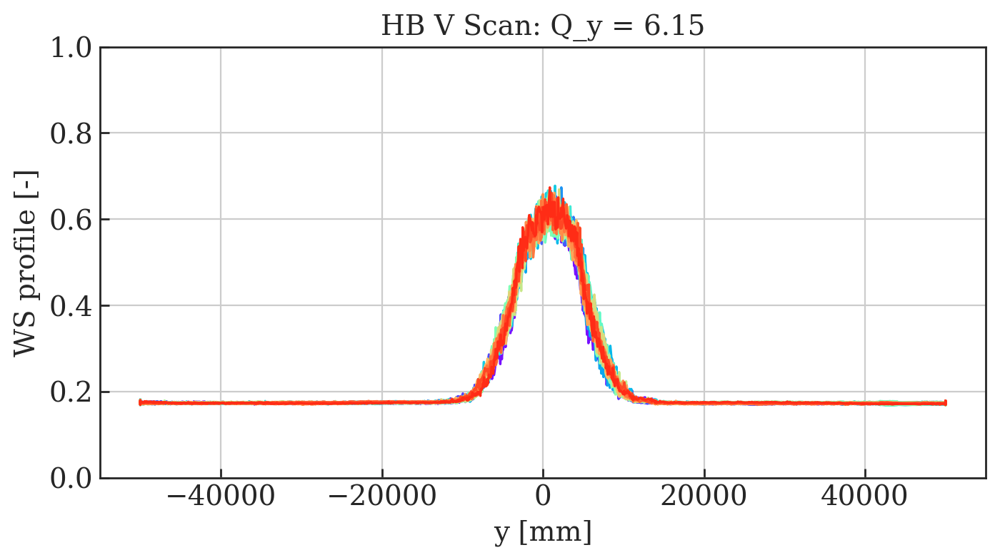

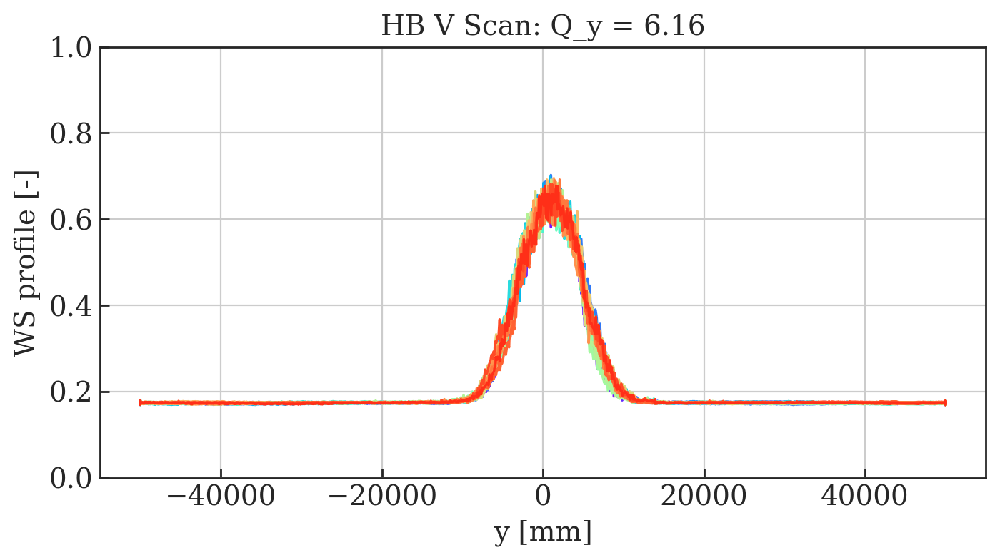

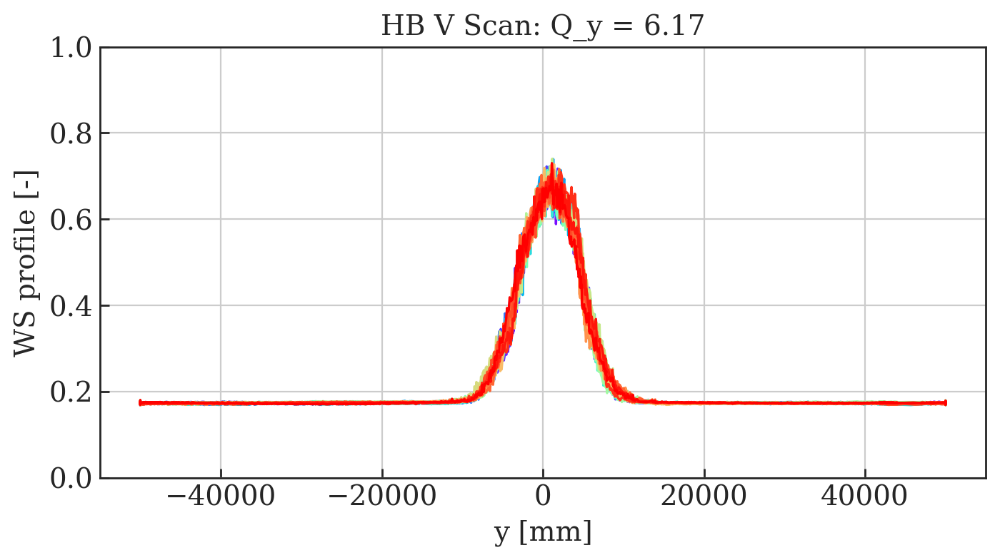

...

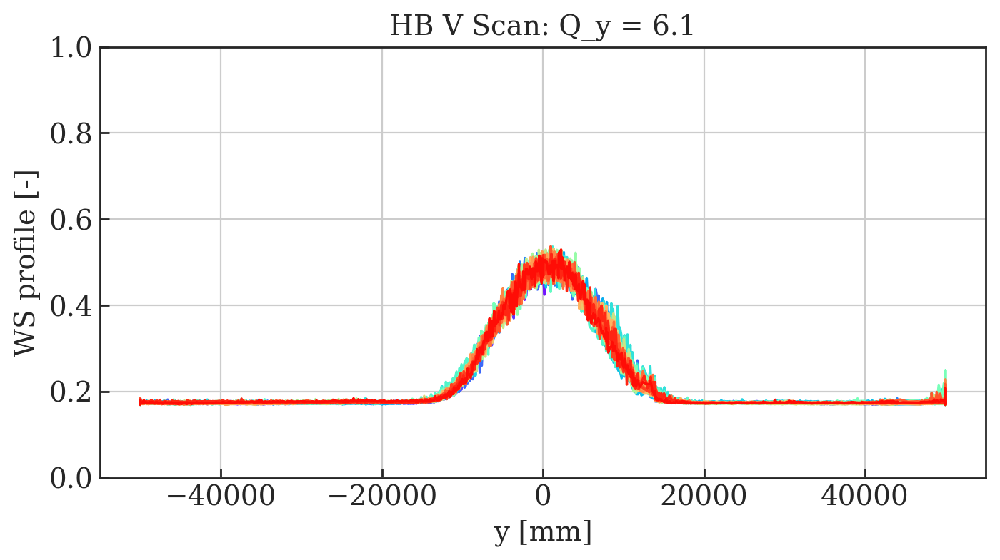

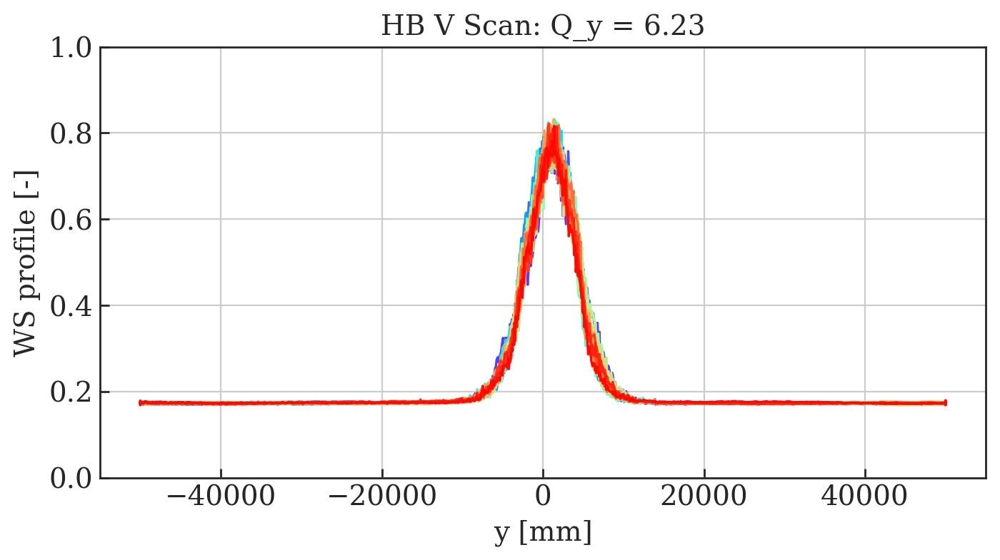

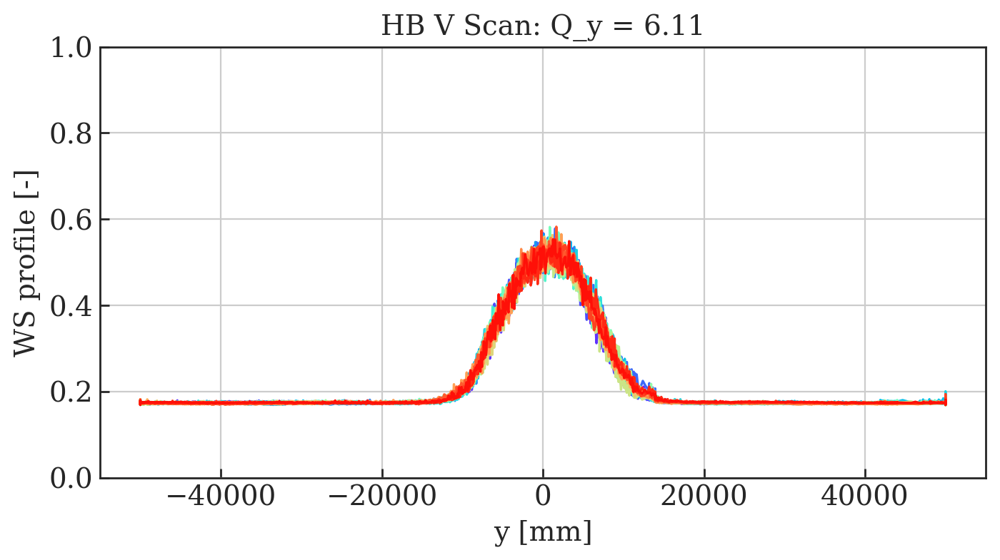

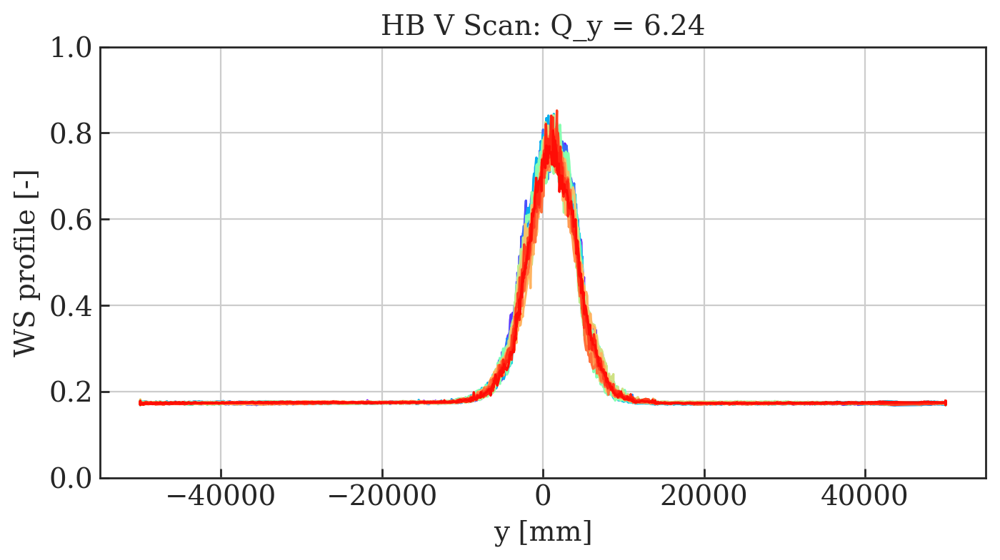

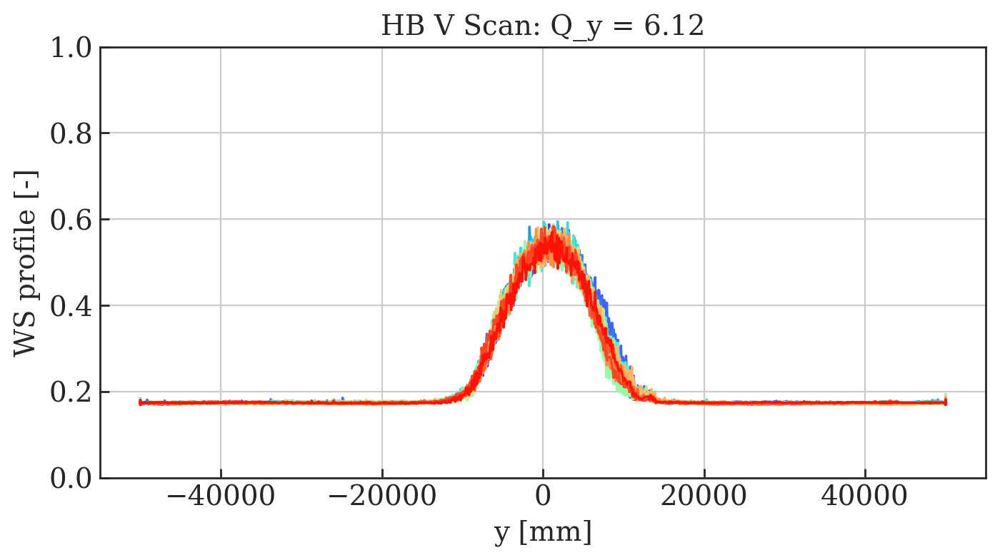

In [59]:
# Plot WS profiles grouped by Qx
for key, value in tune_points.iteritems():
    fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
    for i in xrange(len(value)):
        # dataframe index = value[i]
        plt.plot(df0['PR.BWS.64.V_ROT:PROF_POSITION_IN'].iloc[value[i]], df0['PR.BWS.64.V_ROT:PROF_DATA_IN'].iloc[value[i]], color=colors[value[i]])
    plt.xlabel('y [mm]')
    plt.ylabel('WS profile [-]')
    title = str('HB V Scan: Q_y = ' + str(key))
    plt.title(title)
    plt.ylim(0, 1)
    plt.grid()
    savename = str('WS_Raw/MD4224_HB_Vertical_Manual_Fit_WS_Profiles_Raw_Qy=' + str(key) + '_Using_Sim_Optics.png')
#     fig.savefig(savename)

# Plot Raw Data Points

In [60]:
path = "./Raw_Data"
make_directory(path)

Creation of the directory ./Raw_Data failed


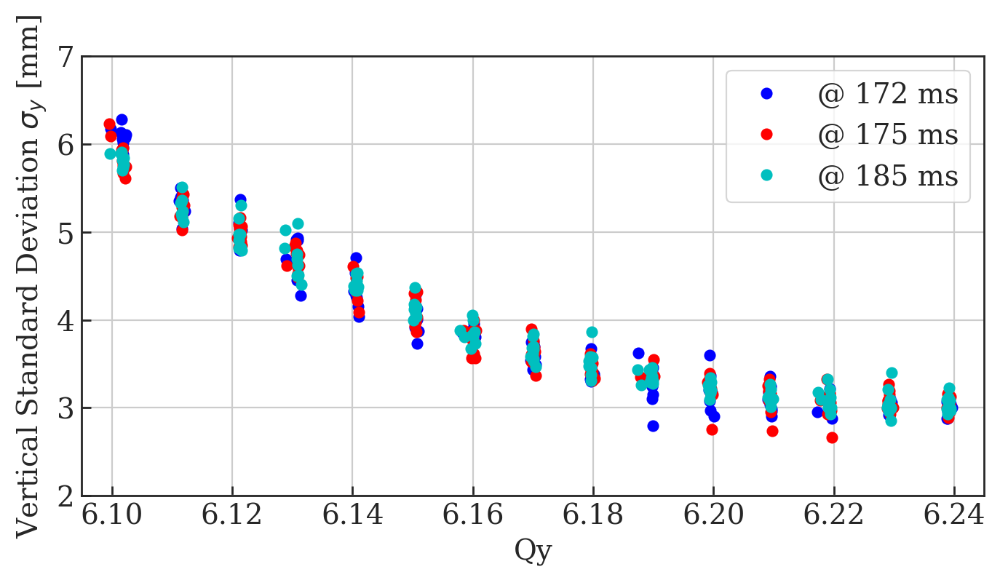

In [61]:
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)]+6, df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)],'bo', label='@ 172 ms');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)]+6, df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)],'ro', label='@ 175 ms');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)]+6, df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)],'co', label='@ 185 ms');
plt.xlabel('Qy');
plt.ylabel(r'Vertical Standard Deviation $\sigma_y$ [mm]');
plt.legend();
#plt.title('Wire Scanner Acquisition Delay');
#plt.xlim(6.075, 6.25);
plt.ylim(2.0, 7.0);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)
plt.grid();
fig.savefig('Raw_Data/MD4224_Vertical_Manual_Fit_WS_Delay_Sigma_Using_Sim_Optics.png');

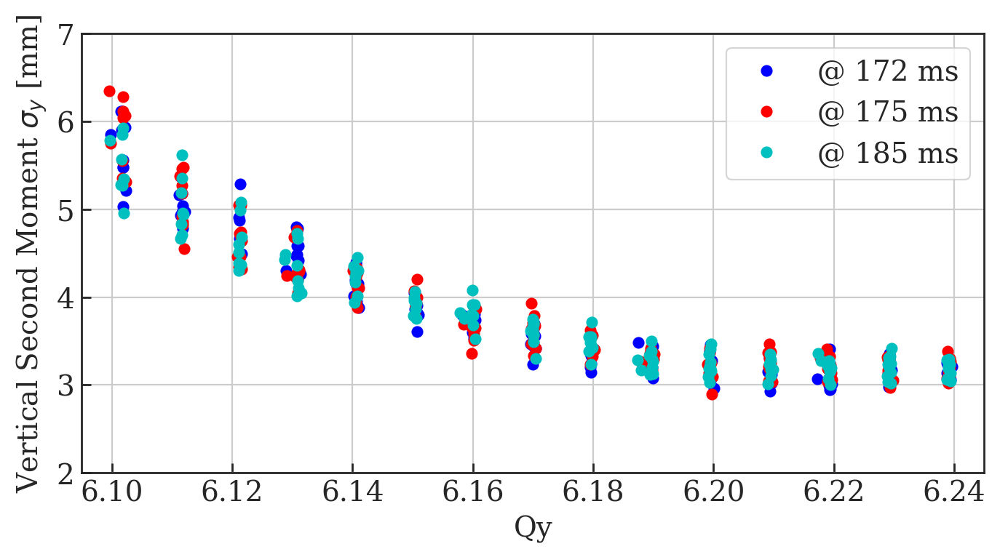

In [62]:
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)]+6, df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)],'bo', label='@ 172 ms');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)]+6, df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)],'ro', label='@ 175 ms');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)]+6, df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)],'co', label='@ 185 ms');
plt.xlabel('Qy');
plt.ylabel(r'Vertical Second Moment $\sigma_y$ [mm]');
plt.legend();
#plt.title('Wire Scanner Acquisition Delay');
#plt.xlim(6.075, 6.25);
plt.ylim(2.0, 7.0);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)
plt.grid();
fig.savefig('Raw_Data/MD4224_Vertical_Manual_Fit_WS_Delay_Second_Moment_Using_Sim_Optics.png');

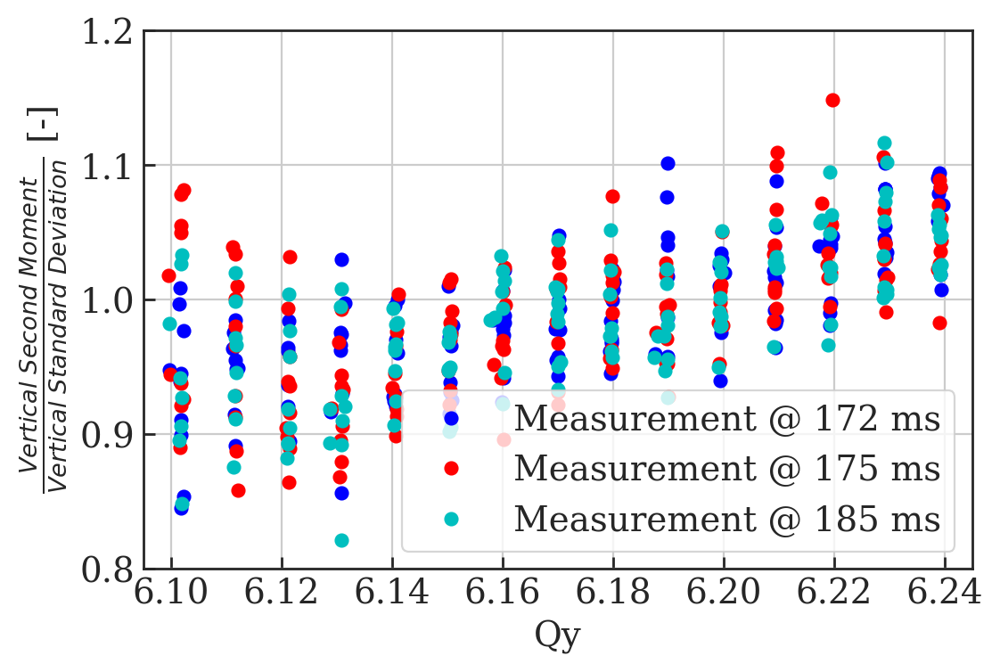

In [20]:
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)]+6, df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)]/df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)],'bo', label='Measurement @ 172 ms');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)]+6, df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)]/df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)],'ro', label='Measurement @ 175 ms');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)]+6, df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)]/df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)],'co', label='Measurement @ 185 ms');
plt.xlabel('Qy');
plt.ylabel(r'$\frac{Vertical\ Second\ Moment}{Vertical\ Standard\ Deviation}$ [-]');
plt.legend(loc=4);
#plt.title('Wire Scanner Acquisition Delay');
#plt.xlim(6.075, 6.25);
plt.ylim(0.8, 1.2);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)
plt.grid();
fig.savefig('Raw_Data/MD4224_Vertical_Manual_Fit_WS_Delay_Gaussianness_Using_Sim_Optics.png');

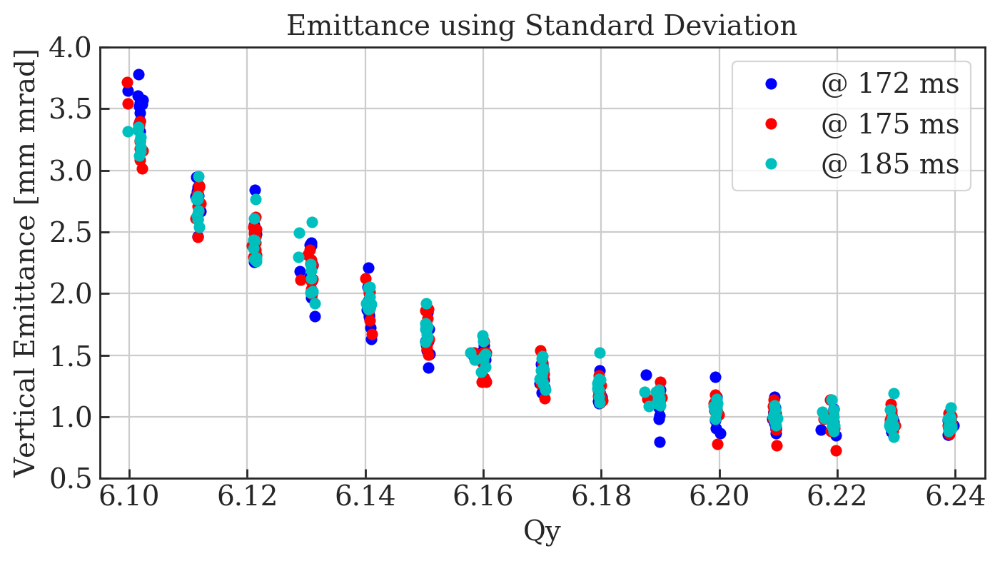

In [64]:
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)]+6, df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)],'bo', label='@ 172 ms');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)]+6, df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)],'ro', label='@ 175 ms');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)]+6, df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)],'co', label='@ 185 ms');
plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');
plt.legend();
plt.title('Emittance using Standard Deviation');
#plt.xlim(6.075, 6.25);
plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)
plt.grid();
fig.savefig('Raw_Data/MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_Using_Sim_Optics.png');

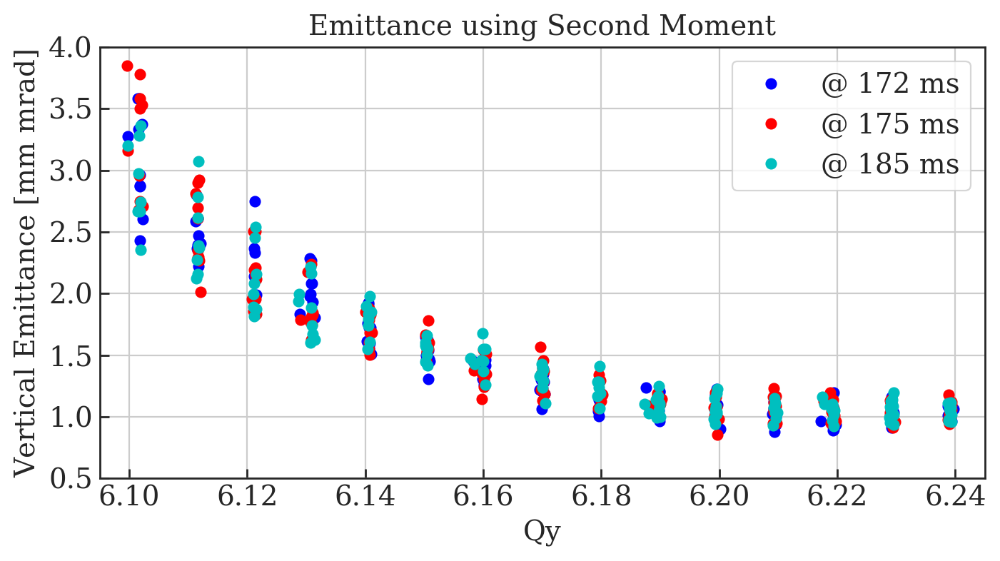

In [65]:
# Plot each shot: Qy vs Ey

fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)]+6, df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)],'bo', label='@ 172 ms');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)]+6, df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)],'ro', label='@ 175 ms');
plt.plot(df0['Qy'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)]+6, df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)],'co', label='@ 185 ms');
plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');
plt.legend();
plt.title('Emittance using Second Moment');
#plt.xlim(6.075, 6.25);
plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)
plt.grid();
fig.savefig('Raw_Data/MD4224_Horizontal_WS_Delay_Emittance_2nd_Moment_Using_Sim_Optics.png');

# Group Plots by tune

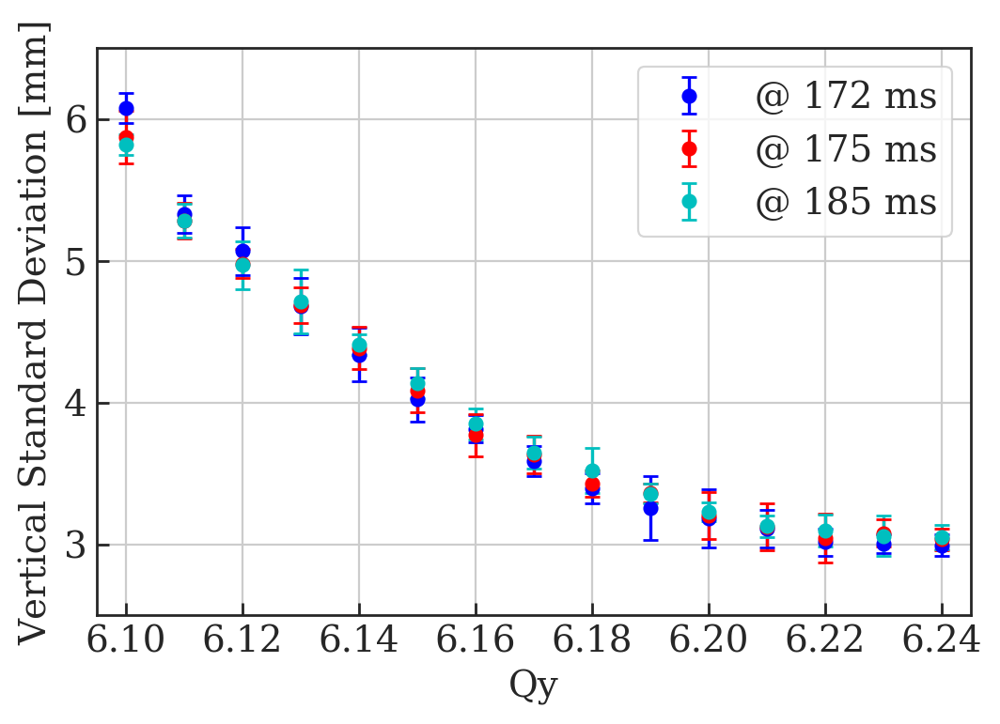

In [7]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

data = 'sig V'

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_175.append( np.mean( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_185.append( np.mean( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_175.append( np.std( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_185.append( np.std( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    
plt.errorbar(x_data, y_data_172, y_error_172, label='@ 172 ms', linestyle='None', marker='o', capsize=3, color='b')
plt.errorbar(x_data, y_data_175, y_error_175, label='@ 175 ms', linestyle='None', marker='o', capsize=3, color='r')
plt.errorbar(x_data, y_data_185, y_error_185, label='@ 185 ms', linestyle='None', marker='o', capsize=3, color='c')

plt.xlabel('Qy');
plt.ylabel('Vertical Standard Deviation [mm]');

#plt.title('Standard Deviation')

plt.ylim(2.5, 6.5)
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Grouped_By_Tune/MD4224_Vertical_Manual_Fit_WS_Delay_Sig_Errors_Using_Sim_Optics.png');

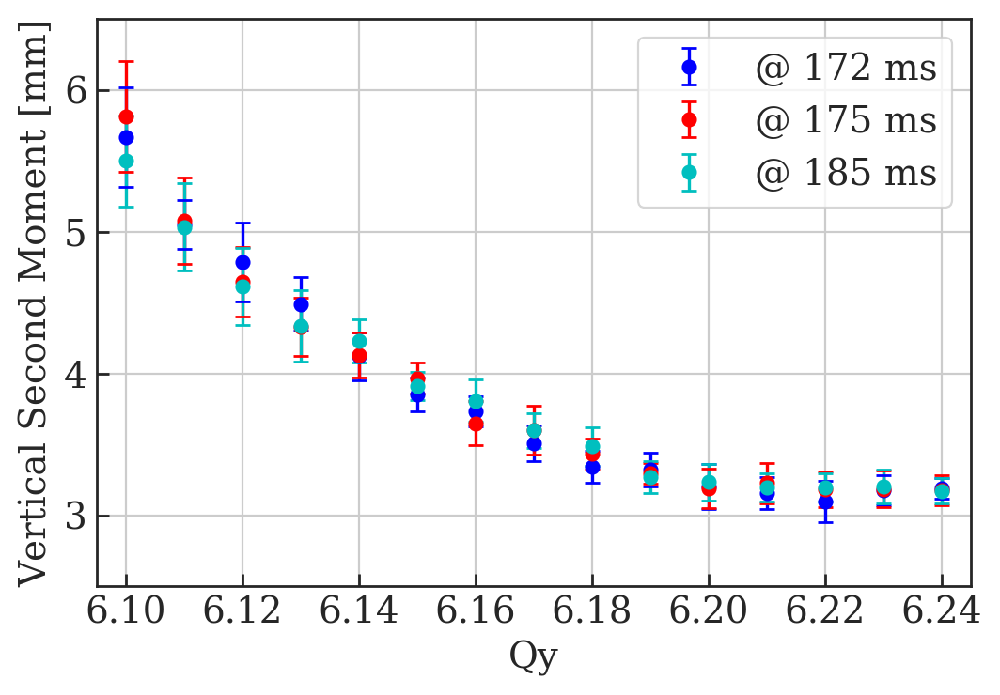

In [8]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

data = '2ndMoment V'

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_175.append( np.mean( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_185.append( np.mean( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_175.append( np.std( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_185.append( np.std( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    
plt.errorbar(x_data, y_data_172, y_error_172, label='@ 172 ms', linestyle='None', marker='o', capsize=3, color='b')
plt.errorbar(x_data, y_data_175, y_error_175, label='@ 175 ms', linestyle='None', marker='o', capsize=3, color='r')
plt.errorbar(x_data, y_data_185, y_error_185, label='@ 185 ms', linestyle='None', marker='o', capsize=3, color='c')

plt.xlabel('Qy');
plt.ylabel('Vertical Second Moment [mm]');

#plt.title('Second Moment')

plt.ylim(2.5, 6.5)
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Grouped_By_Tune/MD4224_Vertical_Manual_Fit_WS_Delay_Second_Moment_Errors_Using_Sim_Optics.png');

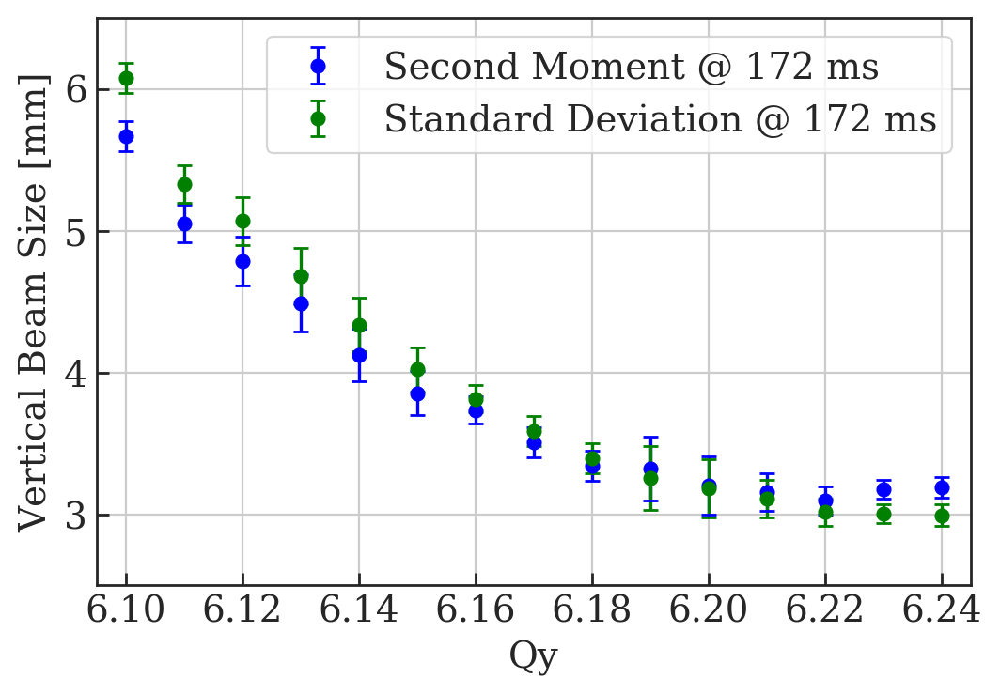

In [10]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172_2 = []
y_error_172_2 = []
y_data_172 = []
y_error_172 = []

data = 'sig V'
data_2 = '2ndMoment V'

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172_2.append( np.mean( df0[data_2][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172_2.append( np.std( df0[data_2][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_data_172.append( np.mean( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0[data][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
        
plt.errorbar(x_data, y_data_172_2, y_error_172, label='Second Moment @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')
plt.errorbar(x_data, y_data_172, y_error_172, label='Standard Deviation @ 172 ms', linestyle='None', marker='o', capsize=3, color='g')

plt.xlabel('Qy');
plt.ylabel('Vertical Beam Size [mm]');
#plt.title('')

#plt.title(r'$\epsilon_{x,y} = \beta\gamma \frac{\sigma^2}{\beta_{x,y}(s)}$')

plt.ylim(2.5, 6.5)
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Grouped_By_Tune/MD4224_Vertical_Manual_Fit_WS_Delay_Beam_Size_cf_Errors_Using_Sim_Optics_172.png');

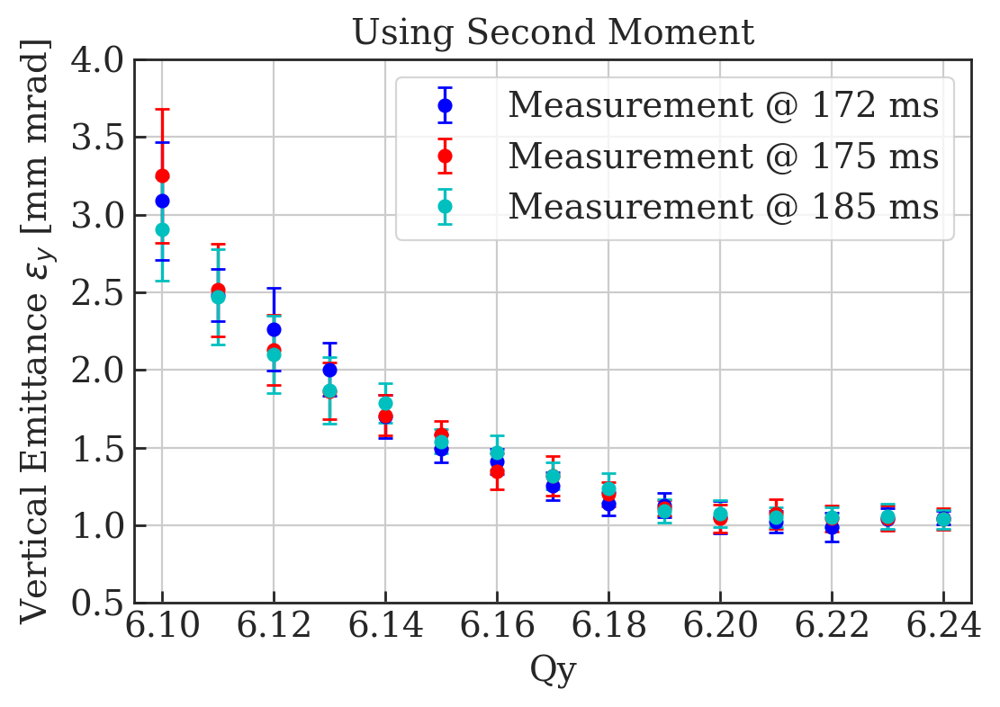

In [69]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_175.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_185.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_175.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_185.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')
plt.errorbar(x_data, y_data_175, y_error_175, label='Measurement @ 175 ms', linestyle='None', marker='o', capsize=3, color='r')
plt.errorbar(x_data, y_data_185, y_error_185, label='Measurement @ 185 ms', linestyle='None', marker='o', capsize=3, color='c')

plt.xlabel('Qy');
plt.ylabel(r'Vertical Emittance $\epsilon_y$ [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')
plt.title('Using Second Moment')

plt.ylim(0.5, 4)
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Grouped_By_Tune/MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics.png');

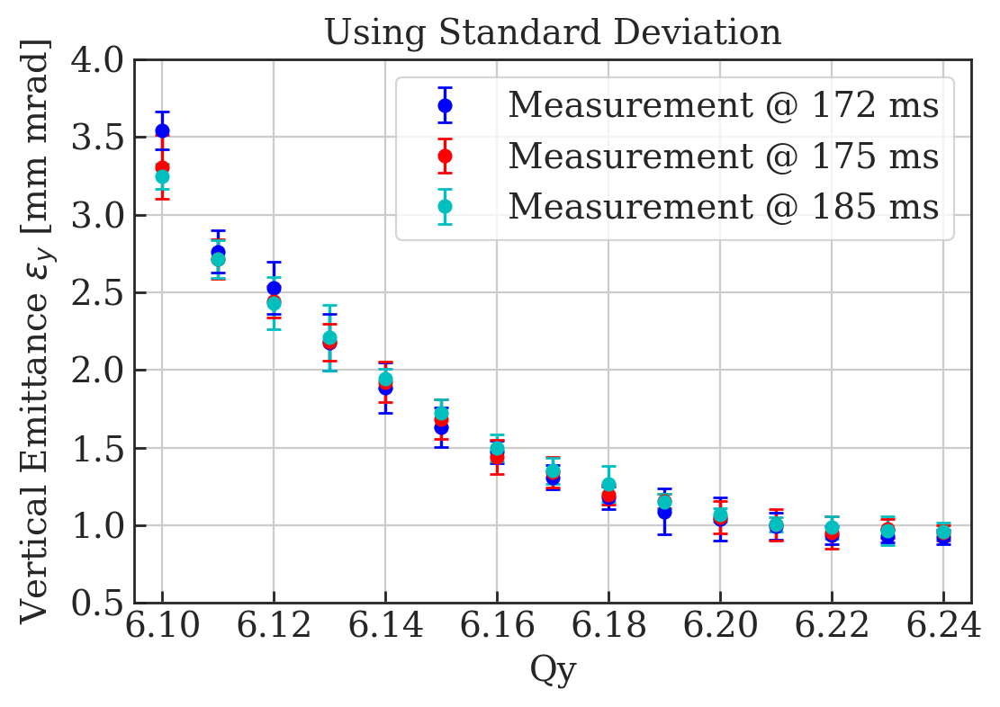

In [70]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_175.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_185.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_175.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_185.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')
plt.errorbar(x_data, y_data_175, y_error_175, label='Measurement @ 175 ms', linestyle='None', marker='o', capsize=3, color='r')
plt.errorbar(x_data, y_data_185, y_error_185, label='Measurement @ 185 ms', linestyle='None', marker='o', capsize=3, color='c')

plt.xlabel('Qy');
plt.ylabel(r'Vertical Emittance $\epsilon_y$ [mm mrad]');
plt.title('Using Standard Deviation')

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4)
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Grouped_By_Tune/00_MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_Errors_Using_Sim_Optics.png');

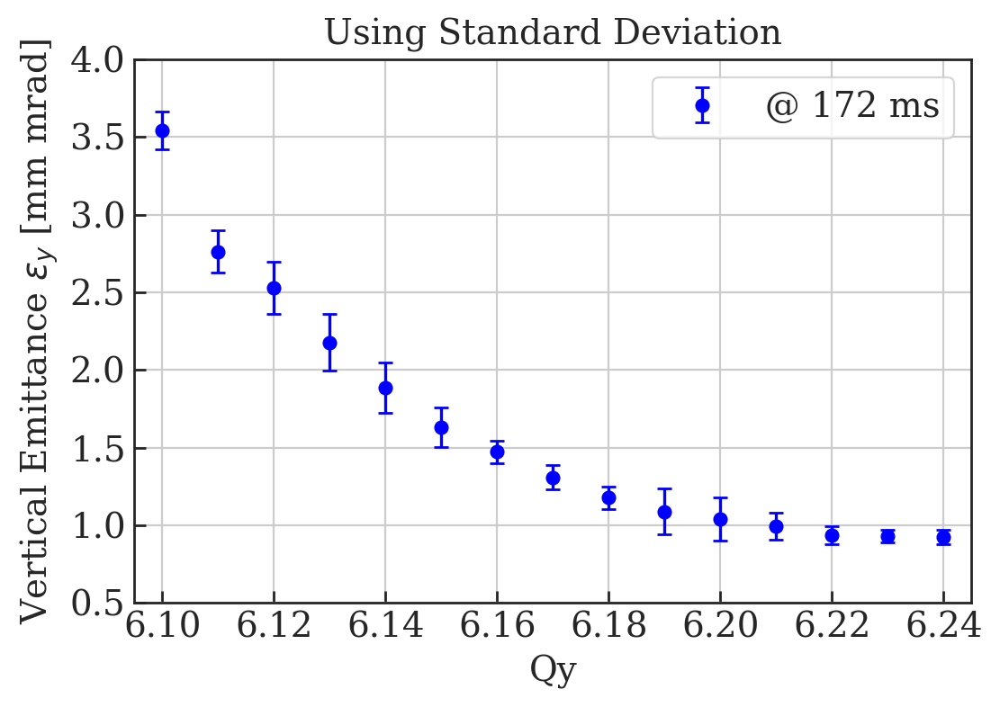

In [71]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
        
plt.errorbar(x_data, y_data_172, y_error_172, label='@ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.xlabel('Qy');
plt.ylabel(r'Vertical Emittance $\epsilon_y$ [mm mrad]');
plt.title('Using Standard Deviation')

#plt.title(r'$\epsilon_{x,y} = \beta\gamma \frac{\sigma^2}{\beta_{x,y}(s)}$')

plt.ylim(0.5, 4)
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Grouped_By_Tune/MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_Errors_Using_Sim_Optics_172.png');

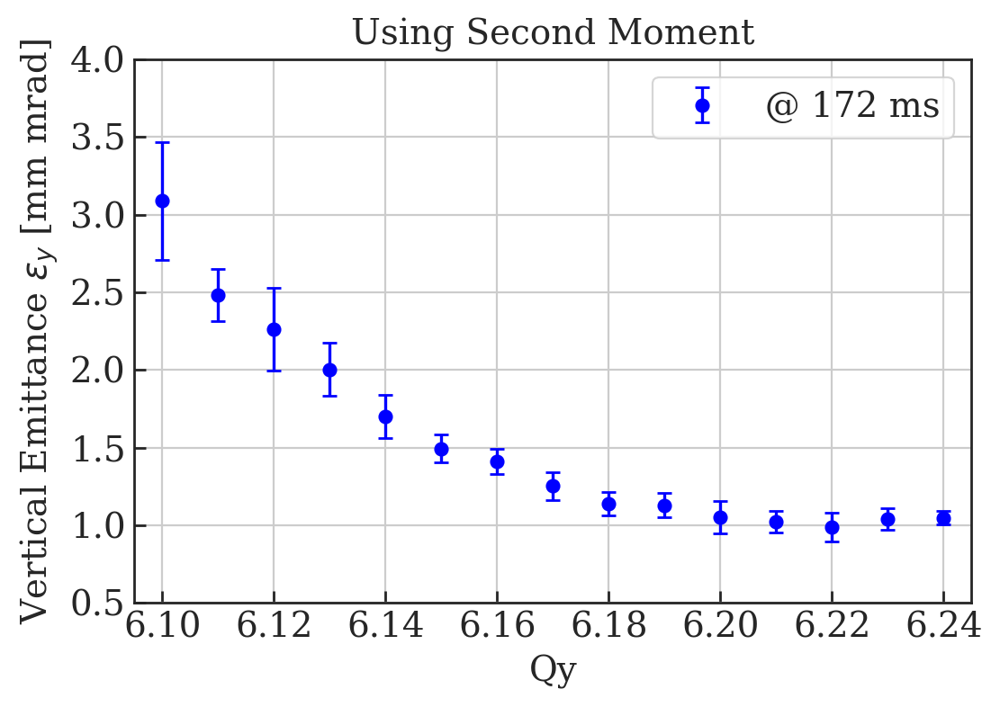

In [72]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
        
plt.errorbar(x_data, y_data_172, y_error_172, label='@ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.xlabel('Qy');
plt.ylabel(r'Vertical Emittance $\epsilon_y$ [mm mrad]');
plt.title('Using Second Moment')

#plt.title(r'$\epsilon_{x,y} = \beta\gamma \frac{\sigma^2}{\beta_{x,y}(s)}$')

plt.ylim(0.5, 4)
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Grouped_By_Tune/MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics_172.png');

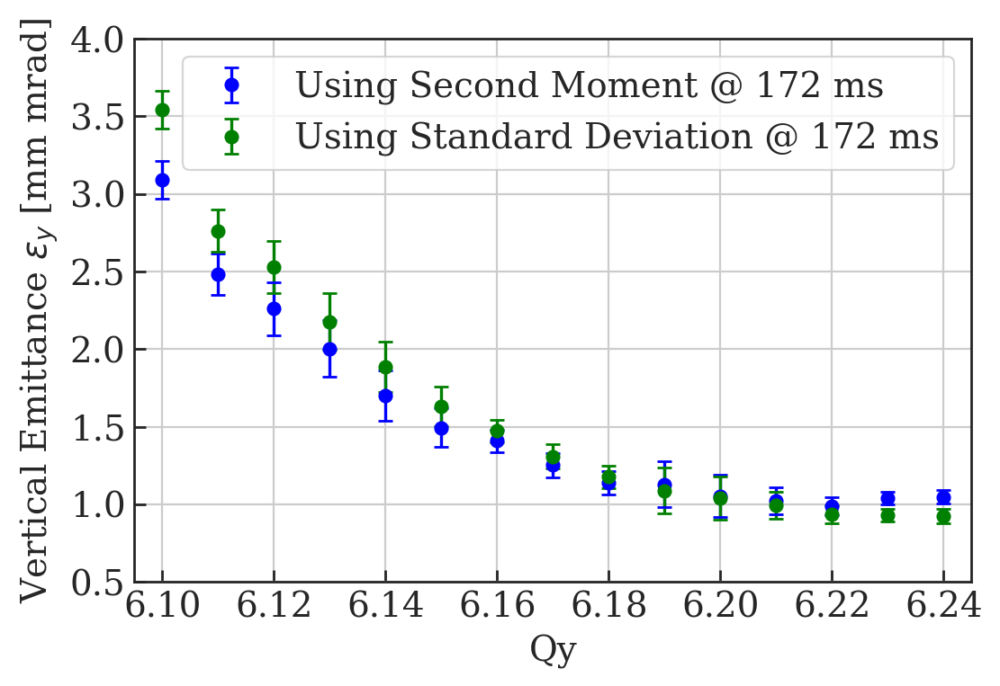

In [73]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172_2 = []
y_error_172_2 = []
y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172_2.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172_2.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
        
plt.errorbar(x_data, y_data_172_2, y_error_172, label='Using Second Moment @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')
plt.errorbar(x_data, y_data_172, y_error_172, label='Using Standard Deviation @ 172 ms', linestyle='None', marker='o', capsize=3, color='g')

plt.xlabel('Qy');
plt.ylabel(r'Vertical Emittance $\epsilon_y$ [mm mrad]');
#plt.title('')

#plt.title(r'$\epsilon_{x,y} = \beta\gamma \frac{\sigma^2}{\beta_{x,y}(s)}$')

plt.ylim(0.5, 4)
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Grouped_By_Tune/MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_cf_Errors_Using_Sim_Optics_172.png');

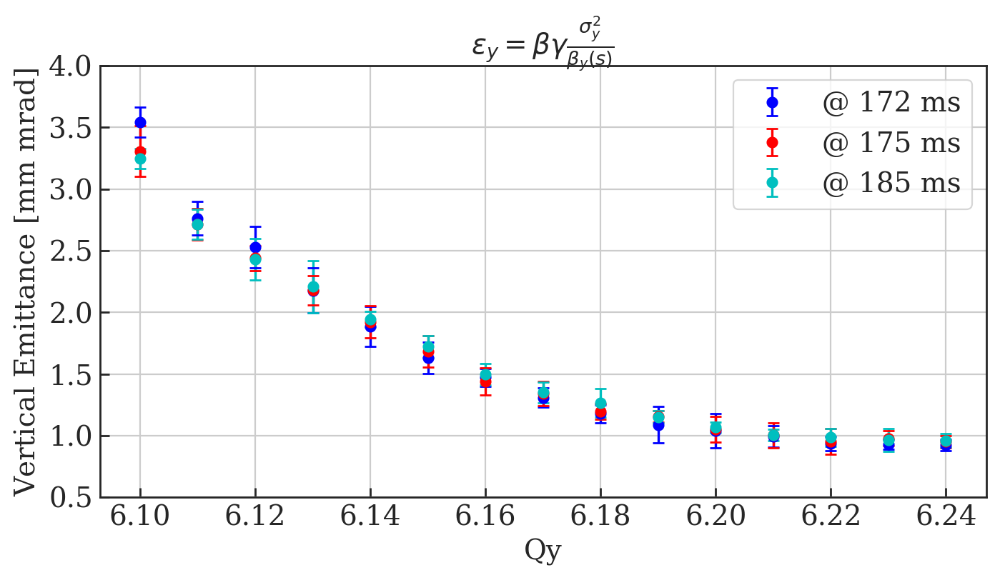

In [74]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_175.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_185.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_175.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_185.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    
plt.errorbar(x_data, y_data_172, y_error_172, label='@ 172 ms', linestyle='None', marker='o', capsize=3, color='b')
plt.errorbar(x_data, y_data_175, y_error_175, label='@ 175 ms', linestyle='None', marker='o', capsize=3, color='r')
plt.errorbar(x_data, y_data_185, y_error_185, label='@ 185 ms', linestyle='None', marker='o', capsize=3, color='c')

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\sigma_y^2}{\beta_{y}(s)}$')

plt.ylim(0.5, 4)

plt.legend();
plt.grid();
fig.savefig('MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_Errors_Using_Sim_Optics.png');

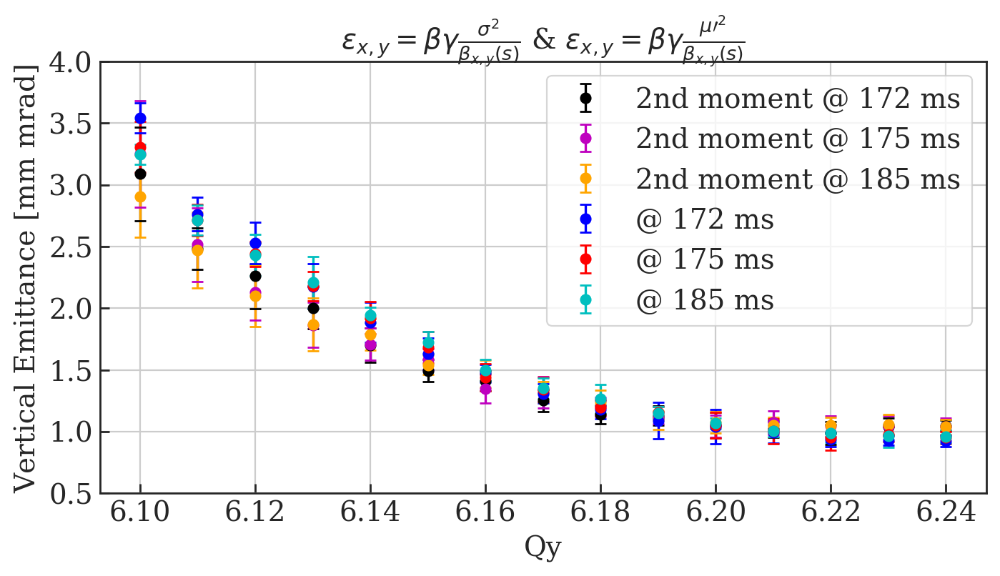

In [75]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

y_data_1722 = []
y_data_1752 = []
y_data_1852 = []

y_error_1722 = []
y_error_1752 = []
y_error_1852 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_175.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_185.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_175.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_185.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_data_1722.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_1752.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_1852.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_error_1722.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_1752.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_1852.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    
plt.errorbar(x_data, y_data_1722, y_error_1722, label='2nd moment @ 172 ms', linestyle='None', marker='o', capsize=3, color='k')
plt.errorbar(x_data, y_data_1752, y_error_1752, label='2nd moment @ 175 ms', linestyle='None', marker='o', capsize=3, color='m')
plt.errorbar(x_data, y_data_1852, y_error_1852, label='2nd moment @ 185 ms', linestyle='None', marker='o', capsize=3, color='orange')

    
plt.errorbar(x_data, y_data_172, y_error_172, label='@ 172 ms', linestyle='None', marker='o', capsize=3, color='b')
plt.errorbar(x_data, y_data_175, y_error_175, label='@ 175 ms', linestyle='None', marker='o', capsize=3, color='r')
plt.errorbar(x_data, y_data_185, y_error_185, label='@ 185 ms', linestyle='None', marker='o', capsize=3, color='c')

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

plt.title(r'$\epsilon_{x,y} = \beta\gamma \frac{\sigma^2}{\beta_{x,y}(s)}$ & $\epsilon_{x,y} = \beta\gamma \frac{\mu\prime^2}{\beta_{x,y}(s)}$')

plt.ylim(0.5, 4);
plt.legend();
plt.grid();
fig.savefig('MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_both_Errors_Using_Sim_Optics.png');

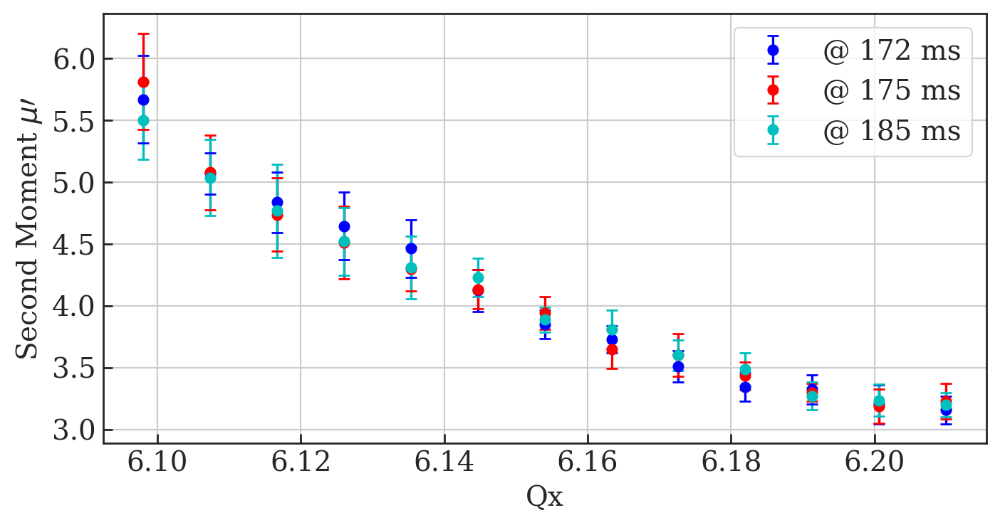

In [76]:
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
# Plot averaged data points with error bars
x_data = np.linspace(607, 621, 16);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_175.append( np.mean( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_185.append( np.mean( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_175.append( np.std( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_185.append( np.std( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    
plt.errorbar(x_data, y_data_172, y_error_172, label='@ 172 ms', linestyle='None', marker='o', capsize=3, color='b')
plt.errorbar(x_data, y_data_175, y_error_175, label='@ 175 ms', linestyle='None', marker='o', capsize=3, color='r')
plt.errorbar(x_data, y_data_185, y_error_185, label='@ 185 ms', linestyle='None', marker='o', capsize=3, color='c')

plt.xlabel('Qx');
plt.ylabel(r'Second Moment $\mu\prime$');

plt.legend();
plt.grid();
fig.savefig('MD4224_Vertical_Manual_Fit_WS_Delay_2nd_Moment_Errors_Using_Sim_Optics.png');

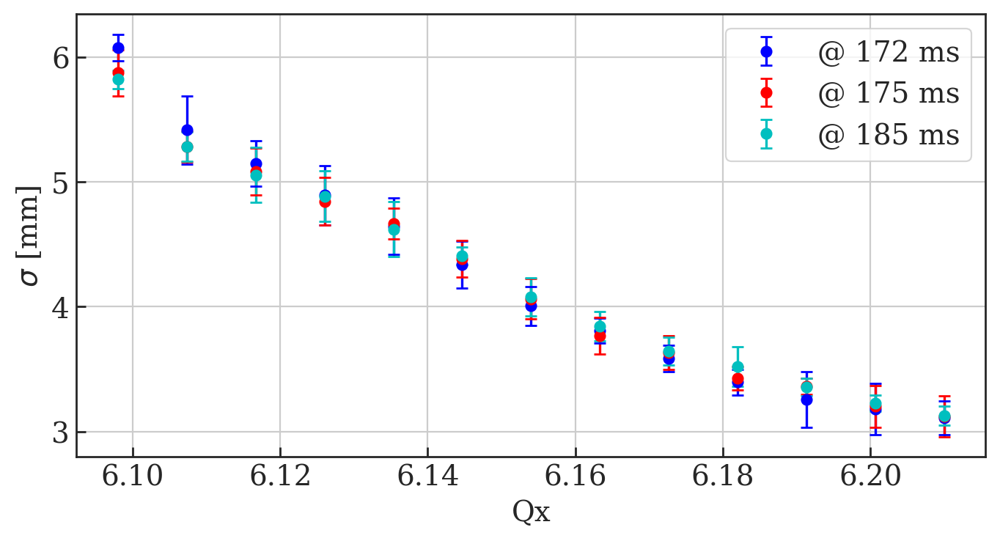

In [77]:
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
# Plot averaged data points with error bars
x_data = np.linspace(607, 621, 16);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_175.append( np.mean( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_185.append( np.mean( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_175.append( np.std( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_185.append( np.std( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    
plt.errorbar(x_data, y_data_172, y_error_172, label='@ 172 ms', linestyle='None', marker='o', capsize=3, color='b')
plt.errorbar(x_data, y_data_175, y_error_175, label='@ 175 ms', linestyle='None', marker='o', capsize=3, color='r')
plt.errorbar(x_data, y_data_185, y_error_185, label='@ 185 ms', linestyle='None', marker='o', capsize=3, color='c')

plt.xlabel('Qx');
plt.ylabel(r'$\sigma$ [mm]');

plt.legend();
plt.grid();
fig.savefig('MD4224_Vertical_Manual_Fit_WS_Delay_Sigma_Errors_Using_Sim_Optics.png');

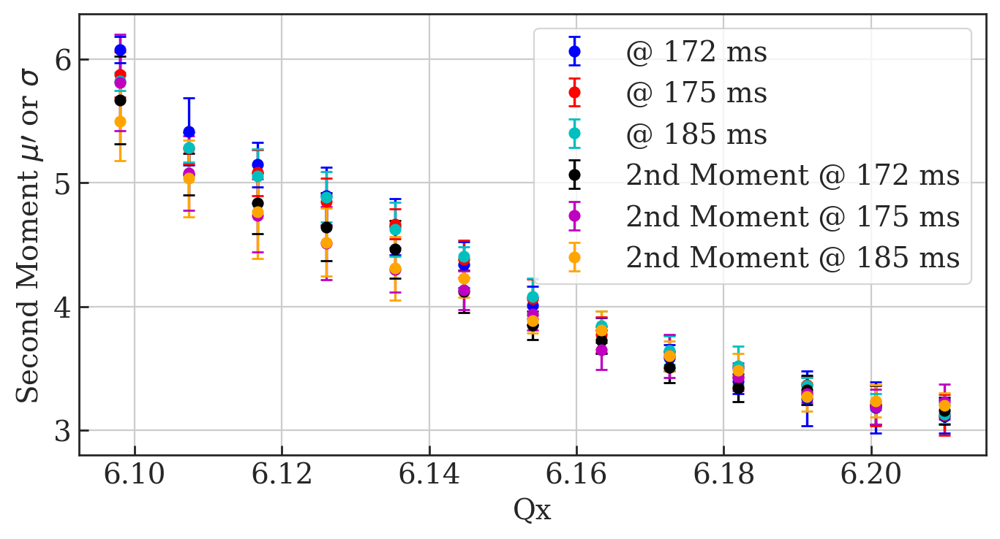

In [78]:
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
# Plot averaged data points with error bars
x_data = np.linspace(607, 621, 16);
x_data = x_data/100;

y_data_172 = []
y_data_175 = []
y_data_185 = []

y_error_172 = []
y_error_175 = []
y_error_185 = []

y_data_1722 = []
y_data_1752 = []
y_data_1852 = []

y_error_1722 = []
y_error_1752 = []
y_error_1852 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_1722.append( np.mean( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_1752.append( np.mean( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_1852.append( np.mean( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_error_1722.append( np.std( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_1752.append( np.std( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_1852.append( np.std( df0['2ndMoment V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_data_172.append( np.mean( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_175.append( np.mean( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_data_185.append( np.mean( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    y_error_172.append( np.std( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_175.append( np.std( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==175)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_185.append( np.std( df0['sig V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==185)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
    
plt.errorbar(x_data, y_data_172, y_error_172, label='@ 172 ms', linestyle='None', marker='o', capsize=3, color='b')
plt.errorbar(x_data, y_data_175, y_error_175, label='@ 175 ms', linestyle='None', marker='o', capsize=3, color='r')
plt.errorbar(x_data, y_data_185, y_error_185, label='@ 185 ms', linestyle='None', marker='o', capsize=3, color='c')

    
plt.errorbar(x_data, y_data_1722, y_error_1722, label='2nd Moment @ 172 ms', linestyle='None', marker='o', capsize=3, color='k')
plt.errorbar(x_data, y_data_1752, y_error_1752, label='2nd Moment @ 175 ms', linestyle='None', marker='o', capsize=3, color='m')
plt.errorbar(x_data, y_data_1852, y_error_1852, label='2nd Moment @ 185 ms', linestyle='None', marker='o', capsize=3, color='orange')

plt.xlabel('Qx');
plt.ylabel(r'Second Moment $\mu\prime$ or $\sigma$');

plt.legend();
plt.grid();
fig.savefig('MD4224_Vertical_Manual_Fit_WS_Delay_2nd_Moment_and_Sigma_Errors_Using_Sim_Optics.png');

In [79]:
np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>.05)][(df0['Qy']<.1045)] )

3.5406945919238786

# Load Distributions From Simulation Data

In [10]:
# Read .mat files into a dictionary

# matfiles = glob.glob("13_May/*.mat")
#matfiles = glob.glob("../Simulation_Output/V_Scan_Matched_Initial/Bunch_Profiles/*.mat")
matfiles = glob.glob("../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/*.mat")
sims = dict()

for f in matfiles:
    first = f.split('/')[-1]
    second = first.split('.')[0]
    sims[str(second)] = f
    
sims

{'610_SbS_c172': '../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/610_SbS_c172.mat',
 '611_SbS_c172': '../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/611_SbS_c172.mat',
 '612_SbS_c172': '../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/612_SbS_c172.mat',
 '613_SbS_c172': '../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/613_SbS_c172.mat',
 '614_SbS_c172': '../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/614_SbS_c172.mat',
 '615_SbS_c172': '../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/615_SbS_c172.mat',
 '616_SbS_c172': '../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/616_SbS_c172.mat',
 '617_SbS_c172': '../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/617_SbS_c172.mat',
 '618_SbS_c172': '../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/618_SbS_c172.mat',
 '619_SbS_c172': '../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/619_SbS_c172.mat',
 '620_SbS_c172': '../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/620_SbS

# Dictionary of tune points

In [11]:
# These are our tune points:
scan_points = np.linspace(610, 624, 15);
scan_points = scan_points/100;

Qy_points=[]
for i in scan_points:
    Qy_points.append(round_sig(i,5))
print Qy_points

[6.1, 6.11, 6.12, 6.13, 6.14, 6.15, 6.16, 6.17, 6.18, 6.19, 6.2, 6.21, 6.22, 6.23, 6.24]


In [12]:
# Make dictionary of nearest tune point and iterators
Qy_point_separation = Qy_points[1] - Qy_points[0]
Qy_pt_sep = Qy_point_separation/2
print 'Tune points separated by +/- ', Qy_pt_sep

tune_points = {}
for i in Qy_points:
    tune_points[i] = np.where(np.logical_and(np.greater_equal(df0['Qy'], (i-Qy_pt_sep-6)), np.less_equal(df0['Qy'], (i+Qy_pt_sep-6)) ) )[0]
tune_points

Tune points separated by +/-  0.005


{6.1: array([ 13,  28,  42,  57,  72,  99, 114, 129, 144, 159, 173, 186, 201,
        214, 228, 243, 258, 272, 286, 300, 314, 329, 343, 356, 371, 384,
        397, 410]),
 6.11: array([ 12,  27,  41,  56,  71,  86,  98, 113, 128, 143, 158, 172, 200,
        227, 242, 257, 271, 285, 299, 313, 328, 342, 370, 383, 396, 409]),
 6.12: array([ 26,  55,  70,  85, 112, 127, 142, 157, 171, 185, 199, 213, 226,
        241, 256, 270, 284, 298, 312, 327, 341, 369, 382, 408]),
 6.13: array([ 11,  25,  40,  54,  69,  84,  97, 111, 126, 141, 156, 170, 184,
        198, 212, 225, 240, 255, 269, 283, 297, 311, 326, 340, 355, 368,
        381, 395, 407]),
 6.14: array([ 10,  24,  39,  53,  68,  83,  96, 110, 125, 140, 155, 169, 183,
        197, 211, 224, 239, 254, 268, 296, 310, 325, 339, 354, 367, 380,
        406]),
 6.15: array([  9,  23,  38,  52,  67,  82,  95, 109, 124, 139, 154, 182, 196,
        210, 223, 238, 253, 267, 282, 295, 309, 324, 338, 353, 366, 379,
        394]),
 6.16: array([  8,  

# Function to find Peak

# Test Peakfinder

In [13]:
peak = peakfinder(np.array(df0['position V'].iloc[0]), np.array(df0['profile V'].iloc[0]),tolerance = 0.01, verbose=True)
print peak



	MAX(y_dat) =  0.6638534591783954
	index from y_dat peak not within tolerance of 0.01 mm. 
	try manual search
	index =  192
	index of x_dat =  -0.03379243863650805  is  192
	Mean of peak point +/- 3 points =  0.638239823191498
0.638239823191498


In [53]:
%run ../MD_Functions.ipynb


	Importing MD Analysis functions for MD4224



	MAX(y_dat) =  128.50774890351553
	MAX(y_dat) index =  296
	abs(x_dat[index]) =  0.0015340525504666629
	index =  265
	index of x_dat =  4.3247508477776975e-05  is  265

Taking the average of centre  61  points
	Mean of  61  points about centre =  115.3904000314059
peak @ 115.3904000314059


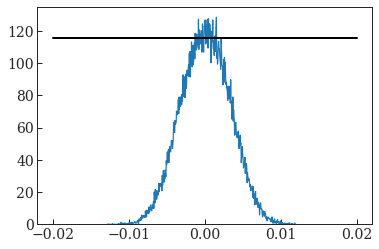

In [47]:
#matfiles = glob.glob("../MD4224_Repo_Outputs/V_Mini_Optimised/Simulation_Profiles/*.mat")
plt.clf()

d = particles_from_matfile("../MD4224_Repo_Outputs/V_Mini_Optimised/Simulation_Profiles/610_SbS_c172.mat")
x, bins_, p = plt.hist(d['particles']['x'][0][0][0], bins = 512, density=True, histtype=u'step', lw=0, color='k')
    
    
peak = peakfinder(np.array(bins_[:-1]), np.array(x), verbose=True)
print 'peak @', peak

plt.plot(bins_[:-1], x);

plt.plot([-0.02, 0.02], [peak, peak], color='k', linestyle='-', linewidth=2)


	MAX(y_dat) =  83.84329494686153
	MAX(y_dat) index =  263
	abs(x_dat[index]) =  1.7857176161727162e-05
	index =  264
	index of x_dat =  4.726431033830192e-05  is  264

Taking the average of centre  61  points
	Mean of  61  points about centre =  72.74172373700127
peak @ 72.74172373700127


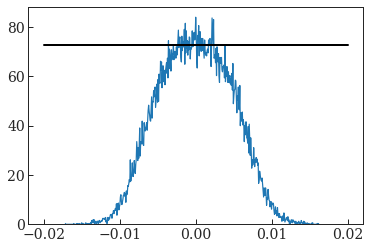

In [48]:
matfiles = glob.glob("../MD4224_Repo_Outputs/V_Mini_Optimised/Simulation_Profiles/*.mat")
plt.clf()

d = particles_from_matfile("../MD4224_Repo_Outputs/V_Mini_Optimised/Simulation_Profiles/611_SbS_c172.mat")
x, bins_, p = plt.hist(d['particles']['y'][0][0][0], bins = 512, density=True, histtype=u'step', lw=0, color='k')
    
    
peak = peakfinder(np.array(bins_[:-1]), np.array(x), verbose=True)
print 'peak @', peak

plt.plot(bins_[:-1], x);

plt.plot([-0.02, 0.02], [peak, peak], color='k', linestyle='-', linewidth=2)


	MAX(y_dat) =  100.59835624220597
	MAX(y_dat) index =  254
	abs(x_dat[index]) =  0.0009749824845887538
	index =  270
	index of x_dat =  2.3840992785784804e-05  is  270

Taking the average of centre  61  points
	Mean of  61  points about centre =  86.15513395620233
peak @ 86.15513395620233


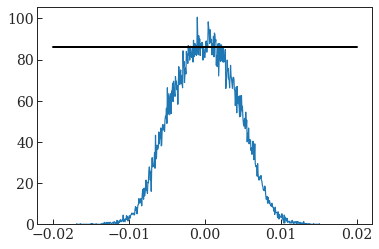

In [49]:
matfiles = glob.glob("../MD4224_Repo_Outputs/V_Mini_Optimised/Simulation_Profiles/*.mat")
plt.clf()

d = particles_from_matfile("../MD4224_Repo_Outputs/V_Mini_Optimised/Simulation_Profiles/613_SbS_c172.mat")
x, bins_, p = plt.hist(d['particles']['y'][0][0][0], bins = 512, density=True, histtype=u'step', lw=0, color='k')
    
    
peak = peakfinder(np.array(bins_[:-1]), np.array(x), verbose=True)
print 'peak @', peak

plt.plot(bins_[:-1], x);

plt.plot([-0.02, 0.02], [peak, peak], color='k', linestyle='-', linewidth=2)


	MAX(y_dat) =  102.57143591673831
	MAX(y_dat) index =  275
	abs(x_dat[index]) =  0.00069624323456512
	index =  265
	index of x_dat =  4.888952047750125e-05  is  265

Taking the average of centre  61  points
	Mean of  61  points about centre =  90.91743265560679
peak @ 90.91743265560679


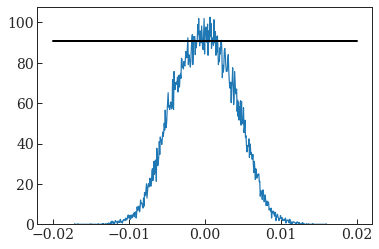

In [50]:
matfiles = glob.glob("../MD4224_Repo_Outputs/V_Mini_Optimised/Simulation_Profiles/*.mat")
plt.clf()

d = particles_from_matfile("../MD4224_Repo_Outputs/V_Mini_Optimised/Simulation_Profiles/614_SbS_c172.mat")
x, bins_, p = plt.hist(d['particles']['y'][0][0][0], bins = 512, density=True, histtype=u'step', lw=0, color='k')
    
    
peak = peakfinder(np.array(bins_[:-1]), np.array(x), verbose=True)
print 'peak @', peak

plt.plot(bins_[:-1], x);

plt.plot([-0.02, 0.02], [peak, peak], color='k', linestyle='-', linewidth=2)


	MAX(y_dat) =  0.6354184315692115
	MAX(y_dat) index =  195
	abs(x_dat[index]) =  2.569338615529628
	index =  224
	index of x_dat =  0.07366138447037218  is  224

Taking the average of centre  11  points
	Mean of  11  points about centre =  0.4705211612929274
	 using peak value
	Mean of  11  points about centre =  0.6053355760636661
peak @ 0.6053355760636661


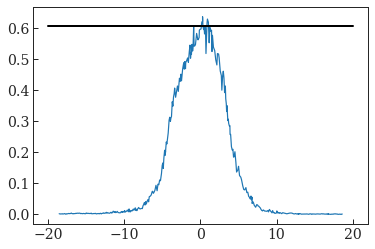

In [51]:
plt.clf()
i = 1
peak = peakfinder(np.flip(np.array(df0['position V'].iloc[i])), np.array(df0['profile V'].iloc[i]), peak_points = 5, verbose=True)
print 'peak @', peak

plt.plot(np.array(df0['position V'].iloc[i]), np.array(df0['profile V'].iloc[i]))

plt.plot([-20, 20], [peak, peak], color='k', linestyle='-', linewidth=2)

# Check all simulation data peaks

In [19]:
for key, value in sorted(sims.iteritems()):
    print value
    d = particles_from_matfile(value)
    plt.clf()
    x, bins_, p = plt.hist(d['particles']['y'][0][0][0], bins = 1000, density=True, histtype=u'step', lw=0, color='k')

    peak = peakfinder(np.array(bins_[:-1]), np.array(x), verbose=True)
    print '\n peak = ', peak, '\n'
    plt.close()

../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/610_SbS_c172.mat

	MAX(y_dat) =  69.74323877125634
	x_dat[index] =  0.0005101055061852815
	index of x_dat =  0.0005101055061852815  is  508
	Mean of peak point +/- 3 points =  66.01180238911725

 peak =  66.01180238911725 

../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/611_SbS_c172.mat

	MAX(y_dat) =  75.14176264415475
	x_dat[index] =  0.0012709895949379324
	index of x_dat =  0.0012709895949379324  is  522
	Mean of peak point +/- 3 points =  71.95482536432611

 peak =  71.95482536432611 

../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/612_SbS_c172.mat

	MAX(y_dat) =  83.08656291800608
	x_dat[index] =  -0.0008315859025405832
	index of x_dat =  -0.0008315859025405832  is  465
	Mean of peak point +/- 3 points =  79.11387790556557

 peak =  79.11387790556557 

../MD4224_Repo_Outputs/V_Optimised/Simulation_Profiles/613_SbS_c172.mat

	MAX(y_dat) =  89.03108079293945
	x_dat[index] =  0.0007190122862557845
	index of x_dat 

# Plot wirescanner profiles with simulation data


Importing simulation file: 610_SbS_c172
Qy =  6.1 , ctime = 172.0 [ms]
MD points:  [13, 57, 99, 144, 186, 228, 272, 314, 356, 397]

Importing simulation file: 611_SbS_c172
Qy =  6.11 , ctime = 172.0 [ms]
MD points:  [12, 56, 98, 143, 227, 271, 313, 396]

Importing simulation file: 612_SbS_c172
Qy =  6.12 , ctime = 172.0 [ms]
MD points:  [55, 142, 185, 226, 270, 312]
	 using peak value
	 using peak value
	 using peak value
	 using peak value
	 using peak value
	 using peak value

Importing simulation file: 613_SbS_c172
Qy =  6.13 , ctime = 172.0 [ms]
MD points:  [11, 54, 97, 141, 184, 225, 269, 311, 355, 395]

Importing simulation file: 614_SbS_c172
Qy =  6.14 , ctime = 172.0 [ms]
MD points:  [10, 53, 96, 140, 183, 224, 268, 310, 354]

Importing simulation file: 615_SbS_c172
Qy =  6.15 , ctime = 172.0 [ms]
MD points:  [9, 52, 95, 139, 182, 223, 267, 309, 353, 394]

Importing simulation file: 616_SbS_c172
Qy =  6.16 , ctime = 172.0 [ms]
MD points:  [8, 51, 94, 138, 181, 222, 266, 308, 3

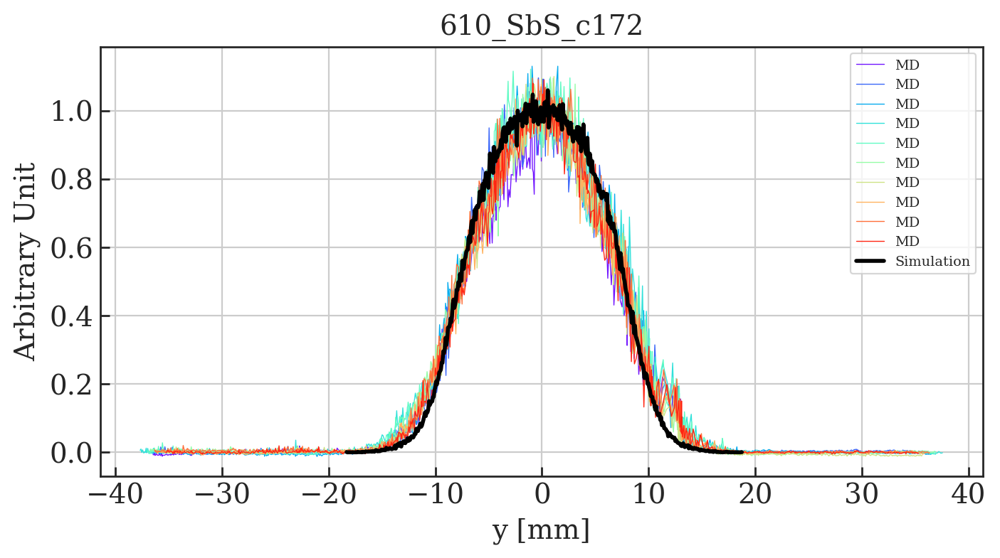

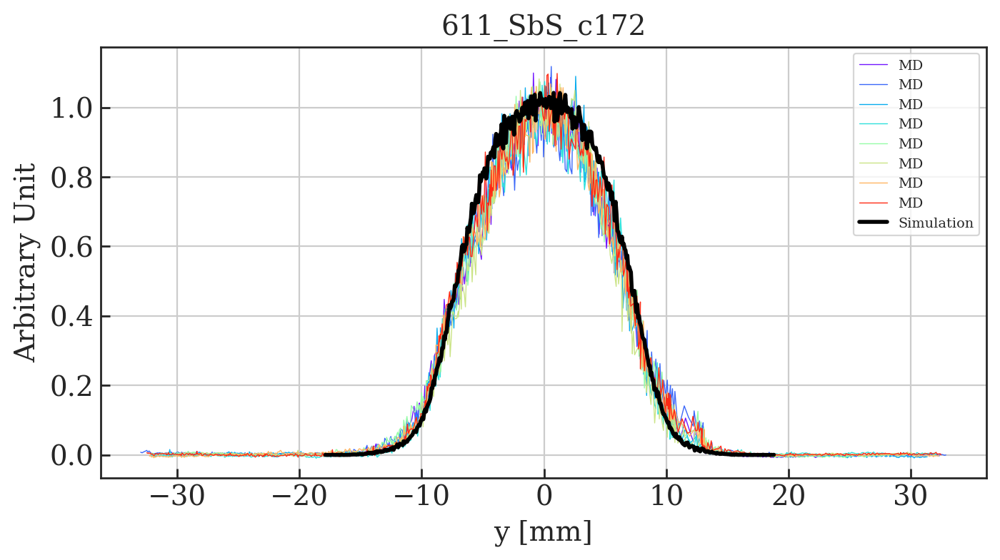

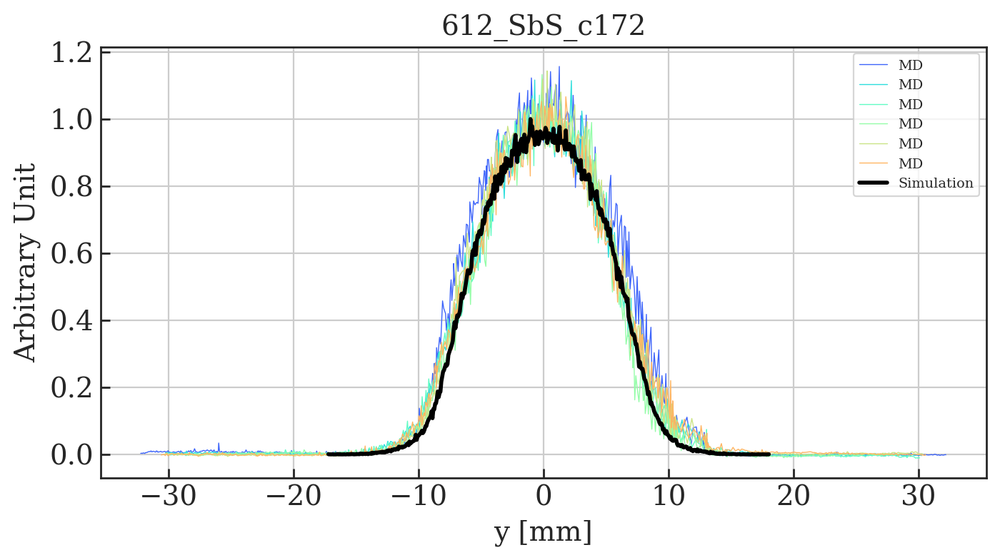

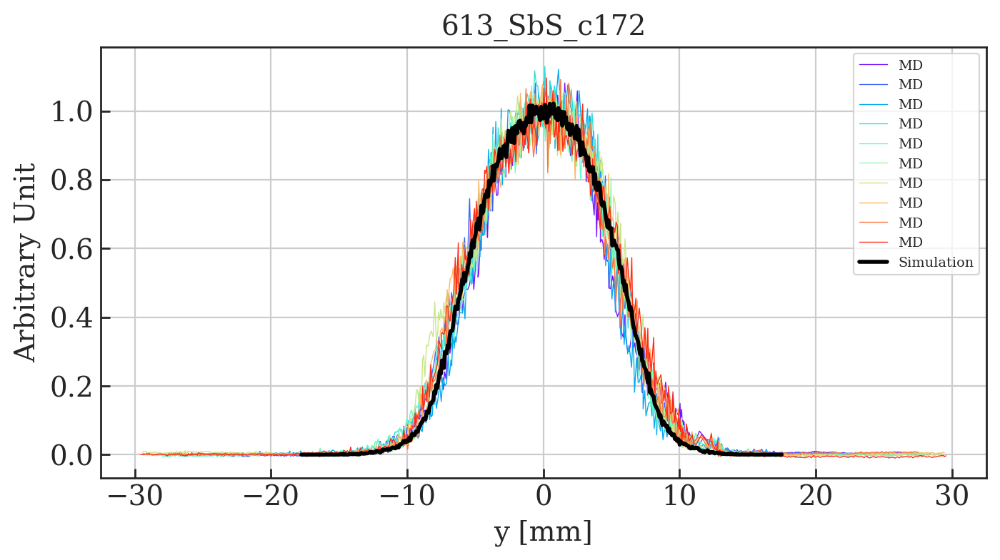

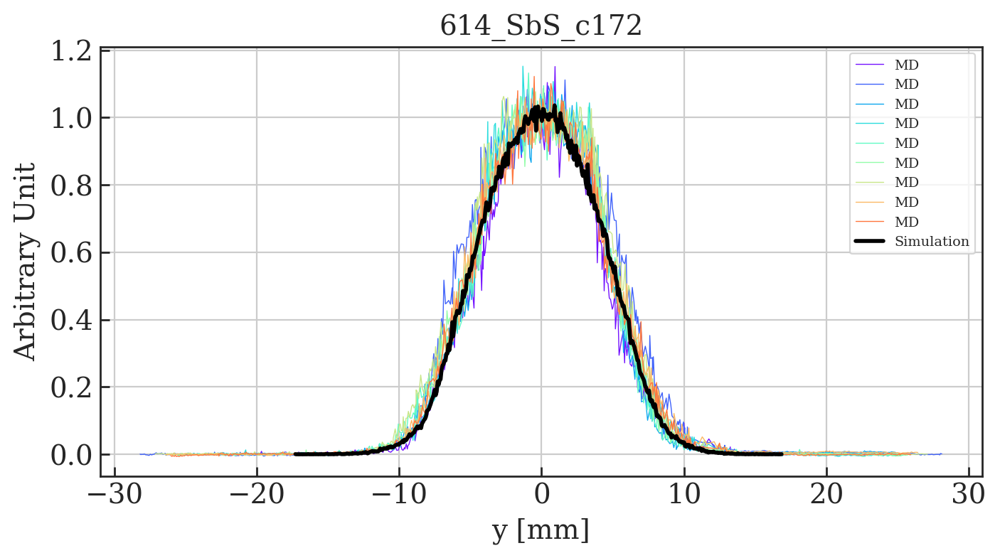

...

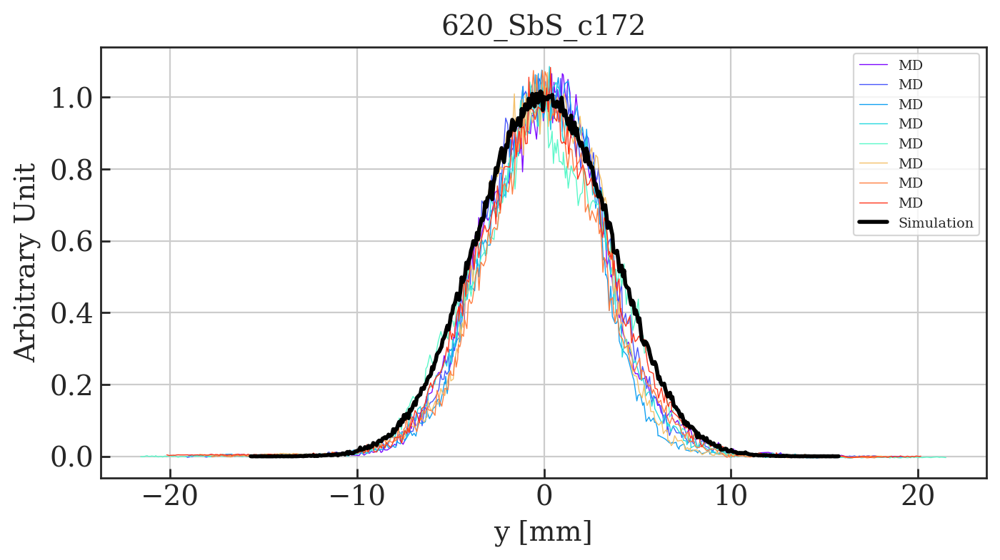

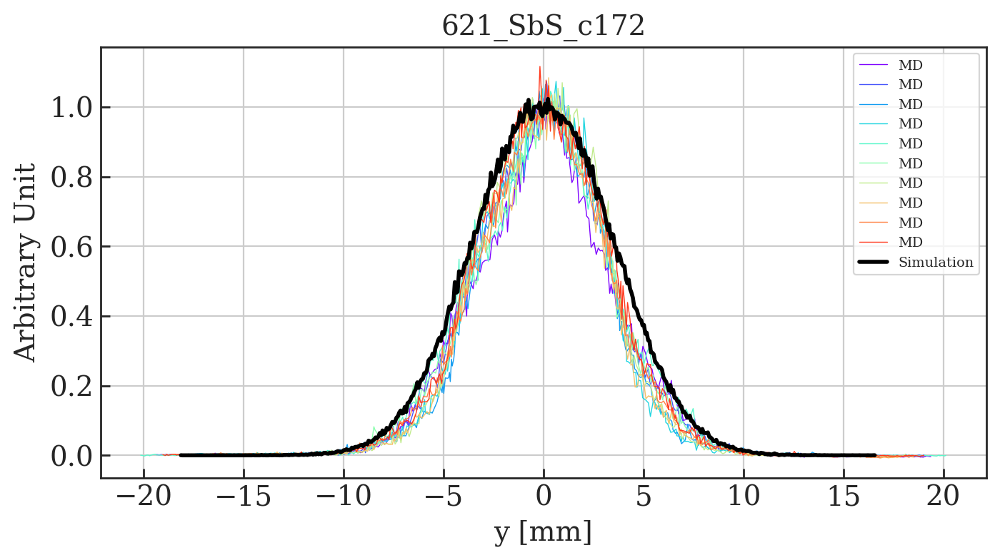

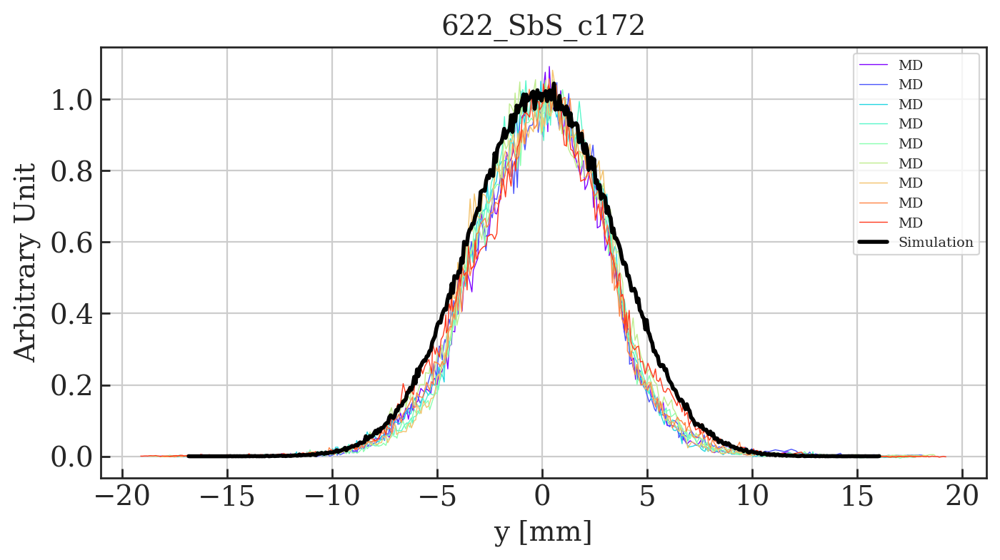

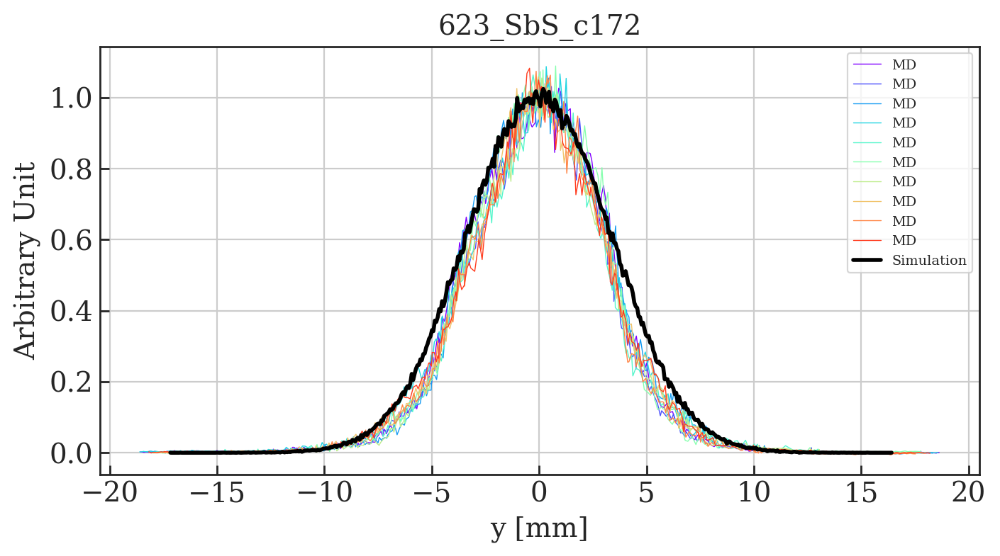

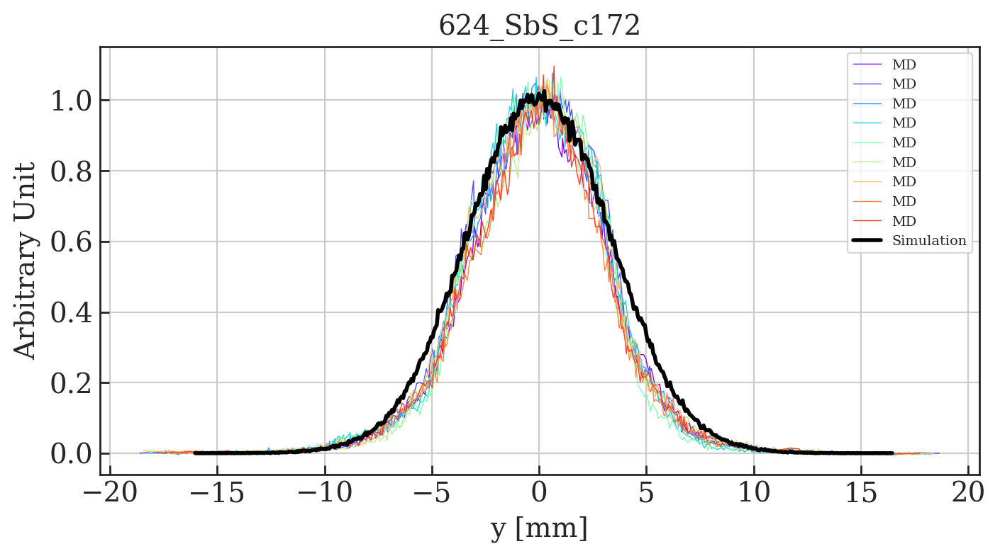

In [20]:
#Main function
verbose = True

for key, value in sorted(sims.iteritems()):
    if verbose: print '\nImporting simulation file:', key
    
    tune_y = float(key.split('_')[0])/100
    ctime = (key.split('_')[2])
    time = float(ctime.split('c')[1])
    if verbose: print 'Qy = ', tune_y, ', ctime =', time, '[ms]'
        
    d = particles_from_matfile(value)
        
    # Find MD data with same tune and ctime
    
    md_points = []
    for i in tune_points[tune_y]:
        if df0['PR.BWS.64.V_ROT:ACQ_DELAY'].iloc()[i] == time:
            md_points.append(i)
            
    if verbose: print 'MD points: ', md_points
        
    # Plot data
    main_label = key
    Plot_profiles_MD_cf_Sims(d, df0, md_points, 1, main_label, 500)  

# Compare SC Models only


Importing simulation file: 610_SbS_c172
Qy =  6.1 , ctime = 172.0 [ms], label =  SbS
[13, 57, 99, 144, 186, 228, 272, 314, 356, 397]

	MAX(y_dat) =  0.12505746606673648
	x_dat[index] =  0.09492706659248817
	index of x_dat =  0.09492706659248817  is  512
	Mean of peak point +/- 3 points =  0.11810982906302551

Importing simulation file: 611_SbS_c172
Qy =  6.11 , ctime = 172.0 [ms], label =  SbS
[12, 56, 98, 143, 227, 271, 313, 396]

	MAX(y_dat) =  0.12367610454344026
	x_dat[index] =  0.25042131335375295
	index of x_dat =  0.25042131335375295  is  515
	Mean of peak point +/- 3 points =  0.11651168221940979

Importing simulation file: 612_SbS_c172
Qy =  6.12 , ctime = 172.0 [ms], label =  SbS
[55, 142, 185, 226, 270, 312]

	MAX(y_dat) =  0.12097214709311624
	x_dat[index] =  0.3993623503005299
	index of x_dat =  0.3993623503005299  is  522
	Mean of peak point +/- 3 points =  0.11557095687668692

Importing simulation file: 613_SbS_c172
Qy =  6.13 , ctime = 172.0 [ms], label =  SbS
[11, 54,

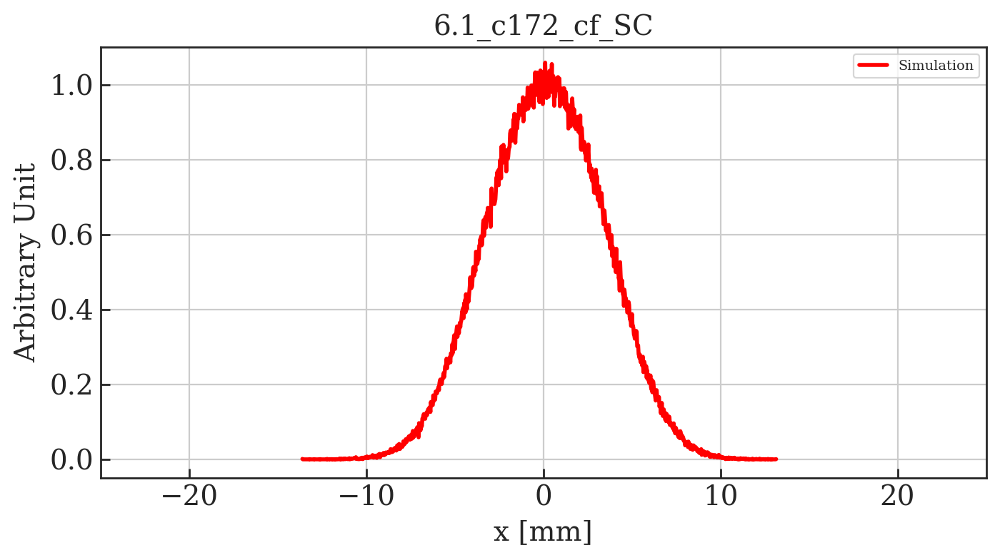

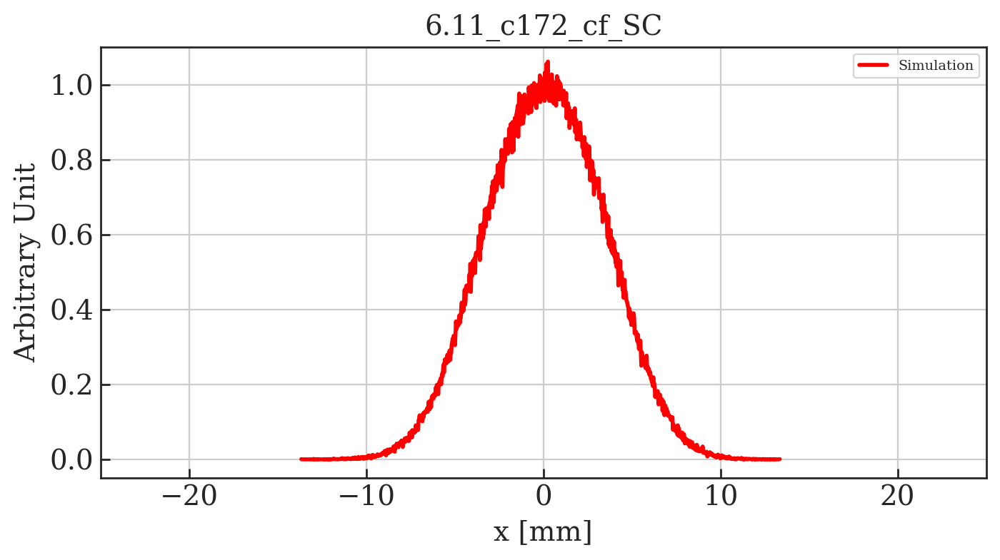

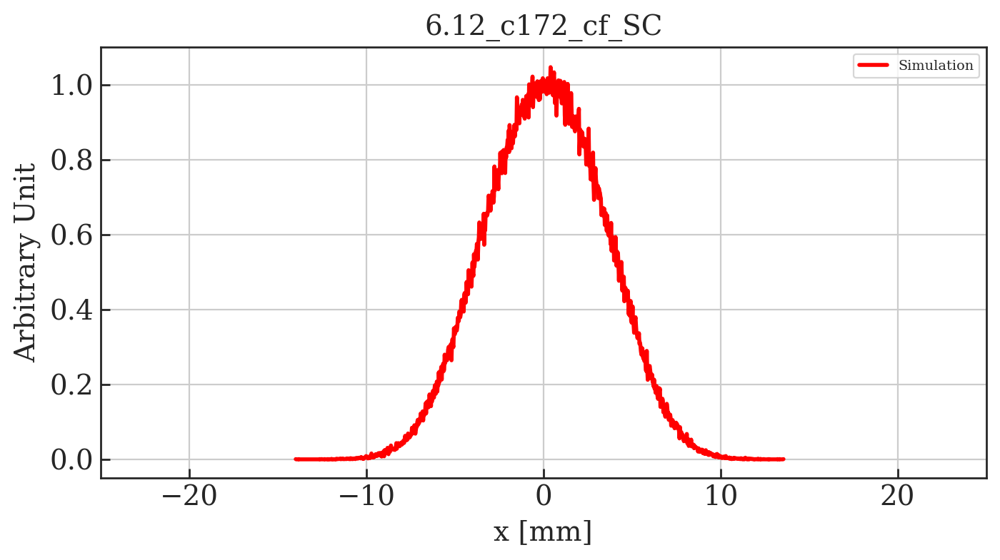

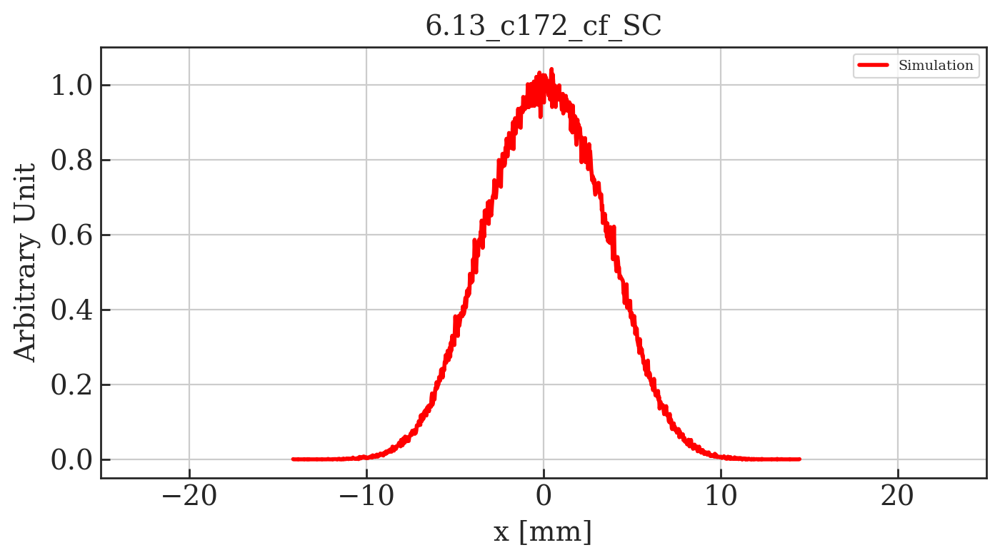

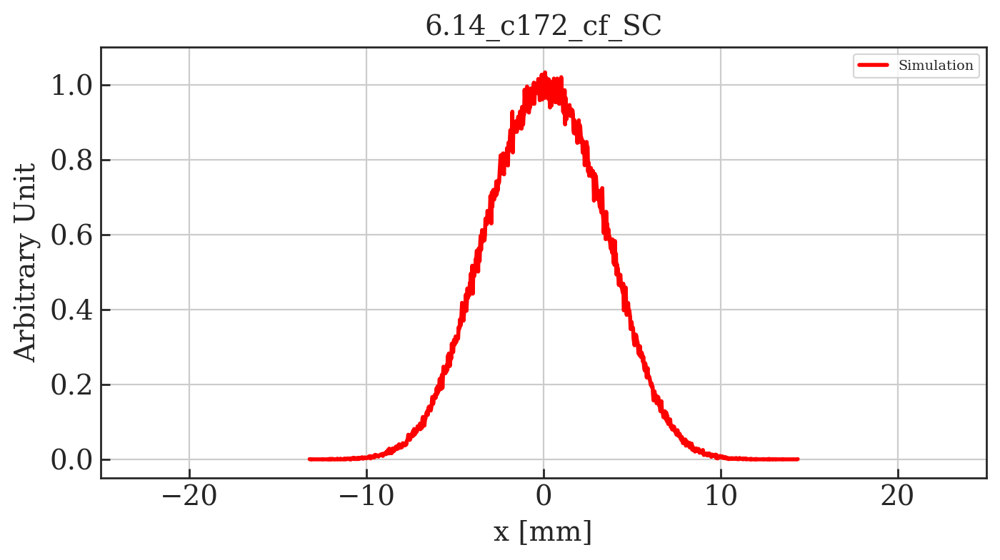

...

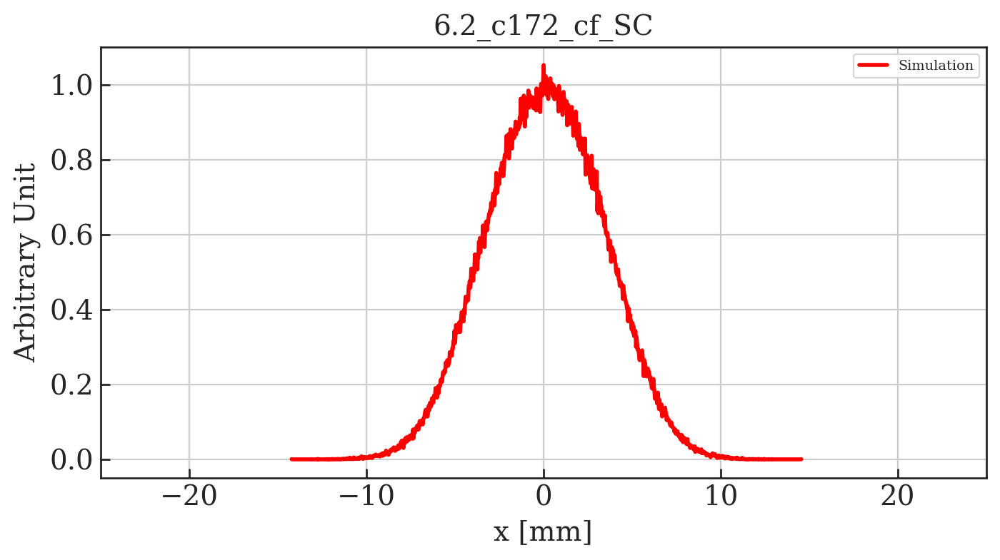

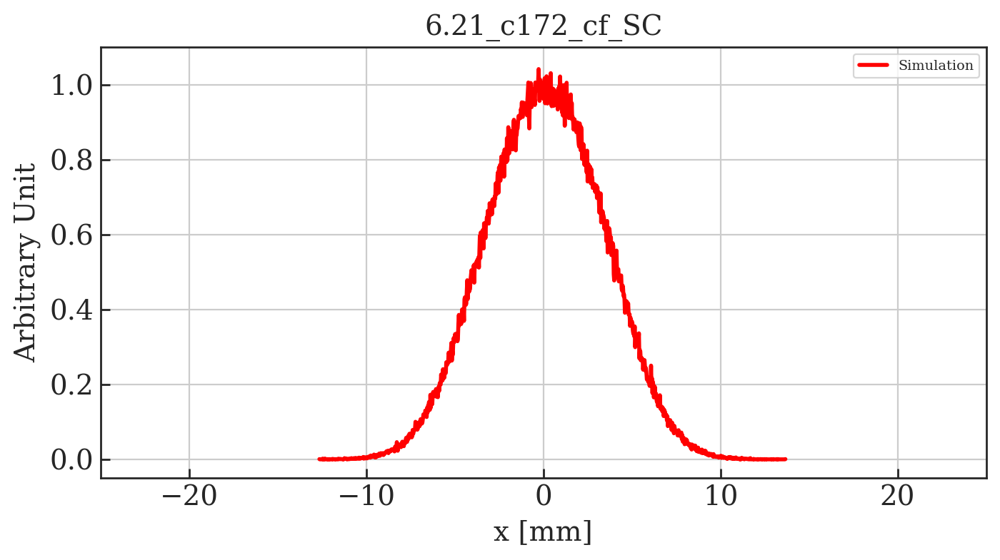

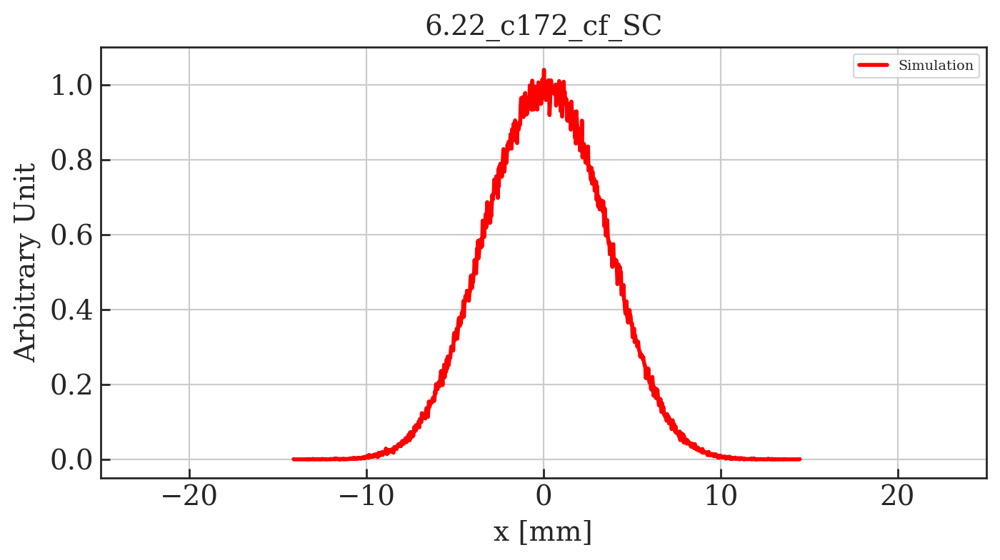

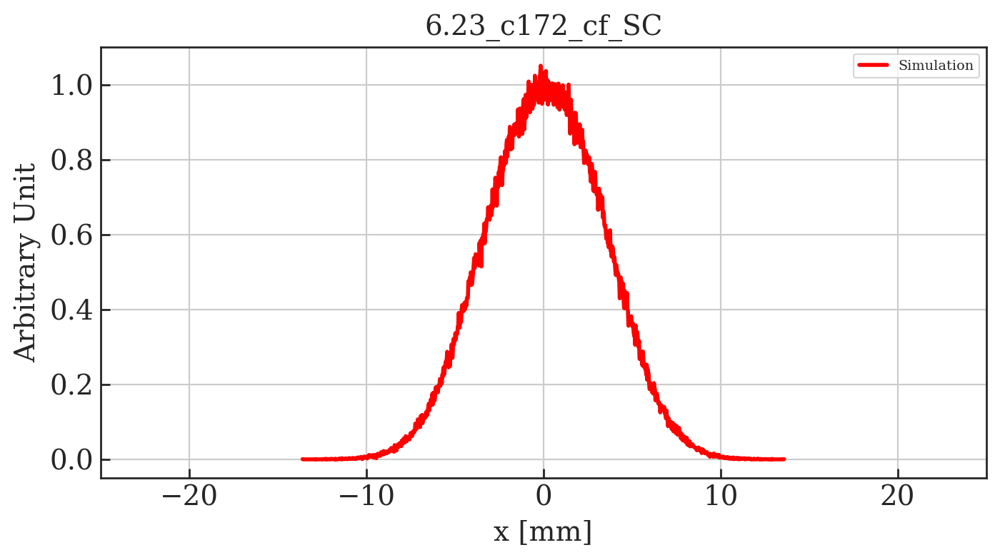

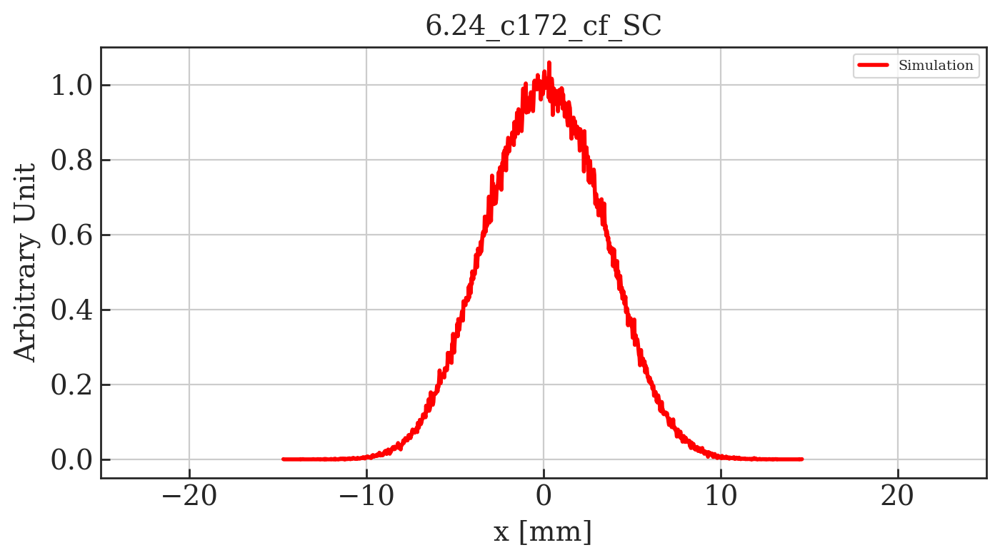

In [87]:
#Main function to plot comparison plots without MD data
verbose = True

plotted_names = []

for key, value in sorted(sims.iteritems()):
    if key not in plotted_names:        
        
        plotted_names.append(key)
        
        this_plot = []
        this_plot.append(value)
        if verbose: print '\nImporting simulation file:', key        

        tune_y = float(key.split('_')[0])/100
        ctime = (key.split('_')[2])
        time = float(ctime.split('c')[1])
        label = (key.split('_')[1])
        if verbose: print 'Qy = ', tune_y, ', ctime =', time, '[ms], label = ', label

        sim_labels=['Simulation']
        
        # Find MD data with same tune and ctime    
        for key1, value1 in sorted(sims.iteritems()):
#             if verbose: print '\tChecking other files:', key1  
            tune_y1 = float(key1.split('_')[0])/100
            ctime1 = (key1.split('_')[2])
            time1 = float(ctime1.split('c')[1])
            label1 = (key1.split('_')[1])
#             if verbose: print '\tQy = ', tune_y1, ', ctime =', time1, '[ms], label = ', label1
            if (tune_y1 == tune_y) and (time1 == time):
                if (label1 != label):
                    print '\tMATCH FOUND' 
                    print '\tQy = ', tune_y1, ', ctime =', time1, '[ms]'
                    print '\tlab = ', label, ', lab1 =', label1

                    this_plot.append(value1)
                    plotted_names.append(key1)
                    sim_labels.append(label1)

        # Find rows in dataframe at correct tune and WS time
        md_points = []
        for i in tune_points[tune_y]:
            if df0['PR.BWS.64.V_ROT:ACQ_DELAY'].iloc()[i] == time:
                md_points.append(i)          

        if verbose: print md_points                 

        # Plot data
        main_label = 'Qy=' + str(tune_y) + '_Injection+2ms'
        
        if len(this_plot) is 1:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), main_label=main_label, sim_labels=sim_labels, plot_md=False)  
        elif len(this_plot) is 2:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), particles_from_matfile(this_plot[1]), main_label=main_label, sim_labels=sim_labels, plot_md=False)  
        elif len(this_plot) is 3:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), particles_from_matfile(this_plot[1]), particles_from_matfile(this_plot[2]), main_label=main_label, sim_labels=sim_labels, plot_md=False)  
        else: print 'ERROR: More than 3 space charge methods found'
        


# Compare Sims and MD data


Importing simulation file: 610_SbS_c172
Qy =  6.1 , ctime = 172.0 [ms], label =  SbS
[13, 57, 99, 144, 186, 228, 272, 314, 356, 397]

	MAX(y_dat) =  0.06974323877125478
	MAX(y_dat) index =  508
	abs(x_dat[index]) =  0.5101055061852797
	index =  495
	index of x_dat =  0.02733469437321645  is  495

Taking the average of centre  61  points
	Mean of  61  points about centre =  0.06535355102936154
	abs(x_dat[index]) =  0.2927961820240822

Taking the average of centre  61  points
	abs(x_dat[index]) =  0.33230307319020125

Taking the average of centre  61  points
	abs(x_dat[index]) =  1.4839721238394799

Taking the average of centre  61  points
	abs(x_dat[index]) =  0.3829070537419348

Taking the average of centre  61  points
	abs(x_dat[index]) =  1.0622338244854321

Taking the average of centre  61  points
	abs(x_dat[index]) =  0.7878397228190822

Taking the average of centre  61  points
	abs(x_dat[index]) =  1.1272716080245595

Taking the average of centre  61  points
	abs(x_dat[index]) = 


Importing simulation file: 618_SbS_c172
Qy =  6.18 , ctime = 172.0 [ms], label =  SbS
[6, 49, 92, 136, 179, 220, 264, 306, 350, 391]

	MAX(y_dat) =  0.11513902040083007
	MAX(y_dat) index =  520
	abs(x_dat[index]) =  0.4676013107995729
	index =  535
	index of x_dat =  0.010255803221898674  is  535

Taking the average of centre  61  points
	Mean of  61  points about centre =  0.10705580297561872
	abs(x_dat[index]) =  0.4814730973955599

Taking the average of centre  61  points
	abs(x_dat[index]) =  0.3601832262075534

Taking the average of centre  61  points
	abs(x_dat[index]) =  0.5781277482056866

Taking the average of centre  61  points
	abs(x_dat[index]) =  0.34251149794534785

Taking the average of centre  61  points
	abs(x_dat[index]) =  0.21315948269853546

Taking the average of centre  61  points
	abs(x_dat[index]) =  0.7088580412177772

Taking the average of centre  61  points
	abs(x_dat[index]) =  0.13385795872007933

Taking the average of centre  61  points
	abs(x_dat[index])

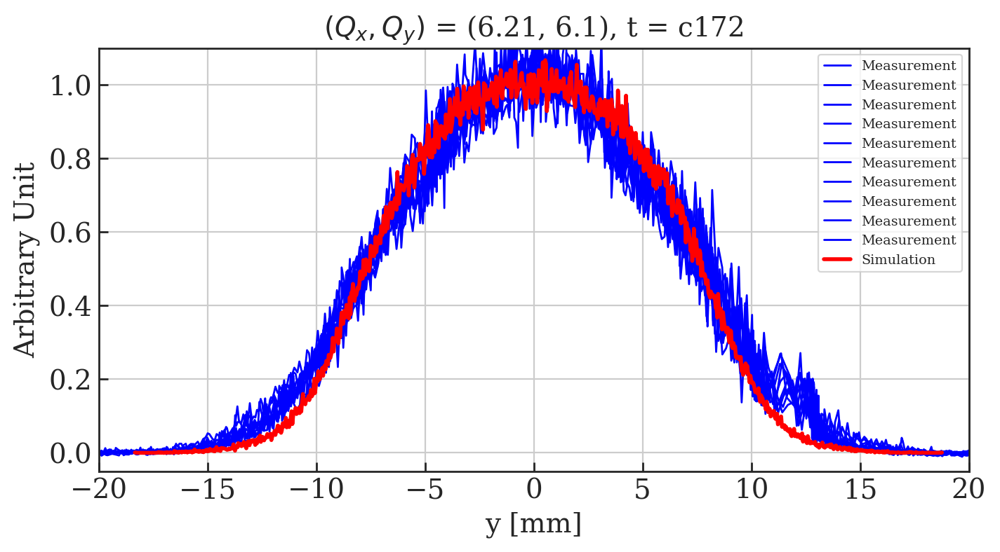

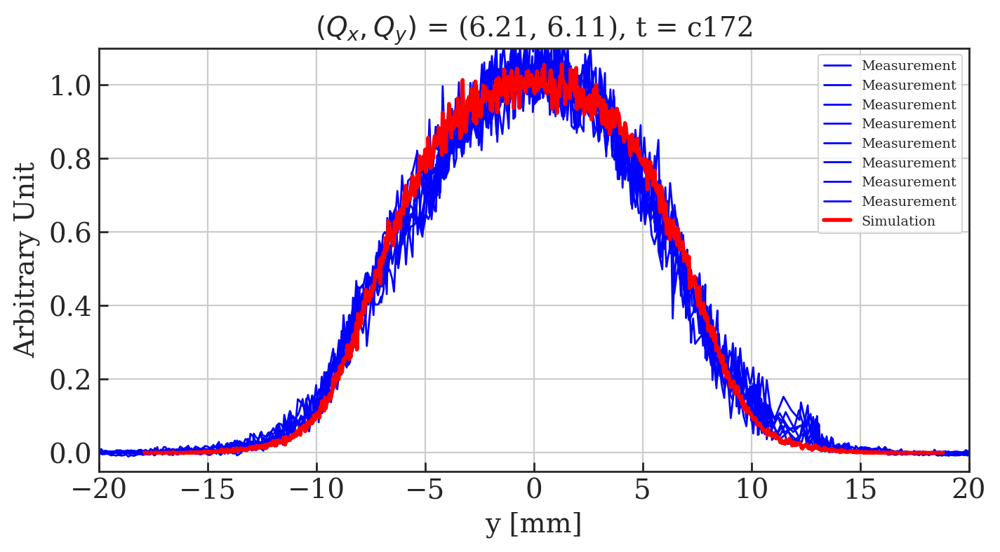

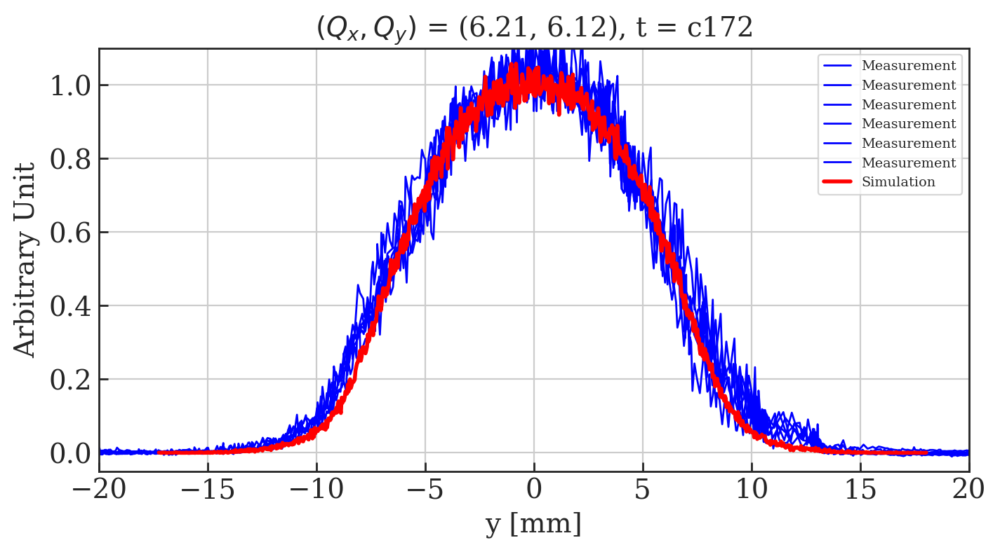

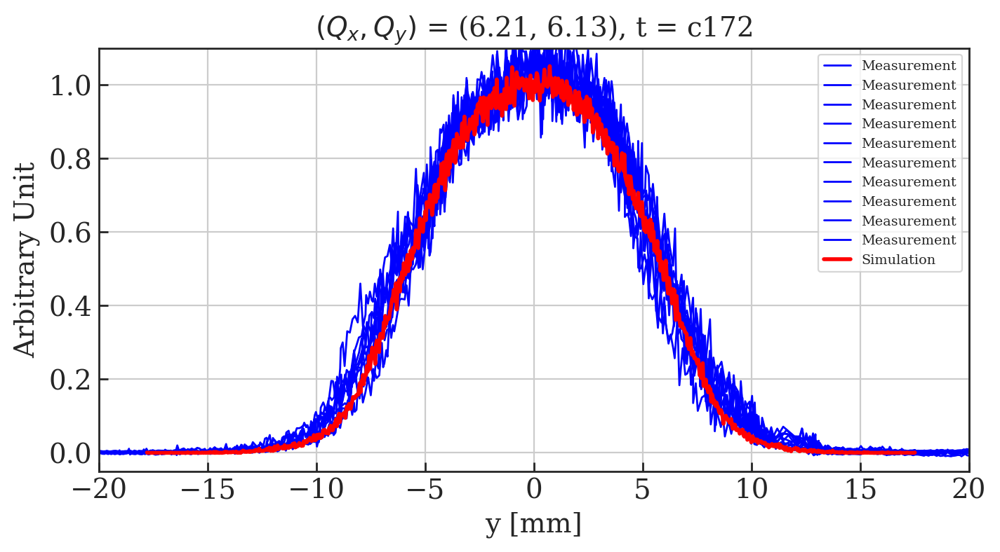

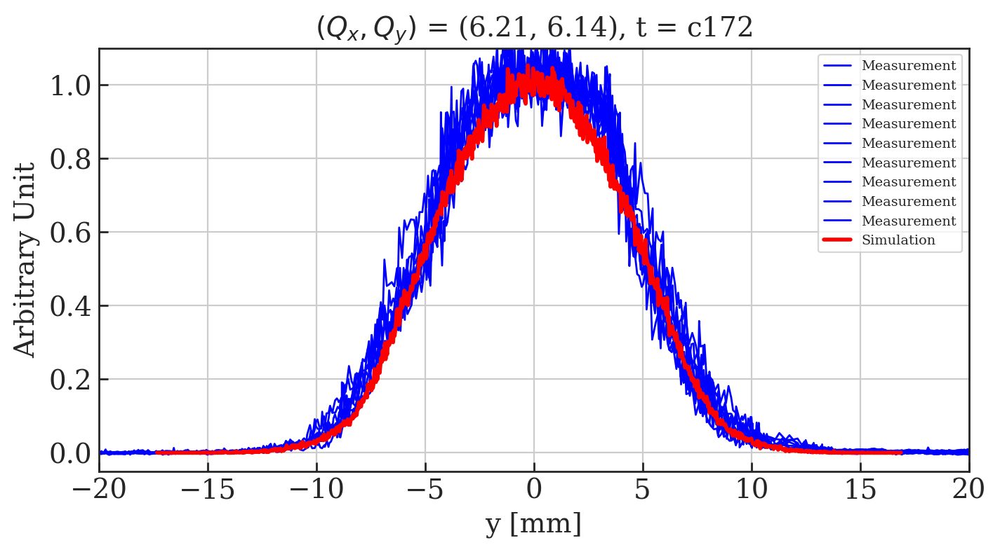

...

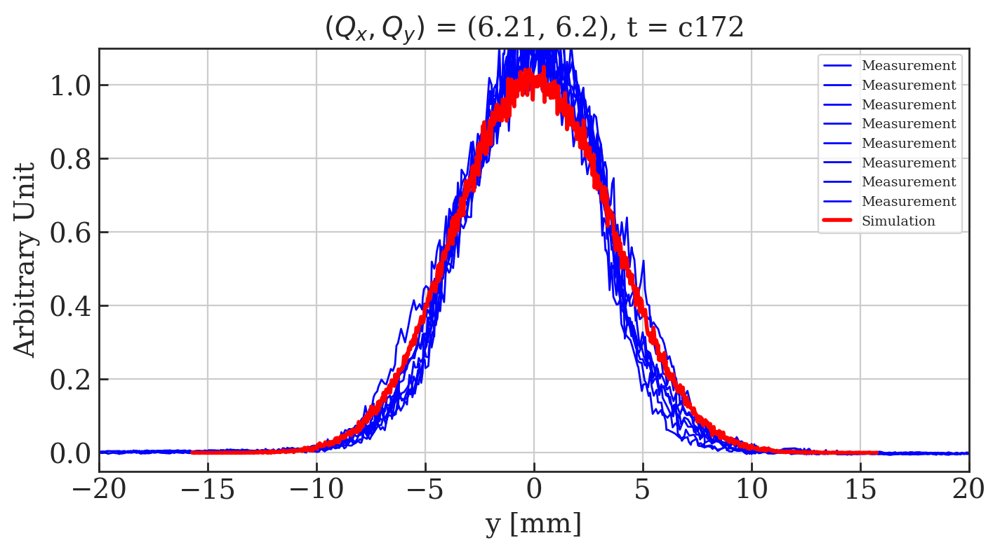

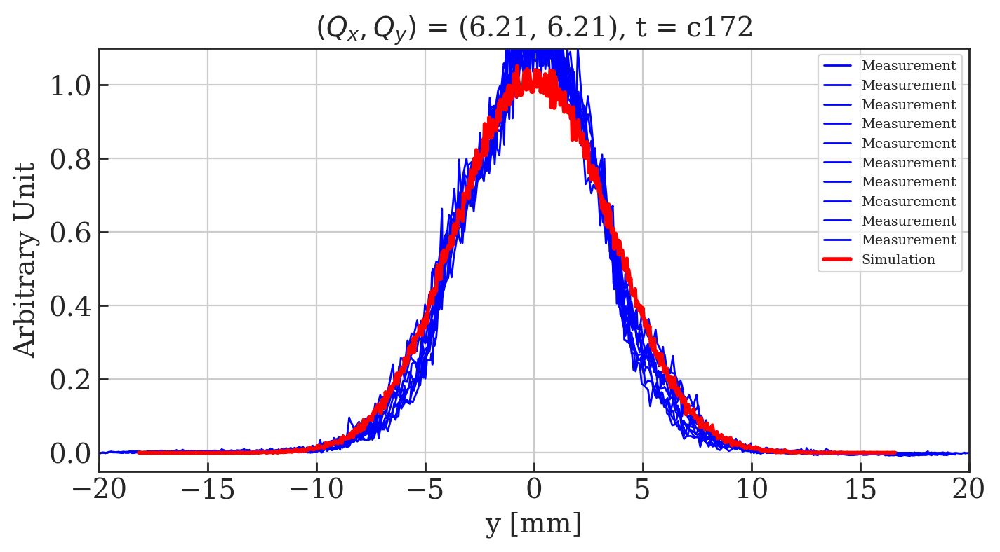

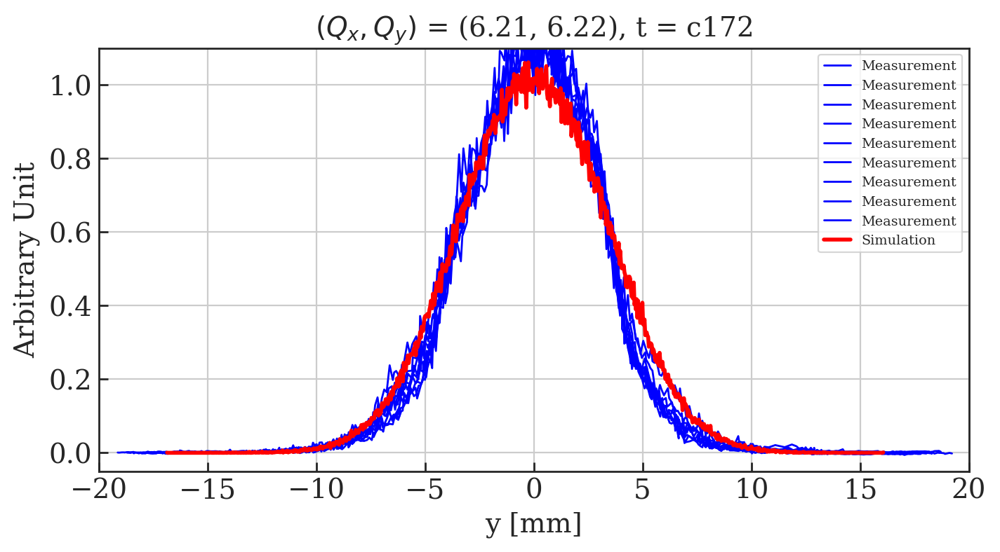

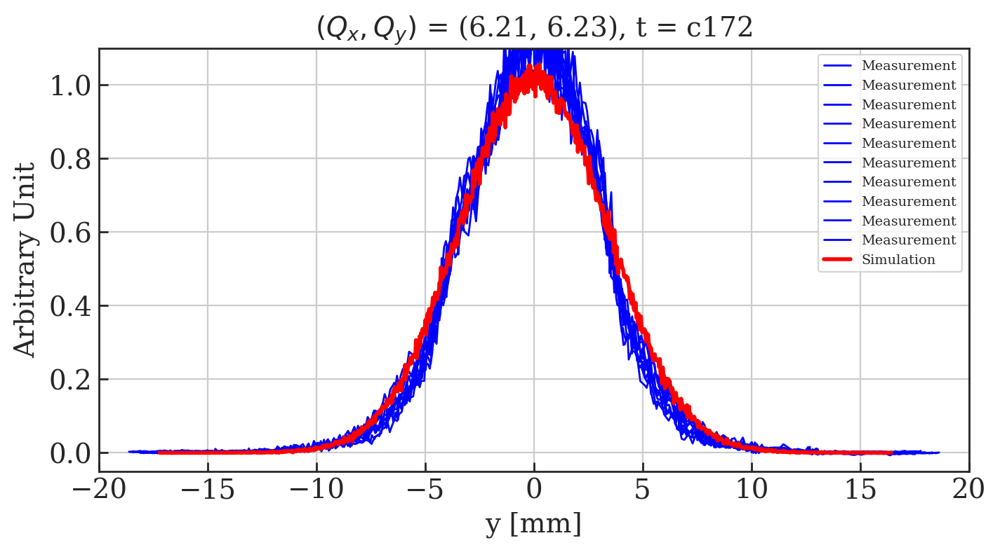

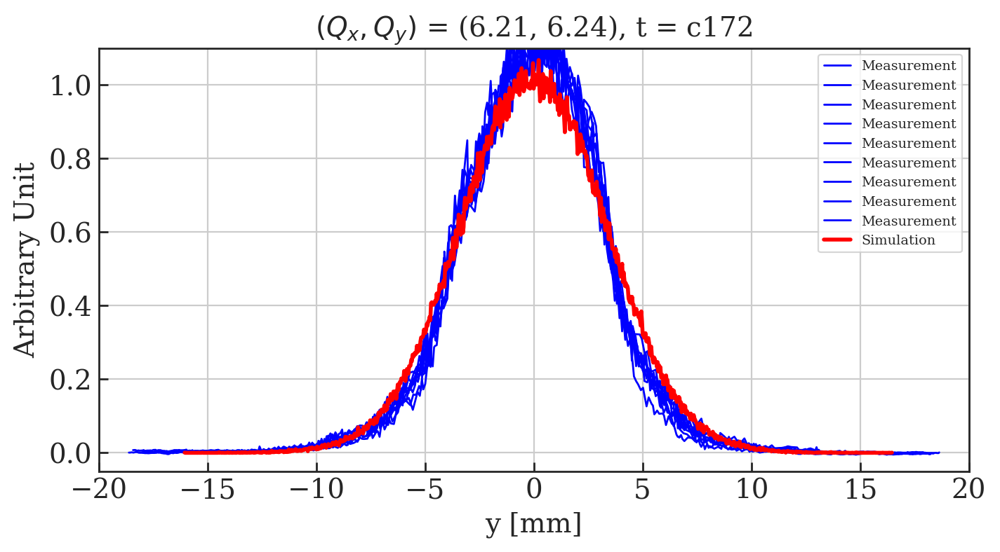

In [52]:
#Main function to plot comparison plots with MD data
verbose = True

plotted_names = []

for key, value in sorted(sims.iteritems()):
    if key not in plotted_names:        
        
        plotted_names.append(key)
        
        this_plot = []
        this_plot.append(value)
        if verbose: print '\nImporting simulation file:', key        

        tune_y = float(key.split('_')[0])/100
        ctime = (key.split('_')[2])
        time = float(ctime.split('c')[1])
        label = (key.split('_')[1])
        if verbose: print 'Qy = ', tune_y, ', ctime =', time, '[ms], label = ', label
        
        sim_labels=['Simulation']

        # Find MD data with same tune and ctime    
        for key1, value1 in sorted(sims.iteritems()):
#             if verbose: print '\tChecking other files:', key1  
            tune_y1 = float(key1.split('_')[0])/100
            ctime1 = (key1.split('_')[2])
            time1 = float(ctime1.split('c')[1])
            label1 = (key1.split('_')[1])
#             if verbose: print '\tQy = ', tune_y1, ', ctime =', time1, '[ms], label = ', label1
            if (tune_y1 == tune_y) and (time1 == time):
                if (label1 != label):
                    print '\tMATCH FOUND' 
                    print '\tQy = ', tune_y1, ', ctime =', time1, '[ms]'
                    print '\tlab = ', label, ', lab1 =', label1

                    this_plot.append(value1)
                    plotted_names.append(key1)
                    sim_labels.append(label1)

        # Find rows in dataframe at correct tune and WS time
        md_points = []
        for i in tune_points[tune_y]:
            if df0['PR.BWS.64.V_ROT:ACQ_DELAY'].iloc()[i] == time:
                md_points.append(i)          

        if verbose: print md_points                 

        # Plot data
        main_label = r'$(Q_x, Q_y)$ = (6.21, ' + str(tune_y) + '), t = ' + str(ctime)
        save_name = 'V_Scan_WS_cf_' + str(tune_y)
        
        if len(this_plot) is 1:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, main_label=main_label, save_name=save_name, bins=1000, sim_labels=sim_labels, plot_md=True)  
        elif len(this_plot) is 2:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, particles_from_matfile(this_plot[1]), main_label=main_label, save_name=save_name, bins=1000, sim_labels=sim_labels, plot_md=True)  
        elif len(this_plot) is 3:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, particles_from_matfile(this_plot[1]), particles_from_matfile(this_plot[2]), main_label=main_label, save_name=save_name, bins=1000, sim_labels=sim_labels, plot_md=True)  
        else: print 'ERROR: More than 3 space charge methods found'
        


# Wire scanner comparison plots for write-up


Importing simulation file: 610_SbS_c172
Qy =  6.1 , ctime = 172.0 [ms], label =  SbS
[13, 57, 99, 144, 186, 228, 272, 314, 356, 397]

	MAX(y_dat) =  0.06974323877125478
	MAX(y_dat) index =  508
	abs(x_dat[index]) =  0.5101055061852797
	index =  495
	index of x_dat =  0.02733469437321645  is  495

Taking the average of centre  61  points
	Mean of  61  points about centre =  0.06535355102936154
	abs(x_dat[index]) =  0.2927961820240822

Taking the average of centre  21  points
	abs(x_dat[index]) =  0.33230307319020125

Taking the average of centre  21  points
	abs(x_dat[index]) =  1.4839721238394799

Taking the average of centre  21  points
	abs(x_dat[index]) =  0.3829070537419348

Taking the average of centre  21  points
	abs(x_dat[index]) =  1.0622338244854321

Taking the average of centre  21  points
	abs(x_dat[index]) =  0.7878397228190822

Taking the average of centre  21  points
	abs(x_dat[index]) =  1.1272716080245595

Taking the average of centre  21  points
	abs(x_dat[index]) = 


Importing simulation file: 618_SbS_c172
Qy =  6.18 , ctime = 172.0 [ms], label =  SbS
[6, 49, 92, 136, 179, 220, 264, 306, 350, 391]

	MAX(y_dat) =  0.11513902040083007
	MAX(y_dat) index =  520
	abs(x_dat[index]) =  0.4676013107995729
	index =  535
	index of x_dat =  0.010255803221898674  is  535

Taking the average of centre  61  points
	Mean of  61  points about centre =  0.10705580297561872
	abs(x_dat[index]) =  0.4814730973955599

Taking the average of centre  21  points
	abs(x_dat[index]) =  0.3601832262075534

Taking the average of centre  21  points
	abs(x_dat[index]) =  0.5781277482056866

Taking the average of centre  21  points
	abs(x_dat[index]) =  0.34251149794534785

Taking the average of centre  21  points
	abs(x_dat[index]) =  0.21315948269853546

Taking the average of centre  21  points
	abs(x_dat[index]) =  0.7088580412177772

Taking the average of centre  21  points
	abs(x_dat[index]) =  0.13385795872007933

Taking the average of centre  21  points
	abs(x_dat[index])

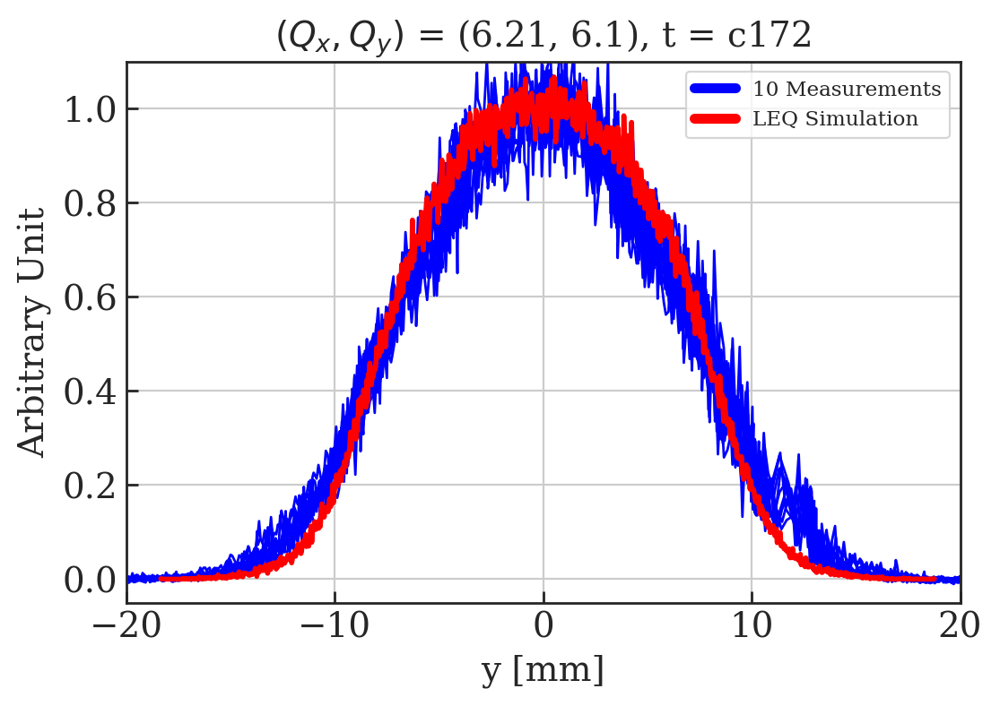

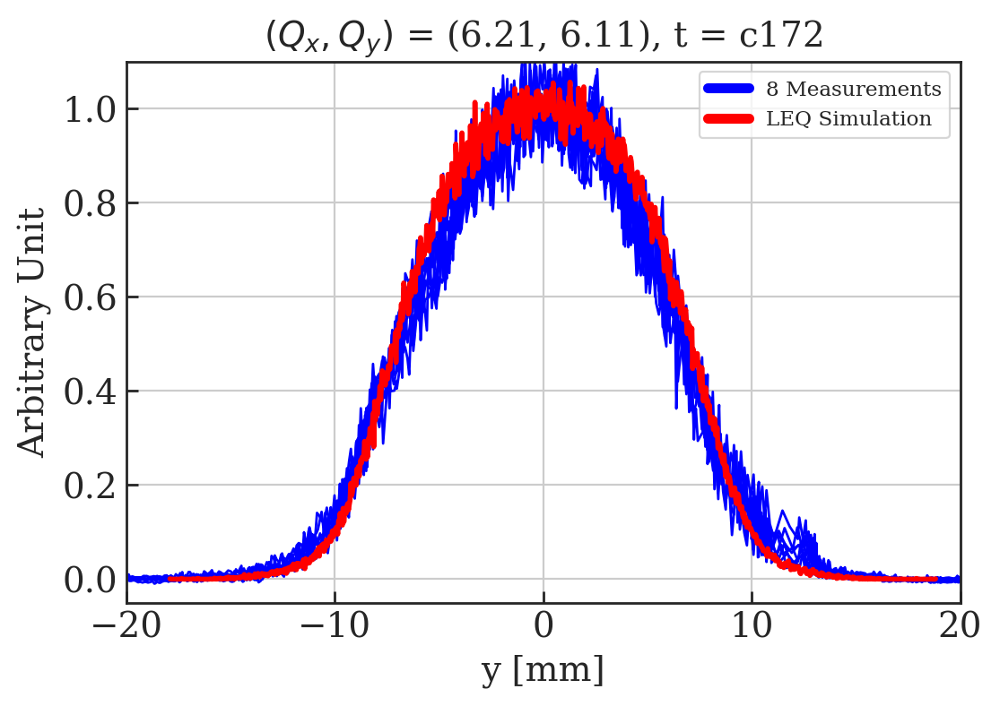

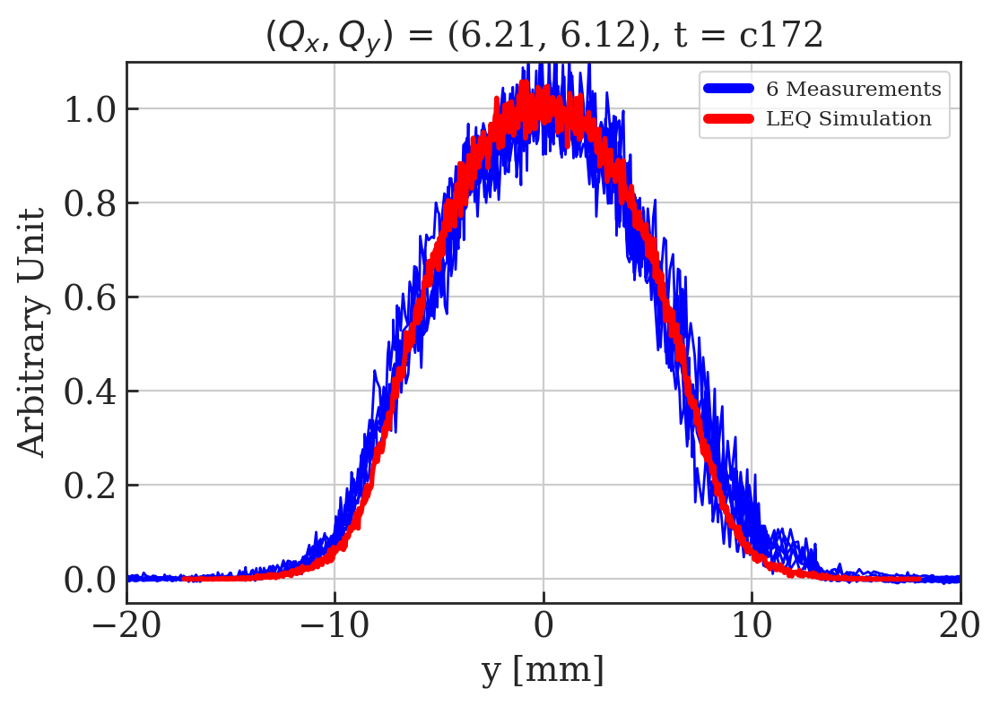

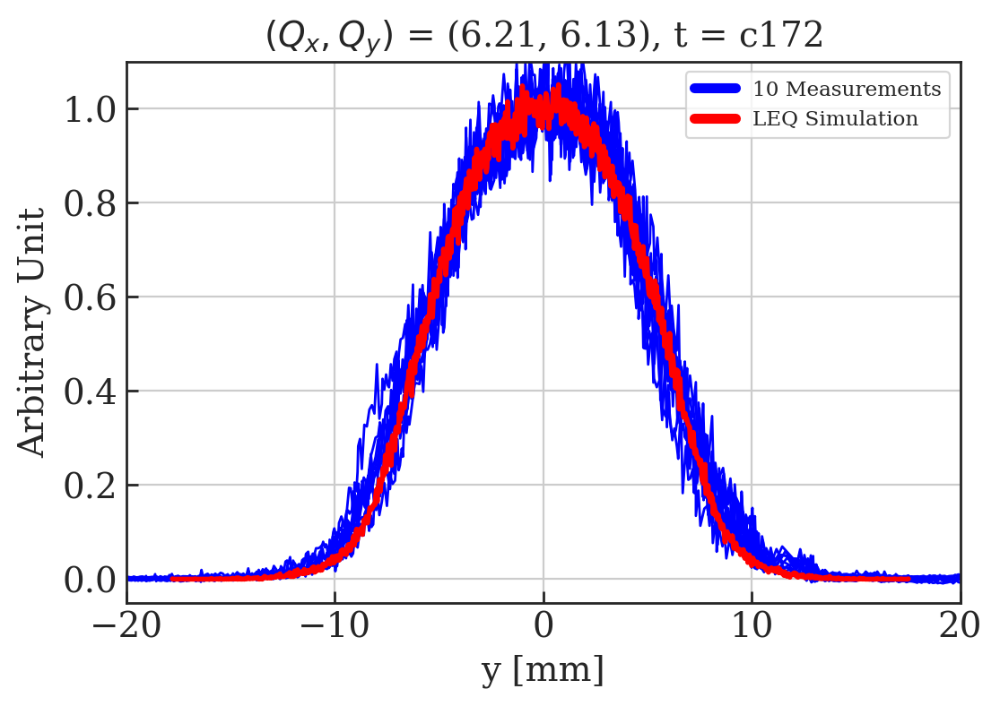

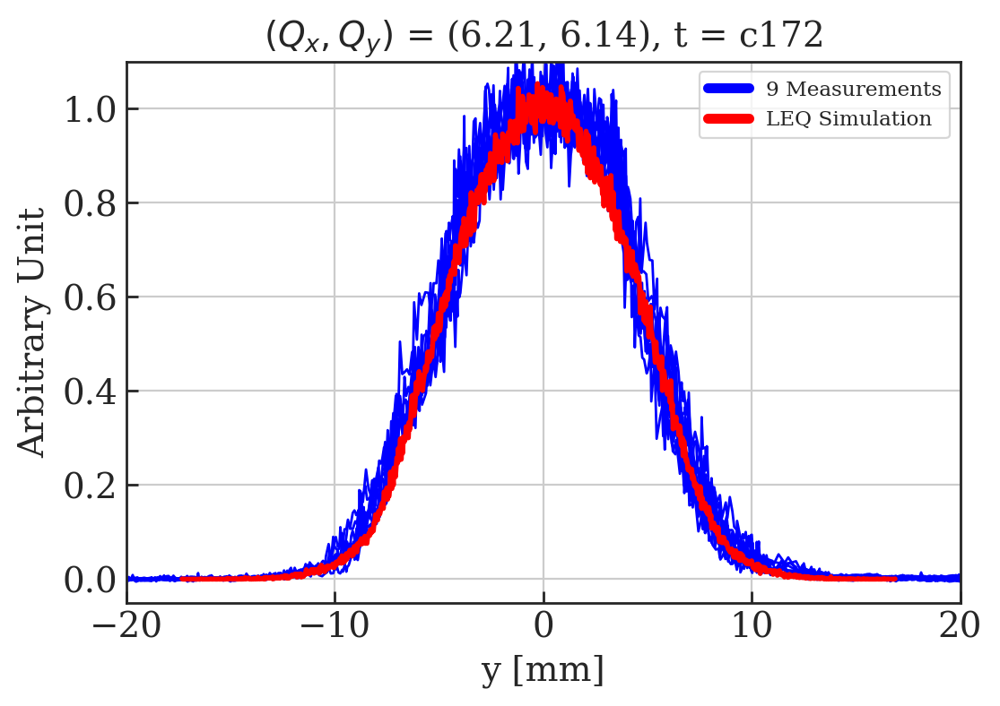

...

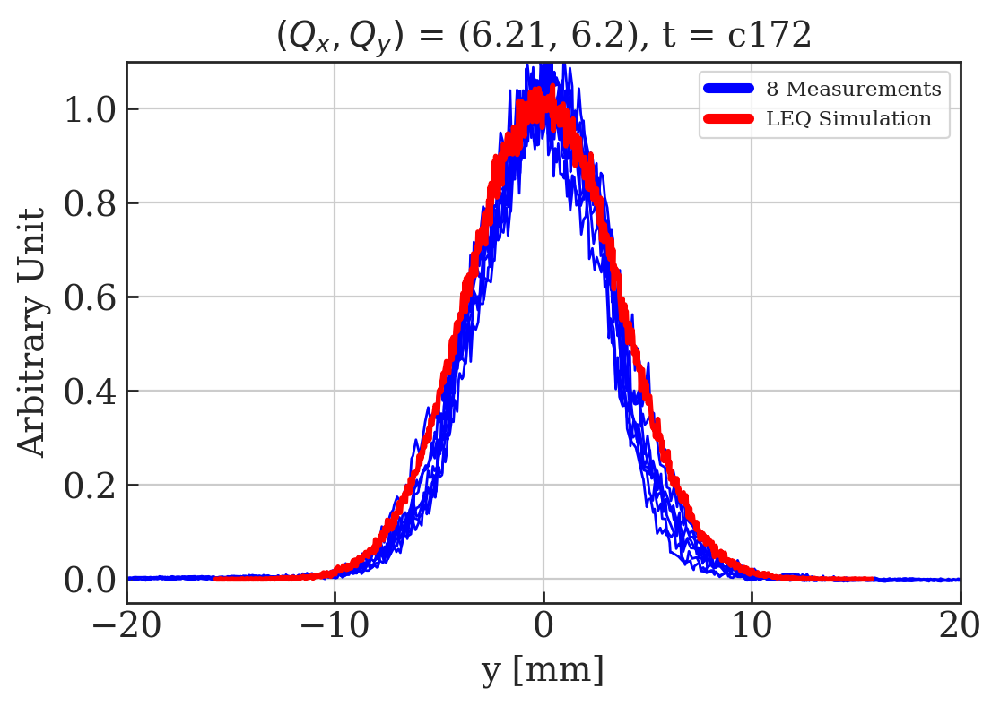

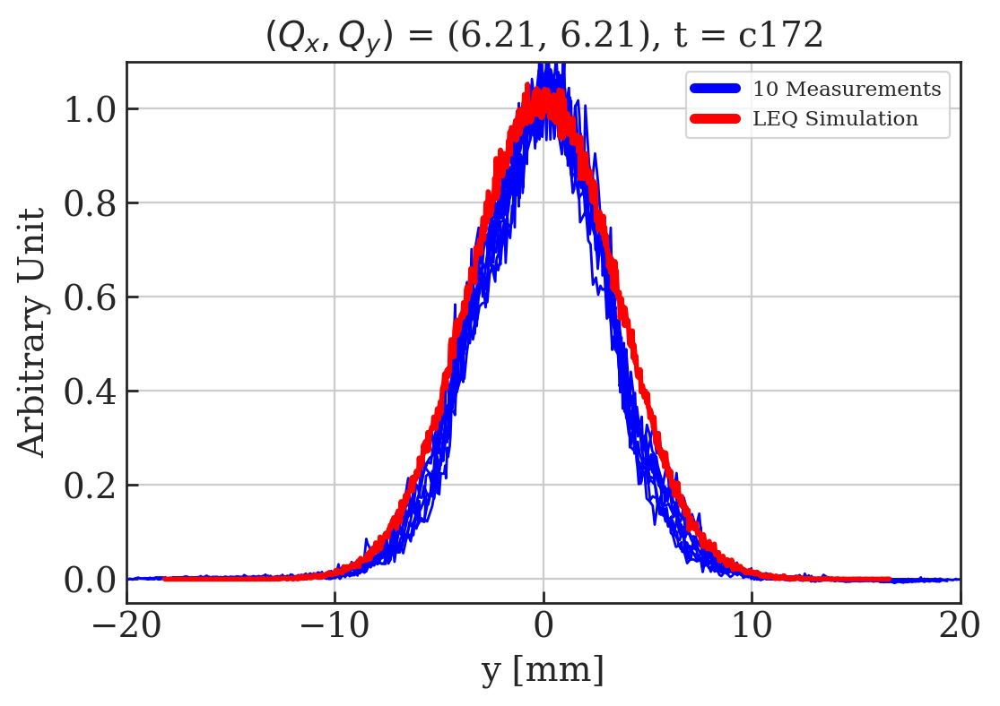

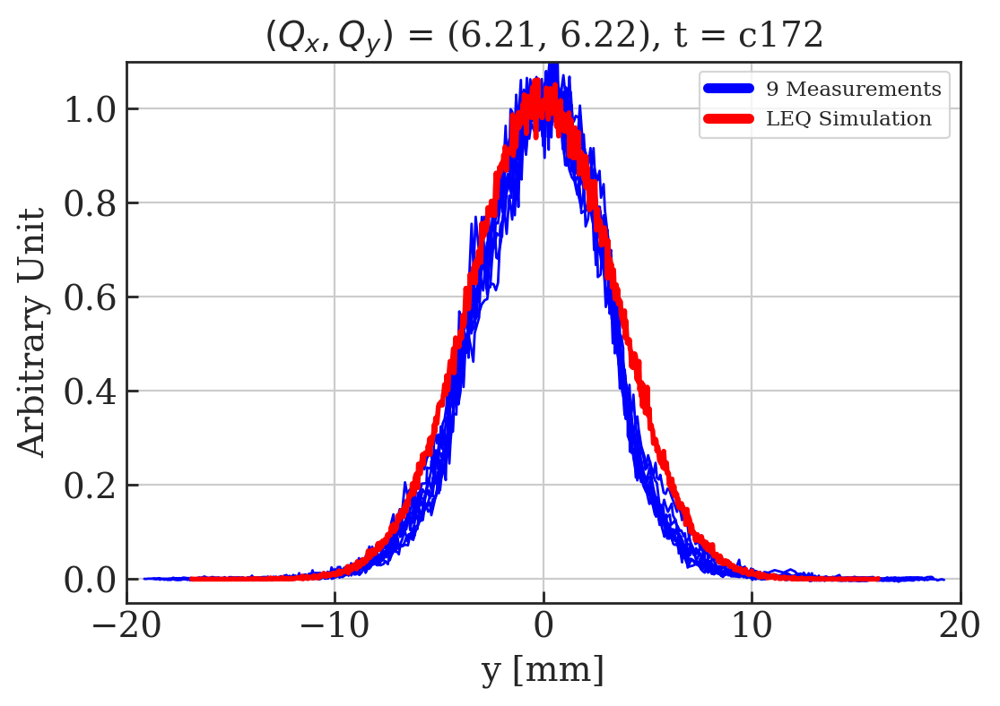

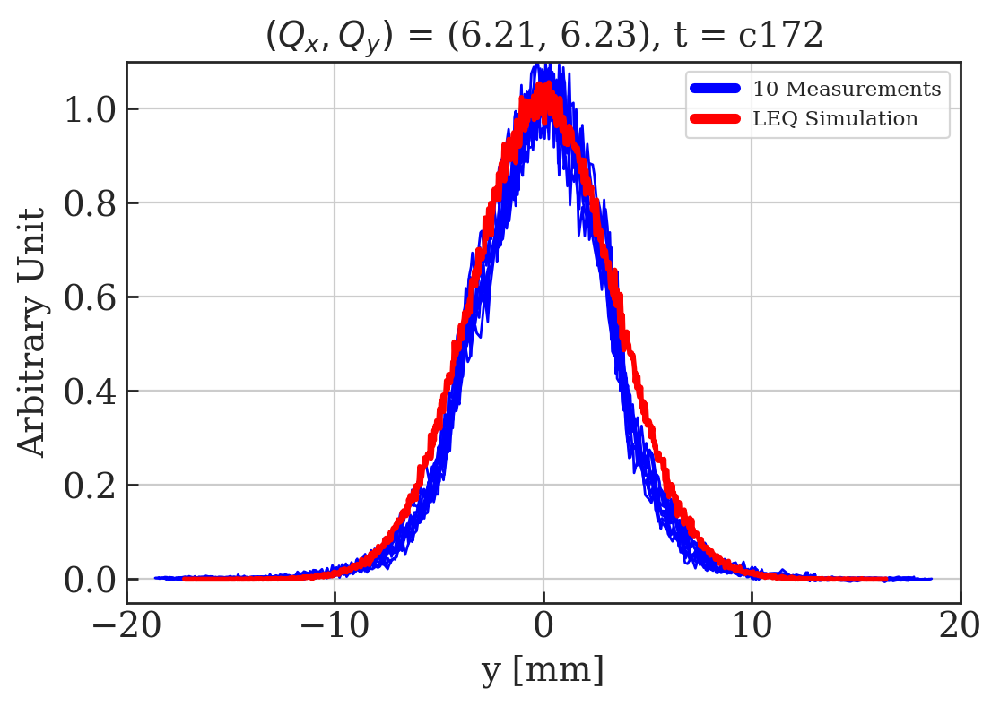

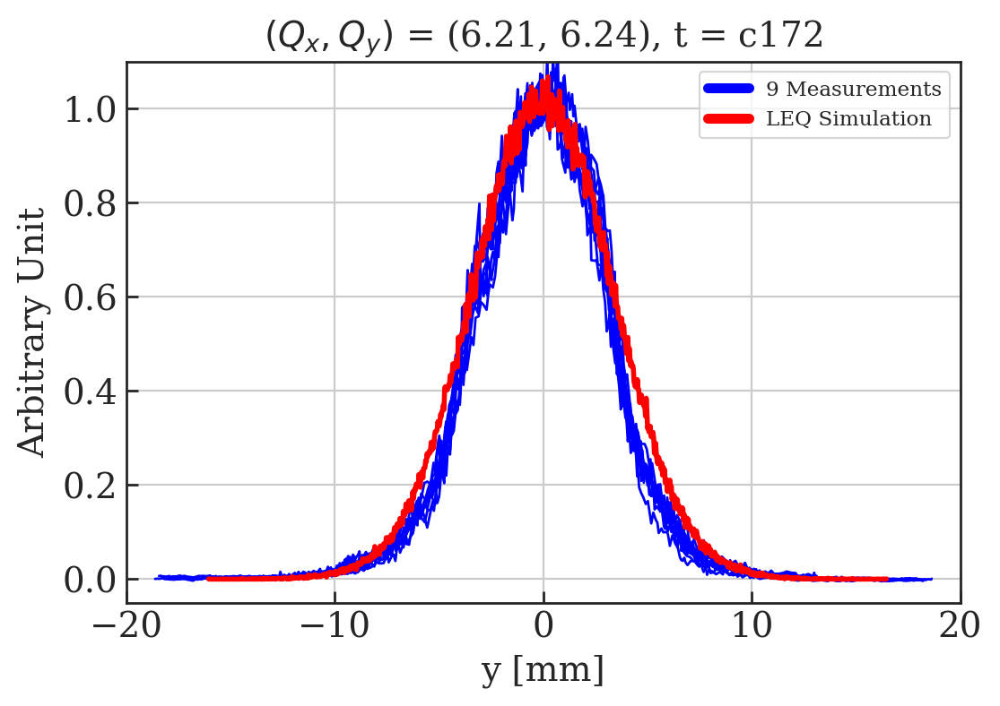

In [54]:
# Main function to plot comparison plots with MD data
verbose = True

plotted_names = []

for key, value in sorted(sims.iteritems()):
    if key not in plotted_names:        
        
        plotted_names.append(key)
        
        this_plot = []
        this_plot.append(value)
        if verbose: print '\nImporting simulation file:', key        

        tune_y = float(key.split('_')[0])/100
        ctime = (key.split('_')[2])
        time = float(ctime.split('c')[1])
        label = (key.split('_')[1])
        if verbose: print 'Qy = ', tune_y, ', ctime =', time, '[ms], label = ', label
        
        sim_labels=['Simulation']

        # Find MD data with same tune and ctime    
        for key1, value1 in sorted(sims.iteritems()):
#             if verbose: print '\tChecking other files:', key1  
            tune_y1 = float(key1.split('_')[0])/100
            ctime1 = (key1.split('_')[2])
            time1 = float(ctime1.split('c')[1])
            label1 = (key1.split('_')[1])
#             if verbose: print '\tQy = ', tune_y1, ', ctime =', time1, '[ms], label = ', label1
            if (tune_y1 == tune_y) and (time1 == time):
                if (label1 != label):
                    print '\tMATCH FOUND' 
                    print '\tQy = ', tune_y1, ', ctime =', time1, '[ms]'
                    print '\tlab = ', label, ', lab1 =', label1

                    this_plot.append(value1)
                    plotted_names.append(key1)
                    sim_labels.append(label1)

        # Find rows in dataframe at correct tune and WS time
        md_points = []
        for i in tune_points[tune_y]:
            if df0['PR.BWS.64.V_ROT:ACQ_DELAY'].iloc()[i] == time:
                md_points.append(i)          

        if verbose: print md_points                 

        # Plot data
        main_label = r'$(Q_x, Q_y)$ = (6.21, ' + str(tune_y) + '), t = ' + str(ctime)
        save_name = 'V_Scan_WS_cf_' + str(tune_y)        
        Plot_profiles_cf_sc_models_single(df0, md_points, particles_from_matfile(this_plot[0]), 1, main_label=main_label, save_name=save_name, bins=1000, sim_labels=sim_labels, plot_md=True)  


# Calculate emittances for simulated bunches

Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.11 , ctime = 172.0 [ms]
Qy =  6.12 , ctime = 172.0 [ms]
Qy =  6.13 , ctime = 172.0 [ms]
Qy =  6.14 , ctime = 172.0 [ms]
Qy =  6.15 , ctime = 172.0 [ms]
Qy =  6.16 , ctime = 172.0 [ms]
Qy =  6.17 , ctime = 172.0 [ms]
Qy =  6.18 , ctime = 172.0 [ms]
Qy =  6.19 , ctime = 172.0 [ms]
Qy =  6.2 , ctime = 172.0 [ms]
Qy =  6.21 , ctime = 172.0 [ms]
Qy =  6.22 , ctime = 172.0 [ms]
Qy =  6.23 , ctime = 172.0 [ms]
Qy =  6.24 , ctime = 172.0 [ms]


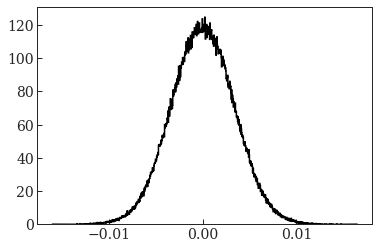

In [89]:
# Make dataframe with name, tunes, position V, profile V 
data = []

# Each row as a list
for key, value in sorted(sims.iteritems()):
    
    tune_y = float(key.split('_')[0])/100
    ctime = (key.split('_')[2])
    time = float(ctime.split('c')[1])
    if verbose: print 'Qy = ', tune_y, ', ctime =', time, '[ms]'

    d = particles_from_matfile(value)
    plt.clf()
    x1, bins_1, p1 = plt.hist(d['particles']['y'][0][0][0], bins = 1000, density=True, histtype=u'step', lw=1.5, color='k')
          
    qx = 6.21
    qy = tune_y
    pos = np.array(bins_1[:-1]) + (abs(bins_1[0]-bins_1[1])/2)
    prof = x1
    
    new_data = [qx, qy, pos, prof]
    
    data.append(new_data)    

# Create dataframe
df_sim = pd.DataFrame(data, columns = ['Qx', 'Qy', 'PR.BWS.64.V_ROT:PROF_POSITION_IN', 'PR.BWS.64.V_ROT:PROF_DATA_IN'])

In [90]:
df_sim

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN
0,6.21,6.10,"[-0.018336524262631777, -0.018299388046338537,...","[0.05385578283494196, 0.053855782834946984, 0...."
1,6.21,6.11,"[-0.017897884667716323, -0.017861127478334432,...","[0.05441112428975725, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2,6.21,6.12,"[-0.017234274281224933, -0.017198961712056614,...","[0.05663705720382146, 0.05663705720382146, 0.0..."
3,6.21,6.13,"[-0.01777937036092625, -0.017744034386433065, ...","[0.056599542779999644, 0.0, 0.0, 0.0, 0.0, 0.0..."
4,6.21,6.14,"[-0.017314391108265735, -0.017280163423243088,...","[0.05843223106314832, 0.0, 0.0, 0.0, 0.0, 0.0,..."
5,6.21,6.15,"[-0.01678995136447054, -0.01675551975533863, -...","[0.058086161246135234, 0.0, 0.0, 0.0, 0.0, 0.0..."
6,6.21,6.16,"[-0.01662956274958312, -0.01659519894699174, -...","[0.058200776665554954, 0.0, 0.0, 0.0, 0.0, 0.0..."
7,6.21,6.17,"[-0.01676523009449811, -0.016731565127919068, ...","[0.059408940606081255, 0.0, 0.0, 0.0, 0.0, 0.0..."
8,6.21,6.18,"[-0.01701738602640985, -0.016985528885475082, ...","[0.06278027284669269, 0.0, 0.0, 0.0, 0.0, 0.0,..."
9,6.21,6.19,"[-0.016749978476160467, -0.01671705404308459, ...","[0.06074516136362366, 0.0, 0.0, 0.0, 0.0, 0.0,..."


In [91]:
# Gaussian and 2nd moment fits
df_sim_filtered = Multi_filter_sim(df_sim, with_plot = True, WS = '64.V', smooth=True)


Multi_filter row  0

	initial guess: mu0 -1.1053199025704685
	initial guess: offs0 0.0
	initial guess: ampl 65.9025520867946
	initial guess: slope 0
	initial guess: sigma0 29.015132900022692
3 parameter fit sigma =  5.831853534405726  +/-  0.025243763483920295
Removing centre shift of  -0.00434768869205144
Second moment =  5.215901335311988


/usr/local/bin/start_ipykernel.py:81: RuntimeWarning: invalid value encountered in sqrt
/usr/local/bin/start_ipykernel.py:83: RuntimeWarning: invalid value encountered in sqrt



Multi_filter row  1

	initial guess: mu0 -0.32794814317416676
	initial guess: offs0 0.0
	initial guess: ampl 71.76257272516827
	initial guess: slope 0
	initial guess: sigma0 28.71899297778035
3 parameter fit sigma =  5.334954341390913  +/-  0.024579907901204522
Removing centre shift of  0.00947283687889983
Second moment =  4.762883257919629

Multi_filter row  2

	initial guess: mu0 -0.0017405270850805177
	initial guess: offs0 0.003775803813588097
	initial guess: ampl 79.1111809028423
	initial guess: slope 0
	initial guess: sigma0 27.590287587986268
3 parameter fit sigma =  4.878358891590908  +/-  0.01909606667381773
Removing centre shift of  0.000970769978310762
Second moment =  4.411964186837485

Multi_filter row  3

	initial guess: mu0 0.5953363755296405
	initial guess: offs0 0.0
	initial guess: ampl 85.19524892225054
	initial guess: slope 0
	initial guess: sigma0 27.60857455093813
3 parameter fit sigma =  4.540819756131624  +/-  0.015439410832785485
Removing centre shift of  0.0075

In [92]:
df_sim_filtered

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V
0,6.21,6.10,"[-0.018336524262631777, -0.018299388046338537,...","[0.05385578283494196, 0.053855782834946984, 0....",5.215901,5.831853534405726,0.025244,1032.1057238657932,-0.00434768869205144,"[-18.332176573939726, -18.295040357646485, -18...","[0.024683900466016165, 0.022183453405822322, 0..."
1,6.21,6.11,"[-0.017897884667716323, -0.017861127478334432,...","[0.05441112428975725, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.762883,5.334954341390913,0.024580,1032.8427902309593,0.00947283687889983,"[-17.907357504595222, -17.87060031521333, -17....","[0.00725481657196764, 0.007254816571967639, 0...."
2,6.21,6.12,"[-0.017234274281224933, -0.017198961712056614,...","[0.05663705720382146, 0.05663705720382146, 0.0...",4.411964,4.878358891590908,0.019096,1029.1173228332207,0.000970769978310762,"[-17.235245051203243, -17.199932482034924, -17...","[0.034926185275689886, 0.03209433241549881, 0...."
3,6.21,6.13,"[-0.01777937036092625, -0.017744034386433065, ...","[0.056599542779999644, 0.0, 0.0, 0.0, 0.0, 0.0...",4.155427,4.540819756131624,0.015439,1025.7884941811117,0.007599674860356468,"[-17.786970035786606, -17.75163406129342, -17....","[0.013678222838499917, 0.012263234268999926, 0..."
4,6.21,6.14,"[-0.017314391108265735, -0.017280163423243088,...","[0.05843223106314832, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.940359,4.2031453134318175,0.009685,1018.7506992786883,0.0008299039660170277,"[-17.315221012231753, -17.280993327209107, -17...","[0.014121122506927514, 0.012660316730348805, 0..."
5,6.21,6.15,"[-0.01678995136447054, -0.01675551975533863, -...","[0.058086161246135234, 0.0, 0.0, 0.0, 0.0, 0.0...",3.799143,3.9956166865087868,0.007325,1014.7396923476972,0.00024145258702294012,"[-16.790192817057566, -16.75576120792565, -16....","[0.01403748896781602, 0.01258533493666264, 0.0..."
6,6.21,6.16,"[-0.01662956274958312, -0.01659519894699174, -...","[0.058200776665554954, 0.0, 0.0, 0.0, 0.0, 0.0...",3.699441,3.8465746999707298,0.005848,1011.511268744237,0.00950898128818117,"[-16.6390717308713, -16.60470792827992, -16.57...","[0.014065187694175781, 0.012610168277536906, 0..."
7,6.21,6.17,"[-0.01676523009449811, -0.016731565127919068, ...","[0.059408940606081255, 0.0, 0.0, 0.0, 0.0, 0.0...",3.633305,3.740254472779564,0.004343,1008.6114055547016,0.0035260855459757013,"[-16.768756180044086, -16.735091213465044, -16...","[0.014357160646469642, 0.01287193713131761, 0...."
8,6.21,6.18,"[-0.01701738602640985, -0.016985528885475082, ...","[0.06278027284669269, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.580267,3.6616135251652673,0.003272,1006.6151800473162,0.004485537690597465,"[-17.021871564100447, -16.99001442316568, -16....","[0.015171899271284072, 0.013602392450116754, 0..."
9,6.21,6.19,"[-0.016749978476160467, -0.01671705404308459, ...","[0.06074516136362366, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.536816,3.6009308890506113,0.002408,1005.2002456720561,0.0022186634570713084,"[-16.75219713961754, -16.719272706541663, -16....","[0.014680080662875718, 0.013161451628785126, 0..."


# Calculate Emittance for simulated bunches

In [93]:
# Calculate emittances in Vertical
df_sim_emittance = emittance_df(df_sim_filtered, WS='64.V', verbose=True)

Emittance  0  =  3.2510024815930265
Emittance  1  =  2.7616962045692572
Emittance  2  =  2.3369359089161788
Emittance  3  =  2.0442827130710373
Emittance  4  =  1.7652560412328968
Emittance  5  =  1.6054311524219893
Emittance  6  =  1.4956855938010798
Emittance  7  =  1.4202336836399745
Emittance  8  =  1.3659643508628896
Emittance  9  =  1.32492160615831
Emittance  10  =  1.303465731746498
Emittance  11  =  1.2560220843746064
Emittance  12  =  1.2121659017911608
Emittance  13  =  1.1726775661341282
Emittance  14  =  1.1575978408200618


In [94]:
df_sim_emittance

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V,emittance V,betx,bety,dx,dy
0,6.21,6.10,"[-0.018336524262631777, -0.018299388046338537,...","[0.05385578283494196, 0.053855782834946984, 0....",5.215901,5.831853534405726,0.025244,1032.1057238657932,-0.00434768869205144,"[-18.332176573939726, -18.295040357646485, -18...","[0.024683900466016165, 0.022183453405822322, 0...",3.251002,12.391799,23.637581,NaN,0.0
1,6.21,6.11,"[-0.017897884667716323, -0.017861127478334432,...","[0.05441112428975725, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.762883,5.334954341390913,0.024580,1032.8427902309593,0.00947283687889983,"[-17.907357504595222, -17.87060031521333, -17....","[0.00725481657196764, 0.007254816571967639, 0....",2.761696,12.404327,23.285878,NaN,0.0
2,6.21,6.12,"[-0.017234274281224933, -0.017198961712056614,...","[0.05663705720382146, 0.05663705720382146, 0.0...",4.411964,4.878358891590908,0.019096,1029.1173228332207,0.000970769978310762,"[-17.235245051203243, -17.199932482034924, -17...","[0.034926185275689886, 0.03209433241549881, 0....",2.336936,12.416825,23.009533,NaN,0.0
3,6.21,6.13,"[-0.01777937036092625, -0.017744034386433065, ...","[0.056599542779999644, 0.0, 0.0, 0.0, 0.0, 0.0...",4.155427,4.540819756131624,0.015439,1025.7884941811117,0.007599674860356468,"[-17.786970035786606, -17.75163406129342, -17....","[0.013678222838499917, 0.012263234268999926, 0...",2.044283,12.429283,22.789494,NaN,0.0
4,6.21,6.14,"[-0.017314391108265735, -0.017280163423243088,...","[0.05843223106314832, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.940359,4.2031453134318175,0.009685,1018.7506992786883,0.0008299039660170277,"[-17.315221012231753, -17.280993327209107, -17...","[0.014121122506927514, 0.012660316730348805, 0...",1.765256,12.441691,22.612481,NaN,0.0
5,6.21,6.15,"[-0.01678995136447054, -0.01675551975533863, -...","[0.058086161246135234, 0.0, 0.0, 0.0, 0.0, 0.0...",3.799143,3.9956166865087868,0.007325,1014.7396923476972,0.00024145258702294012,"[-16.790192817057566, -16.75576120792565, -16....","[0.01403748896781602, 0.01258533493666264, 0.0...",1.605431,12.454044,22.468965,NaN,0.0
6,6.21,6.16,"[-0.01662956274958312, -0.01659519894699174, -...","[0.058200776665554954, 0.0, 0.0, 0.0, 0.0, 0.0...",3.699441,3.8465746999707298,0.005848,1011.511268744237,0.00950898128818117,"[-16.6390717308713, -16.60470792827992, -16.57...","[0.014065187694175781, 0.012610168277536906, 0...",1.495686,12.466338,22.351936,NaN,0.0
7,6.21,6.17,"[-0.01676523009449811, -0.016731565127919068, ...","[0.059408940606081255, 0.0, 0.0, 0.0, 0.0, 0.0...",3.633305,3.740254472779564,0.004343,1008.6114055547016,0.0035260855459757013,"[-16.768756180044086, -16.735091213465044, -16...","[0.014357160646469642, 0.01287193713131761, 0....",1.420234,12.478571,22.256128,NaN,0.0
8,6.21,6.18,"[-0.01701738602640985, -0.016985528885475082, ...","[0.06278027284669269, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.580267,3.6616135251652673,0.003272,1006.6151800473162,0.004485537690597465,"[-17.021871564100447, -16.99001442316568, -16....","[0.015171899271284072, 0.013602392450116754, 0...",1.365964,12.490741,22.177508,NaN,0.0
9,6.21,6.19,"[-0.016749978476160467, -0.01671705404308459, ...","[0.06074516136362366, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.536816,3.6009308890506113,0.002408,1005.2002456720561,0.0022186634570713084,"[-16.75219713961754, -16.719272706541663, -16....","[0.014680080662875718, 0.013161451628785126, 0...",1.324922,12.502846,22.112941,NaN,0.0


In [95]:
df_sim_emittance_2 = emittance_df_2(df_sim_emittance, WS='64.V', verbose=True)

Emittance from 2nd moment 0  =  2.6005356979206247
Emittance from 2nd moment 1  =  2.201173941165556
Emittance from 2nd moment 2  =  1.9114514171656614
Emittance from 2nd moment 3  =  1.711999729290482
Emittance from 2nd moment 4  =  1.551423555000339
Emittance from 2nd moment 5  =  1.451427597946281
Emittance from 2nd moment 6  =  1.3834520662567824
Emittance from 2nd moment 7  =  1.3401743865324443
Emittance from 2nd moment 8  =  1.3059462226929381
Emittance from 2nd moment 9  =  1.2781607808307325
Emittance from 2nd moment 10  =  1.2535706199237713
Emittance from 2nd moment 11  =  1.2144605899863037
Emittance from 2nd moment 12  =  1.1800450376200857
Emittance from 2nd moment 13  =  1.1590829197481654
Emittance from 2nd moment 14  =  1.1617205987128187


# Calculate Emittance using 2nd moment for simulated bunches

In [96]:
df_sim_emittance_2

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V,emittance V,betx,bety,dx,dy,emittance V 2ndMoment
0,6.21,6.10,"[-0.018336524262631777, -0.018299388046338537,...","[0.05385578283494196, 0.053855782834946984, 0....",5.215901,5.831853534405726,0.025244,1032.1057238657932,-0.00434768869205144,"[-18.332176573939726, -18.295040357646485, -18...","[0.024683900466016165, 0.022183453405822322, 0...",3.251002,12.391799,23.637581,NaN,0.0,2.600536
1,6.21,6.11,"[-0.017897884667716323, -0.017861127478334432,...","[0.05441112428975725, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.762883,5.334954341390913,0.024580,1032.8427902309593,0.00947283687889983,"[-17.907357504595222, -17.87060031521333, -17....","[0.00725481657196764, 0.007254816571967639, 0....",2.761696,12.404327,23.285878,NaN,0.0,2.201174
2,6.21,6.12,"[-0.017234274281224933, -0.017198961712056614,...","[0.05663705720382146, 0.05663705720382146, 0.0...",4.411964,4.878358891590908,0.019096,1029.1173228332207,0.000970769978310762,"[-17.235245051203243, -17.199932482034924, -17...","[0.034926185275689886, 0.03209433241549881, 0....",2.336936,12.416825,23.009533,NaN,0.0,1.911451
3,6.21,6.13,"[-0.01777937036092625, -0.017744034386433065, ...","[0.056599542779999644, 0.0, 0.0, 0.0, 0.0, 0.0...",4.155427,4.540819756131624,0.015439,1025.7884941811117,0.007599674860356468,"[-17.786970035786606, -17.75163406129342, -17....","[0.013678222838499917, 0.012263234268999926, 0...",2.044283,12.429283,22.789494,NaN,0.0,1.712000
4,6.21,6.14,"[-0.017314391108265735, -0.017280163423243088,...","[0.05843223106314832, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.940359,4.2031453134318175,0.009685,1018.7506992786883,0.0008299039660170277,"[-17.315221012231753, -17.280993327209107, -17...","[0.014121122506927514, 0.012660316730348805, 0...",1.765256,12.441691,22.612481,NaN,0.0,1.551424
5,6.21,6.15,"[-0.01678995136447054, -0.01675551975533863, -...","[0.058086161246135234, 0.0, 0.0, 0.0, 0.0, 0.0...",3.799143,3.9956166865087868,0.007325,1014.7396923476972,0.00024145258702294012,"[-16.790192817057566, -16.75576120792565, -16....","[0.01403748896781602, 0.01258533493666264, 0.0...",1.605431,12.454044,22.468965,NaN,0.0,1.451428
6,6.21,6.16,"[-0.01662956274958312, -0.01659519894699174, -...","[0.058200776665554954, 0.0, 0.0, 0.0, 0.0, 0.0...",3.699441,3.8465746999707298,0.005848,1011.511268744237,0.00950898128818117,"[-16.6390717308713, -16.60470792827992, -16.57...","[0.014065187694175781, 0.012610168277536906, 0...",1.495686,12.466338,22.351936,NaN,0.0,1.383452
7,6.21,6.17,"[-0.01676523009449811, -0.016731565127919068, ...","[0.059408940606081255, 0.0, 0.0, 0.0, 0.0, 0.0...",3.633305,3.740254472779564,0.004343,1008.6114055547016,0.0035260855459757013,"[-16.768756180044086, -16.735091213465044, -16...","[0.014357160646469642, 0.01287193713131761, 0....",1.420234,12.478571,22.256128,NaN,0.0,1.340174
8,6.21,6.18,"[-0.01701738602640985, -0.016985528885475082, ...","[0.06278027284669269, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.580267,3.6616135251652673,0.003272,1006.6151800473162,0.004485537690597465,"[-17.021871564100447, -16.99001442316568, -16....","[0.015171899271284072, 0.013602392450116754, 0...",1.365964,12.490741,22.177508,NaN,0.0,1.305946
9,6.21,6.19,"[-0.016749978476160467, -0.01671705404308459, ...","[0.06074516136362366, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.536816,3.6009308890506113,0.002408,1005.2002456720561,0.0022186634570713084,"[-16.75219713961754, -16.719272706541663, -16....","[0.014680080662875718, 0.013161451628785126, 0...",1.324922,12.502846,22.112941,NaN,0.0,1.278161


# Save simulation dataframe to pickle file

In [97]:
df_sim_emittance_2.to_pickle('MD4224_HighBrightness_Vertical_Using_Sim_Optics_Complete_simulation_data')

In [98]:
df0_sim = pnd.read_pickle('MD4224_HighBrightness_Vertical_Using_Sim_Optics_Complete_simulation_data')

# Plots

In [99]:
path = "./Simulation_CF"
make_directory(path)

Creation of the directory ./Simulation_CF failed


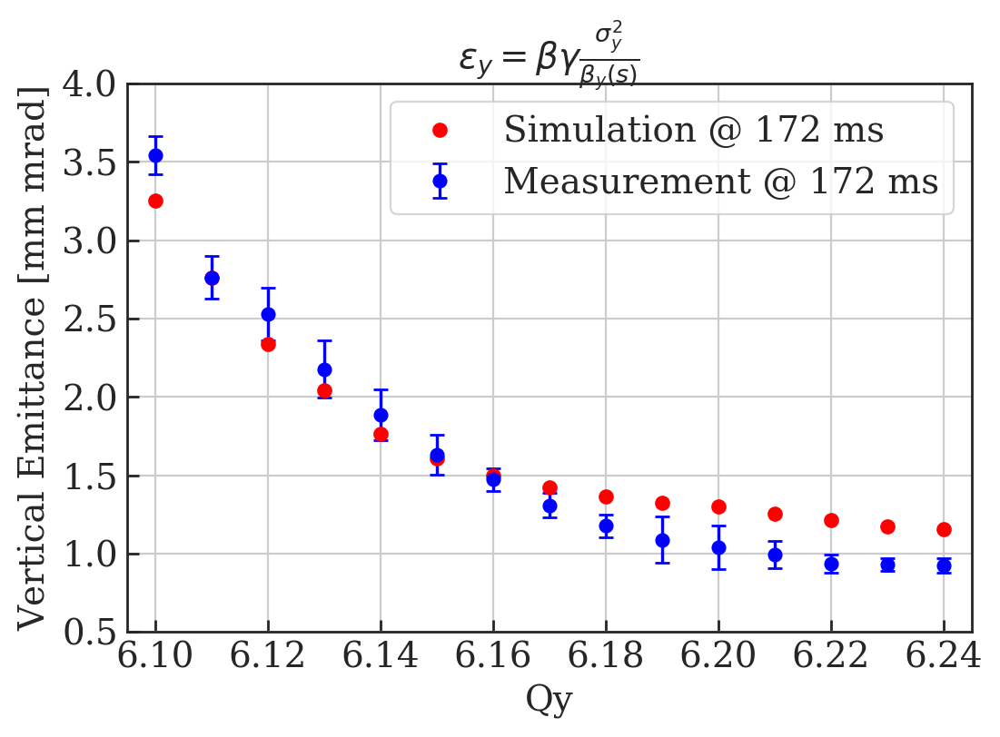

In [100]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_sim['Qy'], df0_sim['emittance V'], label='Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\sigma_y^2}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Simulation_CF/MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_Errors_Using_Sim_Optics_Sim_172.png');

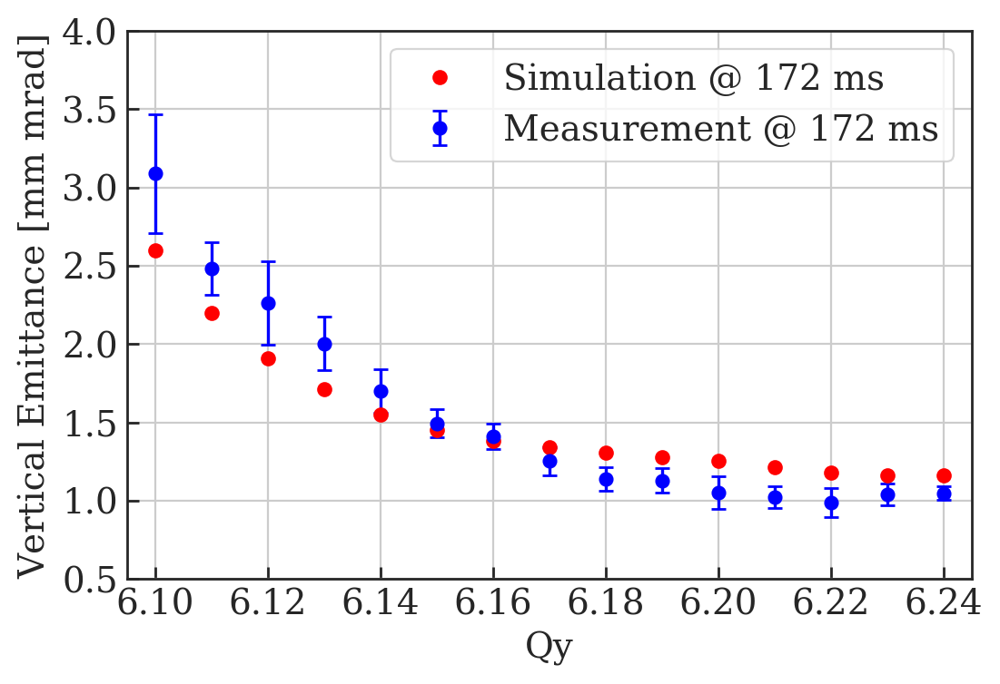

In [101]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_sim['Qy'], df0_sim['emittance V 2ndMoment'], label='Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Simulation_CF/MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics_Sim_172.png');

# Load PFW Simulation data 

In [102]:
# Read .mat files into a dictionary

matfiles = glob.glob("../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/*.mat")

pfw_sims = dict()

for f in matfiles:
    first = f.split('/')[-1]
    second = first.split('.')[0]
    pfw_sims[str(second)] = f
    
pfw_sims

{'610_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/610_SbS_c172.mat',
 '611_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/611_SbS_c172.mat',
 '612_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/612_SbS_c172.mat',
 '613_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/613_SbS_c172.mat',
 '614_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/614_SbS_c172.mat',
 '615_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/615_SbS_c172.mat',
 '616_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/616_SbS_c172.mat',
 '617_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/617_SbS_c172.mat',
 '618_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/618_SbS_c172.mat',
 '619_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/619_SbS_c172.mat',
 '620_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/620_SbS_c172.mat',
 '621_SbS_c172': '../MD4224_Repo_Outputs/V_PFW/Simulat

In [103]:
for key, value in sorted(pfw_sims.iteritems()):
    print value
    d = particles_from_matfile(value)
    plt.clf()
    x, bins_, p = plt.hist(d['particles']['y'][0][0][0], bins = 1000, density=True, histtype=u'step', lw=0, color='k')

    peak = peakfinder(np.array(bins_[:-1]), np.array(x), verbose=True)
    print '\n peak = ', peak, '\n'
    plt.close()

../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/610_SbS_c172.mat

	MAX(y_dat) =  119.35946452273119
	x_dat[index] =  0.00020648146647207766
	index of x_dat =  0.00020648146647207766  is  521
	Mean of peak point +/- 3 points =  116.31458022368909

 peak =  116.31458022368909 

../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/611_SbS_c172.mat

	MAX(y_dat) =  121.43913628741299
	x_dat[index] =  -0.000296912374036817
	index of x_dat =  -0.000296912374036817  is  495
	Mean of peak point +/- 3 points =  114.67541463466726

 peak =  114.67541463466726 

../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/612_SbS_c172.mat

	MAX(y_dat) =  120.52317992761654
	x_dat[index] =  0.0008937355962074858
	index of x_dat =  0.0008937355962074858  is  516
	Mean of peak point +/- 3 points =  112.9607298569024

 peak =  112.9607298569024 

../MD4224_Repo_Outputs/V_PFW/Simulation_Profiles/613_SbS_c172.mat

	MAX(y_dat) =  122.55627721990744
	x_dat[index] =  0.0002893733536681268
	index of x_dat =  0.00028937335


Importing simulation file: 610_SbS_c172
Qy =  6.1 , ctime = 172.0 [ms], label =  SbS
[13, 57, 99, 144, 186, 228, 272, 314, 356, 397]

	MAX(y_dat) =  0.11935946452274326
	x_dat[index] =  0.20648146647208065
	index of x_dat =  0.20648146647208065  is  521
	Mean of peak point +/- 3 points =  0.11631458022369004

Importing simulation file: 611_SbS_c172
Qy =  6.11 , ctime = 172.0 [ms], label =  SbS
[12, 56, 98, 143, 227, 271, 313, 396]

	MAX(y_dat) =  0.12143913628741775
	x_dat[index] =  -0.2969123740368165
	index of x_dat =  -0.2969123740368165  is  495
	Mean of peak point +/- 3 points =  0.1146754146346682

Importing simulation file: 612_SbS_c172
Qy =  6.12 , ctime = 172.0 [ms], label =  SbS
[55, 142, 185, 226, 270, 312]

	MAX(y_dat) =  0.12052317992761896
	x_dat[index] =  0.8937355962074882
	index of x_dat =  0.8937355962074882  is  516
	Mean of peak point +/- 3 points =  0.11296072985690139

Importing simulation file: 613_SbS_c172
Qy =  6.13 , ctime = 172.0 [ms], label =  SbS
[11, 54, 

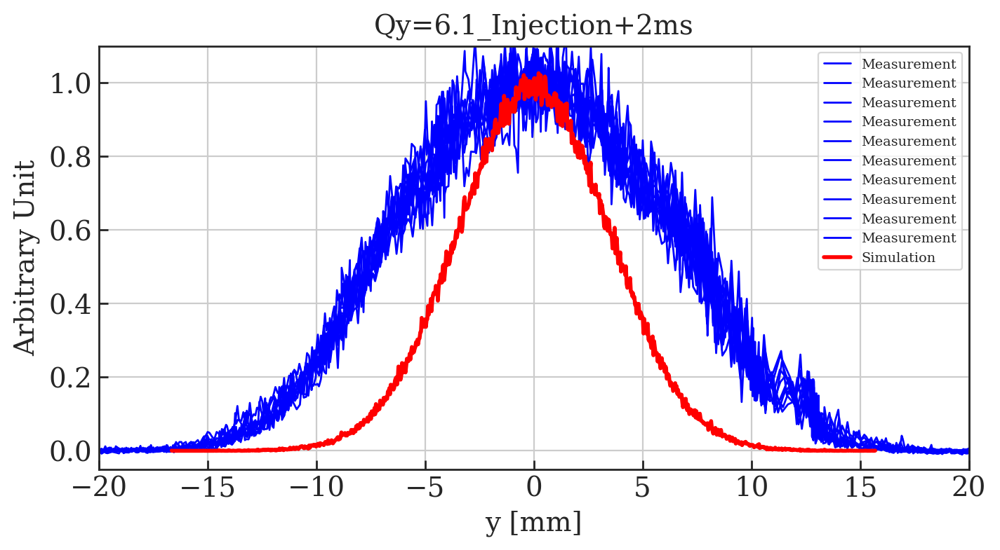

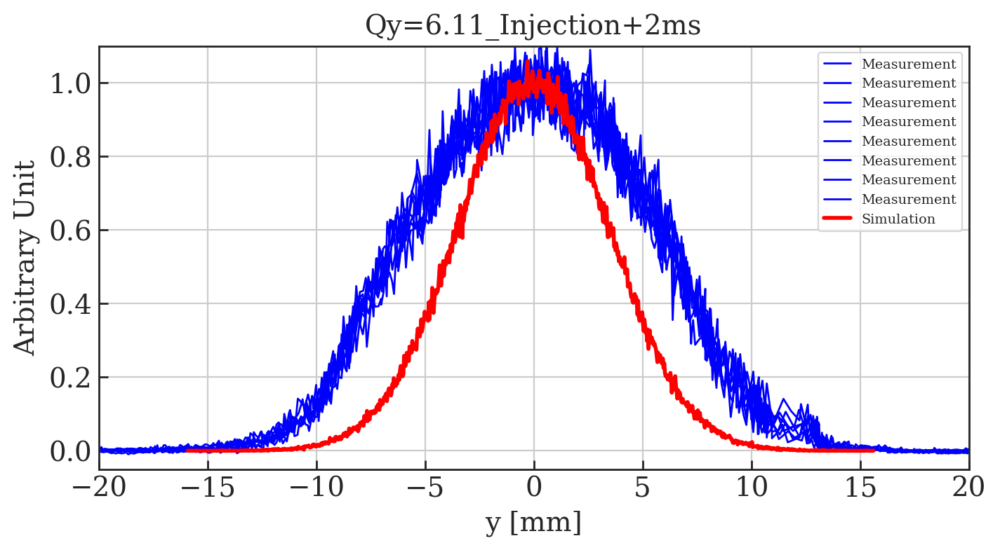

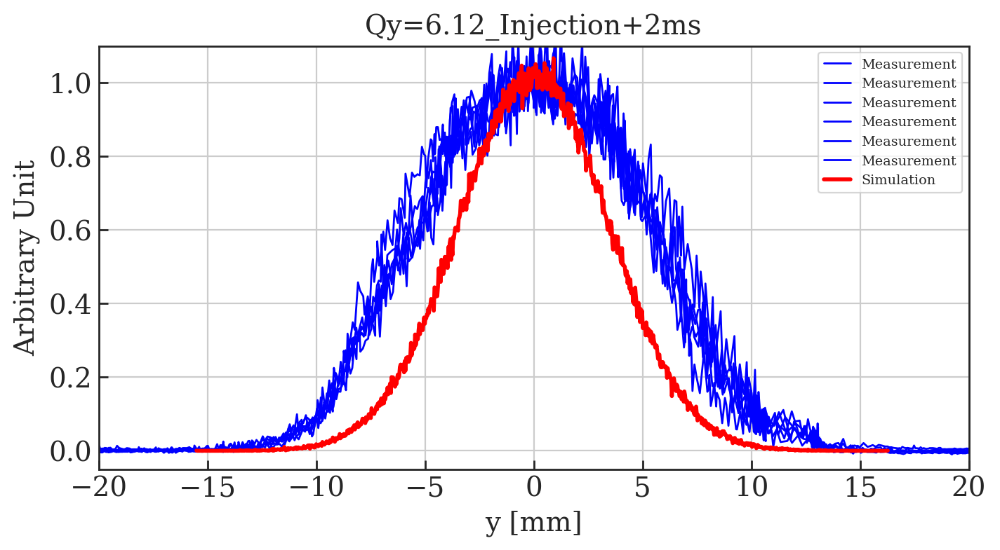

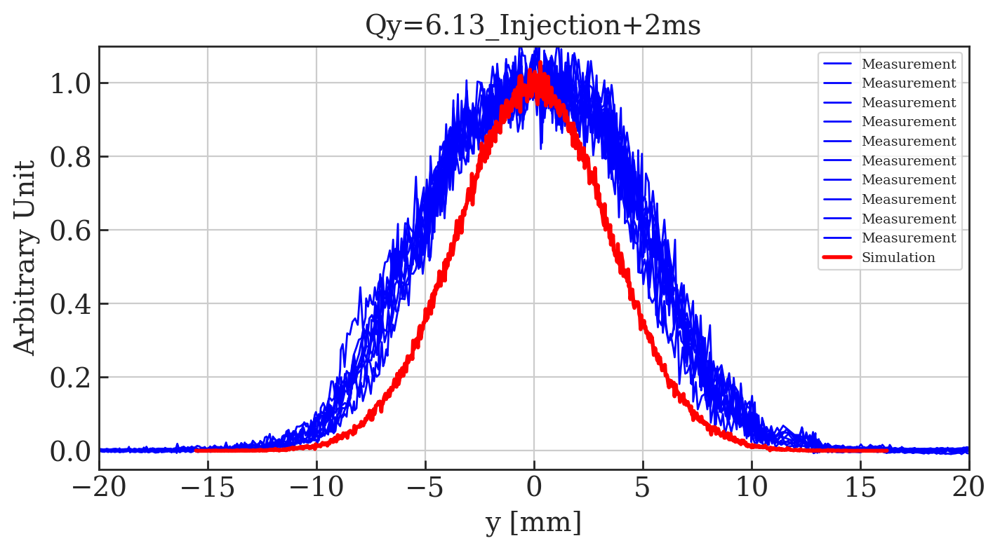

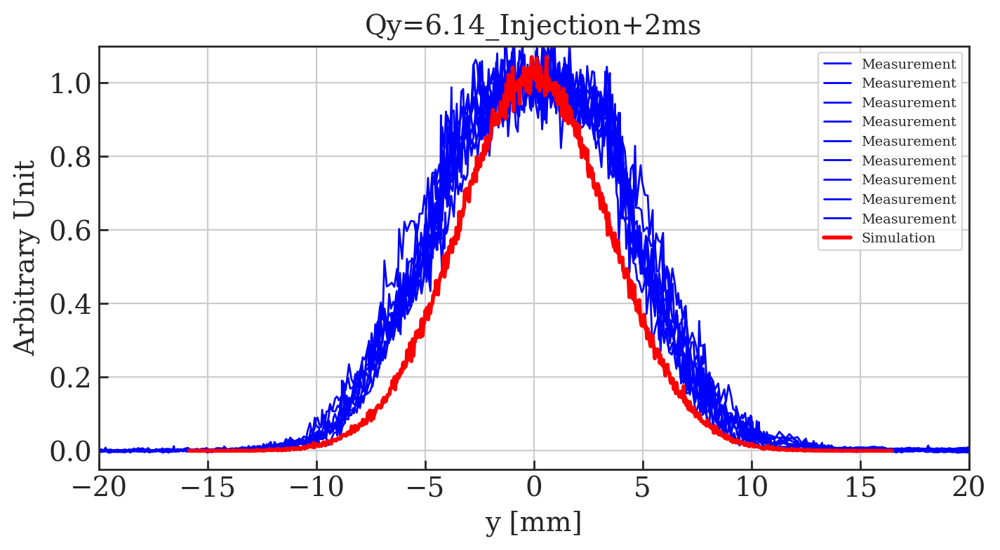

...

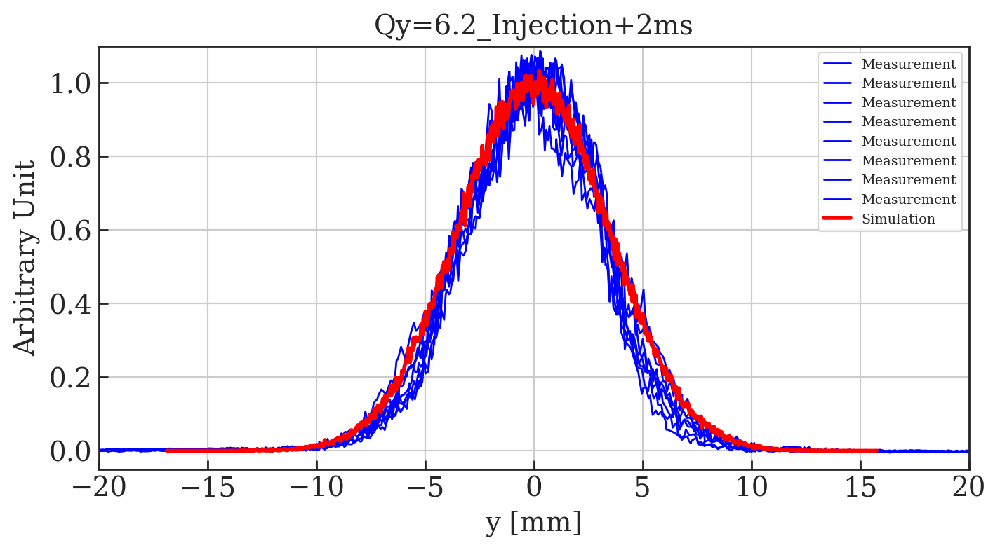

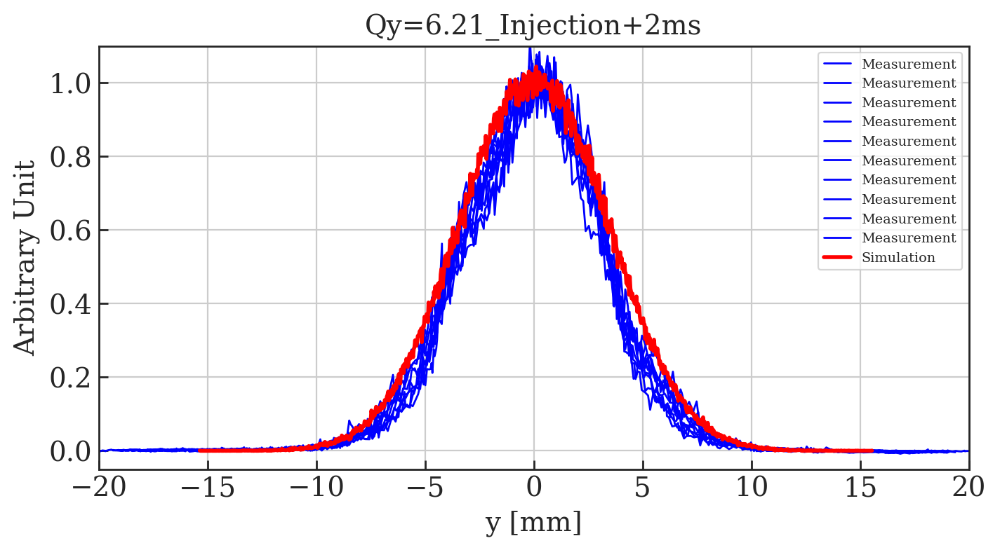

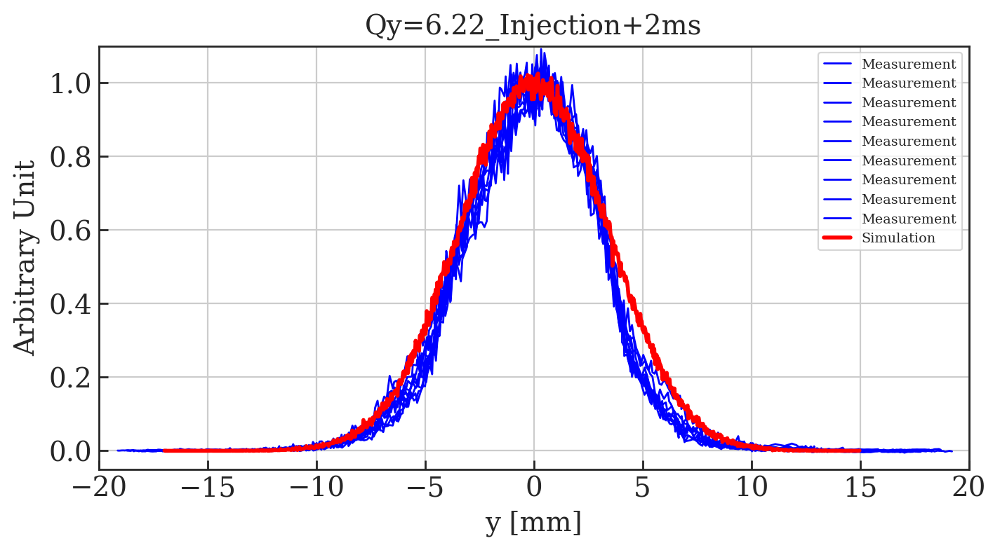

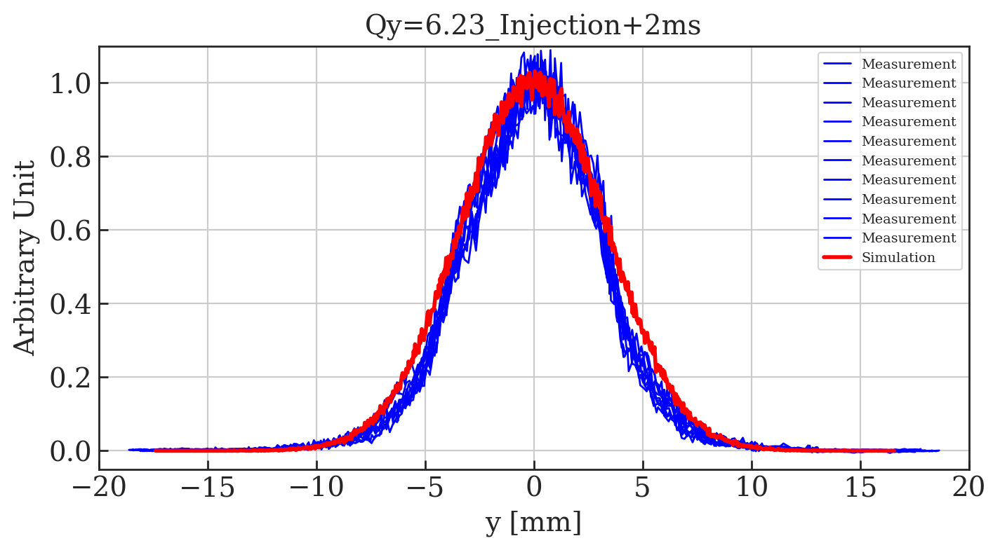

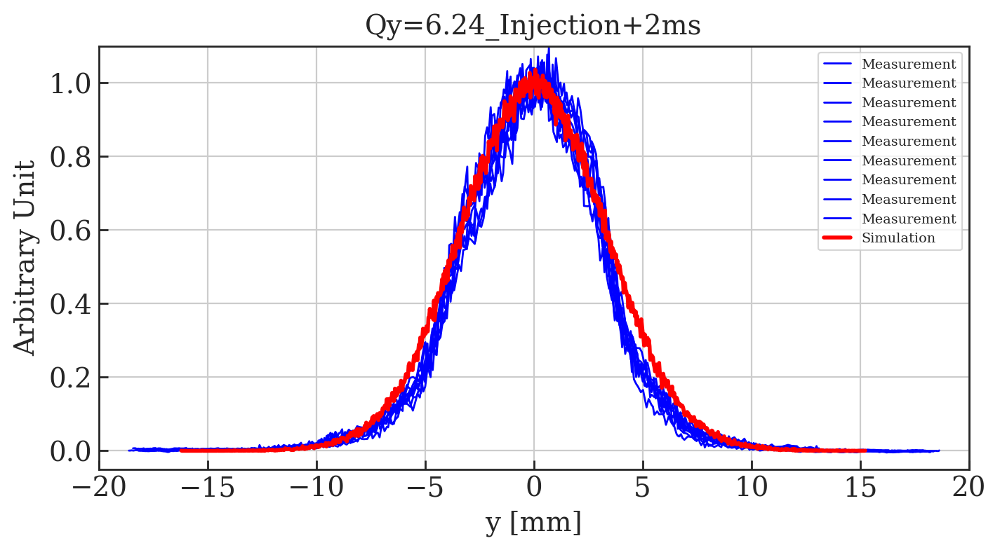

In [104]:
#Main function to plot comparison plots with MD data
verbose = True

plotted_names = []

for key, value in sorted(pfw_sims.iteritems()):
    if key not in plotted_names:        
        
        plotted_names.append(key)
        
        this_plot = []
        this_plot.append(value)
        if verbose: print '\nImporting simulation file:', key        

        tune_y = float(key.split('_')[0])/100
        ctime = (key.split('_')[2])
        time = float(ctime.split('c')[1])
        label = (key.split('_')[1])
        if verbose: print 'Qy = ', tune_y, ', ctime =', time, '[ms], label = ', label
        
        sim_labels=['Simulation']

        # Find MD data with same tune and ctime    
        for key1, value1 in sorted(pfw_sims.iteritems()):
#             if verbose: print '\tChecking other files:', key1  
            tune_y1 = float(key1.split('_')[0])/100
            ctime1 = (key1.split('_')[2])
            time1 = float(ctime1.split('c')[1])
            label1 = (key1.split('_')[1])
#             if verbose: print '\tQy = ', tune_y1, ', ctime =', time1, '[ms], label = ', label1
            if (tune_y1 == tune_y) and (time1 == time):
                if (label1 != label):
                    print '\tMATCH FOUND' 
                    print '\tQy = ', tune_y1, ', ctime =', time1, '[ms]'
                    print '\tlab = ', label, ', lab1 =', label1

                    this_plot.append(value1)
                    plotted_names.append(key1)
                    sim_labels.append(label1)

        # Find rows in dataframe at correct tune and WS time
        md_points = []
        for i in tune_points[tune_y]:
            if df0['PR.BWS.64.V_ROT:ACQ_DELAY'].iloc()[i] == time:
                md_points.append(i)          

        if verbose: print md_points                 

        # Plot data
        main_label = 'Qy=' + str(tune_y) + '_Injection+2ms'
        
        if len(this_plot) is 1:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, main_label=main_label, bins=1000, sim_labels=sim_labels, plot_md=True)  
        elif len(this_plot) is 2:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, particles_from_matfile(this_plot[1]), main_label=main_label, bins=1000, sim_labels=sim_labels, plot_md=True)  
        elif len(this_plot) is 3:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, particles_from_matfile(this_plot[1]), particles_from_matfile(this_plot[2]), main_label=main_label, bins=1000, sim_labels=sim_labels, plot_md=True)  
        else: print 'ERROR: More than 3 space charge methods found'
        


Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.11 , ctime = 172.0 [ms]
Qy =  6.12 , ctime = 172.0 [ms]
Qy =  6.13 , ctime = 172.0 [ms]
Qy =  6.14 , ctime = 172.0 [ms]
Qy =  6.15 , ctime = 172.0 [ms]
Qy =  6.16 , ctime = 172.0 [ms]
Qy =  6.17 , ctime = 172.0 [ms]
Qy =  6.18 , ctime = 172.0 [ms]
Qy =  6.19 , ctime = 172.0 [ms]
Qy =  6.2 , ctime = 172.0 [ms]
Qy =  6.21 , ctime = 172.0 [ms]
Qy =  6.22 , ctime = 172.0 [ms]
Qy =  6.23 , ctime = 172.0 [ms]
Qy =  6.24 , ctime = 172.0 [ms]


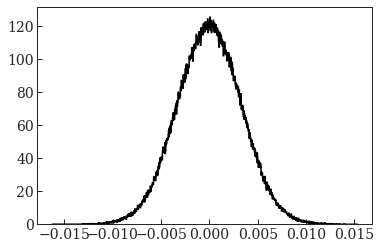

In [105]:
# Make dataframe with name, tunes, position V, profile V 
data = []

# Each row as a list
for key, value in sorted(pfw_sims.iteritems()):
    
    tune_y = float(key.split('_')[0])/100
    ctime = (key.split('_')[2])
    time = float(ctime.split('c')[1])
    if verbose: print 'Qy = ', tune_y, ', ctime =', time, '[ms]'

    d = particles_from_matfile(value)
    plt.clf()
    x1, bins_1, p1 = plt.hist(d['particles']['y'][0][0][0], bins = 1000, density=True, histtype=u'step', lw=1.5, color='k')
          
    qx = 6.21
    qy = tune_y
    pos = np.array(bins_1[:-1]) + (abs(bins_1[0]-bins_1[1])/2)
    prof = x1
    
    new_data = [qx, qy, pos, prof]
    
    data.append(new_data)    

# Create dataframe
df_pfw_sim = pd.DataFrame(data, columns = ['Qx', 'Qy', 'PR.BWS.64.V_ROT:PROF_POSITION_IN', 'PR.BWS.64.V_ROT:PROF_DATA_IN'])

In [106]:
df_pfw_sim

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN
0,6.21,6.10,"[-0.016643560614747782, -0.016611187815360237,...","[0.061780261140136634, 0.0, 0.0, 0.0, 0.0, 0.0..."
1,6.21,6.11,"[-0.015900811231775207, -0.015869256330141763,...","[0.06338159513957185, 0.0, 0.0, 0.0, 0.0, 0.06..."
2,6.21,6.12,"[-0.015504993687128772, -0.015473182379110662,...","[0.06287072505353661, 0.0, 0.0, 0.0, 0.0, 0.0,..."
3,6.21,6.13,"[-0.015525891632898735, -0.015494102155538802,...","[0.06291390001021943, 0.0, 0.0, 0.0, 0.0, 0.0,..."
4,6.21,6.14,"[-0.015843834355067615, -0.015811497358546672,...","[0.06184866299207744, 0.0, 0.0, 0.0, 0.0, 0.0,..."
5,6.21,6.15,"[-0.01716777978858004, -0.017134612353209146, ...","[0.06030010996132585, 0.0, 0.0, 0.0, 0.0, 0.0,..."
6,6.21,6.16,"[-0.016214436544001967, -0.016183146846033204,...","[0.06391880170901156, 0.0, 0.0, 0.0, 0.0, 0.0,..."
7,6.21,6.17,"[-0.015434710924616648, -0.015403188989251661,...","[0.06344788087540536, 0.0, 0.0, 0.0, 0.0, 0.06..."
8,6.21,6.18,"[-0.0167324121476453, -0.01670082984385892, -0...","[0.06332660256603873, 0.0, 0.0, 0.0, 0.0, 0.0,..."
9,6.21,6.19,"[-0.015888638150309893, -0.01585664173465376, ...","[0.06250700145584494, 0.0, 0.0, 0.0, 0.0, 0.0,..."


In [107]:
# Gaussian and 2nd moment fits
df_pfw_sim_filtered = Multi_filter_sim(df_pfw_sim, with_plot = True, WS = '64.V', smooth=True)


Multi_filter row  0

	initial guess: mu0 0.09317666861565106
	initial guess: offs0 0.0
	initial guess: ampl 114.97071244803074
	initial guess: slope 0
	initial guess: sigma0 25.29339739834068
3 parameter fit sigma =  3.478112521466301  +/-  0.0010565879075297496
Removing centre shift of  -0.0010698061294240253
Second moment =  3.4682560199106764


/usr/local/bin/start_ipykernel.py:81: RuntimeWarning: invalid value encountered in sqrt
/usr/local/bin/start_ipykernel.py:83: RuntimeWarning: invalid value encountered in sqrt



Multi_filter row  1

	initial guess: mu0 -0.12336041505286999
	initial guess: offs0 0.0
	initial guess: ampl 114.6204839188802
	initial guess: slope 0
	initial guess: sigma0 24.654360511905818
3 parameter fit sigma =  3.46939156495354  +/-  0.0010538057303008262
Removing centre shift of  -0.017643987574915473
Second moment =  3.462558809220318

Multi_filter row  2

	initial guess: mu0 0.11435854976376593
	initial guess: offs0 0.0
	initial guess: ampl 114.81571563038719
	initial guess: slope 0
	initial guess: sigma0 24.85469501202734
3 parameter fit sigma =  3.4694690214743815  +/-  0.001008990191729793
Removing centre shift of  0.0021258626409109576
Second moment =  3.4647623111483443

Multi_filter row  3

	initial guess: mu0 0.4324260017878282
	initial guess: offs0 0.0
	initial guess: ampl 114.73098641863722
	initial guess: slope 0
	initial guess: sigma0 24.837638361901252
3 parameter fit sigma =  3.468925378861965  +/-  0.001017732293481891
Removing centre shift of  -0.0080673792913

In [108]:
df_pfw_sim_filtered

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V
0,6.21,6.10,"[-0.016643560614747782, -0.016611187815360237,...","[0.061780261140136634, 0.0, 0.0, 0.0, 0.0, 0.0...",3.468256,3.478112521466301,0.001057,1000.8334207009418,-0.0010698061294240253,"[-16.642490808618355, -16.61011800923081, -16....","[0.014930229775533025, 0.013385723247029607, 0..."
1,6.21,6.11,"[-0.015900811231775207, -0.015869256330141763,...","[0.06338159513957185, 0.0, 0.0, 0.0, 0.0, 0.06...",3.462559,3.46939156495354,0.001054,1000.4893714475857,-0.017643987574915473,"[-15.883167244200292, -15.851612342566847, -15...","[0.010563599189928647, 0.011469050549065387, 0..."
2,6.21,6.12,"[-0.015504993687128772, -0.015473182379110662,...","[0.06287072505353661, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.464762,3.4694690214743815,0.001009,1000.2339725055648,0.0021258626409109576,"[-15.507119549769683, -15.475308241751572, -15...","[0.011526299593148385, 0.011077222985623122, 0..."
3,6.21,6.13,"[-0.015525891632898735, -0.015494102155538802,...","[0.06291390001021943, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.459474,3.468925378861965,0.001018,1000.6829183997994,-0.008067379291355566,"[-15.51782425360738, -15.486034776247445, -15....","[0.0152041925024697, 0.013631345002214213, 0.0..."
4,6.21,6.14,"[-0.015843834355067615, -0.015811497358546672,...","[0.06184866299207744, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.454247,3.4624936354855436,0.000929,1000.4956089645178,0.0006681639847307938,"[-15.844502519052346, -15.812165522531403, -15...","[0.014946760223085382, 0.013400543648283445, 0..."
5,6.21,6.15,"[-0.01716777978858004, -0.017134612353209146, ...","[0.06030010996132585, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.453624,3.467051440826948,0.001023,1001.053502476057,0.013256125472165984,"[-17.181035914052202, -17.14786847868131, -17....","[0.014572526573987079, 0.013065023824953932, 0..."
6,6.21,6.16,"[-0.016214436544001967, -0.016183146846033204,...","[0.06391880170901156, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.453865,3.47226285175896,0.001120,1001.4494087449834,0.009137340612932103,"[-16.223573884614897, -16.192284186646134, -16...","[0.015447043746344464, 0.013849073703619175, 0..."
7,6.21,6.17,"[-0.015434710924616648, -0.015403188989251661,...","[0.06344788087540536, 0.0, 0.0, 0.0, 0.0, 0.06...",3.449203,3.466418363660967,0.001207,1001.3494771889071,-0.0031791583096866666,"[-15.43153176630696, -15.400009830941976, -15....","[0.01533323787822337, 0.015559837452778363, 0...."
8,6.21,6.18,"[-0.0167324121476453, -0.01670082984385892, -0...","[0.06332660256603873, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.440456,3.460544188368311,0.001128,1001.5453382583298,-0.006233987588103666,"[-16.7261781600572, -16.694595856270816, -16.6...","[0.015303928953459361, 0.013720763889308393, 0..."
9,6.21,6.19,"[-0.015888638150309893, -0.01585664173465376, ...","[0.06250700145584494, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.434782,3.457878083197697,0.000948,1001.7412654818175,-0.006921750754872733,"[-15.88171639955502, -15.849719983898886, -15....","[0.01510585868516253, 0.013543183648766407, 0...."


In [109]:
# Calculate emittances in Vertical
df_pfw_sim_emittance = emittance_df(df_pfw_sim_filtered, WS='64.V', verbose=True)

Emittance  0  =  1.1563554198828452
Emittance  1  =  1.167941595348991
Emittance  2  =  1.1820213890635665
Emittance  3  =  1.193060163973759
Emittance  4  =  1.1979449585112822
Emittance  5  =  1.2087726370418785
Emittance  6  =  1.2187570953225257
Emittance  7  =  1.2198865982702711
Emittance  8  =  1.2200655273267866
Emittance  9  =  1.2217432939314006
Emittance  10  =  1.2214296373804086
Emittance  11  =  1.2080364416442042
Emittance  12  =  1.1712852796417565
Emittance  13  =  1.153861720408682
Emittance  14  =  1.1361270195799629


In [110]:
df_pfw_sim_emittance

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V,emittance V,betx,bety,dx,dy
0,6.21,6.10,"[-0.016643560614747782, -0.016611187815360237,...","[0.061780261140136634, 0.0, 0.0, 0.0, 0.0, 0.0...",3.468256,3.478112521466301,0.001057,1000.8334207009418,-0.0010698061294240253,"[-16.642490808618355, -16.61011800923081, -16....","[0.014930229775533025, 0.013385723247029607, 0...",1.156355,12.391799,23.637581,NaN,0.0
1,6.21,6.11,"[-0.015900811231775207, -0.015869256330141763,...","[0.06338159513957185, 0.0, 0.0, 0.0, 0.0, 0.06...",3.462559,3.46939156495354,0.001054,1000.4893714475857,-0.017643987574915473,"[-15.883167244200292, -15.851612342566847, -15...","[0.010563599189928647, 0.011469050549065387, 0...",1.167942,12.404327,23.285878,NaN,0.0
2,6.21,6.12,"[-0.015504993687128772, -0.015473182379110662,...","[0.06287072505353661, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.464762,3.4694690214743815,0.001009,1000.2339725055648,0.0021258626409109576,"[-15.507119549769683, -15.475308241751572, -15...","[0.011526299593148385, 0.011077222985623122, 0...",1.182021,12.416825,23.009533,NaN,0.0
3,6.21,6.13,"[-0.015525891632898735, -0.015494102155538802,...","[0.06291390001021943, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.459474,3.468925378861965,0.001018,1000.6829183997994,-0.008067379291355566,"[-15.51782425360738, -15.486034776247445, -15....","[0.0152041925024697, 0.013631345002214213, 0.0...",1.193060,12.429283,22.789494,NaN,0.0
4,6.21,6.14,"[-0.015843834355067615, -0.015811497358546672,...","[0.06184866299207744, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.454247,3.4624936354855436,0.000929,1000.4956089645178,0.0006681639847307938,"[-15.844502519052346, -15.812165522531403, -15...","[0.014946760223085382, 0.013400543648283445, 0...",1.197945,12.441691,22.612481,NaN,0.0
5,6.21,6.15,"[-0.01716777978858004, -0.017134612353209146, ...","[0.06030010996132585, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.453624,3.467051440826948,0.001023,1001.053502476057,0.013256125472165984,"[-17.181035914052202, -17.14786847868131, -17....","[0.014572526573987079, 0.013065023824953932, 0...",1.208773,12.454044,22.468965,NaN,0.0
6,6.21,6.16,"[-0.016214436544001967, -0.016183146846033204,...","[0.06391880170901156, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.453865,3.47226285175896,0.001120,1001.4494087449834,0.009137340612932103,"[-16.223573884614897, -16.192284186646134, -16...","[0.015447043746344464, 0.013849073703619175, 0...",1.218757,12.466338,22.351936,NaN,0.0
7,6.21,6.17,"[-0.015434710924616648, -0.015403188989251661,...","[0.06344788087540536, 0.0, 0.0, 0.0, 0.0, 0.06...",3.449203,3.466418363660967,0.001207,1001.3494771889071,-0.0031791583096866666,"[-15.43153176630696, -15.400009830941976, -15....","[0.01533323787822337, 0.015559837452778363, 0....",1.219887,12.478571,22.256128,NaN,0.0
8,6.21,6.18,"[-0.0167324121476453, -0.01670082984385892, -0...","[0.06332660256603873, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.440456,3.460544188368311,0.001128,1001.5453382583298,-0.006233987588103666,"[-16.7261781600572, -16.694595856270816, -16.6...","[0.015303928953459361, 0.013720763889308393, 0...",1.220066,12.490741,22.177508,NaN,0.0
9,6.21,6.19,"[-0.015888638150309893, -0.01585664173465376, ...","[0.06250700145584494, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.434782,3.457878083197697,0.000948,1001.7412654818175,-0.006921750754872733,"[-15.88171639955502, -15.849719983898886, -15....","[0.01510585868516253, 0.013543183648766407, 0....",1.221743,12.502846,22.112941,NaN,0.0


In [111]:
# Calculate emittances using second moment
df_pfw_sim_emittance_2 = emittance_df_2(df_pfw_sim_emittance, WS='64.V', verbose=True)

Emittance from 2nd moment 0  =  1.1498107958848824
Emittance from 2nd moment 1  =  1.1633457455209297
Emittance from 2nd moment 2  =  1.1788164844836408
Emittance from 2nd moment 3  =  1.1865680053371397
Emittance from 2nd moment 4  =  1.1922451450540812
Emittance from 2nd moment 5  =  1.1994276827413113
Emittance from 2nd moment 6  =  1.205876426222381
Emittance from 2nd moment 7  =  1.207800210609689
Emittance from 2nd moment 8  =  1.2059420334511057
Emittance from 2nd moment 9  =  1.20547675968695
Emittance from 2nd moment 10  =  1.2017212721701545
Emittance from 2nd moment 11  =  1.1805581109399839
Emittance from 2nd moment 12  =  1.150450308104772
Emittance from 2nd moment 13  =  1.142459279405752
Emittance from 2nd moment 14  =  1.1449709869876799


In [112]:
df_pfw_sim_emittance_2

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V,emittance V,betx,bety,dx,dy,emittance V 2ndMoment
0,6.21,6.10,"[-0.016643560614747782, -0.016611187815360237,...","[0.061780261140136634, 0.0, 0.0, 0.0, 0.0, 0.0...",3.468256,3.478112521466301,0.001057,1000.8334207009418,-0.0010698061294240253,"[-16.642490808618355, -16.61011800923081, -16....","[0.014930229775533025, 0.013385723247029607, 0...",1.156355,12.391799,23.637581,NaN,0.0,1.149811
1,6.21,6.11,"[-0.015900811231775207, -0.015869256330141763,...","[0.06338159513957185, 0.0, 0.0, 0.0, 0.0, 0.06...",3.462559,3.46939156495354,0.001054,1000.4893714475857,-0.017643987574915473,"[-15.883167244200292, -15.851612342566847, -15...","[0.010563599189928647, 0.011469050549065387, 0...",1.167942,12.404327,23.285878,NaN,0.0,1.163346
2,6.21,6.12,"[-0.015504993687128772, -0.015473182379110662,...","[0.06287072505353661, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.464762,3.4694690214743815,0.001009,1000.2339725055648,0.0021258626409109576,"[-15.507119549769683, -15.475308241751572, -15...","[0.011526299593148385, 0.011077222985623122, 0...",1.182021,12.416825,23.009533,NaN,0.0,1.178816
3,6.21,6.13,"[-0.015525891632898735, -0.015494102155538802,...","[0.06291390001021943, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.459474,3.468925378861965,0.001018,1000.6829183997994,-0.008067379291355566,"[-15.51782425360738, -15.486034776247445, -15....","[0.0152041925024697, 0.013631345002214213, 0.0...",1.193060,12.429283,22.789494,NaN,0.0,1.186568
4,6.21,6.14,"[-0.015843834355067615, -0.015811497358546672,...","[0.06184866299207744, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.454247,3.4624936354855436,0.000929,1000.4956089645178,0.0006681639847307938,"[-15.844502519052346, -15.812165522531403, -15...","[0.014946760223085382, 0.013400543648283445, 0...",1.197945,12.441691,22.612481,NaN,0.0,1.192245
5,6.21,6.15,"[-0.01716777978858004, -0.017134612353209146, ...","[0.06030010996132585, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.453624,3.467051440826948,0.001023,1001.053502476057,0.013256125472165984,"[-17.181035914052202, -17.14786847868131, -17....","[0.014572526573987079, 0.013065023824953932, 0...",1.208773,12.454044,22.468965,NaN,0.0,1.199428
6,6.21,6.16,"[-0.016214436544001967, -0.016183146846033204,...","[0.06391880170901156, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.453865,3.47226285175896,0.001120,1001.4494087449834,0.009137340612932103,"[-16.223573884614897, -16.192284186646134, -16...","[0.015447043746344464, 0.013849073703619175, 0...",1.218757,12.466338,22.351936,NaN,0.0,1.205876
7,6.21,6.17,"[-0.015434710924616648, -0.015403188989251661,...","[0.06344788087540536, 0.0, 0.0, 0.0, 0.0, 0.06...",3.449203,3.466418363660967,0.001207,1001.3494771889071,-0.0031791583096866666,"[-15.43153176630696, -15.400009830941976, -15....","[0.01533323787822337, 0.015559837452778363, 0....",1.219887,12.478571,22.256128,NaN,0.0,1.207800
8,6.21,6.18,"[-0.0167324121476453, -0.01670082984385892, -0...","[0.06332660256603873, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.440456,3.460544188368311,0.001128,1001.5453382583298,-0.006233987588103666,"[-16.7261781600572, -16.694595856270816, -16.6...","[0.015303928953459361, 0.013720763889308393, 0...",1.220066,12.490741,22.177508,NaN,0.0,1.205942
9,6.21,6.19,"[-0.015888638150309893, -0.01585664173465376, ...","[0.06250700145584494, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.434782,3.457878083197697,0.000948,1001.7412654818175,-0.006921750754872733,"[-15.88171639955502, -15.849719983898886, -15....","[0.01510585868516253, 0.013543183648766407, 0....",1.221743,12.502846,22.112941,NaN,0.0,1.205477


In [113]:
# Save sim data to pickle file
df_pfw_sim_emittance_2.to_pickle('MD4224_HighBrightness_Vertical_Using_Sim_Optics_Complete_PFW_simulation_data')

In [114]:
# Load sim data to pickle file
df0_pfw_sim = pnd.read_pickle('MD4224_HighBrightness_Vertical_Using_Sim_Optics_Complete_PFW_simulation_data')

In [115]:
path = "./Simulation_CF_PFW"
make_directory(path)

Creation of the directory ./Simulation_CF_PFW failed


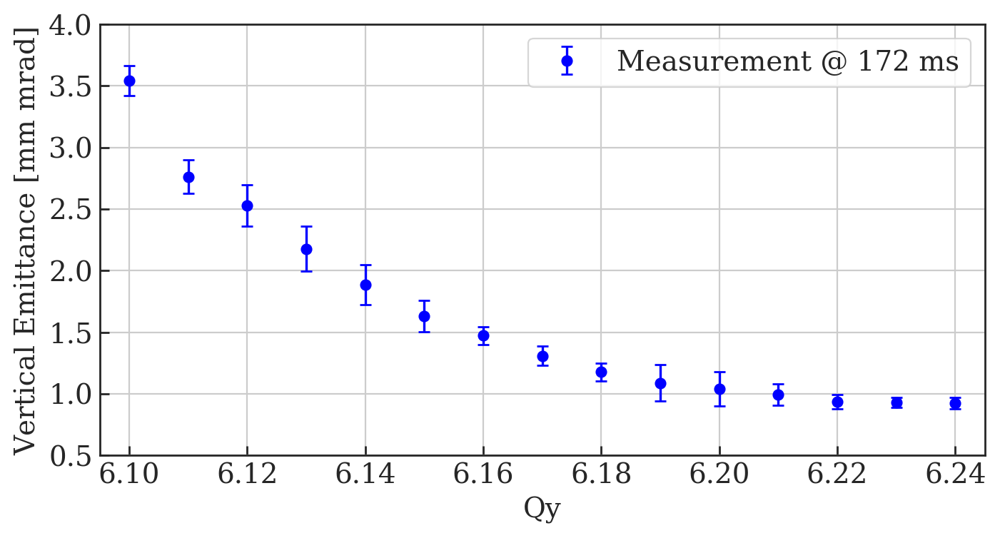

In [116]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

#plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\sigma_y^2}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Simulation_CF_PFW/00_MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_Errors_Using_Sim_Optics.png');

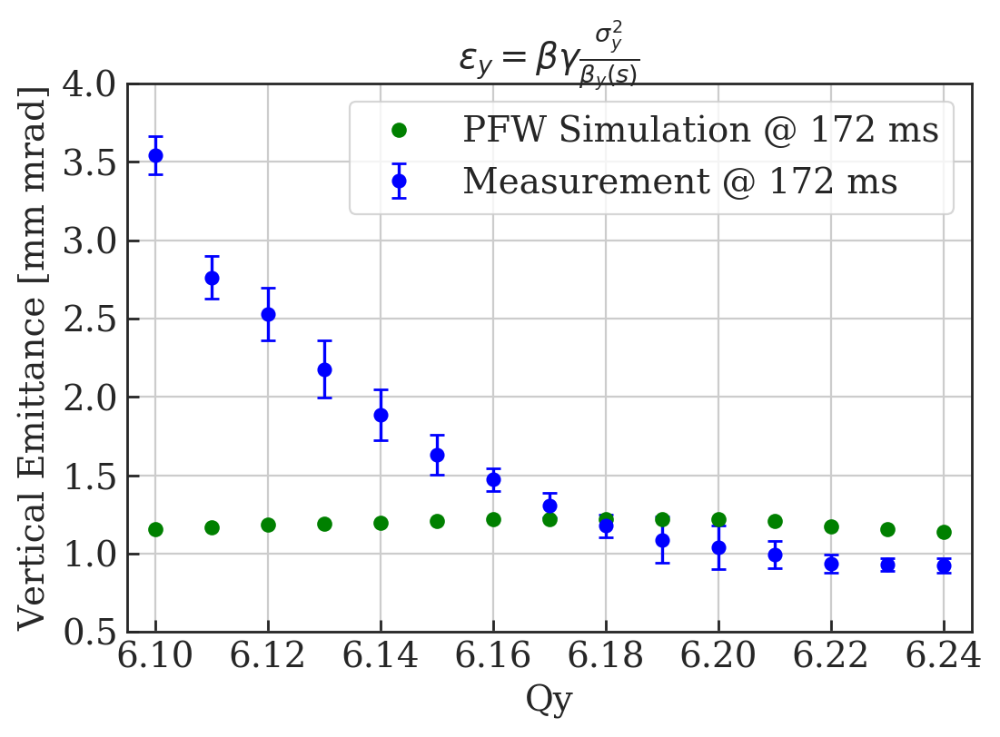

In [117]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\sigma_y^2}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Simulation_CF_PFW/MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_Errors_Using_Sim_Optics_PFW_172.png');

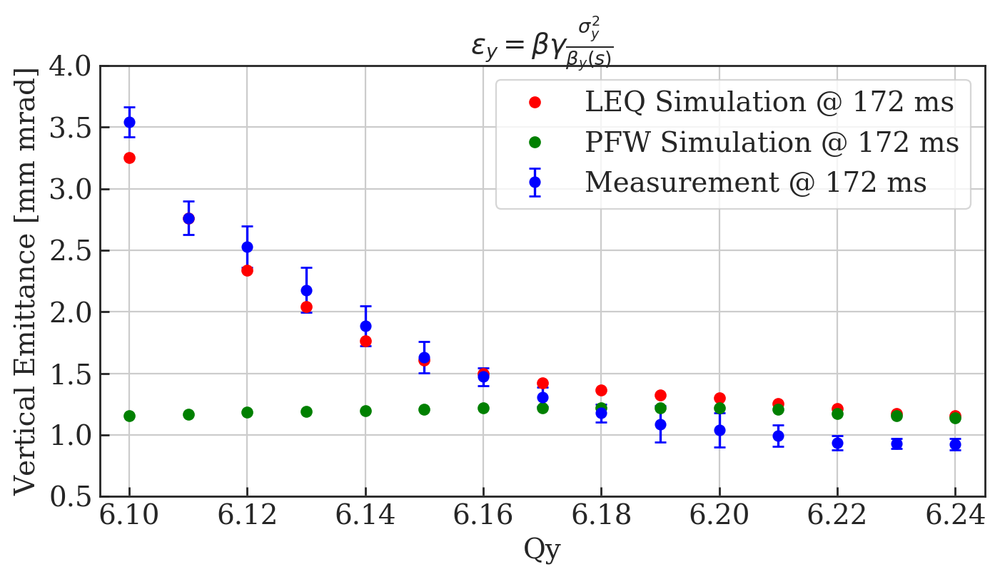

In [118]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_sim['Qy'], df0_sim['emittance V'], label='LEQ Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\sigma_y^2}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Simulation_CF_PFW/MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_Errors_Using_Sim_Optics_Sim_PFW_172.png');

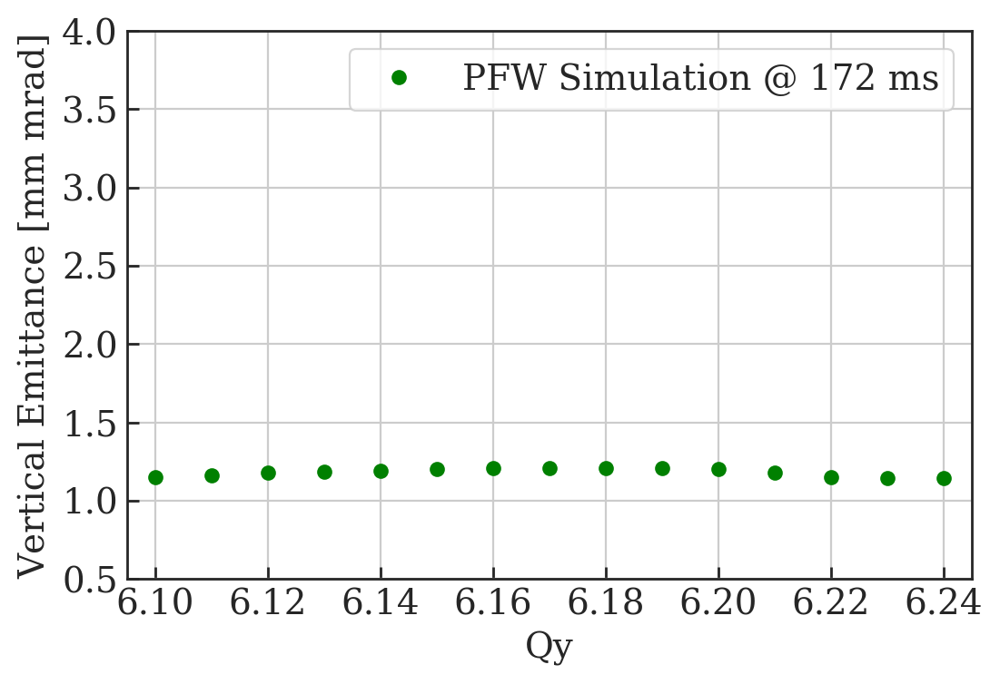

In [119]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Simulation_CF_PFW/00_MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics_PFW_only_172.png');

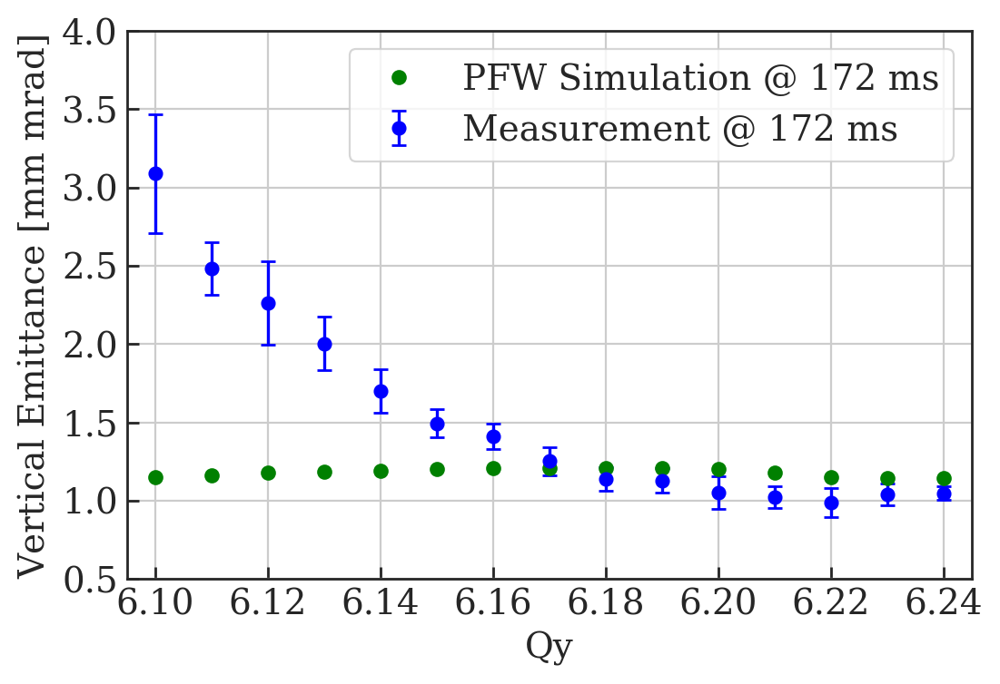

In [120]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )

    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)


plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Simulation_CF_PFW/00_MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics_PFW_172.png');

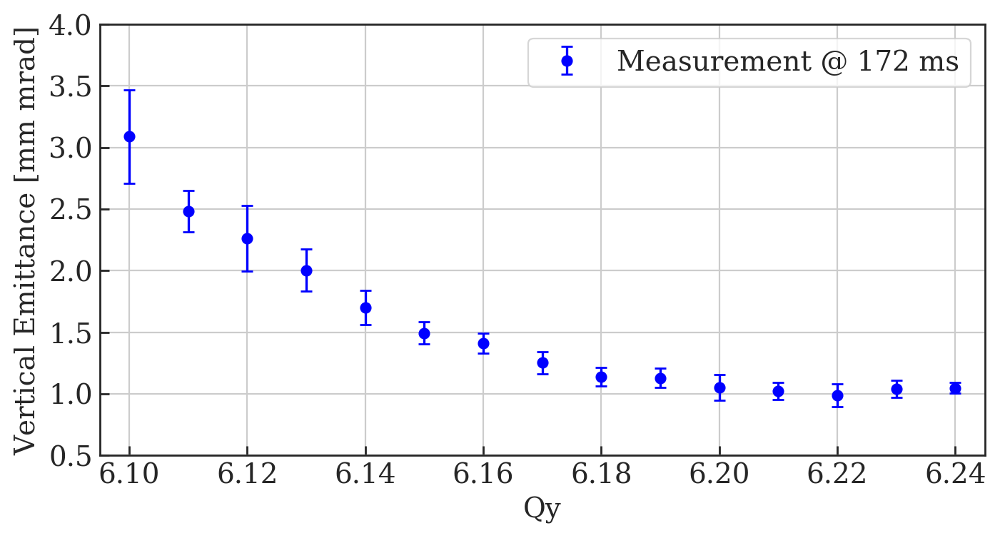

In [178]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
#plt.plot(df0_sim['Qy'], df0_sim['emittance V 2ndMoment'], label='LEQ Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

#plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')


plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Write_Up/Measured_172.png');

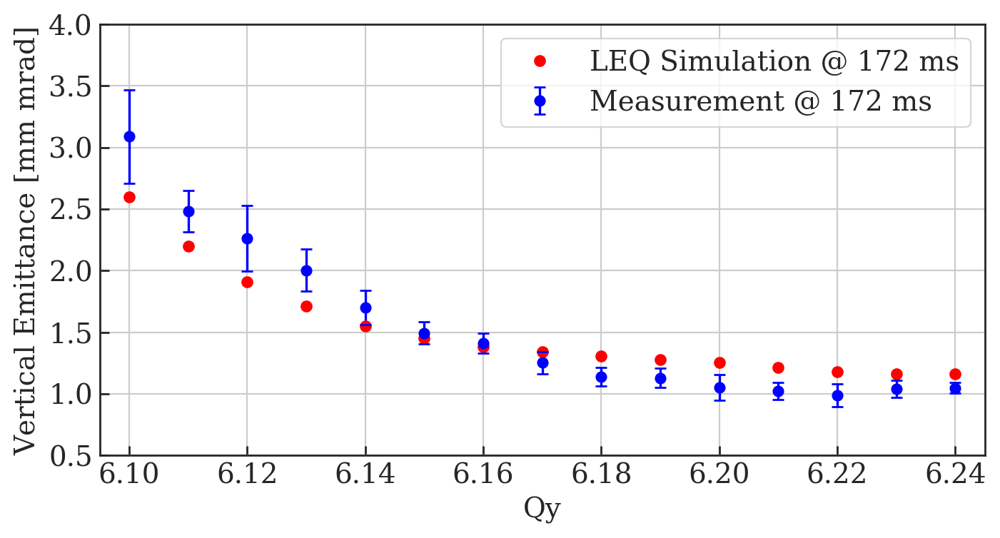

In [121]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.plot(df0_sim['Qy'], df0_sim['emittance V 2ndMoment'], label='LEQ Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

#plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')


plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Write_Up/Measured_LEQ_172.png');

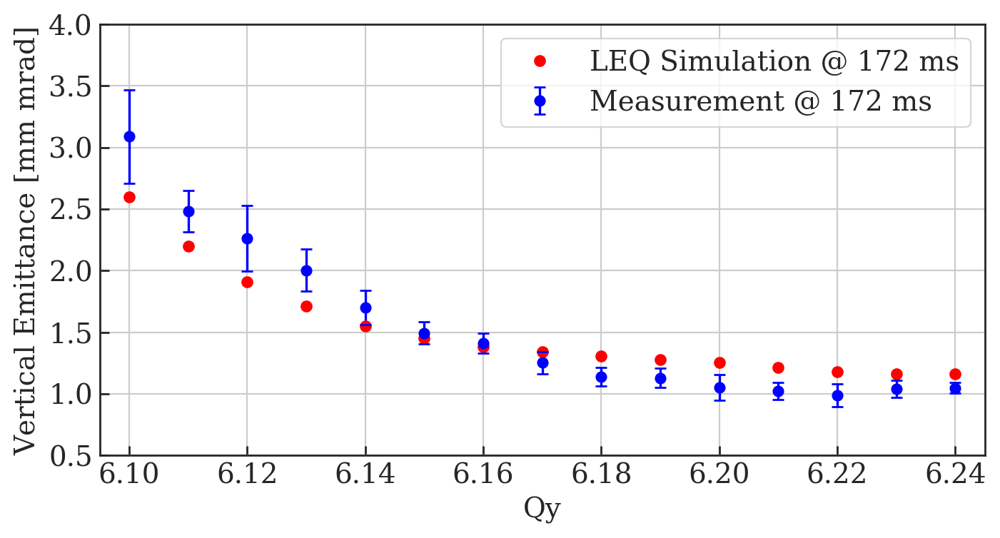

In [122]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.plot(df0_sim['Qy'], df0_sim['emittance V 2ndMoment'], label='LEQ Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

#plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')


plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Simulation_CF_PFW/00_MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics_Sim_LEQ_172.png');

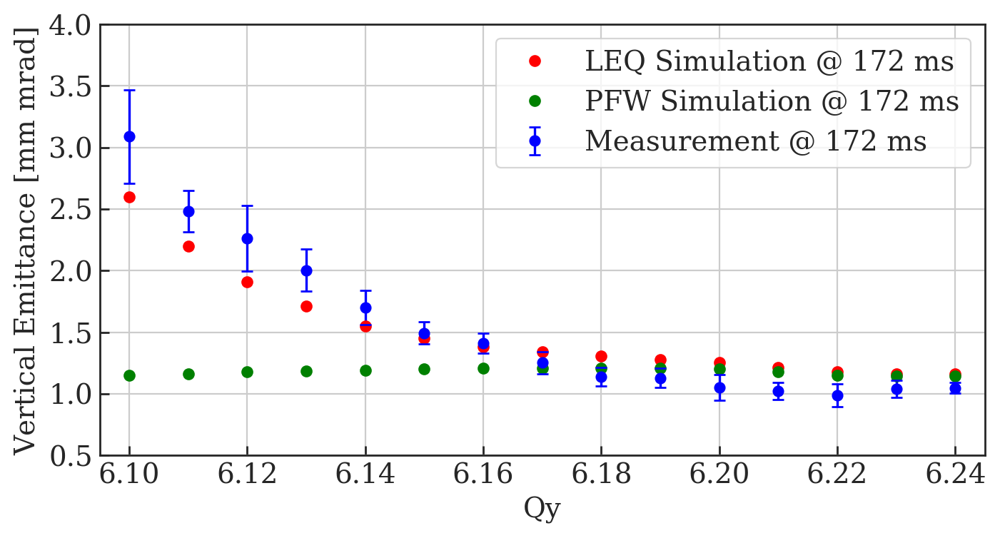

In [123]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.plot(df0_sim['Qy'], df0_sim['emittance V 2ndMoment'], label='LEQ Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')


plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Write_Up/Measured_LEQ_PFW_172.png');

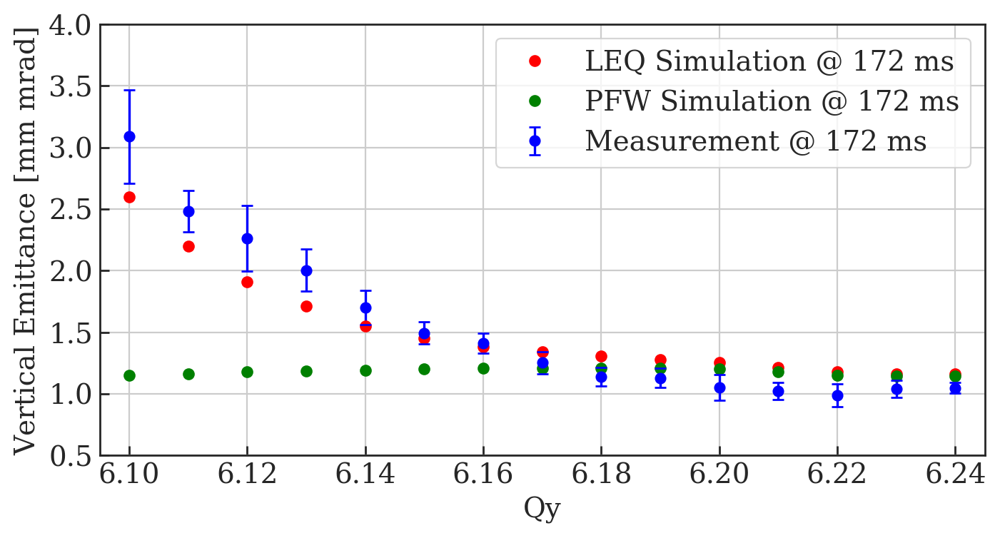

In [124]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.plot(df0_sim['Qy'], df0_sim['emittance V 2ndMoment'], label='LEQ Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')


plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Simulation_CF_PFW/00_MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics_Sim_PFW_172.png');

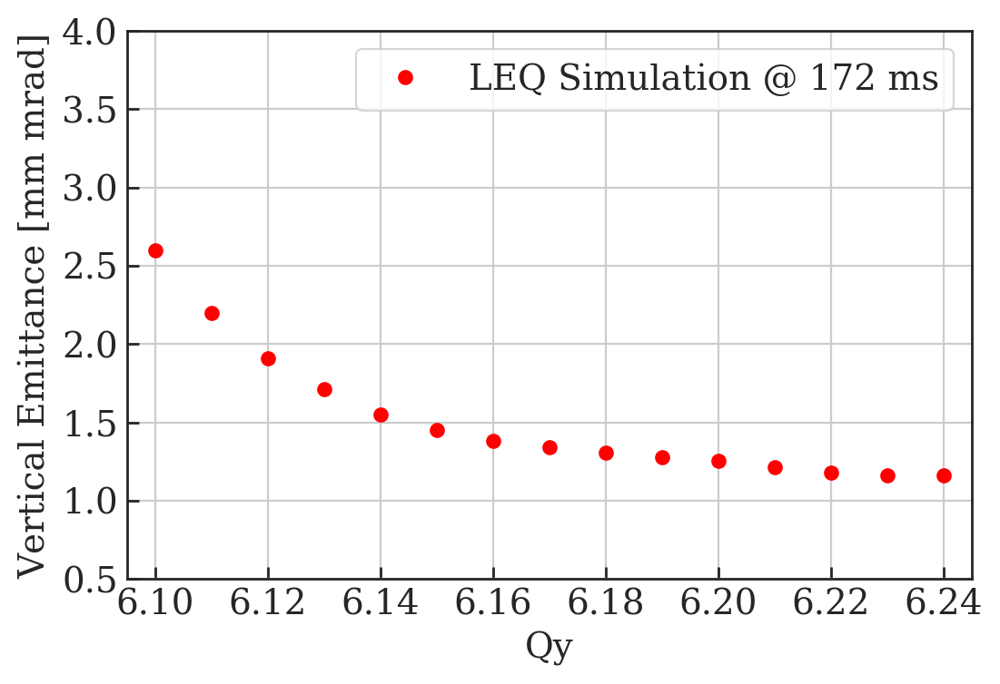

In [125]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
#plt.errorbar(x_data, y_data_172, y_error_172, label='MD @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_sim['Qy'], df0_sim['emittance V 2ndMoment'], label='LEQ Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);
plt.xlim(6.095, 6.245)
plt.xticks(x_ticks)

plt.legend();
plt.grid();
fig.savefig('Simulation_CF_PFW/00_MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics_Sim_only_172.png');

# Load PFW + single quadrupole error sims

In [126]:
# Read .mat files into a dictionary

matfiles = glob.glob("../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/*.mat")

pfw_quad_sims = dict()

for f in matfiles:
    first = f.split('/')[-1]
    second = first.split('.')[0]
    pfw_quad_sims[str(second)] = f
    
pfw_quad_sims

{'610_SbS_c172_00': '../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_00.mat',
 '610_SbS_c172_01': '../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_01.mat',
 '610_SbS_c172_02': '../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_02.mat',
 '610_SbS_c172_03': '../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_03.mat',
 '610_SbS_c172_04': '../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_04.mat',
 '610_SbS_c172_05': '../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_05.mat',
 '610_SbS_c172_10': '../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_10.mat',
 '610_SbS_c172_15': '../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_15.mat',
 '610_SbS_c172_20': '../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_20.mat',
 '610_SbS_c172_25': '../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_25.mat'}

In [127]:
for key, value in sorted(pfw_quad_sims.iteritems()):
    print value
    d = particles_from_matfile(value)
    plt.clf()
    x, bins_, p = plt.hist(d['particles']['y'][0][0][0], bins = 1000, density=True, histtype=u'step', lw=0, color='k')

    peak = peakfinder(np.array(bins_[:-1]), np.array(x), verbose=True)
    print '\n peak = ', peak, '\n'
    plt.close()

../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_00.mat

	MAX(y_dat) =  118.44017193092749
	x_dat[index] =  0.00011030521479695257
	index of x_dat =  0.00011030521479695257  is  513
	Mean of peak point +/- 3 points =  115.45796179712907

 peak =  115.45796179712907 

../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_01.mat

	MAX(y_dat) =  119.02858514696338
	x_dat[index] =  0.00014988867857617869
	index of x_dat =  0.00014988867857617869  is  478
	Mean of peak point +/- 3 points =  113.50463526615071

 peak =  113.50463526615071 

../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_02.mat

	MAX(y_dat) =  112.81902259484262
	x_dat[index] =  -3.342664966919304e-05
	index of x_dat =  -3.342664966919304e-05  is  528
	Mean of peak point +/- 3 points =  109.11426078620762

 peak =  109.11426078620762 

../MD4224_Repo_Outputs/V_PFW_Quad/Simulation_Profiles/610_SbS_c172_03.mat

	MAX(y_dat) =  109.95409707022257
	x_dat[index] =  0.00061832871989


Importing simulation file: 610_SbS_c172_00
Qy =  6.1 , ctime = 172.0 [ms], label =  SbS
[13, 57, 99, 144, 186, 228, 272, 314, 356, 397]

	MAX(y_dat) =  0.1184401719309321
	x_dat[index] =  0.1103052147969521
	index of x_dat =  0.1103052147969521  is  513
	Mean of peak point +/- 3 points =  0.11545796179712838

Importing simulation file: 610_SbS_c172_01
Qy =  6.1 , ctime = 172.0 [ms], label =  SbS
[13, 57, 99, 144, 186, 228, 272, 314, 356, 397]

	MAX(y_dat) =  0.11902858514696578
	x_dat[index] =  0.14988867857617905
	index of x_dat =  0.14988867857617905  is  478
	Mean of peak point +/- 3 points =  0.11350463526615126

Importing simulation file: 610_SbS_c172_02
Qy =  6.1 , ctime = 172.0 [ms], label =  SbS
[13, 57, 99, 144, 186, 228, 272, 314, 356, 397]

	MAX(y_dat) =  0.11281902259484093
	x_dat[index] =  -0.03342664966919173
	index of x_dat =  -0.03342664966919173  is  528
	Mean of peak point +/- 3 points =  0.10911426078620604

Importing simulation file: 610_SbS_c172_03
Qy =  6.1 , cti

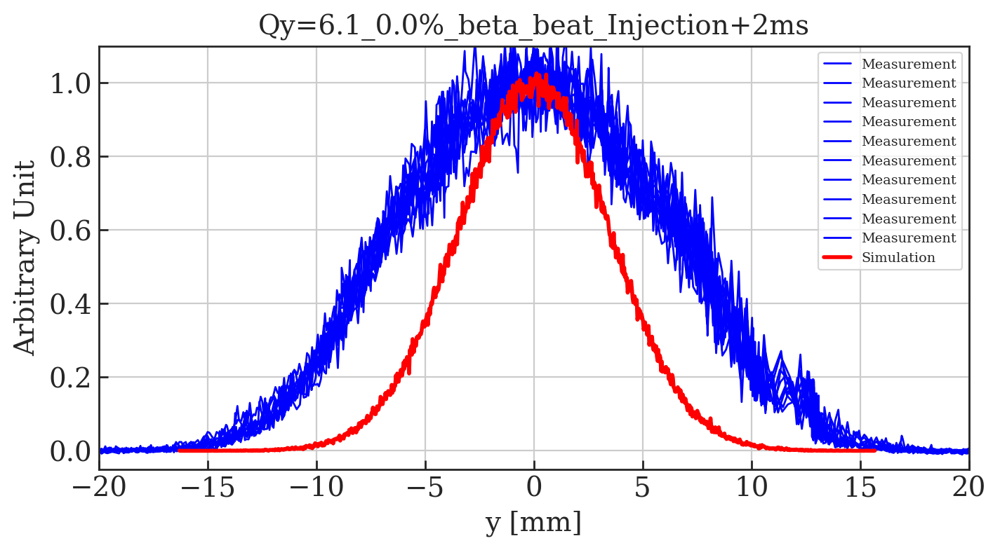

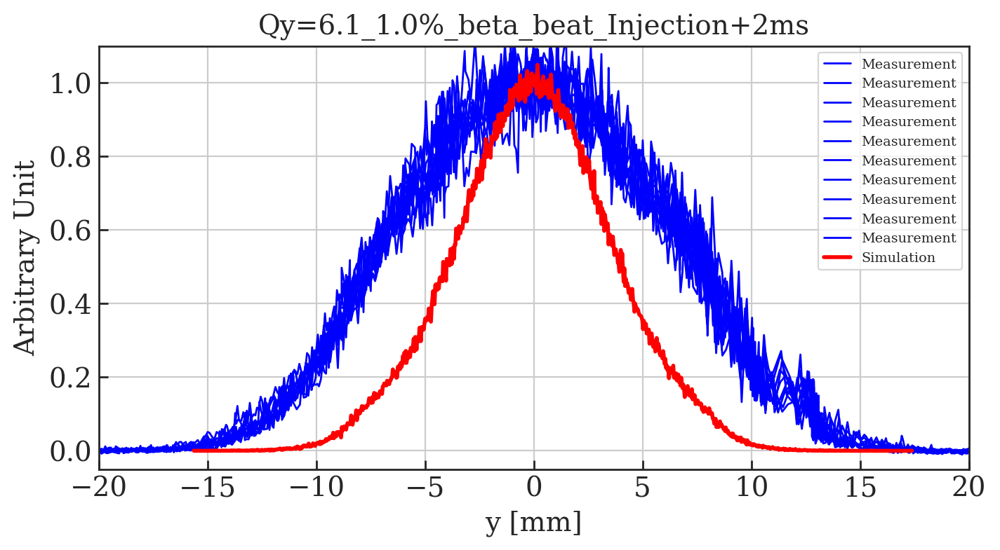

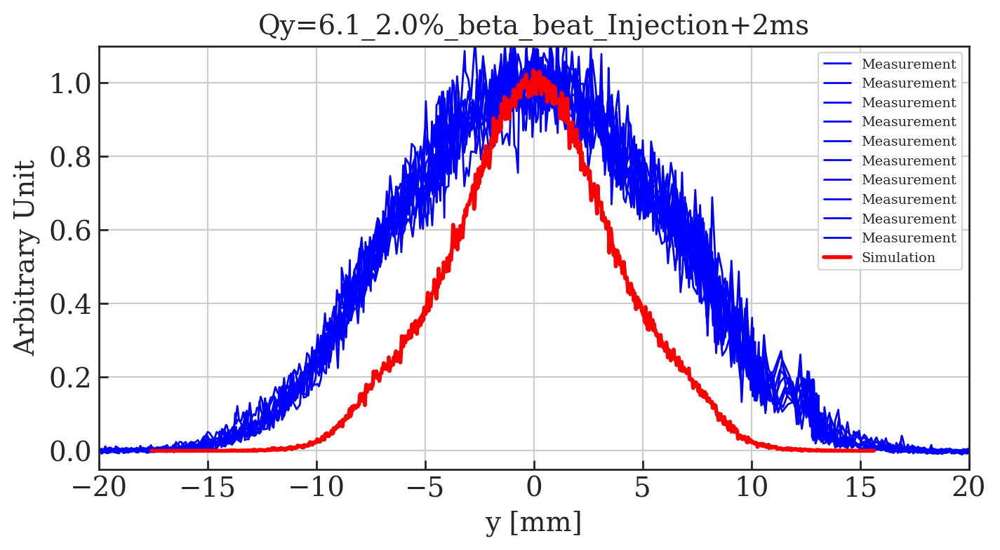

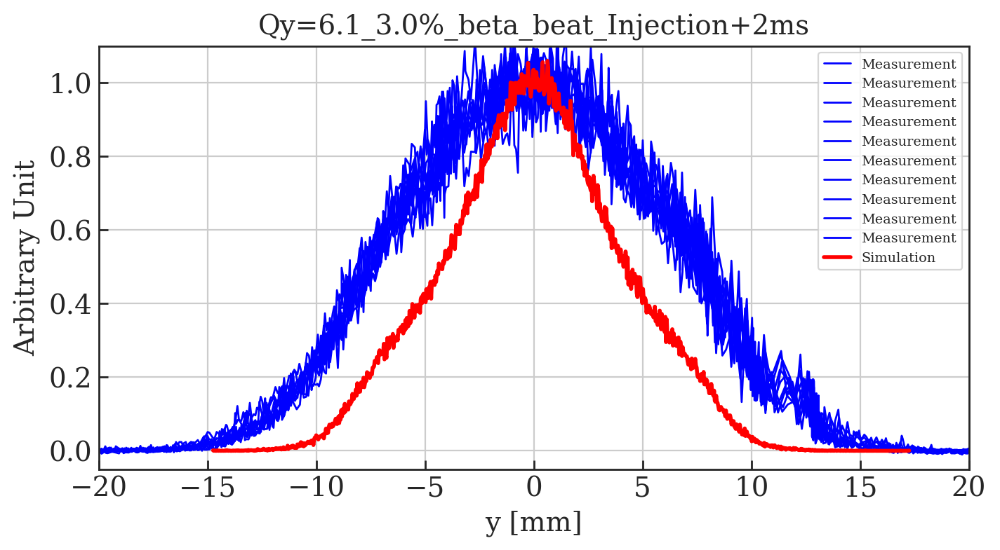

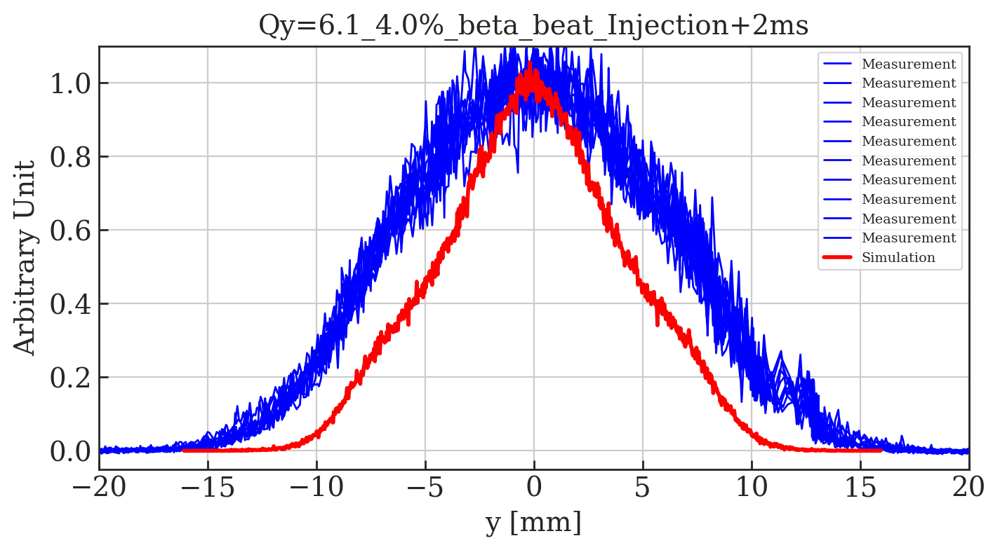

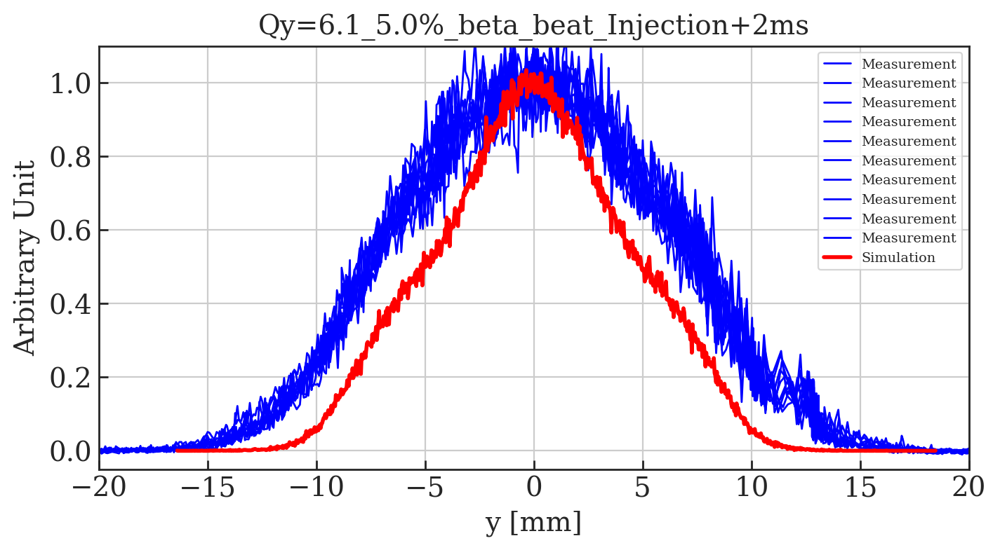

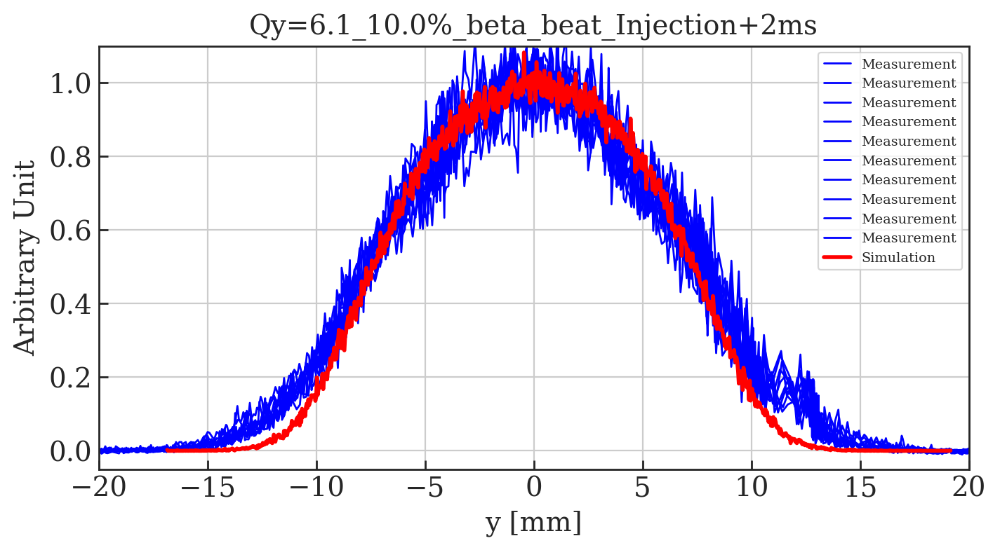

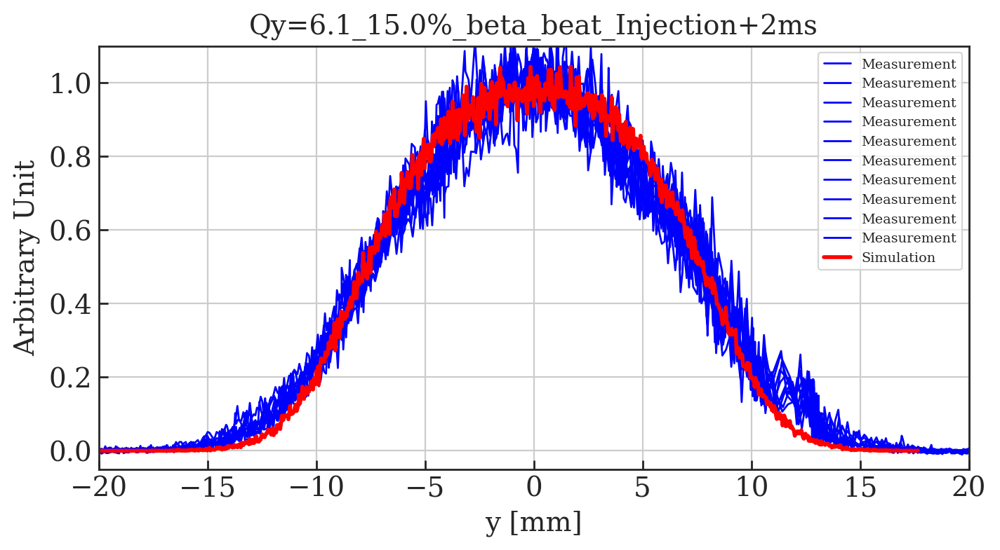

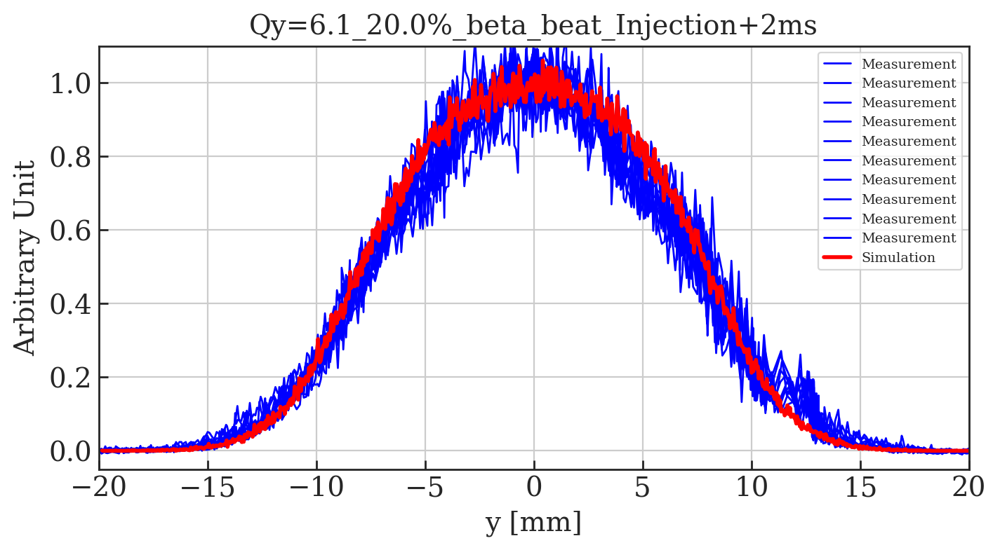

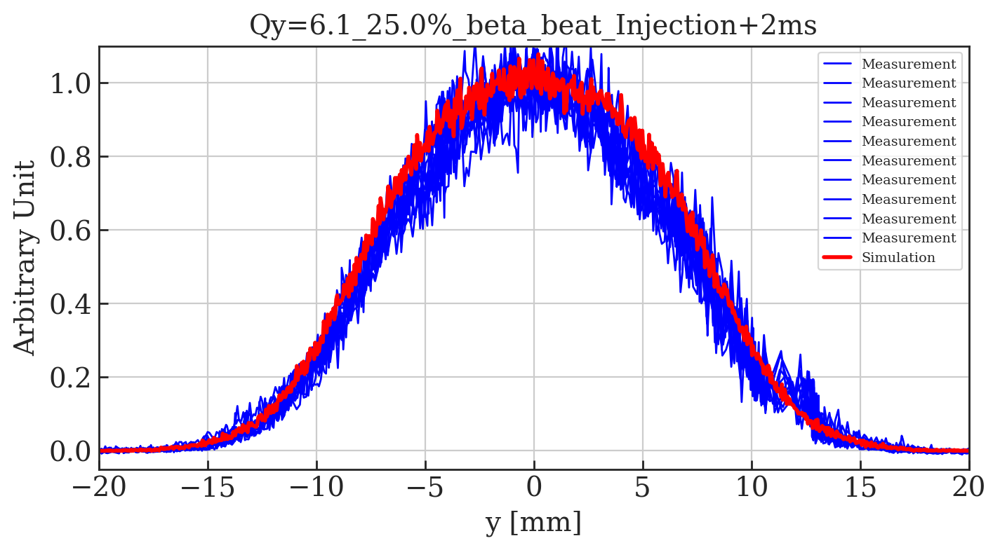

In [128]:
#Main function to plot comparison plots with MD data
verbose = True

plotted_names = []

for key, value in sorted(pfw_quad_sims.iteritems()):
    if key not in plotted_names:        
        
        plotted_names.append(key)
        
        this_plot = []
        this_plot.append(value)
        if verbose: print '\nImporting simulation file:', key        

        tune_y = float(key.split('_')[0])/100
        ctime = (key.split('_')[2])
        time = float(ctime.split('c')[1])
        beating = float(key.split('_')[-1])
        label = (key.split('_')[1])
        if verbose: print 'Qy = ', tune_y, ', ctime =', time, '[ms], label = ', label
        
        sim_labels=['Simulation']

        # Find MD data with same tune and ctime    
        for key1, value1 in sorted(pfw_quad_sims.iteritems()):
#             if verbose: print '\tChecking other files:', key1  
            tune_y1 = float(key1.split('_')[0])/100
            ctime1 = (key1.split('_')[2])
            time1 = float(ctime1.split('c')[1])
            label1 = (key1.split('_')[1])
#             if verbose: print '\tQy = ', tune_y1, ', ctime =', time1, '[ms], label = ', label1
            if (tune_y1 == tune_y) and (time1 == time):
                if (label1 != label):
                    print '\tMATCH FOUND' 
                    print '\tQy = ', tune_y1, ', ctime =', time1, '[ms]'
                    print '\tlab = ', label, ', lab1 =', label1

                    this_plot.append(value1)
                    plotted_names.append(key1)
                    sim_labels.append(label1)

        # Find rows in dataframe at correct tune and WS time
        md_points = []
        for i in tune_points[tune_y]:
            if df0['PR.BWS.64.V_ROT:ACQ_DELAY'].iloc()[i] == time:
                md_points.append(i)          

        if verbose: print md_points                 

        # Plot data
        main_label = 'Qy=' + str(tune_y) + '_' + str(beating) + '%_beta_beat_Injection+2ms'
        
        if len(this_plot) is 1:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, main_label=main_label, bins=1000, sim_labels=sim_labels, plot_md=True)  
        elif len(this_plot) is 2:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, particles_from_matfile(this_plot[1]), main_label=main_label, bins=1000, sim_labels=sim_labels, plot_md=True)  
        elif len(this_plot) is 3:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, particles_from_matfile(this_plot[1]), particles_from_matfile(this_plot[2]), main_label=main_label, bins=1000, sim_labels=sim_labels, plot_md=True)  
        else: print 'ERROR: More than 3 space charge methods found'
        


Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]


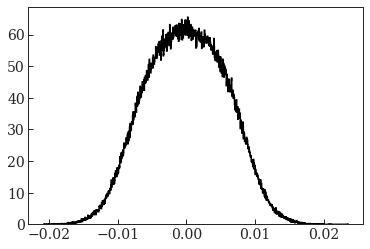

In [129]:
# Make dataframe with name, tunes, position V, profile V 
data = []

# Each row as a list
for key, value in sorted(pfw_quad_sims.iteritems()):
    
    tune_y = float(key.split('_')[0])/100
    ctime = (key.split('_')[2])
    time = float(ctime.split('c')[1])
    if verbose: print 'Qy = ', tune_y, ', ctime =', time, '[ms]'

    d = particles_from_matfile(value)
    plt.clf()
    x1, bins_1, p1 = plt.hist(d['particles']['y'][0][0][0], bins = 1000, density=True, histtype=u'step', lw=1.5, color='k')
          
    qx = 6.21
    qy = tune_y
    pos = np.array(bins_1[:-1]) + (abs(bins_1[0]-bins_1[1])/2)
    prof = x1
    
    new_data = [qx, qy, pos, prof]
    
    data.append(new_data)    

# Create dataframe
df_pfw_quad_sim = pd.DataFrame(data, columns = ['Qx', 'Qy', 'PR.BWS.64.V_ROT:PROF_POSITION_IN', 'PR.BWS.64.V_ROT:PROF_DATA_IN'])

In [130]:
df_pfw_quad_sim

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN
0,6.21,6.1,"[-0.016289324812189625, -0.01625732553408819, ...","[0.06250140998994212, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1,6.21,6.1,"[-0.01563190859037947, -0.01559885770604658, -...","[0.060512752997947825, 0.0, 0.0, 0.0, 0.0, 0.0..."
2,6.21,6.1,"[-0.01756703892978825, -0.0175337998543757, -0...","[0.06017014538391607, 0.0, 0.0, 0.0, 0.0, 0.0,..."
3,6.21,6.1,"[-0.014740798816041036, -0.014708767267478086,...","[0.12487688480434138, 0.0, 0.06243844240217069..."
4,6.21,6.1,"[-0.016087393656384372, -0.016055324034304586,...","[0.06236431458481775, 0.0, 0.0, 0.0, 0.0, 0.0,..."
5,6.21,6.1,"[-0.01638938089135139, -0.01635448984915707, -...","[0.05732130295395435, 0.0, 0.0, 0.0, 0.0, 0.0,..."
6,6.21,6.1,"[-0.016850575166593225, -0.016814528959546188,...","[0.16645301937511828, 0.0, 0.0, 0.0, 0.0, 0.0,..."
7,6.21,6.1,"[-0.020029846583526967, -0.019992119573196056,...","[0.0530124168986037, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
8,6.21,6.1,"[-0.019839729182924856, -0.019798555737815235,...","[0.04857499766354207, 0.0, 0.0, 0.0, 0.0, 0.0,..."
9,6.21,6.1,"[-0.020713879934367126, -0.020669636089463882,...","[0.045204027913346205, 0.0, 0.0, 0.0, 0.0, 0.0..."


In [131]:
# Gaussian and 2nd moment fits
df_pfw_quad_sim_filtered = Multi_filter_sim(df_pfw_quad_sim, with_plot = True, WS = '64.V', smooth=True)


Multi_filter row  0

	initial guess: mu0 0.15830413194910936
	initial guess: offs0 0.0
	initial guess: ampl 114.81211389389925
	initial guess: slope 0
	initial guess: sigma0 25.0015591111017
3 parameter fit sigma =  3.4742269615551975  +/-  0.0010833370282662535
Removing centre shift of  0.006115923125984213
Second moment =  3.469456250588954

Multi_filter row  1

	initial guess: mu0 0.0011596990781674588
	initial guess: offs0 0.0
	initial guess: ampl 113.50002477068381
	initial guess: slope 0
	initial guess: sigma0 25.823196251600933
3 parameter fit sigma =  3.5589905450531907  +/-  0.0046853261502851525
Removing centre shift of  0.010528289189748881
Second moment =  3.627125777324904

Multi_filter row  2

	initial guess: mu0 0.2158664159249181
	initial guess: offs0 0.0
	initial guess: ampl 109.46783202146251
	initial guess: slope 0
	initial guess: sigma0 25.970233018721135
3 parameter fit sigma =  3.7699737731204412  +/-  0.008821780724547517
Removing centre shift of  0.008704066316

/usr/local/bin/start_ipykernel.py:81: RuntimeWarning: invalid value encountered in sqrt
/usr/local/bin/start_ipykernel.py:83: RuntimeWarning: invalid value encountered in sqrt



Multi_filter row  4

	initial guess: mu0 -0.1167218606502804
	initial guess: offs0 0.0
	initial guess: ampl 99.28695854829198
	initial guess: slope 0
	initial guess: sigma0 25.056520011383736
3 parameter fit sigma =  4.304642214158094  +/-  0.012452114724068849
Removing centre shift of  -0.005751468620767449
Second moment =  4.199992925657663

Multi_filter row  5

	initial guess: mu0 0.11408206656289034
	initial guess: offs0 0.0
	initial guess: ampl 93.10508167801292
	initial guess: slope 0
	initial guess: sigma0 27.26094167199677
3 parameter fit sigma =  4.585262481170857  +/-  0.013514897307357275
Removing centre shift of  0.009578841870170933
Second moment =  4.368027502733223

Multi_filter row  6

	initial guess: mu0 0.12718835256182032
	initial guess: offs0 0.0
	initial guess: ampl 69.4584670849578
	initial guess: slope 0
	initial guess: sigma0 28.163490856284714
3 parameter fit sigma =  5.605544999373437  +/-  0.023618812918738664
Removing centre shift of  0.006755491105493687
S

In [132]:
df_pfw_quad_sim_filtered

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V
0,6.21,6.1,"[-0.016289324812189625, -0.01625732553408819, ...","[0.06250140998994212, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.469456,3.4742269615551975,0.001083,1000.3377042405883,0.006115923125984213,"[-16.295440735315612, -16.263441457214174, -16...","[0.015104507414236017, 0.013541972164487463, 0..."
1,6.21,6.1,"[-0.01563190859037947, -0.01559885770604658, -...","[0.060512752997947825, 0.0, 0.0, 0.0, 0.0, 0.0...",3.627126,3.5589905450531907,0.004685,992.6559774909647,0.010528289189748881,"[-15.64243687956922, -15.609385995236329, -15....","[0.020170917665982613, 0.018441981866041245, 0..."
2,6.21,6.1,"[-0.01756703892978825, -0.0175337998543757, -0...","[0.06017014538391607, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.829825,3.7699737731204412,0.008822,991.9391710344833,0.008704066316171976,"[-17.575742996104424, -17.542503920691875, -17...","[0.014541118467779718, 0.013036864833181816, 0..."
3,6.21,6.1,"[-0.014740798816041036, -0.014708767267478086,...","[0.12487688480434138, 0.0, 0.06243844240217069...",4.020737,4.034959141607696,0.011853,996.9709890322315,0.003927217469195766,"[-14.744726033510231, -14.712694484947281, -14...","[0.04943043356838508, 0.04653150588542713, 0.0..."
4,6.21,6.1,"[-0.016087393656384372, -0.016055324034304586,...","[0.06236431458481775, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.199993,4.304642214158094,0.012452,1003.3186584589203,-0.005751468620767449,"[-16.081642187763602, -16.049572565683818, -16...","[0.015071376024664292, 0.013512268160043847, 0..."
5,6.21,6.1,"[-0.01638938089135139, -0.01635448984915707, -...","[0.05732130295395435, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.368028,4.585262481170857,0.013515,1010.7758819264224,0.009578841870170933,"[-16.39895973322156, -16.36406869102724, -16.3...","[0.013852648213872307, 0.012419615640023448, 0..."
6,6.21,6.1,"[-0.016850575166593225, -0.016814528959546188,...","[0.16645301937511828, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.979112,5.605544999373437,0.023619,1033.5735820320763,0.006755491105493687,"[-16.857330657698718, -16.82128445065168, -16....","[0.03097875638370347, 0.02919533117611269, 0.0..."
7,6.21,6.1,"[-0.020029846583526967, -0.019992119573196056,...","[0.0530124168986037, 0.0, 0.0, 0.0, 0.0, 0.0, ...",5.253435,5.896746411028068,0.025023,1032.9155488231722,0.017911669612192246,"[-20.04775825313916, -20.01003124280825, -19.9...","[0.012811334083829232, 0.011486023661364139, 0..."
8,6.21,6.1,"[-0.019839729182924856, -0.019798555737815235,...","[0.04857499766354207, 0.0, 0.0, 0.0, 0.0, 0.0,...",5.497200,6.097234455328721,0.023073,1029.5441830083732,0.0168874433549012,"[-19.856616626279756, -19.815443181170135, -19...","[0.011738957768689336, 0.010524582827100783, 0..."
9,6.21,6.1,"[-0.020713879934367126, -0.020669636089463882,...","[0.045204027913346205, 0.0, 0.0, 0.0, 0.0, 0.0...",5.744776,6.292672295240082,0.021262,1026.1187682710618,0.007984257435283582,"[-20.72186419180241, -20.677620346899165, -20....","[0.012431107676170531, 0.011946778805670381, 0..."


In [133]:
# Calculate emittances in Vertical
df_pfw_quad_sim_emittance = emittance_df(df_pfw_quad_sim_filtered, WS='64.V', verbose=True)

Emittance  0  =  1.1537732270890768
Emittance  1  =  1.2107591310449417
Emittance  2  =  1.3585660024929886
Emittance  3  =  1.5562607603337961
Emittance  4  =  1.771243237760928
Emittance  5  =  2.0097058093889686
Emittance  6  =  3.003583923210002
Emittance  7  =  3.323754874763821
Emittance  8  =  3.5536109122896375
Emittance  9  =  3.785073485117267


In [134]:
df_pfw_quad_sim_emittance

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V,emittance V,betx,bety,dx,dy
0,6.21,6.1,"[-0.016289324812189625, -0.01625732553408819, ...","[0.06250140998994212, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.469456,3.4742269615551975,0.001083,1000.3377042405883,0.006115923125984213,"[-16.295440735315612, -16.263441457214174, -16...","[0.015104507414236017, 0.013541972164487463, 0...",1.153773,12.391799,23.637581,NaN,0.0
1,6.21,6.1,"[-0.01563190859037947, -0.01559885770604658, -...","[0.060512752997947825, 0.0, 0.0, 0.0, 0.0, 0.0...",3.627126,3.5589905450531907,0.004685,992.6559774909647,0.010528289189748881,"[-15.64243687956922, -15.609385995236329, -15....","[0.020170917665982613, 0.018441981866041245, 0...",1.210759,12.391799,23.637581,NaN,0.0
2,6.21,6.1,"[-0.01756703892978825, -0.0175337998543757, -0...","[0.06017014538391607, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.829825,3.7699737731204412,0.008822,991.9391710344833,0.008704066316171976,"[-17.575742996104424, -17.542503920691875, -17...","[0.014541118467779718, 0.013036864833181816, 0...",1.358566,12.391799,23.637581,NaN,0.0
3,6.21,6.1,"[-0.014740798816041036, -0.014708767267478086,...","[0.12487688480434138, 0.0, 0.06243844240217069...",4.020737,4.034959141607696,0.011853,996.9709890322315,0.003927217469195766,"[-14.744726033510231, -14.712694484947281, -14...","[0.04943043356838508, 0.04653150588542713, 0.0...",1.556261,12.391799,23.637581,NaN,0.0
4,6.21,6.1,"[-0.016087393656384372, -0.016055324034304586,...","[0.06236431458481775, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.199993,4.304642214158094,0.012452,1003.3186584589203,-0.005751468620767449,"[-16.081642187763602, -16.049572565683818, -16...","[0.015071376024664292, 0.013512268160043847, 0...",1.771243,12.391799,23.637581,NaN,0.0
5,6.21,6.1,"[-0.01638938089135139, -0.01635448984915707, -...","[0.05732130295395435, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.368028,4.585262481170857,0.013515,1010.7758819264224,0.009578841870170933,"[-16.39895973322156, -16.36406869102724, -16.3...","[0.013852648213872307, 0.012419615640023448, 0...",2.009706,12.391799,23.637581,NaN,0.0
6,6.21,6.1,"[-0.016850575166593225, -0.016814528959546188,...","[0.16645301937511828, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.979112,5.605544999373437,0.023619,1033.5735820320763,0.006755491105493687,"[-16.857330657698718, -16.82128445065168, -16....","[0.03097875638370347, 0.02919533117611269, 0.0...",3.003584,12.391799,23.637581,NaN,0.0
7,6.21,6.1,"[-0.020029846583526967, -0.019992119573196056,...","[0.0530124168986037, 0.0, 0.0, 0.0, 0.0, 0.0, ...",5.253435,5.896746411028068,0.025023,1032.9155488231722,0.017911669612192246,"[-20.04775825313916, -20.01003124280825, -19.9...","[0.012811334083829232, 0.011486023661364139, 0...",3.323755,12.391799,23.637581,NaN,0.0
8,6.21,6.1,"[-0.019839729182924856, -0.019798555737815235,...","[0.04857499766354207, 0.0, 0.0, 0.0, 0.0, 0.0,...",5.497200,6.097234455328721,0.023073,1029.5441830083732,0.0168874433549012,"[-19.856616626279756, -19.815443181170135, -19...","[0.011738957768689336, 0.010524582827100783, 0...",3.553611,12.391799,23.637581,NaN,0.0
9,6.21,6.1,"[-0.020713879934367126, -0.020669636089463882,...","[0.045204027913346205, 0.0, 0.0, 0.0, 0.0, 0.0...",5.744776,6.292672295240082,0.021262,1026.1187682710618,0.007984257435283582,"[-20.72186419180241, -20.677620346899165, -20....","[0.012431107676170531, 0.011946778805670381, 0...",3.785073,12.391799,23.637581,NaN,0.0


In [135]:
# Calculate emittances using second moment
df_pfw_quad_sim_emittance_2 = emittance_df_2(df_pfw_quad_sim_emittance, WS='64.V', verbose=True)

Emittance from 2nd moment 0  =  1.150606744611109
Emittance from 2nd moment 1  =  1.2575617405599966
Emittance from 2nd moment 2  =  1.4020448078543228
Emittance from 2nd moment 3  =  1.5453094648536883
Emittance from 2nd moment 4  =  1.68616939484151
Emittance from 2nd moment 5  =  1.8237899276953318
Emittance from 2nd moment 6  =  2.3697796008401575
Emittance from 2nd moment 7  =  2.6380976088725423
Emittance from 2nd moment 8  =  2.888598777328575
Emittance from 2nd moment 9  =  3.154643453704035


In [136]:
df_pfw_quad_sim_emittance_2

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V,emittance V,betx,bety,dx,dy,emittance V 2ndMoment
0,6.21,6.1,"[-0.016289324812189625, -0.01625732553408819, ...","[0.06250140998994212, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.469456,3.4742269615551975,0.001083,1000.3377042405883,0.006115923125984213,"[-16.295440735315612, -16.263441457214174, -16...","[0.015104507414236017, 0.013541972164487463, 0...",1.153773,12.391799,23.637581,NaN,0.0,1.150607
1,6.21,6.1,"[-0.01563190859037947, -0.01559885770604658, -...","[0.060512752997947825, 0.0, 0.0, 0.0, 0.0, 0.0...",3.627126,3.5589905450531907,0.004685,992.6559774909647,0.010528289189748881,"[-15.64243687956922, -15.609385995236329, -15....","[0.020170917665982613, 0.018441981866041245, 0...",1.210759,12.391799,23.637581,NaN,0.0,1.257562
2,6.21,6.1,"[-0.01756703892978825, -0.0175337998543757, -0...","[0.06017014538391607, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.829825,3.7699737731204412,0.008822,991.9391710344833,0.008704066316171976,"[-17.575742996104424, -17.542503920691875, -17...","[0.014541118467779718, 0.013036864833181816, 0...",1.358566,12.391799,23.637581,NaN,0.0,1.402045
3,6.21,6.1,"[-0.014740798816041036, -0.014708767267478086,...","[0.12487688480434138, 0.0, 0.06243844240217069...",4.020737,4.034959141607696,0.011853,996.9709890322315,0.003927217469195766,"[-14.744726033510231, -14.712694484947281, -14...","[0.04943043356838508, 0.04653150588542713, 0.0...",1.556261,12.391799,23.637581,NaN,0.0,1.545309
4,6.21,6.1,"[-0.016087393656384372, -0.016055324034304586,...","[0.06236431458481775, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.199993,4.304642214158094,0.012452,1003.3186584589203,-0.005751468620767449,"[-16.081642187763602, -16.049572565683818, -16...","[0.015071376024664292, 0.013512268160043847, 0...",1.771243,12.391799,23.637581,NaN,0.0,1.686169
5,6.21,6.1,"[-0.01638938089135139, -0.01635448984915707, -...","[0.05732130295395435, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.368028,4.585262481170857,0.013515,1010.7758819264224,0.009578841870170933,"[-16.39895973322156, -16.36406869102724, -16.3...","[0.013852648213872307, 0.012419615640023448, 0...",2.009706,12.391799,23.637581,NaN,0.0,1.823790
6,6.21,6.1,"[-0.016850575166593225, -0.016814528959546188,...","[0.16645301937511828, 0.0, 0.0, 0.0, 0.0, 0.0,...",4.979112,5.605544999373437,0.023619,1033.5735820320763,0.006755491105493687,"[-16.857330657698718, -16.82128445065168, -16....","[0.03097875638370347, 0.02919533117611269, 0.0...",3.003584,12.391799,23.637581,NaN,0.0,2.369780
7,6.21,6.1,"[-0.020029846583526967, -0.019992119573196056,...","[0.0530124168986037, 0.0, 0.0, 0.0, 0.0, 0.0, ...",5.253435,5.896746411028068,0.025023,1032.9155488231722,0.017911669612192246,"[-20.04775825313916, -20.01003124280825, -19.9...","[0.012811334083829232, 0.011486023661364139, 0...",3.323755,12.391799,23.637581,NaN,0.0,2.638098
8,6.21,6.1,"[-0.019839729182924856, -0.019798555737815235,...","[0.04857499766354207, 0.0, 0.0, 0.0, 0.0, 0.0,...",5.497200,6.097234455328721,0.023073,1029.5441830083732,0.0168874433549012,"[-19.856616626279756, -19.815443181170135, -19...","[0.011738957768689336, 0.010524582827100783, 0...",3.553611,12.391799,23.637581,NaN,0.0,2.888599
9,6.21,6.1,"[-0.020713879934367126, -0.020669636089463882,...","[0.045204027913346205, 0.0, 0.0, 0.0, 0.0, 0.0...",5.744776,6.292672295240082,0.021262,1026.1187682710618,0.007984257435283582,"[-20.72186419180241, -20.677620346899165, -20....","[0.012431107676170531, 0.011946778805670381, 0...",3.785073,12.391799,23.637581,NaN,0.0,3.154643


In [137]:
# Save sim data to pickle file
df_pfw_quad_sim_emittance_2.to_pickle('MD4224_HighBrightness_Vertical_Using_Sim_Optics_Complete_PFW_Quad_simulation_data')

In [138]:
# Load sim data to pickle file
df0_pfw_quad_sim = pnd.read_pickle('MD4224_HighBrightness_Vertical_Using_Sim_Optics_Complete_PFW_Quad_simulation_data')

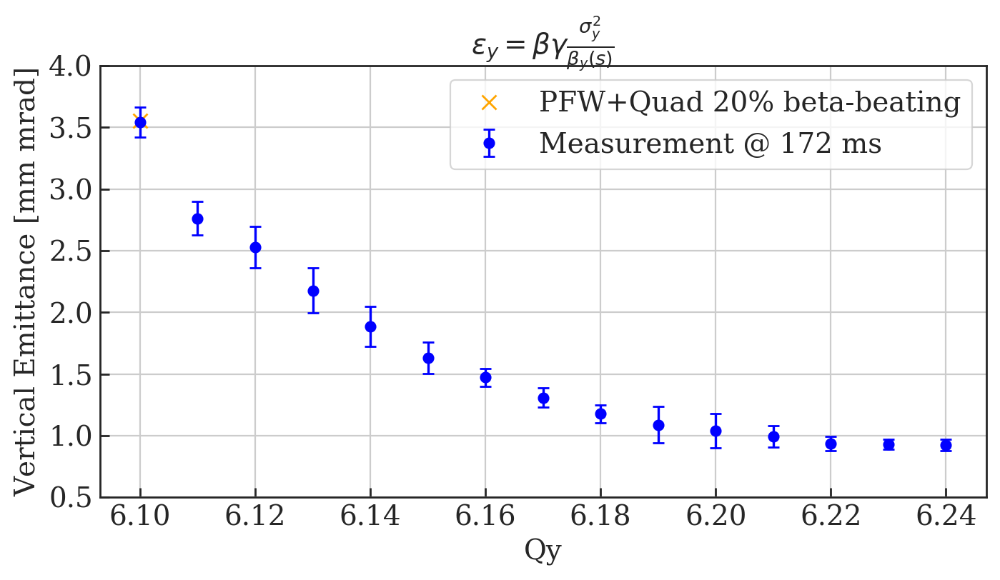

In [139]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

#plt.plot(df0_pfw_quad_sim['Qy'], df0_pfw_quad_sim['emittance V'], label='PFW+Quad Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)
#plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V'][7], label='PFW+Quad 15% beta-beating', linestyle='None', marker='x', color='r', markersize=7)
plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V'][8], label='PFW+Quad 20% beta-beating', linestyle='None', marker='x', color='orange', markersize=7)


plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\sigma_y^2}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);

plt.legend();
plt.grid();
fig.savefig('MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_Errors_Using_Sim_Optics_PFW_quad_scan_172.png');

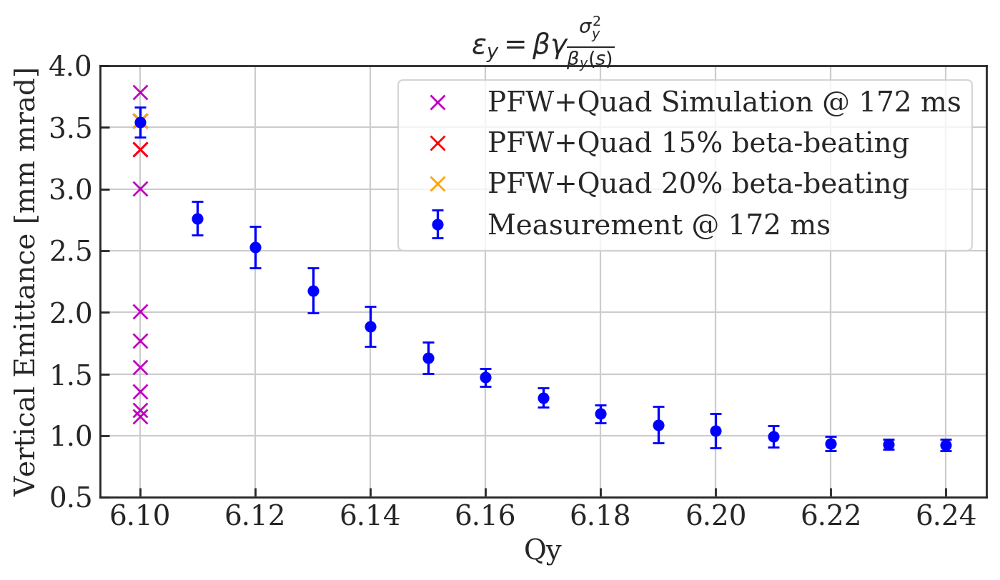

In [140]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_pfw_quad_sim['Qy'], df0_pfw_quad_sim['emittance V'], label='PFW+Quad Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)
plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V'][7], label='PFW+Quad 15% beta-beating', linestyle='None', marker='x', color='r', markersize=7)
plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V'][8], label='PFW+Quad 20% beta-beating', linestyle='None', marker='x', color='orange', markersize=7)


plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\sigma_y^2}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);

plt.legend();
plt.grid();
fig.savefig('MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_Errors_Using_Sim_Optics_PFW_quad_scan_172.png');

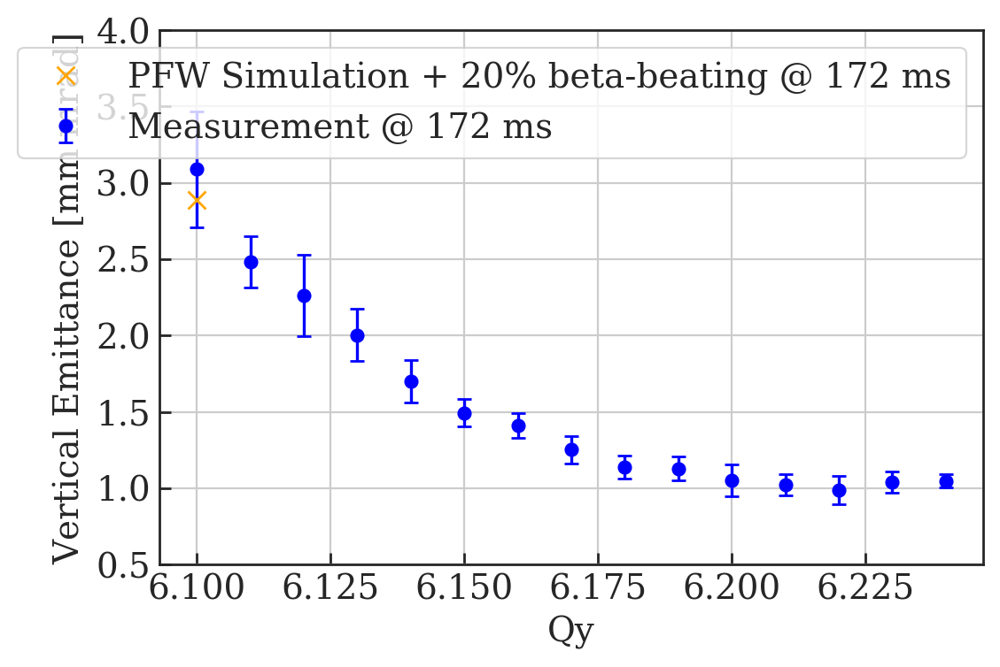

In [141]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

#plt.plot(df0_pfw_quad_sim['Qy'], df0_pfw_quad_sim['emittance V 2ndMoment'], label='PFW+Quad Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)
#plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][7], label='PFW+Quad 15% beta-beating', linestyle='None', marker='x', color='r', markersize=7)
plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][8], label='PFW Simulation + 20% beta-beating @ 172 ms', linestyle='None', marker='x', color='orange', markersize=7)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);

plt.legend();
plt.grid();
fig.savefig('00_MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics_PFW_quad_172.png');

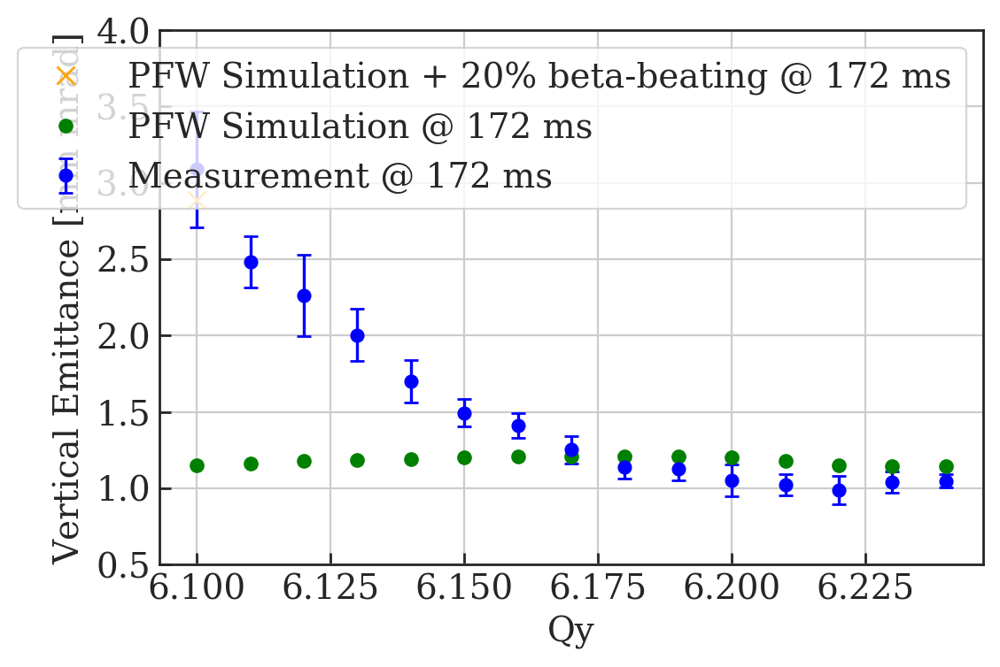

In [142]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(6, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][8], label='PFW Simulation + 20% beta-beating @ 172 ms', linestyle='None', marker='x', color='orange', markersize=7)
plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)

#plt.plot(df0_pfw_quad_sim['Qy'], df0_pfw_quad_sim['emittance V 2ndMoment'], label='PFW+Quad Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)
#plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][7], label='PFW+Quad 15% beta-beating', linestyle='None', marker='x', color='r', markersize=7)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);

plt.legend();
plt.grid();
fig.savefig('00_MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics_PFW_quad_172_2.png');

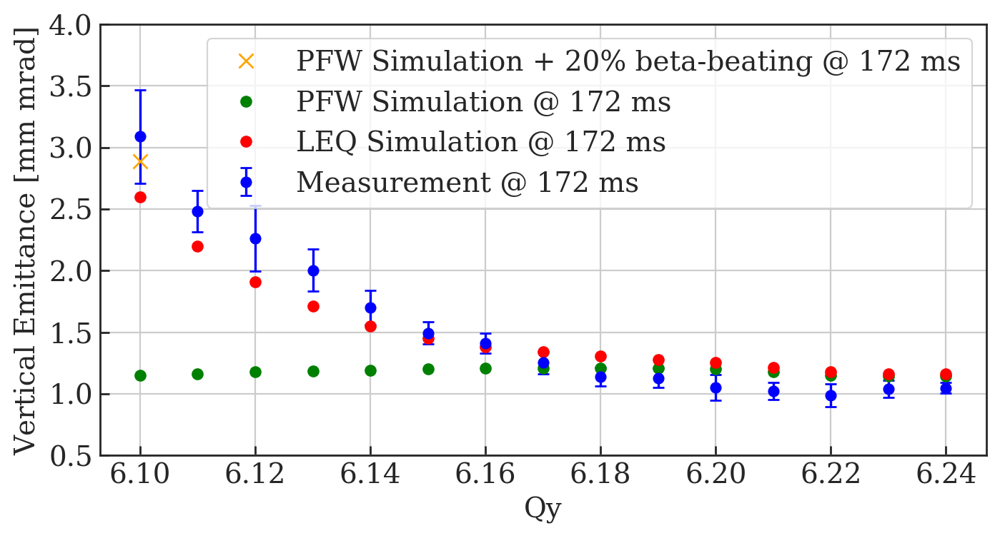

In [143]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][8], label='PFW Simulation + 20% beta-beating @ 172 ms', linestyle='None', marker='x', color='orange', markersize=7)

plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)

plt.plot(df0_sim['Qy'], df0_sim['emittance V 2ndMoment'], label='LEQ Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)


#plt.plot(df0_pfw_quad_sim['Qy'], df0_pfw_quad_sim['emittance V 2ndMoment'], label='PFW+Quad Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)
#plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][7], label='PFW+Quad 15% beta-beating', linestyle='None', marker='x', color='r', markersize=7)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);

plt.legend();
plt.grid();
fig.savefig('00_MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics_PFW_quad_172_3.png');

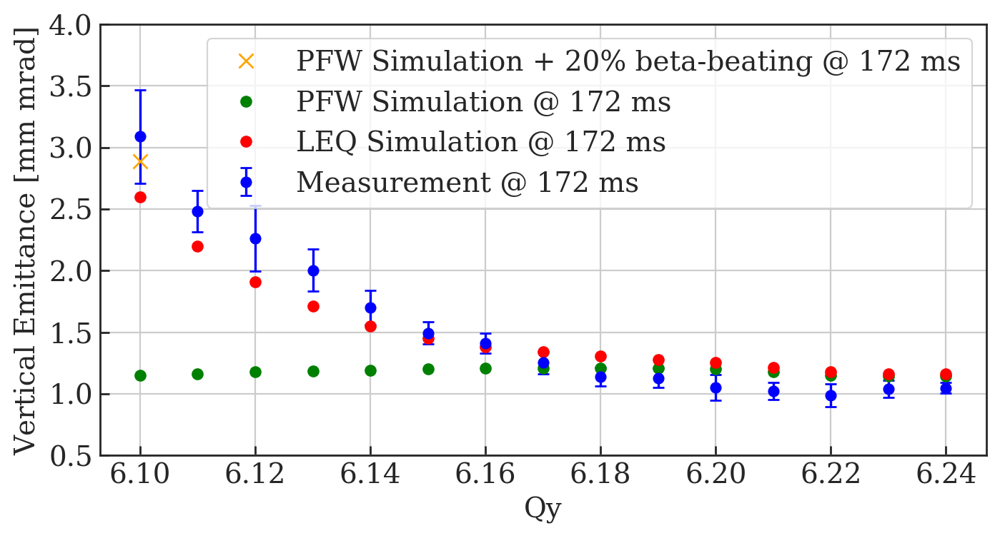

In [144]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][8], label='PFW Simulation + 20% beta-beating @ 172 ms', linestyle='None', marker='x', color='orange', markersize=7)

plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)

plt.plot(df0_sim['Qy'], df0_sim['emittance V 2ndMoment'], label='LEQ Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)


#plt.plot(df0_pfw_quad_sim['Qy'], df0_pfw_quad_sim['emittance V 2ndMoment'], label='PFW+Quad Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)
#plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][7], label='PFW+Quad 15% beta-beating', linestyle='None', marker='x', color='r', markersize=7)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);

plt.legend();
plt.grid();
fig.savefig('Write_Up/Measurement_LEQ_PFW_Quad_172.png');

# Load PFW + betatronic mismatch sims

In [145]:
# Read .mat files into a dictionary

matfiles = glob.glob("../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/*.mat")

pfw_beta_sims = dict()

for f in matfiles:
    first = f.split('/')[-1]
    second = first.split('.')[0]
    pfw_beta_sims[str(second)] = f
    
pfw_beta_sims

{'610_SbS_c172_01': '../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_01.mat',
 '610_SbS_c172_02': '../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_02.mat',
 '610_SbS_c172_03': '../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_03.mat',
 '610_SbS_c172_04': '../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_04.mat',
 '610_SbS_c172_05': '../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_05.mat',
 '610_SbS_c172_10': '../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_10.mat',
 '610_SbS_c172_15': '../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_15.mat',
 '610_SbS_c172_20': '../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_20.mat',
 '610_SbS_c172_25': '../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_25.mat'}

In [146]:
for key, value in sorted(pfw_beta_sims.iteritems()):
    print value
    d = particles_from_matfile(value)
    plt.clf()
    x, bins_, p = plt.hist(d['particles']['y'][0][0][0], bins = 1000, density=True, histtype=u'step', lw=0, color='k')

    peak = peakfinder(np.array(bins_[:-1]), np.array(x), verbose=True)
    print '\n peak = ', peak, '\n'
    plt.close()

../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_01.mat

	MAX(y_dat) =  121.02251778255284
	x_dat[index] =  -0.00047489548477459495
	index of x_dat =  -0.00047489548477459495  is  496
	Mean of peak point +/- 3 points =  114.69123010994963

 peak =  114.69123010994963 

../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_02.mat

	MAX(y_dat) =  122.28357745417114
	x_dat[index] =  -0.0007409208178815359
	index of x_dat =  -0.0007409208178815359  is  469
	Mean of peak point +/- 3 points =  114.07218793520413

 peak =  114.07218793520413 

../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_03.mat

	MAX(y_dat) =  119.11693530651736
	x_dat[index] =  0.00012329966741580697
	index of x_dat =  0.00012329966741580697  is  507
	Mean of peak point +/- 3 points =  114.38959701554049

 peak =  114.38959701554049 

../MD4224_Repo_Outputs/V_PFW_Beta/Simulation_Profiles/610_SbS_c172_04.mat

	MAX(y_dat) =  122.35835389384431
	x_dat[index] =  -0.00011226097


Importing simulation file: 610_SbS_c172_01
Qy =  6.1 , ctime = 172.0 [ms], label =  SbS
[13, 57, 99, 144, 186, 228, 272, 314, 356, 397]

	MAX(y_dat) =  0.12102251778255176
	x_dat[index] =  -0.47489548477459387
	index of x_dat =  -0.47489548477459387  is  496
	Mean of peak point +/- 3 points =  0.11469123010995042

Importing simulation file: 610_SbS_c172_02
Qy =  6.1 , ctime = 172.0 [ms], label =  SbS
[13, 57, 99, 144, 186, 228, 272, 314, 356, 397]

	MAX(y_dat) =  0.12228357745416796
	x_dat[index] =  -0.7409208178815376
	index of x_dat =  -0.7409208178815376  is  469
	Mean of peak point +/- 3 points =  0.11407218793520438

Importing simulation file: 610_SbS_c172_03
Qy =  6.1 , ctime = 172.0 [ms], label =  SbS
[13, 57, 99, 144, 186, 228, 272, 314, 356, 397]

	MAX(y_dat) =  0.11911693530651558
	x_dat[index] =  0.12329966741580733
	index of x_dat =  0.12329966741580733  is  507
	Mean of peak point +/- 3 points =  0.1143895970155405

Importing simulation file: 610_SbS_c172_04
Qy =  6.1 , c

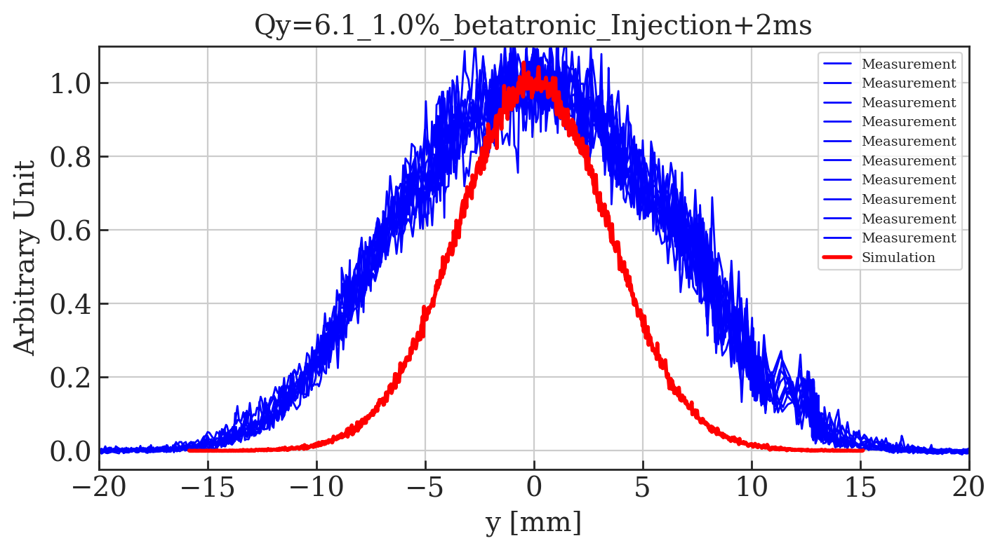

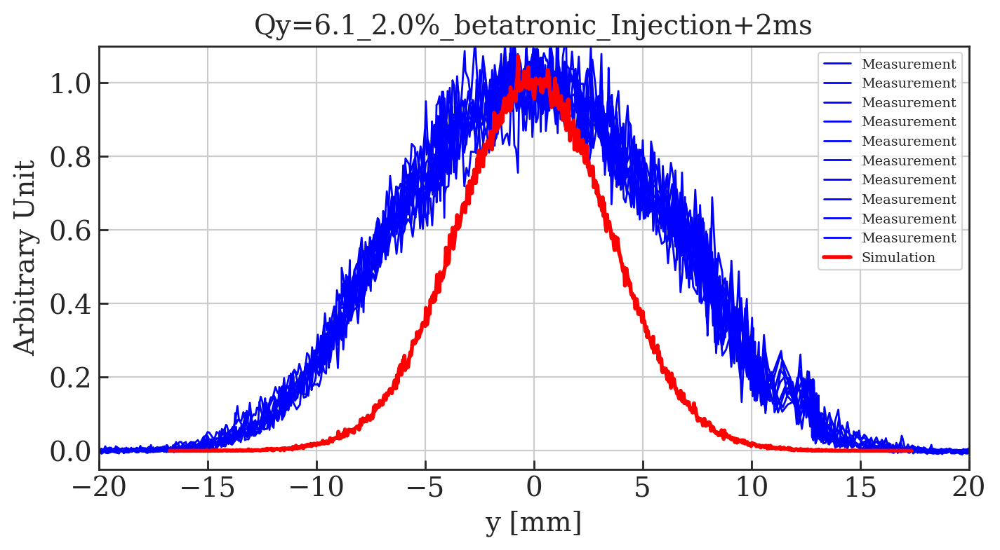

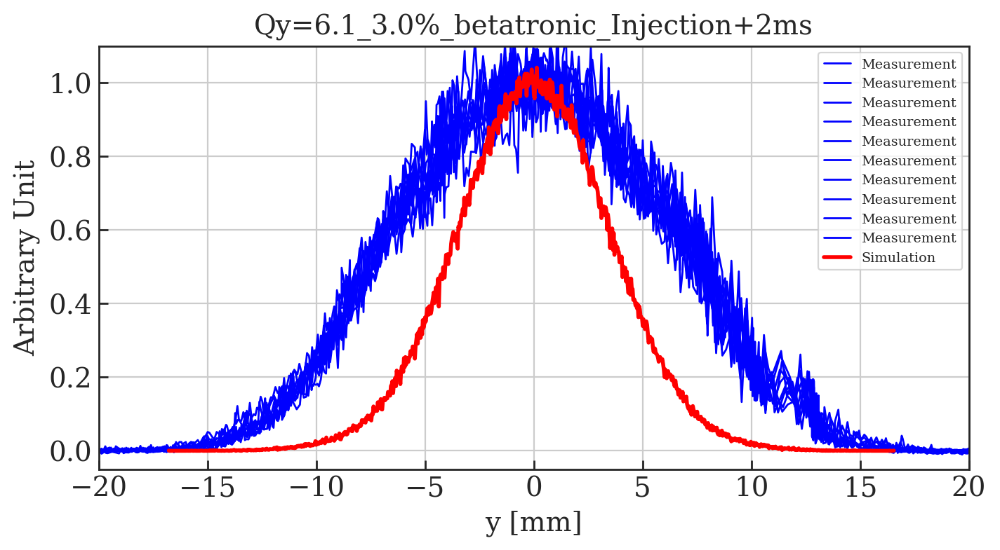

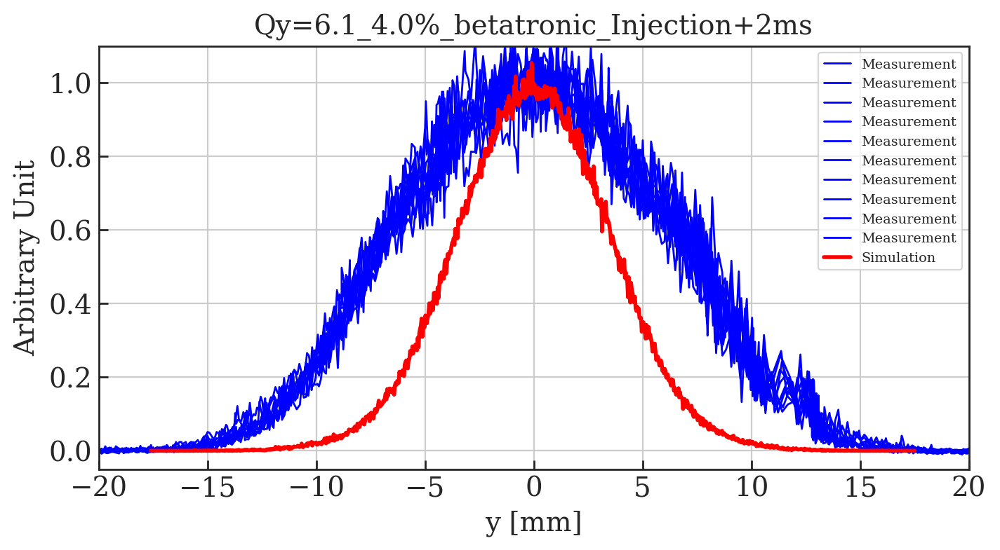

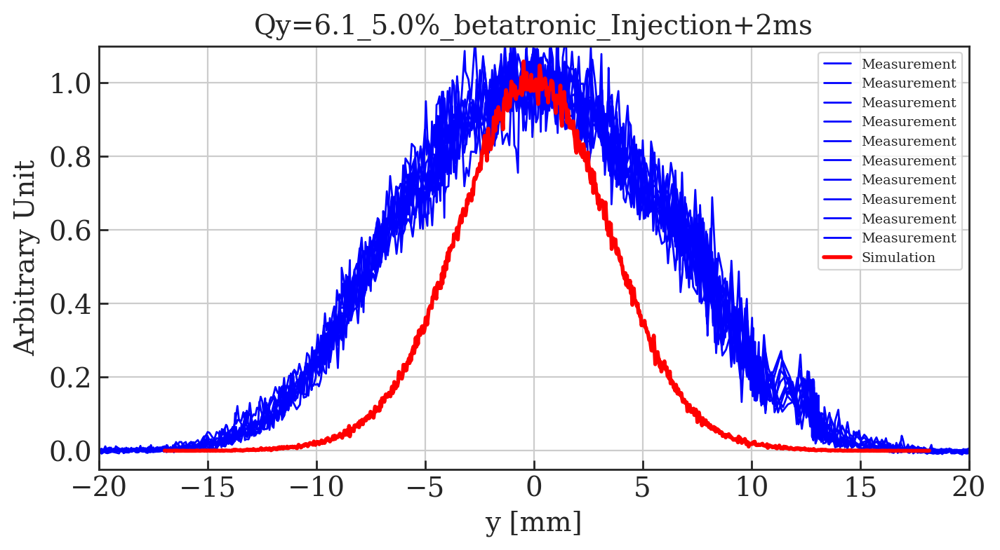

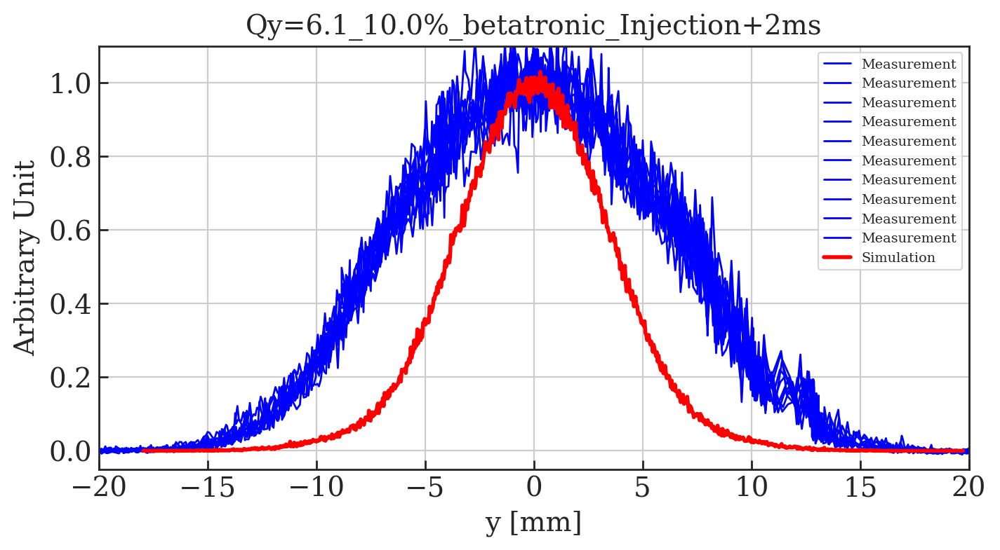

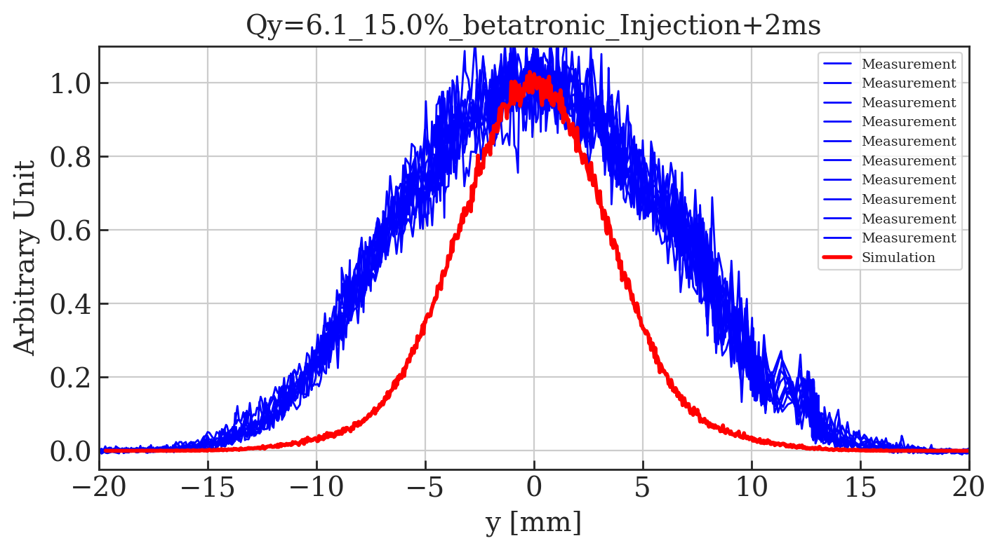

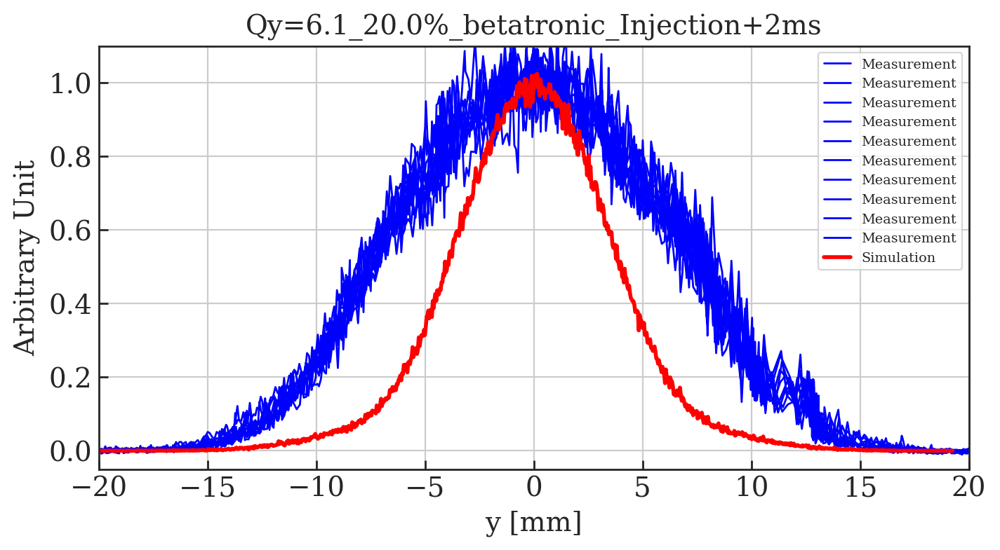

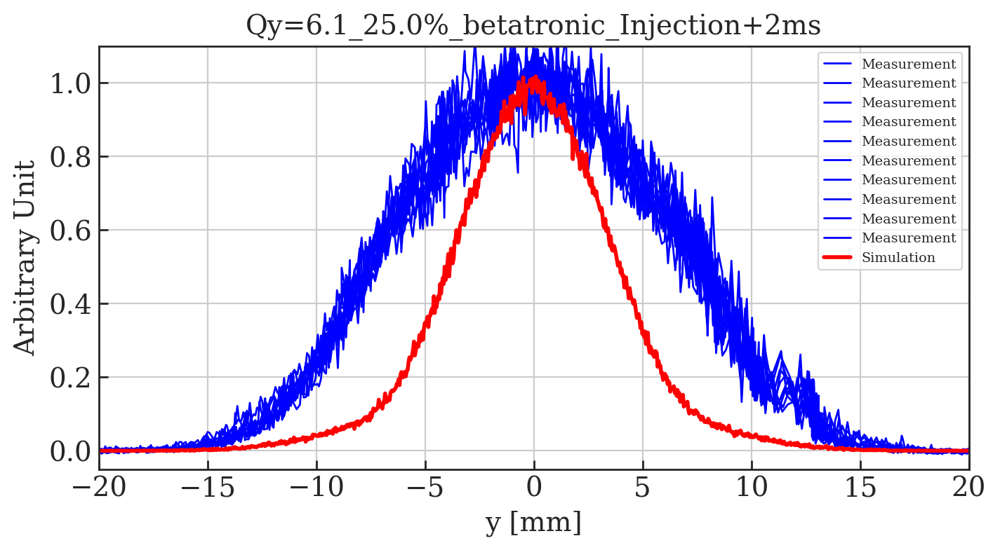

In [147]:
#Main function to plot comparison plots with MD data
verbose = True

plotted_names = []

for key, value in sorted(pfw_beta_sims.iteritems()):
    if key not in plotted_names:        
        
        plotted_names.append(key)
        
        this_plot = []
        this_plot.append(value)
        if verbose: print '\nImporting simulation file:', key        

        tune_y = float(key.split('_')[0])/100
        ctime = (key.split('_')[2])
        time = float(ctime.split('c')[1])
        beating = float(key.split('_')[-1])
        label = (key.split('_')[1])
        if verbose: print 'Qy = ', tune_y, ', ctime =', time, '[ms], label = ', label
        
        sim_labels=['Simulation']

        # Find MD data with same tune and ctime    
        for key1, value1 in sorted(pfw_beta_sims.iteritems()):
#             if verbose: print '\tChecking other files:', key1  
            tune_y1 = float(key1.split('_')[0])/100
            ctime1 = (key1.split('_')[2])
            time1 = float(ctime1.split('c')[1])
            label1 = (key1.split('_')[1])
#             if verbose: print '\tQy = ', tune_y1, ', ctime =', time1, '[ms], label = ', label1
            if (tune_y1 == tune_y) and (time1 == time):
                if (label1 != label):
                    print '\tMATCH FOUND' 
                    print '\tQy = ', tune_y1, ', ctime =', time1, '[ms]'
                    print '\tlab = ', label, ', lab1 =', label1

                    this_plot.append(value1)
                    plotted_names.append(key1)
                    sim_labels.append(label1)

        # Find rows in dataframe at correct tune and WS time
        md_points = []
        for i in tune_points[tune_y]:
            if df0['PR.BWS.64.V_ROT:ACQ_DELAY'].iloc()[i] == time:
                md_points.append(i)          

        if verbose: print md_points                 

        # Plot data
        main_label = 'Qy=' + str(tune_y) + '_' + str(beating) + '%_betatronic_Injection+2ms'
        
        if len(this_plot) is 1:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, main_label=main_label, bins=1000, sim_labels=sim_labels, plot_md=True)  
        elif len(this_plot) is 2:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, particles_from_matfile(this_plot[1]), main_label=main_label, bins=1000, sim_labels=sim_labels, plot_md=True)  
        elif len(this_plot) is 3:
            Plot_profiles_cf_sc_models(df0, md_points, particles_from_matfile(this_plot[0]), 1, particles_from_matfile(this_plot[1]), particles_from_matfile(this_plot[2]), main_label=main_label, bins=1000, sim_labels=sim_labels, plot_md=True)  
        else: print 'ERROR: More than 3 space charge methods found'
        


Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]
Qy =  6.1 , ctime = 172.0 [ms]


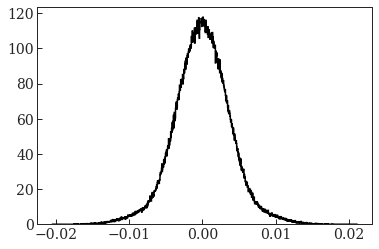

In [148]:
# Make dataframe with name, tunes, position V, profile V 
data = []

# Each row as a list
for key, value in sorted(pfw_beta_sims.iteritems()):
    
    tune_y = float(key.split('_')[0])/100
    ctime = (key.split('_')[2])
    time = float(ctime.split('c')[1])
    if verbose: print 'Qy = ', tune_y, ', ctime =', time, '[ms]'

    d = particles_from_matfile(value)
    plt.clf()
    x1, bins_1, p1 = plt.hist(d['particles']['y'][0][0][0], bins = 1000, density=True, histtype=u'step', lw=1.5, color='k')
          
    qx = 6.21
    qy = tune_y
    pos = np.array(bins_1[:-1]) + (abs(bins_1[0]-bins_1[1])/2)
    prof = x1
    
    new_data = [qx, qy, pos, prof]
    
    data.append(new_data)    

# Create dataframe
df_pfw_beta_sim = pd.DataFrame(data, columns = ['Qx', 'Qy', 'PR.BWS.64.V_ROT:PROF_POSITION_IN', 'PR.BWS.64.V_ROT:PROF_DATA_IN'])

In [149]:
df_pfw_beta_sim

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN
0,6.21,6.1,"[-0.015836631747280464, -0.015805629252300633,...","[0.06451093698430323, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1,6.21,6.1,"[-0.01673259394940173, -0.016698460175375008, ...","[0.05859299350942555, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2,6.21,6.1,"[-0.016774641795067966, -0.016741279620413507,...","[0.05994813050151856, 0.0, 0.0, 0.0, 0.0, 0.0,..."
3,6.21,6.1,"[-0.017595742336548988, -0.017560599660440983,...","[0.05691086227620104, 0.0, 0.0, 0.0, 0.0, 0.0,..."
4,6.21,6.1,"[-0.016967829152887505, -0.01693264247579194, ...","[0.05683969516553714, 0.05683969516554275, 0.0..."
5,6.21,6.1,"[-0.01794840716384792, -0.01791069199307621, -...","[0.053029058574492666, 0.05302905857449754, 0...."
6,6.21,6.1,"[-0.019678977014938592, -0.019638611212384624,...","[0.049546890522640795, 0.0, 0.0, 0.0, 0.0, 0.0..."
7,6.21,6.1,"[-0.020998541844735347, -0.02095825322226546, ...","[0.04964180648010082, 0.0, 0.0, 0.0, 0.0, 0.0,..."
8,6.21,6.1,"[-0.02040016898026944, -0.020358679943295516, ...","[0.048205505499125105, 0.0, 0.0, 0.0, 0.0, 0.0..."


In [150]:
# Gaussian and 2nd moment fits
df_pfw_beta_sim_filtered = Multi_filter_sim(df_pfw_beta_sim, with_plot = True, WS = '64.V', smooth=True)


Multi_filter row  0

	initial guess: mu0 -0.4283917423048497
	initial guess: offs0 0.004300729132286882
	initial guess: ampl 114.66849768453656
	initial guess: slope 0
	initial guess: sigma0 24.22275616258496
3 parameter fit sigma =  3.4742270759653824  +/-  0.0010375553809299845
Removing centre shift of  -0.011467154522821201
Second moment =  3.4770305635947976

Multi_filter row  1

	initial guess: mu0 -0.4849175126811073
	initial guess: offs0 0.0
	initial guess: ampl 114.51135637227101
	initial guess: slope 0
	initial guess: sigma0 26.66927567268457
3 parameter fit sigma =  3.475952452567811  +/-  0.0010719635151337351
Removing centre shift of  -0.004148569981795829
Second moment =  3.4971817635777196


/usr/local/bin/start_ipykernel.py:81: RuntimeWarning: invalid value encountered in sqrt
/usr/local/bin/start_ipykernel.py:83: RuntimeWarning: invalid value encountered in sqrt



Multi_filter row  2

	initial guess: mu0 -0.26036534111047865
	initial guess: offs0 0.0
	initial guess: ampl 114.94854196564513
	initial guess: slope 0
	initial guess: sigma0 26.066412468877118
3 parameter fit sigma =  3.471012463749653  +/-  0.0011053177595230254
Removing centre shift of  0.006777304366280686
Second moment =  3.5170663602681898

Multi_filter row  3

	initial guess: mu0 -0.2001176630854456
	initial guess: offs0 0.0
	initial guess: ampl 115.35614980101452
	initial guess: slope 0
	initial guess: sigma0 27.457547362519392
3 parameter fit sigma =  3.4772582844635593  +/-  0.0012098043435130913
Removing centre shift of  -0.0033699404319402137
Second moment =  3.5276056980257513

Multi_filter row  4

	initial guess: mu0 -0.2189708554001888
	initial guess: offs0 0.0
	initial guess: ampl 114.31653624736369
	initial guess: slope 0
	initial guess: sigma0 27.491926053432405
3 parameter fit sigma =  3.4573726825548485  +/-  0.001337054355811497
Removing centre shift of  0.0040332

In [151]:
df_pfw_beta_sim_filtered

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V
0,6.21,6.1,"[-0.015836631747280464, -0.015805629252300633,...","[0.06451093698430323, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.477031,3.4742270759653824,0.001038,1000.0707126608092,-0.011467154522821201,"[-15.825164592757643, -15.794162097777813, -15...","[0.01827809881221925, 0.01689572159112704, 0.0..."
1,6.21,6.1,"[-0.01673259394940173, -0.016698460175375008, ...","[0.05859299350942555, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.497182,3.475952452567811,0.001072,998.8940171646207,-0.004148569981795829,"[-16.728445379419934, -16.69431160539321, -16....","[0.01415997343144451, 0.01269514859370887, 0.0..."
2,6.21,6.1,"[-0.016774641795067966, -0.016741279620413507,...","[0.05994813050151856, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.517066,3.471012463749653,0.001105,997.1257786022384,0.006777304366280686,"[-16.78141909943425, -16.74805692477979, -16.7...","[0.01448746487120032, 0.012988761608662356, 0...."
3,6.21,6.1,"[-0.017595742336548988, -0.017560599660440983,...","[0.05691086227620104, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.527606,3.4772582844635593,0.001210,997.141598289089,-0.0033699404319402137,"[-17.592372396117046, -17.55722972000904, -17....","[0.013753458383415258, 0.01233068682651023, 0...."
4,6.21,6.1,"[-0.016967829152887505, -0.01693264247579194, ...","[0.05683969516553714, 0.05683969516554275, 0.0...",3.532032,3.4573726825548485,0.001337,995.4272608339795,0.004033279407746378,"[-16.97186243229525, -16.936675755199683, -16....","[0.02320954219259509, 0.02260054545867862, 0.0..."
5,6.21,6.1,"[-0.01794840716384792, -0.01791069199307621, -...","[0.053029058574492666, 0.05302905857449754, 0....",3.620575,3.462173164061959,0.002086,990.3660649298558,0.004052321941266402,"[-17.952459485789188, -17.914744315017476, -17...","[0.03358507043051327, 0.03131239649160636, 0.0..."
6,6.21,6.1,"[-0.019678977014938592, -0.019638611212384624,...","[0.049546890522640795, 0.0, 0.0, 0.0, 0.0, 0.0...",3.696840,3.4566214448072086,0.002959,985.1664486112996,0.0029877624054350208,"[-19.681964777344028, -19.64159897479006, -19....","[0.011973831876304864, 0.010735159613238844, 0..."
7,6.21,6.1,"[-0.020998541844735347, -0.02095825322226546, ...","[0.04964180648010082, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.779510,3.4556732628682,0.003858,980.1990782415387,0.012105529735874287,"[-21.01064737447122, -20.97035875200133, -20.9...","[0.011996769899357702, 0.010755724737355182, 0..."
8,6.21,6.1,"[-0.02040016898026944, -0.020358679943295516, ...","[0.048205505499125105, 0.0, 0.0, 0.0, 0.0, 0.0...",3.848557,3.45389861458292,0.004613,975.8624738315077,-0.006191096382212126,"[-20.393977883887224, -20.352488846913303, -20...","[0.011649663828955237, 0.01044452619147711, 0...."


In [152]:
# Calculate emittances in Vertical
df_pfw_beta_sim_emittance = emittance_df(df_pfw_beta_sim_filtered, WS='64.V', verbose=True)

Emittance  0  =  1.1537733030791673
Emittance  1  =  1.1549195653866677
Emittance  2  =  1.1516391778288069
Emittance  3  =  1.155787479496748
Emittance  4  =  1.142605938638699
Emittance  5  =  1.145781104940097
Emittance  6  =  1.142109448653412
Emittance  7  =  1.1414829530764135
Emittance  8  =  1.140310845381033


In [153]:
df_pfw_beta_sim_emittance

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V,emittance V,betx,bety,dx,dy
0,6.21,6.1,"[-0.015836631747280464, -0.015805629252300633,...","[0.06451093698430323, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.477031,3.4742270759653824,0.001038,1000.0707126608092,-0.011467154522821201,"[-15.825164592757643, -15.794162097777813, -15...","[0.01827809881221925, 0.01689572159112704, 0.0...",1.153773,12.391799,23.637581,NaN,0.0
1,6.21,6.1,"[-0.01673259394940173, -0.016698460175375008, ...","[0.05859299350942555, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.497182,3.475952452567811,0.001072,998.8940171646207,-0.004148569981795829,"[-16.728445379419934, -16.69431160539321, -16....","[0.01415997343144451, 0.01269514859370887, 0.0...",1.154920,12.391799,23.637581,NaN,0.0
2,6.21,6.1,"[-0.016774641795067966, -0.016741279620413507,...","[0.05994813050151856, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.517066,3.471012463749653,0.001105,997.1257786022384,0.006777304366280686,"[-16.78141909943425, -16.74805692477979, -16.7...","[0.01448746487120032, 0.012988761608662356, 0....",1.151639,12.391799,23.637581,NaN,0.0
3,6.21,6.1,"[-0.017595742336548988, -0.017560599660440983,...","[0.05691086227620104, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.527606,3.4772582844635593,0.001210,997.141598289089,-0.0033699404319402137,"[-17.592372396117046, -17.55722972000904, -17....","[0.013753458383415258, 0.01233068682651023, 0....",1.155787,12.391799,23.637581,NaN,0.0
4,6.21,6.1,"[-0.016967829152887505, -0.01693264247579194, ...","[0.05683969516553714, 0.05683969516554275, 0.0...",3.532032,3.4573726825548485,0.001337,995.4272608339795,0.004033279407746378,"[-16.97186243229525, -16.936675755199683, -16....","[0.02320954219259509, 0.02260054545867862, 0.0...",1.142606,12.391799,23.637581,NaN,0.0
5,6.21,6.1,"[-0.01794840716384792, -0.01791069199307621, -...","[0.053029058574492666, 0.05302905857449754, 0....",3.620575,3.462173164061959,0.002086,990.3660649298558,0.004052321941266402,"[-17.952459485789188, -17.914744315017476, -17...","[0.03358507043051327, 0.03131239649160636, 0.0...",1.145781,12.391799,23.637581,NaN,0.0
6,6.21,6.1,"[-0.019678977014938592, -0.019638611212384624,...","[0.049546890522640795, 0.0, 0.0, 0.0, 0.0, 0.0...",3.696840,3.4566214448072086,0.002959,985.1664486112996,0.0029877624054350208,"[-19.681964777344028, -19.64159897479006, -19....","[0.011973831876304864, 0.010735159613238844, 0...",1.142109,12.391799,23.637581,NaN,0.0
7,6.21,6.1,"[-0.020998541844735347, -0.02095825322226546, ...","[0.04964180648010082, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.779510,3.4556732628682,0.003858,980.1990782415387,0.012105529735874287,"[-21.01064737447122, -20.97035875200133, -20.9...","[0.011996769899357702, 0.010755724737355182, 0...",1.141483,12.391799,23.637581,NaN,0.0
8,6.21,6.1,"[-0.02040016898026944, -0.020358679943295516, ...","[0.048205505499125105, 0.0, 0.0, 0.0, 0.0, 0.0...",3.848557,3.45389861458292,0.004613,975.8624738315077,-0.006191096382212126,"[-20.393977883887224, -20.352488846913303, -20...","[0.011649663828955237, 0.01044452619147711, 0....",1.140311,12.391799,23.637581,NaN,0.0


In [154]:
# Calculate emittances using second moment
df_pfw_beta_sim_emittance_2 = emittance_df_2(df_pfw_beta_sim_emittance, WS='64.V', verbose=True)

Emittance from 2nd moment 0  =  1.1556361025847088
Emittance from 2nd moment 1  =  1.1690699423144373
Emittance from 2nd moment 2  =  1.1824021477173774
Emittance from 2nd moment 3  =  1.1894992029966394
Emittance from 2nd moment 4  =  1.1924863240920933
Emittance from 2nd moment 5  =  1.2530231694221612
Emittance from 2nd moment 6  =  1.3063674313557854
Emittance from 2nd moment 7  =  1.3654480020572974
Emittance from 2nd moment 8  =  1.415793207355894


In [155]:
df_pfw_beta_sim_emittance_2

,Qx,Qy,PR.BWS.64.V_ROT:PROF_POSITION_IN,PR.BWS.64.V_ROT:PROF_DATA_IN,2ndMoment V,sig V,sig errV,A V,mu V,position V,profile V,emittance V,betx,bety,dx,dy,emittance V 2ndMoment
0,6.21,6.1,"[-0.015836631747280464, -0.015805629252300633,...","[0.06451093698430323, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.477031,3.4742270759653824,0.001038,1000.0707126608092,-0.011467154522821201,"[-15.825164592757643, -15.794162097777813, -15...","[0.01827809881221925, 0.01689572159112704, 0.0...",1.153773,12.391799,23.637581,NaN,0.0,1.155636
1,6.21,6.1,"[-0.01673259394940173, -0.016698460175375008, ...","[0.05859299350942555, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.497182,3.475952452567811,0.001072,998.8940171646207,-0.004148569981795829,"[-16.728445379419934, -16.69431160539321, -16....","[0.01415997343144451, 0.01269514859370887, 0.0...",1.154920,12.391799,23.637581,NaN,0.0,1.169070
2,6.21,6.1,"[-0.016774641795067966, -0.016741279620413507,...","[0.05994813050151856, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.517066,3.471012463749653,0.001105,997.1257786022384,0.006777304366280686,"[-16.78141909943425, -16.74805692477979, -16.7...","[0.01448746487120032, 0.012988761608662356, 0....",1.151639,12.391799,23.637581,NaN,0.0,1.182402
3,6.21,6.1,"[-0.017595742336548988, -0.017560599660440983,...","[0.05691086227620104, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.527606,3.4772582844635593,0.001210,997.141598289089,-0.0033699404319402137,"[-17.592372396117046, -17.55722972000904, -17....","[0.013753458383415258, 0.01233068682651023, 0....",1.155787,12.391799,23.637581,NaN,0.0,1.189499
4,6.21,6.1,"[-0.016967829152887505, -0.01693264247579194, ...","[0.05683969516553714, 0.05683969516554275, 0.0...",3.532032,3.4573726825548485,0.001337,995.4272608339795,0.004033279407746378,"[-16.97186243229525, -16.936675755199683, -16....","[0.02320954219259509, 0.02260054545867862, 0.0...",1.142606,12.391799,23.637581,NaN,0.0,1.192486
5,6.21,6.1,"[-0.01794840716384792, -0.01791069199307621, -...","[0.053029058574492666, 0.05302905857449754, 0....",3.620575,3.462173164061959,0.002086,990.3660649298558,0.004052321941266402,"[-17.952459485789188, -17.914744315017476, -17...","[0.03358507043051327, 0.03131239649160636, 0.0...",1.145781,12.391799,23.637581,NaN,0.0,1.253023
6,6.21,6.1,"[-0.019678977014938592, -0.019638611212384624,...","[0.049546890522640795, 0.0, 0.0, 0.0, 0.0, 0.0...",3.696840,3.4566214448072086,0.002959,985.1664486112996,0.0029877624054350208,"[-19.681964777344028, -19.64159897479006, -19....","[0.011973831876304864, 0.010735159613238844, 0...",1.142109,12.391799,23.637581,NaN,0.0,1.306367
7,6.21,6.1,"[-0.020998541844735347, -0.02095825322226546, ...","[0.04964180648010082, 0.0, 0.0, 0.0, 0.0, 0.0,...",3.779510,3.4556732628682,0.003858,980.1990782415387,0.012105529735874287,"[-21.01064737447122, -20.97035875200133, -20.9...","[0.011996769899357702, 0.010755724737355182, 0...",1.141483,12.391799,23.637581,NaN,0.0,1.365448
8,6.21,6.1,"[-0.02040016898026944, -0.020358679943295516, ...","[0.048205505499125105, 0.0, 0.0, 0.0, 0.0, 0.0...",3.848557,3.45389861458292,0.004613,975.8624738315077,-0.006191096382212126,"[-20.393977883887224, -20.352488846913303, -20...","[0.011649663828955237, 0.01044452619147711, 0....",1.140311,12.391799,23.637581,NaN,0.0,1.415793


In [156]:
# Save sim data to pickle file
df_pfw_beta_sim_emittance_2.to_pickle('MD4224_HighBrightness_Vertical_Using_Sim_Optics_Complete_PFW_Beta_simulation_data')

In [157]:
# Load sim data to pickle file
df0_pfw_beta_sim = pnd.read_pickle('MD4224_HighBrightness_Vertical_Using_Sim_Optics_Complete_PFW_Beta_simulation_data')

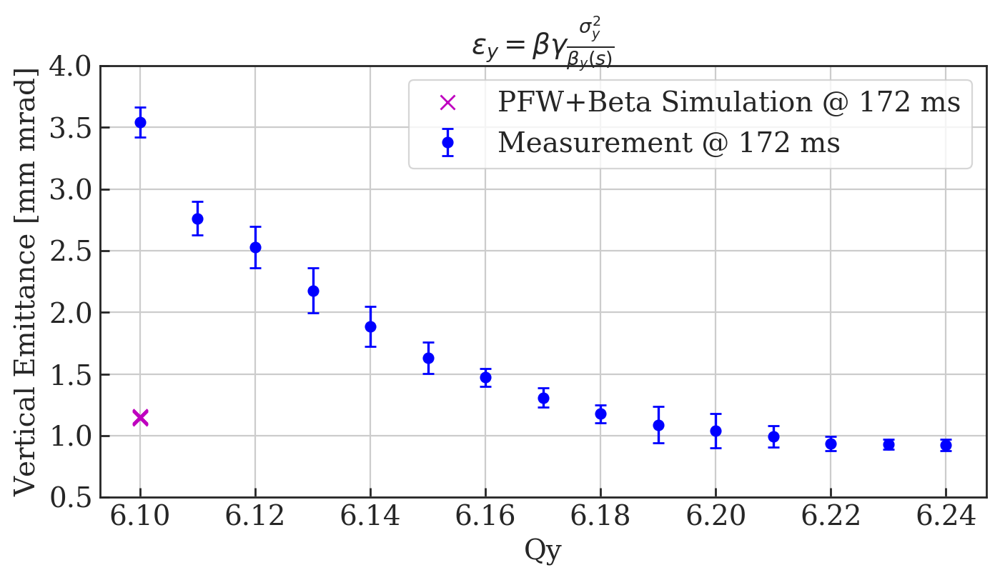

In [158]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_pfw_beta_sim['Qy'], df0_pfw_beta_sim['emittance V'], label='PFW+Beta Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)
#plt.plot(df0_pfw_beta_sim['Qy'][0], df0_pfw_quad_sim['emittance V'][7], label='PFW + 15% beta-beating', linestyle='None', marker='x', color='r', markersize=7)
#plt.plot(df0_pfw_beta_sim['Qy'][0], df0_pfw_quad_sim['emittance V'][8], label='PFW + 20% beta-beating', linestyle='None', marker='x', color='orange', markersize=7)


plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\sigma_y^2}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);

plt.legend();
plt.grid();
fig.savefig('MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_Errors_Using_Sim_Optics_PFW_beta_scan_172.png');

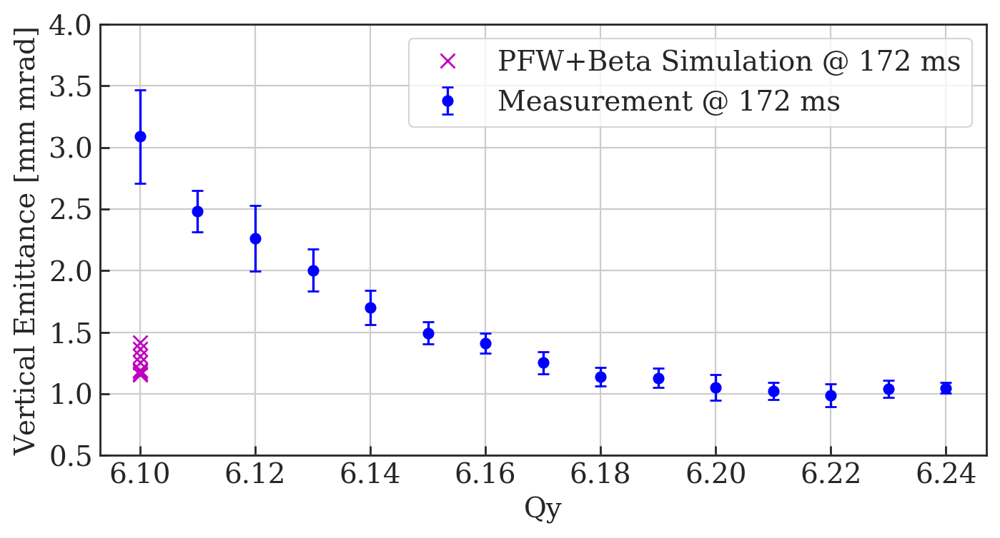

In [159]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_pfw_beta_sim['Qy'], df0_pfw_beta_sim['emittance V 2ndMoment'], label='PFW+Beta Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);

plt.legend();
plt.grid();
fig.savefig('MD4224_Vertical_Manual_Fit_WS_Delay_Emittance_2nd_Errors_Using_Sim_Optics_PFW_beta_172.png');

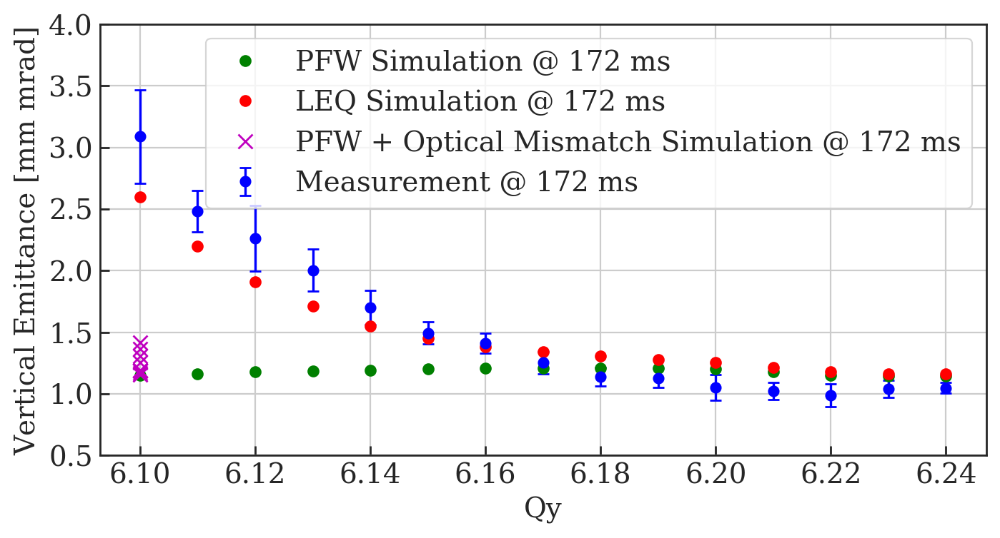

In [160]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

#plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][8], label='PFW Simulation + 20% beta-beating @ 172 ms', linestyle='None', marker='x', color='orange', markersize=7)

plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)

plt.plot(df0_sim['Qy'], df0_sim['emittance V 2ndMoment'], label='LEQ Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

plt.plot(df0_pfw_beta_sim['Qy'], df0_pfw_beta_sim['emittance V 2ndMoment'], label='PFW + Optical Mismatch Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)

#plt.plot(df0_pfw_quad_sim['Qy'], df0_pfw_quad_sim['emittance V 2ndMoment'], label='PFW+Quad Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)
#plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][7], label='PFW+Quad 15% beta-beating', linestyle='None', marker='x', color='r', markersize=7)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);

plt.legend();
plt.grid();
fig.savefig('betatronic.png');

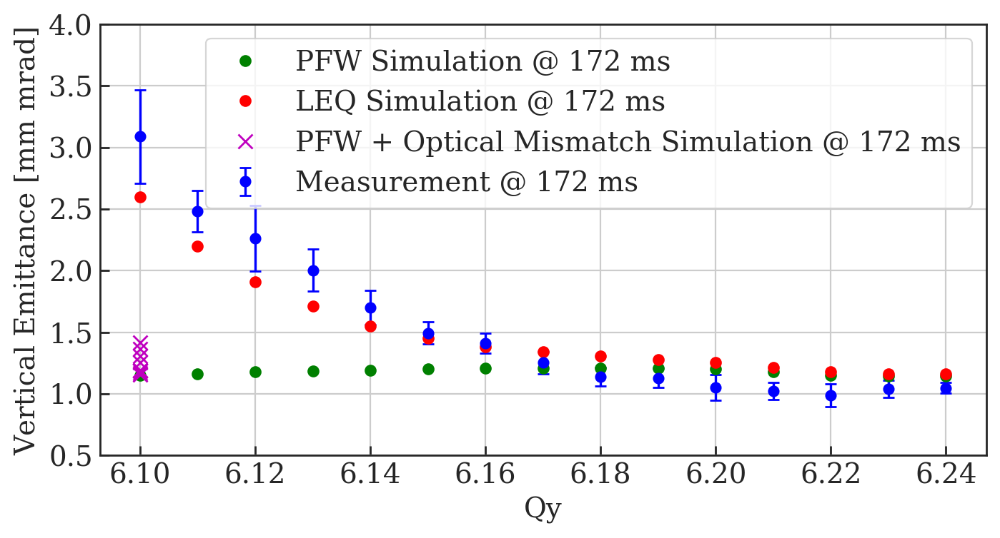

In [161]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='Measurement @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

#plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][8], label='PFW Simulation + 20% beta-beating @ 172 ms', linestyle='None', marker='x', color='orange', markersize=7)

plt.plot(df0_pfw_sim['Qy'], df0_pfw_sim['emittance V 2ndMoment'], label='PFW Simulation @ 172 ms', linestyle='None', marker='o', color='g', markersize=5)

plt.plot(df0_sim['Qy'], df0_sim['emittance V 2ndMoment'], label='LEQ Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

plt.plot(df0_pfw_beta_sim['Qy'], df0_pfw_beta_sim['emittance V 2ndMoment'], label='PFW + Optical Mismatch Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)

#plt.plot(df0_pfw_quad_sim['Qy'], df0_pfw_quad_sim['emittance V 2ndMoment'], label='PFW+Quad Simulation @ 172 ms', linestyle='None', marker='x', color='m', markersize=7)
#plt.plot(df0_pfw_quad_sim['Qy'][0], df0_pfw_quad_sim['emittance V 2ndMoment'][7], label='PFW+Quad 15% beta-beating', linestyle='None', marker='x', color='r', markersize=7)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

#plt.title(r'$\epsilon_{y} = \beta\gamma \frac{\mu\prime^{2}_{y}}{\beta_{y}(s)}$')

plt.ylim(0.5, 4);

plt.legend();
plt.grid();
fig.savefig('Write_Up/Measurement_LEQ_PFW_Betatronic_172png');

# Test some stuff

In [162]:
# Check cutting of data
x_data = df0['position V'].iloc()[0]
y_data = df0['profile V'].iloc()[0]

In [163]:
len(x_data)

407

In [164]:
len(y_data)

407

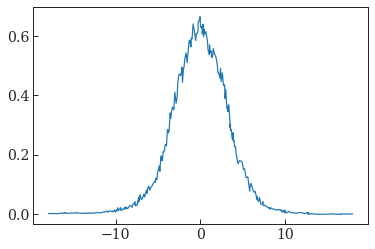

In [165]:
plt.plot(x_data, y_data)

In [166]:
indx_max = np.argmax(y_data)
indx_max

192

In [167]:
quart_len_x_dat = int(len(x_data)/4)
quart_len_x_dat

101

In [168]:
X = x_data[int(indx_max-quart_len_x_dat) : int(indx_max+quart_len_x_dat)]
Y = y_data[int(indx_max-quart_len_x_dat) : int(indx_max+quart_len_x_dat)]

In [169]:
len(X)

202

In [170]:
len(Y)

202

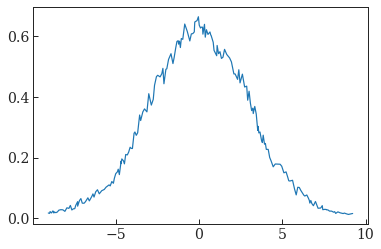

In [171]:
plt.plot(X, Y)

## Current method doesn't work, have to manually find half-peak x axis index

In [172]:
indx_max = np.argmax(y_data)
peak = y_data[indx_max]

print 'peak of ', peak, ' found at index ', indx_max

first = int(0)

for i in xrange(len(y_data)):
    if y_data[i] > peak/2:
        print 'half peak of ', y_data[i] , ' found at index ', i
        first = i
        break
        
for i in reversed(xrange(len(y_data))):
    if y_data[i] > peak/2:
        print 'half peak of ', y_data[i] , ' found at index ', i
        second = i
        break

X = x_data[int(first) : int(second)]
Y = y_data[int(first) : int(second)]



peak of  0.6638534591783954  found at index  192
half peak of  0.34312616556205056  found at index  152
half peak of  0.34014095682108453  found at index  229


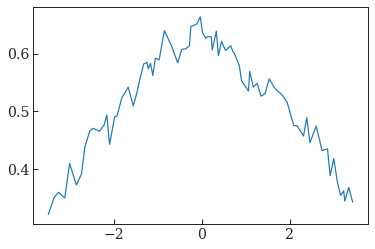

In [173]:
plt.plot(X, Y)

In [174]:
def gaussian_3_parameters(x, A, mu, sig):
    """gaussian_3_parameter(x, m, A, mu, sig)"""
    return A/np.sqrt(2*np.pi)/sig*np.exp(-np.power(x - mu, 2.) / (2 * np.power(sig, 2.)))


ampl = max(Y)
sigma0 = 1
mu0 = 0

popt3, pcov3 = curve_fit(gaussian_3_parameters, X, Y, p0 =[ampl, mu0, sigma0])
result3 = gaussian_3_parameters(X, popt3[0], popt3[1], popt3[2])
print 'found sigma to be :', popt3[2]

found sigma to be : 3.1153220873265624


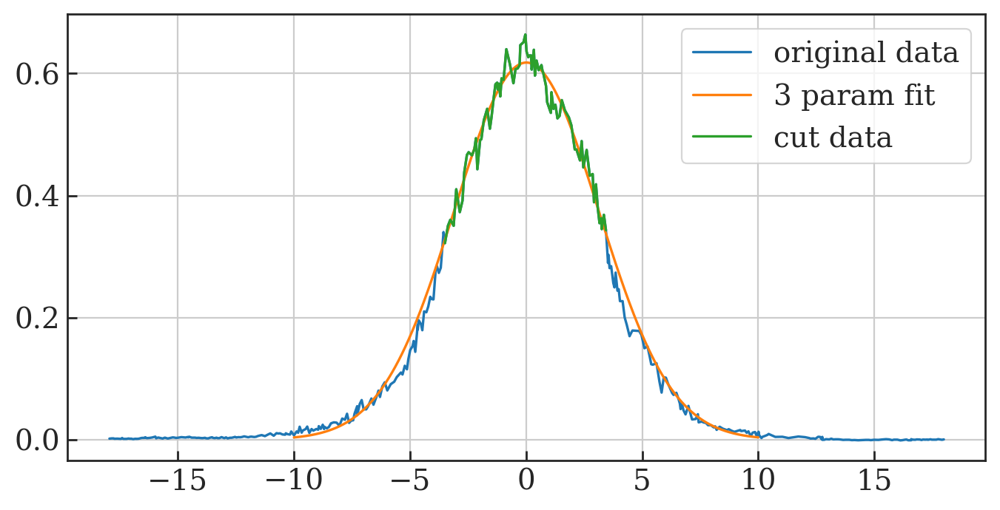

In [175]:
fig=plt.figure(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');

x_dat = np.linspace(-10, 10, 1000)
result3 = gaussian_3_parameters(x_dat, popt3[0], popt3[1], popt3[2])
plt.plot(x_data, y_data, label='original data')
plt.plot(x_dat, result3, label='3 param fit');
plt.plot(X, Y, label='cut data')
plt.grid()
plt.legend()

In [176]:
def find_factor_of_peak_indices(x_data, y_data, fac, verbose = False):
    indices = []
    first = int(0)
    second = int(0)    
    
    indx_max = np.argmax(y_data)
    peak = y_data[indx_max]
    
    for i in xrange(len(y_data)):
        if y_data[i] > peak*fac:
            if verbose: print 'half peak of ', y_data[i] , ' found at index ', i
            first = i
            break
        
    for i in reversed(xrange(len(y_data))):
        if y_data[i] > peak*fac:
            if verbose: print 'half peak of ', y_data[i] , ' found at index ', i
            second = i
            break
            
    
    
    indices.append(first)
    indices.append(second)
    
    return indices

def find_half_peak_indices(x_data, y_data, verbose = False):
    indices = []
    first = int(0)
    second = int(0)    
    
    indx_max = np.argmax(y_data)
    peak = y_data[indx_max]
    
    for i in xrange(len(y_data)):
        if y_data[i] > peak/2:
            if verbose: print 'half peak of ', y_data[i] , ' found at index ', i
            first = i
            break
        
    for i in reversed(xrange(len(y_data))):
        if y_data[i] > peak/2:
            if verbose: print 'half peak of ', y_data[i] , ' found at index ', i
            second = i
            break
    
    indices.append(first)
    indices.append(second)
    
    return indices

def gaussian_3_parameters(x, A, mu, sig):
    """gaussian_3_parameter(x, m, A, mu, sig)"""
    return A/np.sqrt(2*np.pi)/sig*np.exp(-np.power(x - mu, 2.) / (2 * np.power(sig, 2.)))

def second_moment(values, weights):
    weighted_average = np.average(values, weights=weights)
    second_moment = np.sqrt(np.average((values-weighted_average)**2, weights=weights))
    return (second_moment)

def Core_filter(ndf, with_plot = True, WS = '64.V', sig_limit_mm=10, smooth = False):
    
    df = ndf.copy()
    
    position_label = 'position V'
    profile_label = 'profile V'
    window = 40
    
    
    mu_3 = []
    sigma_3 = []
    A_3 = []
    sig_err_3 = []
    
    mom_2nd = []
    
    # Iterate over dataframe
    for j in range(0, len(df), 1):
        print '\nCore_filter row ', j    
    
        y_data = df[profile_label].iloc()[j]
        x_data = df[position_label].iloc()[j]
        indx_max = np.argmax(y_data)  
        peak = y_data[indx_max]
        
#         print '\nPeak magnitude ', peak, 'found at index ', indx_max
        
        quart_len_x_dat = int(len(x_data)/4)
        
#         print '\nUsing indices', int(indx_max-quart_len_x_dat), ' to ', int(indx_max+quart_len_x_dat)
        
        # Use only half of the data, around the peak        
#         half_peak_indices = find_half_peak_indices(x_data, y_data)
        # equivalent
        half_peak_indices = find_factor_of_peak_indices(x_data, y_data, 0.5, verbose=True)
        
        X = x_data[half_peak_indices[0] : half_peak_indices[1]]
#         X = X/1000
        Y = y_data[half_peak_indices[0] : half_peak_indices[1]]
        
        indx_max = np.argmax(Y)        
        mu0 = X[indx_max]
        x_tmp = X
        y_tmp = Y
        offs0 = min(y_tmp)
        ampl = max(y_tmp)-offs0
#         x1 = x_tmp[np.searchsorted(y_tmp[:window], offs0+ampl/2)]
#         x2 = x_tmp[np.searchsorted(-y_tmp[window:], -offs0+ampl/2)]
#         FWHM = x2-x1
        #sigma0 = np.abs(2*FWHM/2.355)
        sigma0 = 1
        ampl *= np.sqrt(2*np.pi)*sigma0
        slope = 0
    
        popt3 = []
        pcov3 = []   
        
        try:
            popt3, pcov3 = curve_fit(gaussian_3_parameters, X, Y, p0 =[ampl, mu0, sigma0])

            fit_A_3 = popt3[0]
            fit_mean_3 = popt3[1]
            fit_sigma_3 = popt3[2]

            A_3.append(np.array(popt3[0]))
            mu_3.append(np.array(popt3[1]))
            sigma_3.append(np.array(abs(popt3[2])))
            sig_err_3.append(np.sqrt(np.diag(pcov3[2]))[2][2])   
            
            print '3 parameter fit sigma = ', popt3[2] , ' +/- ', np.sqrt(np.diag(pcov3[2]))[2][2]
# Plot
#------------------------------------------------      
            if with_plot:
                fig, ax1 = plt.subplots(figsize=(8, 4), dpi= 200, facecolor='w', edgecolor='k');

                x_dat = np.linspace(-20, 20, 1000)
                result3 = gaussian_3_parameters(x_dat, popt3[0], popt3[1], popt3[2])

                plt.plot(df[position_label].iloc()[j], df[profile_label].iloc()[j], label='filtered data');
                plt.plot(X, Y, label='raw core data');
                plt.plot(x_dat, result3, label='3 param core fit' );

                tit = 'WS profile & fit ' + str(j);
                savename = 'MD4224_HB_Vertical_Corefit_' + str(j);

                plt.title(tit);
                plt.ylabel('Profile [-]');
                plt.xlabel('Position [mm]');
                plt.legend();            
                plt.grid();
                fig.savefig(savename);
                plt.close();            
            
        except:            
            
            print '3 parameter fit not found'
                        
            result3 = 'NaN'

            fit_A_3 = 'NaN'
            fit_mean_3 = 'NaN'
            fit_sigma_3 = 'NaN'

            A_3.append('NaN')
            mu_3.append('NaN')
            sigma_3.append('NaN')
            sig_err_3.append('NaN')   
        
        second_mom = second_moment(X, Y)

        mom_2nd.append(second_mom)
    
    df['Core 2ndMoment '+WS[-1]] = mom_2nd   
    
    df['Core sig '+WS[-1]] = sigma_3
    df['Core sig err'+WS[-1]] = sig_err_3
    df['Core A '+WS[-1]] = A_3
    df['Core mu '+WS[-1]] = mu_3
    
    return df


Core_filter row  0
half peak of  0.34312616556205056  found at index  152
half peak of  0.34014095682108453  found at index  229
3 parameter fit sigma =  3.1153221236135034  +/-  0.04469013465596553


/usr/local/bin/start_ipykernel.py:129: RuntimeWarning: invalid value encountered in sqrt
/usr/local/bin/start_ipykernel.py:131: RuntimeWarning: invalid value encountered in sqrt



Core_filter row  1
half peak of  0.3494602863317584  found at index  159
half peak of  0.361790927856525  found at index  239
3 parameter fit sigma =  3.5433838997184575  +/-  0.07409591372090191

Core_filter row  2
half peak of  0.319849632035197  found at index  144
half peak of  0.3210196088348243  found at index  215
3 parameter fit sigma =  2.8790524968237077  +/-  0.05239759785196312

Core_filter row  3
half peak of  0.3255894264648742  found at index  172
half peak of  0.3209840705167232  found at index  242
3 parameter fit sigma =  2.6788557414744423  +/-  0.05422383394187112

Core_filter row  4
half peak of  0.30862725134405455  found at index  166
half peak of  0.2964785916481931  found at index  248
3 parameter fit sigma =  3.4878394774488757  +/-  0.08298362820320934

Core_filter row  5
half peak of  0.32587573126936276  found at index  171
half peak of  0.3121638453720792  found at index  255
3 parameter fit sigma =  3.480941795710534  +/-  0.06408110852420859

Core_filte


Core_filter row  43
half peak of  0.3310030219268555  found at index  158
half peak of  0.3399065488205566  found at index  241
3 parameter fit sigma =  3.60603944402545  +/-  0.06962468064794841

Core_filter row  44
half peak of  0.33325322001624047  found at index  149
half peak of  0.3356252749982794  found at index  224
3 parameter fit sigma =  2.98569061284806  +/-  0.04868660586552925

Core_filter row  45
half peak of  0.32800191846553284  found at index  153
half peak of  0.31876884812656625  found at index  230
3 parameter fit sigma =  3.223713384785238  +/-  0.06516350838514187

Core_filter row  46
half peak of  0.32685891278925505  found at index  166
half peak of  0.3333303588760701  found at index  245
3 parameter fit sigma =  3.3018379408754557  +/-  0.056161455986887904

Core_filter row  47
half peak of  0.31985448785314263  found at index  161
half peak of  0.3130331674977407  found at index  246
3 parameter fit sigma =  3.533285390282038  +/-  0.06315910543302186

Core


Core_filter row  85
half peak of  0.21388071652703403  found at index  234
half peak of  0.21887656305655231  found at index  368
3 parameter fit sigma =  5.725492222818863  +/-  0.11374184630689417

Core_filter row  86
half peak of  0.20148404489198815  found at index  256
half peak of  0.21617529583307074  found at index  399
3 parameter fit sigma =  5.512753382776311  +/-  0.07836477572705348

Core_filter row  87
half peak of  0.31594543362439204  found at index  151
half peak of  0.3193825169537936  found at index  227
3 parameter fit sigma =  3.136113086497779  +/-  0.05256616917095694

Core_filter row  88
half peak of  0.3291917166283197  found at index  153
half peak of  0.3446495110667015  found at index  235
3 parameter fit sigma =  3.468253167423315  +/-  0.05067771703607479

Core_filter row  89
half peak of  0.3420537704877941  found at index  146
half peak of  0.31294286850856756  found at index  221
3 parameter fit sigma =  3.08017890138041  +/-  0.046321900197934786

Cor


Core_filter row  126
half peak of  0.22836307800543626  found at index  223
half peak of  0.2407086894959227  found at index  346
3 parameter fit sigma =  5.355243494526514  +/-  0.11464097219047763

Core_filter row  127
half peak of  0.2465662346162348  found at index  241
half peak of  0.22979878158233571  found at index  368
3 parameter fit sigma =  5.4401338530416785  +/-  0.09394831603233768

Core_filter row  128
half peak of  0.20690172422532785  found at index  257
half peak of  0.20250861697866407  found at index  397
3 parameter fit sigma =  5.634749360426365  +/-  0.09511896272083684

Core_filter row  129
half peak of  0.17736804087439334  found at index  284
half peak of  0.18024014365698315  found at index  437
3 parameter fit sigma =  6.471167370358328  +/-  0.09914296304563551

Core_filter row  130
half peak of  0.3324007497152204  found at index  152
half peak of  0.33418234483869186  found at index  232
3 parameter fit sigma =  3.517350959401252  +/-  0.061993168855526


Core_filter row  167
half peak of  0.29627753957957825  found at index  179
half peak of  0.30233677611965415  found at index  270
3 parameter fit sigma =  4.137411044946849  +/-  0.09260978974522195

Core_filter row  168
half peak of  0.268691326316745  found at index  195
half peak of  0.2833429234072875  found at index  292
3 parameter fit sigma =  4.461621118429469  +/-  0.09919224261015935

Core_filter row  169
half peak of  0.22278167267721546  found at index  216
half peak of  0.22555114186663114  found at index  343
3 parameter fit sigma =  5.0595920665967204  +/-  0.09418116635565148

Core_filter row  170
half peak of  0.21460588820506535  found at index  234
half peak of  0.21551033312355145  found at index  372
3 parameter fit sigma =  5.578075262170229  +/-  0.09792667079243432

Core_filter row  171
half peak of  0.21640016534636927  found at index  262
half peak of  0.2137111162122306  found at index  404
3 parameter fit sigma =  6.081168154684258  +/-  0.1069133643507844


Core_filter row  208
half peak of  0.28224445848482743  found at index  187
half peak of  0.26052332843481774  found at index  281
3 parameter fit sigma =  3.9471943277970296  +/-  0.06608979894585938

Core_filter row  209
half peak of  0.2550521459945883  found at index  195
half peak of  0.2505908648471874  found at index  300
3 parameter fit sigma =  4.294841495270403  +/-  0.06804583047618004

Core_filter row  210
half peak of  0.24038691252067895  found at index  215
half peak of  0.2394369232548232  found at index  338
3 parameter fit sigma =  4.933074576155784  +/-  0.08318057786590653

Core_filter row  211
half peak of  0.23408005042975133  found at index  220
half peak of  0.23171224816773933  found at index  334
3 parameter fit sigma =  5.214987147955204  +/-  0.1149063951005469

Core_filter row  212
half peak of  0.2125768436793992  found at index  244
half peak of  0.2143833876565878  found at index  391
3 parameter fit sigma =  5.813535893492368  +/-  0.08056452682087663



Core_filter row  249
half peak of  0.29576399402450004  found at index  180
half peak of  0.3007056306311489  found at index  268
3 parameter fit sigma =  3.6727744996269887  +/-  0.060381123082055725

Core_filter row  250
half peak of  0.2802591012589417  found at index  182
half peak of  0.3124910223687303  found at index  269
3 parameter fit sigma =  3.690559416692785  +/-  0.05986587012324783

Core_filter row  251
half peak of  0.28079680657471656  found at index  185
half peak of  0.27189976162519347  found at index  279
3 parameter fit sigma =  4.18865692692702  +/-  0.08058262743669295

Core_filter row  252
half peak of  0.26985708030075284  found at index  187
half peak of  0.26269201745190424  found at index  284
3 parameter fit sigma =  4.166720251463708  +/-  0.07255437920110942

Core_filter row  253
half peak of  0.24097908143887528  found at index  209
half peak of  0.2567072592498365  found at index  322
3 parameter fit sigma =  4.676525930007705  +/-  0.0735133595790654


Core_filter row  290
half peak of  0.3313424492628735  found at index  160
half peak of  0.32204224523084507  found at index  243
3 parameter fit sigma =  3.441072638030538  +/-  0.052443610331944356

Core_filter row  291
half peak of  0.30499457554005255  found at index  166
half peak of  0.3248903029070357  found at index  246
3 parameter fit sigma =  3.350734547278079  +/-  0.06850064699645074

Core_filter row  292
half peak of  0.30893556821590024  found at index  171
half peak of  0.2838096642912795  found at index  254
3 parameter fit sigma =  3.621465250639977  +/-  0.07102404444107618

Core_filter row  293
half peak of  0.2620225013931041  found at index  179
half peak of  0.26253175344788016  found at index  277
3 parameter fit sigma =  3.919983453569165  +/-  0.059864166026811605

Core_filter row  294
half peak of  0.25086642835879636  found at index  199
half peak of  0.2815757871758401  found at index  307
3 parameter fit sigma =  4.194734437300154  +/-  0.0582473968395955


Core_filter row  331
half peak of  0.329224078954605  found at index  150
half peak of  0.3321638816446275  found at index  226
3 parameter fit sigma =  3.0102799738774655  +/-  0.048136594151193195

Core_filter row  332
half peak of  0.3441262200406251  found at index  154
half peak of  0.30920430653278186  found at index  223
3 parameter fit sigma =  2.976185271234128  +/-  0.05747603683333175

Core_filter row  333
half peak of  0.3127380774681654  found at index  165
half peak of  0.30824811350186887  found at index  250
3 parameter fit sigma =  3.3101481728242135  +/-  0.054689524953547855

Core_filter row  334
half peak of  0.2803337939130127  found at index  168
half peak of  0.2777067790089828  found at index  254
3 parameter fit sigma =  3.347264638490424  +/-  0.050844151994016595

Core_filter row  335
half peak of  0.2794782036926664  found at index  178
half peak of  0.3005201783014425  found at index  277
3 parameter fit sigma =  3.8907935266304015  +/-  0.0555406653290393


Core_filter row  372
half peak of  0.3200066991308196  found at index  156
half peak of  0.3357684222187234  found at index  228
3 parameter fit sigma =  2.8911207077620524  +/-  0.05920587851134731

Core_filter row  373
half peak of  0.30719849860386067  found at index  150
half peak of  0.3072139710318255  found at index  223
3 parameter fit sigma =  3.1276991994057974  +/-  0.0718515959194783

Core_filter row  374
half peak of  0.31150373426552164  found at index  156
half peak of  0.3036699965208781  found at index  235
3 parameter fit sigma =  3.136703459977321  +/-  0.04645609637943021

Core_filter row  375
half peak of  0.3072219003487794  found at index  163
half peak of  0.31627403364589096  found at index  245
3 parameter fit sigma =  3.3716385491080296  +/-  0.05739196845739618

Core_filter row  376
half peak of  0.32011231654743577  found at index  179
half peak of  0.2982146963857927  found at index  265
3 parameter fit sigma =  3.4039761375409694  +/-  0.0517522144847409


Core_filter row  413
half peak of  0.3040567987306185  found at index  160
half peak of  0.31134221841302623  found at index  235
3 parameter fit sigma =  2.941926850385596  +/-  0.07010496915263163

Core_filter row  414
half peak of  0.317711429286929  found at index  157
half peak of  0.31034853952234376  found at index  228
3 parameter fit sigma =  2.9245749188175556  +/-  0.061526520195517714

Core_filter row  415
half peak of  0.31774073333625663  found at index  157
half peak of  0.3281643513414315  found at index  235
3 parameter fit sigma =  3.352527582281661  +/-  0.058095067529602126

Core_filter row  416
half peak of  0.30486094998871804  found at index  174
half peak of  0.28524637412805975  found at index  257
3 parameter fit sigma =  3.520238449325299  +/-  0.06336913847383917

Core_filter row  417
half peak of  0.2778277387823787  found at index  185
half peak of  0.27889868222937486  found at index  278
3 parameter fit sigma =  3.8094267190243456  +/-  0.05383468795289

ValueError: Length of values does not match length of index

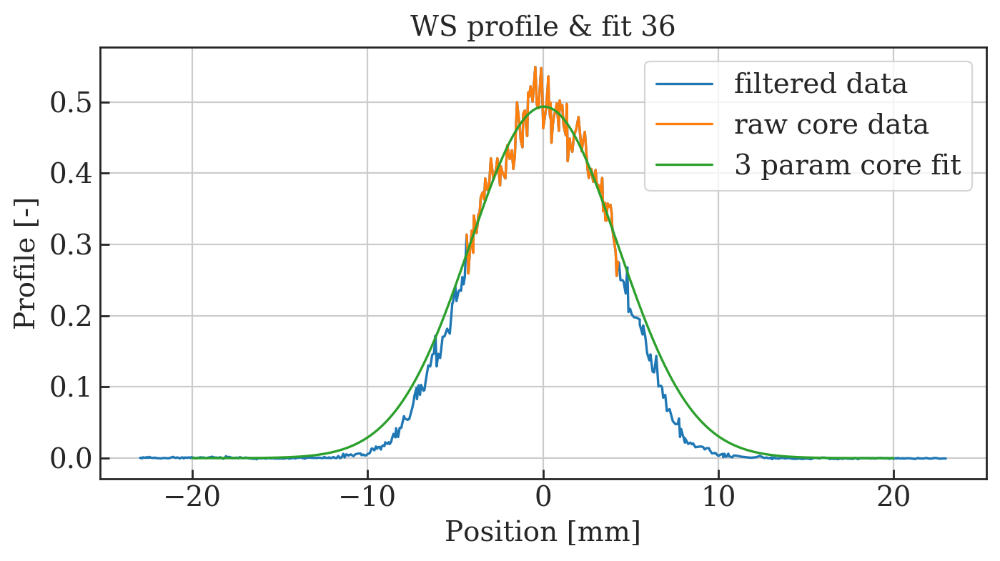

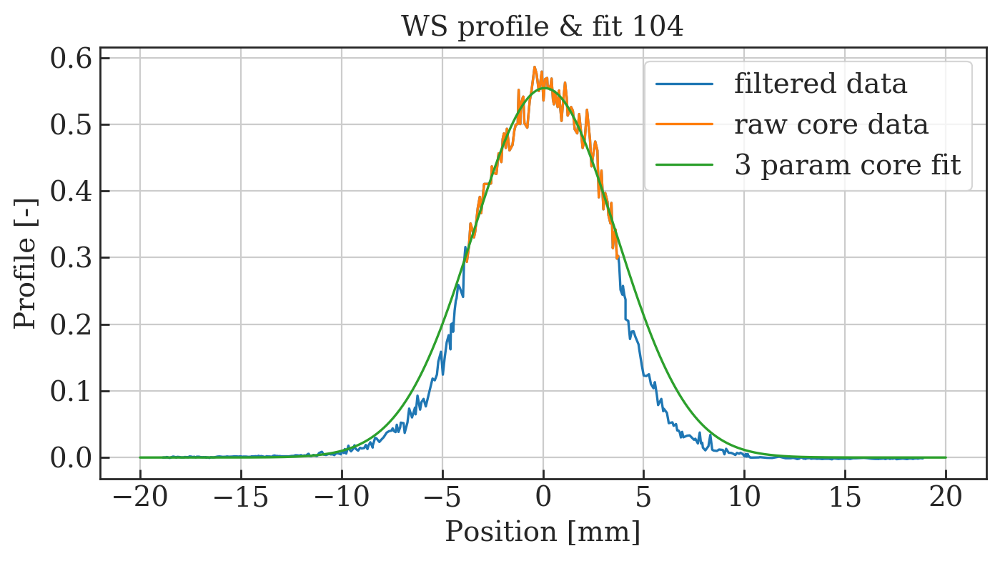

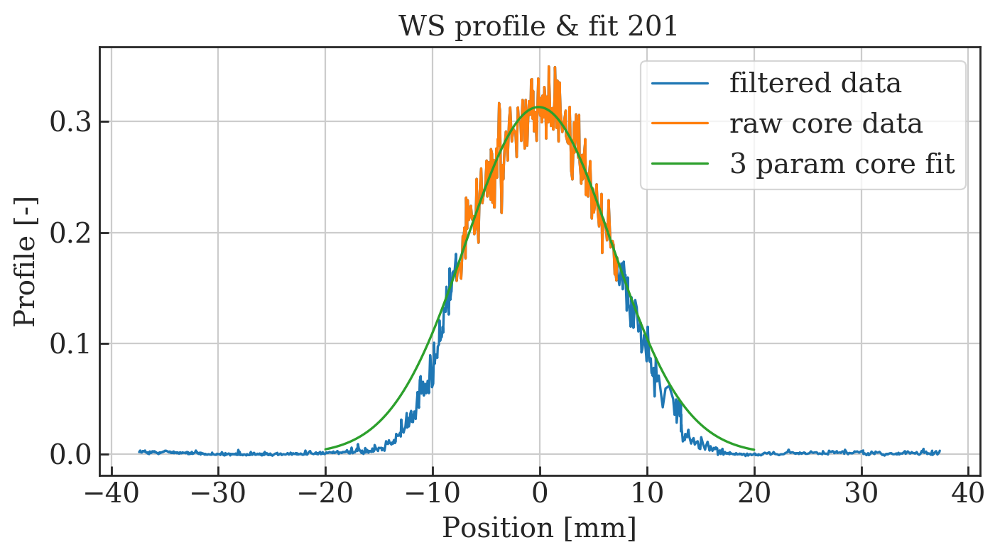

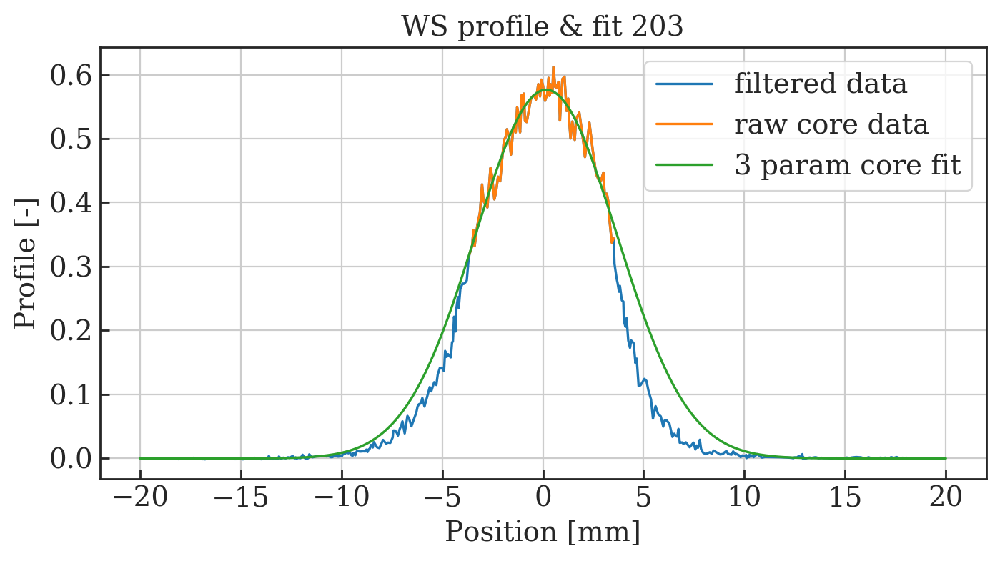

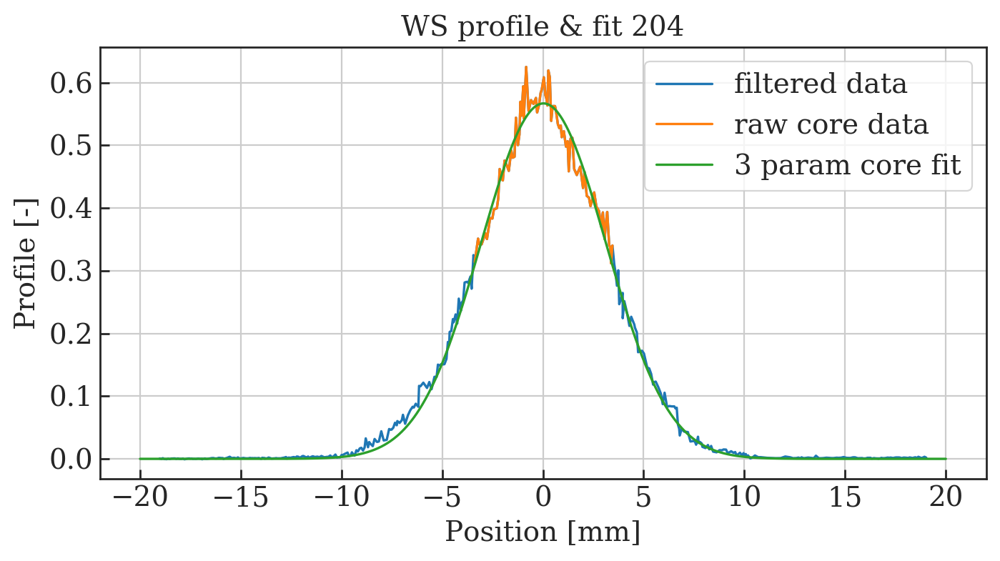

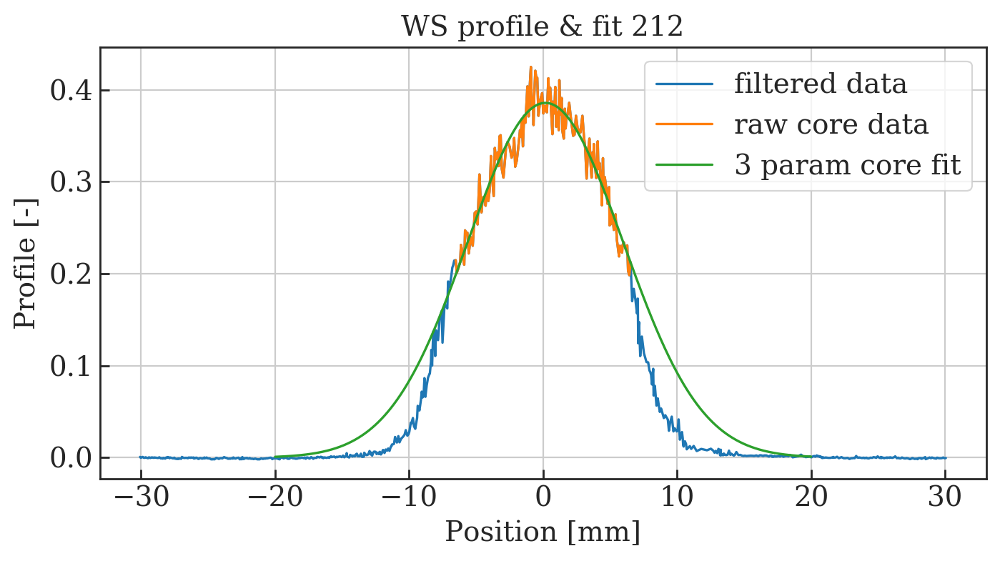

In [177]:
df0_core = Core_filter(df0)

In [ ]:
df0_core

In [ ]:
df0_sim_core = Core_filter(df0_sim)

In [ ]:
df0_sim_core

# Emittance from Core sigma and second moment

In [ ]:
# from scipy.interpolate import interp1d
# def PS_WSoptics(tunex, tuney, WS='65', verbose=False):
        
#     ptc_optics = dict()
#     #ptc_optics[float(tune)] = [(all floats) beta_x, beta_y, alpha_x, alpha_y, D_x, D_y]
#     ptc_optics[6.10] = [11.835, 24.924, 0.0115, -0.016, 2.86, 0.]
#     ptc_optics[6.12] = [11.917, 24.029, 0.0099, 0.0028, 2.83, 0.]
#     ptc_optics[6.14] = [12, 23.44, 0.0082, 0.0157, 2.8, 0.]
#     ptc_optics[6.16] = [12.083, 23.031, 0.0065, 0.0251, 2.77, 0.]
#     ptc_optics[6.18] = [12.165, 22.735, 0.0047, 0.0322, 2.74, 0.]
#     ptc_optics[6.20] = [12.247, 22.513, 0.0029, 0.0377, 2.71, 0.]
#     ptc_optics[6.22] = [12.328, 22.34, 0.0012, 0.0421, 2.68, 0.]
#     ptc_optics[6.24] = [12.409, 22.202, -0.00055, 0.0457, 2.65, 0.]
    
#     # interpolated data
    
#     Qy = [6.1, 6.12, 6.14, 6.16, 6.18, 6.2, 6.22, 6.24]
#     beta_x_ptc = [11.835, 11.917, 12, 12.083, 12.165, 12.247, 12.328, 12.409]
#     beta_x = [11.496287799470704, 11.622348183114314, 11.752791012666949, 11.882235857048215, 12.017876534237434, 12.155717432086707, 12.286640418239848, 12.418697362251356]
#     beta_x_eff = [15.71937930751325, 15.769989166689998, 15.846834580765128, 15.914760535085426, 16.012224151123437, 16.067729573281675, 16.265895421362465, 16.287392480720673]
#     beta_y_ptc = [24.924, 24.029, 23.44, 23.031, 22.735, 22.513, 22.34, 22.202]
#     beta_y = [28.784027286342415, 27.207938015726914, 25.95396311972594, 24.996666601561824, 24.16981199942386, 23.532576507285963, 23.068468704478313, 22.76306463960286]
#     beta_y_eff = [28.784021415243977, 27.20793652234759, 25.953962447008042, 24.996665150525683, 24.1698108711869, 23.532575659545216, 23.06846817340586, 22.763064622584743]
#     alpha_x_ptc = [0.0115, 0.0099, 0.0082, 0.0065, 0.0047, 0.0029, 0.0012, -0.00055]
#     alpha_x = [0.020196943327589586, 0.017627598679308795, 0.014994645269010886, 0.012378157613604897, 0.009604465728624582, 0.006771094434762246, 0.004103420240249408, 0.0014042139169805218]
#     alpha_x_eff = [0.012644756543632252, 0.010999606000298172, 0.009279390671409909, 0.007565427145992475, 0.005761468634033717, 0.0038912356469907898, 0.002097495908152698, 0.00041000161249536634]
#     alpha_y_ptc = [-0.016, 0.0028, 0.0157, 0.0251, 0.0322, 0.0377, 0.0421, 0.0457]
#     alpha_y = [-0.07633339839729839, -0.04694770375188252, -0.022726415517094378, -0.0032576706141040795, 0.013524545703849094, 0.026632494806317433, 0.03620287285371853, 0.04286149340139552]
#     alpha_y_eff = [-0.07633353873159593, -0.04694768168864276, -0.022726376530043065, -0.0032576498736779915, 0.013524555750239533, 0.026632507622584966, 0.03620287711554266, 0.04286150380905749]
#     D_x_ptc = [2.86, 2.83, 2.8, 2.77, 2.74, 2.71, 2.68, 2.65]
#     D_x = [2.7232998132262445, 2.6998500131457344, 2.6737571779004394, 2.645956067783495, 2.615602483750087, 2.5843844615942437, 2.5525948394197817, 2.5209695063465576]
#     D_y_ptc = [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
#     D_y = [0.0008237864638082594, -2.8364867400863136e-05, 0.0005038574946213577, -0.00010499875711448806, 3.6980491474269093e-05, -1.014483389421703e-05, -2.01627560923344e-05, -5.804429820819794e-05]
# #     alpha_x_int = interp1d(Qy, alpha_x)
# #     alpha_y_int = interp1d(Qy, alpha_y)

# #     alpha_x_eff_int = interp1d(Qy, alpha_x_eff)
# #     alpha_y_eff_int = interp1d(Qy, alpha_y_eff)

# #     beta_x_int = interp1d(Qy, beta_x)
# #     beta_y_int = interp1d(Qy, beta_y, kind='cubic')

#     beta_x_int = interp1d(Qy, beta_x)
#     beta_y_int = interp1d(Qy, beta_y, kind='cubic')

#     D_x_int = interp1d(Qy, D_x)
# #     D_y_int = interp1d(Qy, D_y)

#     if tuney < 1:
#         tuney = 6 + tuney
    
#     if tuney > 6.24:
#         result = {'Beta_x':beta_x_int(6.24), 'Beta_y':beta_y_int(6.24),'D_x': D_x_int(6.24)}
#     elif tuney < 6.10:
#         result = {'Beta_x':beta_x_int(6.10), 'Beta_y':beta_y_int(6.10),'D_x': D_x_int(6.10)}
#     else:
#         result = {'Beta_x':beta_x_int(tuney), 'Beta_y':beta_y_int(tuney),'D_x': D_x_int(tuney)}
#     return result

# def profiles(ndf,WS='64.V',myFiles=None, lim=40):
#     df=ndf.copy()
#     # play with these limits
#     #x=np.linspace(-40,40,1000)
#     x=np.linspace(-lim,lim,1000)
#     a=df.columns
#     if 'profile '+WS[-1] not in a:
#         df['profile '+WS[-1]]=df['PR.BWS.{}_ROT:PROF_DATA_IN'.format(WS)].apply(filtered)
#         df['position '+WS[-1]]=df['PR.BWS.{}_ROT:PROF_POSITION_IN'.format(WS)].values/1000.
#     if 'sig '+WS[-1] not in a:
#         df['sig '+WS[-1]]=np.nan
#         df['mu '+WS[-1]]=np.nan
#         df['c '+WS[-1]]=np.nan
#         df['A '+WS[-1]]=np.nan

#     span=span_range(df,myFiles=myFiles)
#     if np.isnan(df['sig '+WS[-1]].iloc[span]).all():
#         for i in span:
#             df['A '+WS[-1]].iloc[i], df['c '+WS[-1]].iloc[i], df['mu '+WS[-1]].iloc[i], df['sig '+WS[-1]].iloc[i] = makeGaussianFit_5_parameters(df['position '+WS[-1]].iloc[i], df['profile '+WS[-1]].iloc[i], for_df=True, window=lim)
#             try:
#                 yz=scipy.interpolate.interp1d(df['position '+WS[-1]].iloc[i] - df['mu '+WS[-1]].iloc[i], df['profile '+WS[-1]].iloc[i] - df['c '+WS[-1]].iloc[i])(x)
#                 if np.isnan(yz[0]):
#                     yz=np.nan
#             except:
#                 yz = np.nan
#             df['profile '+WS[-1]].iloc[i]=yz
#             df['position '+WS[-1]].iloc[i]=x
#     return df

# def twiss(ndf,WS='65.H',myFiles=None, verbose=False):
#     df=ndf.copy()
#     a=df.columns
#     if 'betx' not in a:
#         df['betx']=np.nan
#     if 'bety' not in a:
#          df['bety']=np.nan
#     if 'dx' not in a:
#          df['dx']=np.nan
#     span=span_range(df,myFiles=myFiles)
#     for i in span:
#             df.loc[df.index[i],'betx']=PS_WSoptics( df['Qx'].iloc[i], df['Qy'].iloc[i], WS=WS[:-2], verbose=verbose )['Beta_x']
#             df.loc[df.index[i],'dx']=PS_WSoptics( df['Qx'].iloc[i], df['Qy'].iloc[i], WS=WS[:-2], verbose=verbose )['D_x']
#             df.loc[df.index[i],'bety']=PS_WSoptics( df['Qx'].iloc[i], df['Qy'].iloc[i], WS=WS[:-2], verbose=verbose )['Beta_y']
#     return df

def core_emittance_df(ndf, WS='64.V', myFiles=None, beta=0.91444281513833, gamma=2.4708737618826, dp=8.7e-4, verbose=False):
    df=ndf.copy()
    a=df.columns
    if 'Core emittance V' not in a:
        df['Core emittance V']=np.nan
    span=span_range(df,myFiles=myFiles)
    if 'bety' not in a:
        df=twiss(df, WS=WS, verbose=verbose)
    for i in span:
        df.loc[df.index[i],'Core emittance V']=beta*gamma*(df['Core sig V'].iloc[i]**2)/df['bety'].iloc[i]
        print 'Emittance ', i, ' = ', beta*gamma*(df['Core sig V'].iloc[i]**2)/df['bety'].iloc[i]
    return df

# Override original due to a bug?
def core_emittance_df_2(ndf, WS='64.V', myFiles=None, beta=0.91444281513833, gamma=2.4708737618826, dp=8.7e-4, verbose=False):
    df=ndf.copy()
    a=df.columns
    span=span_range(df,myFiles=myFiles)
    if 'bety' not in a:
        df=twiss(df, WS=WS, verbose=verbose)
    for i in span:
        df.loc[df.index[i],'Core emittance V 2ndMoment']=beta*gamma*(df['Core 2ndMoment V'].iloc[i]**2)/df['bety'].iloc[i]
        print 'Emittance ', i, ' = ', beta*gamma*(df['sig V'].iloc[i]**2)/df['bety'].iloc[i]
    return df

In [ ]:
final_md_df = core_emittance_df(df0_core)
final_md_df = core_emittance_df_2(final_md_df)

In [ ]:
final_md_df

In [ ]:
final_sim_df = core_emittance_df(df0_sim_core)
final_sim_df = core_emittance_df_2(final_sim_df)

In [ ]:
final_sim_df

In [ ]:
df0 = final_md_df
df0_sim = final_sim_df

In [ ]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 6), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['Core emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['Core emittance V'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='MD @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_sim['Qy'], df0_sim['Core emittance V'], label='Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

plt.title(r'Core fit $\epsilon_{x,y} = \beta\gamma \frac{\sigma_{core}^2}{\beta_{x,y}(s)}$')

plt.ylim(0, 4)

plt.legend();
plt.grid();
fig.savefig('MD4224_Vertical_Manual_Fit_WS_Delay_Core_Emittance_Errors_Using_Sim_Optics_Sim_172.png');

In [ ]:
# Plot averaged data points with error bars
fig=plt.figure(figsize=(8, 6), dpi= 200, facecolor='w', edgecolor='k');
x_data = np.linspace(610, 624, 15);
x_data = x_data/100;

y_data_172 = []
y_error_172 = []

for i in x_data:
    
    upper_lim = i+0.0049999999999 - 6
    lower_lim = i-0.0049999999999 - 6
    
    y_data_172.append( np.mean( df0['Core emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    y_error_172.append( np.std( df0['Core emittance V 2ndMoment'][(df0['PR.BWS.64.V_ROT:ACQ_DELAY']==172)][(df0['Qy']>lower_lim)][(df0['Qy']<upper_lim)] ) )
    
plt.errorbar(x_data, y_data_172, y_error_172, label='MD @ 172 ms', linestyle='None', marker='o', capsize=3, color='b')

plt.plot(df0_sim['Qy'], df0_sim['Core emittance V 2ndMoment'], label='Simulation @ 172 ms', linestyle='None', marker='o', color='r', markersize=5)

plt.xlabel('Qy');
plt.ylabel('Vertical Emittance [mm mrad]');

plt.title(r'Core fit $\epsilon_{x,y} = \beta\gamma \frac{\mu\prime^2_{core}}{\beta_{x,y}(s)}$')

plt.ylim(0, 4)

plt.legend();
plt.grid();
fig.savefig('MD4224_Vertical_Manual_Fit_WS_Delay_Core_Emittance_2nd_Errors_Using_Sim_Optics_Sim_172.png');